In [1]:
%matplotlib inline
import numpy as np                  
import matplotlib.pyplot as plt     
import random   
import math
from tqdm import tqdm


from keras.datasets import mnist    
from keras.models import Sequential 

#from keras.layers.core import Dense, Dropout, Activation 
#from keras.utils import np_utils  

import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Activation, Flatten, Conv2D, MaxPooling2D
import matplotlib.pyplot as plt
import pickle
from sklearn.model_selection import train_test_split

import matplotlib.image as mpimg
import scipy.ndimage as ndi

from keras.models import Sequential
from keras.layers import Dense
from keras import backend as K
import keras

from sklearn.metrics import mean_squared_error
from scipy.optimize import curve_fit
from numba import jit
pi = math.pi

import random
#from cv2 import cv2
import cv2
import scipy.stats
import seaborn as sns

from nexusformat.nexus import *
from matplotlib.patches import Circle



# Parameters

In [127]:
a_bulk = 3.905 #SrTiO3 is the bulk
a = a_bulk

c_bulk = 3.905 
c_surf = 3.79 #LaAlO3


Nc = 1000
N_bulk = 8+1
N_surface = 4

#rn describes the bulk atomic xyz positions
r1 = [0, 0, 0]
r2 = [0.5, 0.5, 0.5]
r3 = [0.5, 0.5, 0]
r4 = [0, 0.5, 0.5]
r5 = [0.5, 0, 0.5]

#hard setting the base atom position of the variable bulk and surface
rb1 = [[0, 0, 0]] * N_bulk
s1 = [[0, 0, 0]] * N_surface

#variation of atomic positions
v = 0.05

In [128]:
#creating q mesh
a_SrTiO3 = 3.905
a = a_SrTiO3
dqz = 0.025 * (2*pi/a_SrTiO3)
z_size = 6 * (2*pi/a_SrTiO3)


rod_dimension = 4
dqxy = (2*pi)/a_SrTiO3
xy_size = (rod_dimension-1)*dqxy


x = np.linspace(0, xy_size, rod_dimension)
y = x
z = np.linspace(dqz, z_size, round(z_size/dqz))


[qx, qy, qz] = np.meshgrid(x, y, z)

z_dim = qx.shape[2]
xy_dim = qx.shape[0] * qx.shape[1]


print("XY Dimension: ", qx.shape[0]* qx.shape[1] )
print("Z Dimension: ", qx.shape[2] )
print("Total Points: ", qx.shape[0]* qx.shape[1] *qx.shape[2] )

XY Dimension:  16
Z Dimension:  240
Total Points:  3840


In [4]:
q_mag_squared_term = (qx**2 + qy**2 + qz**2)/((4*pi)**2)
def get_fq(a_arr, b_arr, c_val):
    fq = np.zeros(qx.shape)
    for i in range(4):
        fq += a_arr[i] * np.exp(-b_arr[i] * q_mag_squared_term ) 
    fq += c_val
    return fq

In [5]:
# Define the file path
file_path = 'LSMO_newdat2.XYZ'  # Replace with the actual file path

with open(file_path, 'r') as xyz_file:
    lines = xyz_file.readlines()[2:] # Skipping the first two lines

In [6]:
label = []
x_cobra = []
y_cobra = []
z_cobra = []
DW_factor = []
p_cobra = []

for i in range(len(lines)):
    row = lines[i]
    arr = row.split()
    label.append((arr[0]))
    x_cobra.append(float(arr[1]))
    y_cobra.append(float(arr[2]))
    z_cobra.append(float(arr[3]))
    DW_factor.append(float(arr[4]))
    p_cobra.append(float(arr[5]))
    
    
U_sr = DW_factor[0]
U_la = DW_factor[1]
U_o1 = DW_factor[2]
U_ti = DW_factor[3]
U_mn = DW_factor[4]
U_o3 = DW_factor[5]
U_o2 = DW_factor[6]

In [7]:
#Definining DW Factors
q_squared = (qx**2 + qy**2 + qz**2)


DW_sr = np.exp( (-1/2)*q_squared* U_sr  )
DW_la = np.exp( (-1/2)*q_squared* U_la  )
DW_ti = np.exp( (-1/2)*q_squared* U_ti  )
DW_mn = np.exp( (-1/2)*q_squared* U_mn  )
DW_o1 = np.exp( (-1/2)*q_squared* U_o1  )
DW_o2 = np.exp( (-1/2)*q_squared* U_o2  )
DW_o3 = np.exp( (-1/2)*q_squared* U_o3  )

In [8]:
#change to whatever bulk and surface you're using 
a_Sr = [18.0874, 8.1373, 2.5654, -34.193]
b_Sr = [1.4907, 12.6963, 24.5651, -0.0138]
c_Sr = 41.4025

a_Ti = [19.5114, 8.23473, 2.01341, 1.5208]
b_Ti = [0.178847, 6.67018, -0.29263, 12.9464]
c_Ti = -13.28

a_O = [3.0485, 2.2868, 1.5463, 0.867]
b_O = [13.2771, 5.7011, 0.3239, 32.9089]
c_O = 0.2508

a_La = [20.2489, 19.3763, 11.6323, 0.336048]
b_La = [2.9207, 0.250698, 17.8211, 54.9453]
c_La = 2.4086

a_Al = [4.17448, 3.3876, 1.20296, 0.528137]
b_Al = [1.93816, 4.14553, 0.228753, 8.28524]
c_Al = 0.706786

fq_Sr = get_fq(a_Sr, b_Sr, c_Sr)
fq_Ti = get_fq(a_Ti, b_Ti, c_Ti)
fq_O =  get_fq(a_O, b_O, c_O)
fq_La = get_fq(a_La, b_La, c_La)
fq_Al =  get_fq(a_Al, b_Al, c_Al)

#fq for the bulk and surface
#fq_b = [fq_Sr, fq_Ti, fq_O, fq_O, fq_O]
#fq_s = [fq_La, fq_Al, fq_O, fq_O, fq_O]

fq_b = [fq_Sr*DW_sr, fq_Ti*DW_ti, fq_O*DW_o1, fq_O*DW_o2, fq_O*DW_o3]
fq_s = [fq_La*DW_la, fq_Al*DW_mn, fq_O*DW_o1, fq_O*DW_o2, fq_O*DW_o3]


In [9]:
#an array that is zero at the bragg peaks and one everywhere else
#inverse is the opposite
bragg_peak_arr = np.ones(qx.shape)
bragg_peak_arr_inverse = np.zeros(qx.shape)

for i in range(len(bragg_peak_arr)):
    for j in range(len(bragg_peak_arr[0])):
        for k in range(len(bragg_peak_arr[0][0])):
            if np.allclose(z[k]/(2*pi/a_bulk) % 1,  0):
                bragg_peak_arr[i][j][k] = 0
                bragg_peak_arr_inverse[i][j][k] = 1

# Simulation Methods

In [10]:
#Z scattering
#z_scat_bulk = np.zeros(qx.shape)
#z_scat_bulk = 0.5/np.sin(c_bulk*qz/2)

#simulate general ctr scattering 
def createCTR_allr(r1, r2, r3, r4, r5, rb1, rb2, rb3, rb4, rb5, s1, s2, s3, s4, s5, cn_bulk, cn_surf, mix):
    
   
    z_scat_bulk = np.zeros(qx.shape,dtype=np.complex_)

    nom = 1
    denom = (np.exp(1j * qz * c_bulk)-1)
    z_scat_bulk = (nom/denom)
        
        
    F_q_bulk = np.zeros(qx.shape)

    F_q_bulk = F_q_bulk + fq_b[0]*np.exp( 1j * a_bulk*(qx*r1[0] + qy*r1[1] + qz*r1[2])) #Sr
    F_q_bulk = F_q_bulk + fq_b[1]*np.exp( 1j * a_bulk*(qx*r2[0] + qy*r2[1] + qz*r2[2])) #Ti
    F_q_bulk = F_q_bulk + fq_b[2]*np.exp( 1j * a_bulk*(qx*r3[0] + qy*r3[1] + qz*r3[2])) #O
    F_q_bulk = F_q_bulk + fq_b[3]*np.exp( 1j * a_bulk*(qx*r4[0] + qy*r4[1] + qz*r4[2])) #O
    F_q_bulk = F_q_bulk + fq_b[4]*np.exp( 1j * a_bulk*(qx*r5[0] + qy*r5[1] + qz*r5[2])) #O
    
    bulk = z_scat_bulk*F_q_bulk 
    
    #-------
    
    c_sum = 0
    bulk_variable = np.zeros(qx.shape)
    for i in range(0, N_bulk):
            
        F_q_bulk_var = np.zeros(qx.shape)
        f_mixed = (1-mix[i])*fq_s[0] + mix[i]*fq_b[0]
        F_q_bulk_var = F_q_bulk_var + f_mixed*np.exp( 1j * a_bulk*(qx*rb1[i][0] + qy*rb1[i][1]) + 1j*cn_bulk[i]*(qz*rb1[i][2])) #Sr

        F_q_bulk_var = F_q_bulk_var + fq_b[1]*np.exp( 1j * a_bulk*(qx*rb2[i][0] + qy*rb2[i][1]) +  1j*cn_bulk[i]*(qz*rb2[i][2])) #Ti
        F_q_bulk_var = F_q_bulk_var + fq_b[2]*np.exp( 1j*   a_bulk*(qx*rb3[i][0] + qy*rb3[i][1]) + 1j*cn_bulk[i]*(qz*rb3[i][2])) #O
        F_q_bulk_var = F_q_bulk_var + fq_b[3]*np.exp( 1j *  a_bulk*(qx*rb4[i][0] + qy*rb4[i][1]) + 1j*cn_bulk[i]*(qz*rb4[i][2])) #O
        F_q_bulk_var = F_q_bulk_var + fq_b[4]*np.exp( 1j *  a_bulk*(qx*rb5[i][0] + qy*rb5[i][1]) + 1j*cn_bulk[i]*(qz*rb5[i][2])) #O

        bulk_variable = bulk_variable + F_q_bulk_var*np.exp(1j* qz * c_sum)
        c_sum += cn_bulk[i]
    #-----
    
    
    
    surface = np.zeros(qx.shape)
    for i in range(N_bulk, N_bulk + N_surface):
        
        #if there's mixing
        F_q_surf = np.zeros(qx.shape)
        f_mixed = (1-mix[i])*fq_s[0] + mix[i]*fq_b[0]
        F_q_surf = F_q_surf + f_mixed*np.exp( 1j * a_bulk*(qx*s1[i - N_bulk][0] + qy*s1[i - N_bulk][1]) + 1j*cn_surf[i - N_bulk]*(qz*s1[i - N_bulk][2])) #La
        F_q_surf = F_q_surf + fq_s[1]*np.exp( 1j * a_bulk*(qx*s2[i - N_bulk][0] + qy*s2[i - N_bulk][1]) + 1j*cn_surf[i - N_bulk]*(qz*s2[i - N_bulk][2])) #Al
        F_q_surf = F_q_surf + fq_s[2]*np.exp( 1j*   a_bulk*(qx*s3[i - N_bulk][0] + qy*s3[i - N_bulk][1]) + 1j*cn_surf[i - N_bulk]*(qz*s3[i - N_bulk][2])) #O
        F_q_surf = F_q_surf + fq_s[3]*np.exp( 1j *  a_bulk*(qx*s4[i - N_bulk][0] + qy*s4[i - N_bulk][1]) + 1j*cn_surf[i - N_bulk]*(qz*s4[i - N_bulk][2])) #O
        F_q_surf = F_q_surf + fq_s[4]*np.exp( 1j *  a_bulk*(qx*s5[i - N_bulk][0] + qy*s5[i - N_bulk][1]) + 1j*cn_surf[i - N_bulk]*(qz*s5[i - N_bulk][2])) #O

        surface = surface + F_q_surf*np.exp(1j * qz * c_sum)
        c_sum += cn_surf[i - N_bulk]
    

    e_field = (bulk + bulk_variable + surface)
    ctr = np.abs(bulk + bulk_variable + surface) ** 2
    phase = np.angle(e_field)
        
    
    return ctr, e_field, phase




def createCTR_reshaped_log_allr(r1, r2, r3, r4, r5, rb1, rb2, rb3, rb4, rb5, s1, s2, s3, s4, s5, cn_bulk, cn_surf, mix, beta):
    
   
    
    epsilon = 0.01 (-2)
    
    ctr, e_field, phase = createCTR_allr(r1, r2, r3, r4, r5, 
                    rb1, rb2, rb3, rb4, rb5, 
                    s1, s2, s3, s4, s5, cn_bulk, cn_surf, mix)
    
    ctr_reshaped = ctr.reshape(xy_dim, z_dim)
    #Roughness parameter
    for rod in range(len(ctr_reshaped)):
        for l in range(len(ctr_reshaped[0])):
            scaling_factor = (1-beta**2)/(1 + beta**2 - 2*beta*np.cos(z[l] * c_surf))
            ctr_reshaped[rod][l] *=  scaling_factor
            
    return np.log(ctr_reshaped + epsilon), e_field, phase


def generatePs():
    generated = False
    betaVal = 0.75
    while (not generated):
        p1 = np.random.beta(betaVal, betaVal)
        p2 = np.random.beta(betaVal, betaVal)
        p3 = np.random.beta(betaVal, betaVal)
        p4 = np.random.beta(betaVal, betaVal)
        tot = (p1 + p2 + p3 + p4)/2
        p1/=tot
        p2/=tot
        p3/=tot
        p4/=tot
        if (p1 > 1 or p2 > 1 or p3 > 1 or p4 > 1):
            continue
        generated = True
        
    return p1, p2, p3, p4

def generateCs(c, n, v):
    c_arr = [c] * n
    for i in range(n):
        c_arr[i] = random.uniform(c-v, c+v)
        
    return c_arr
        
def removeBraggPeaks(CTR, thresh):
    peak_locations = []
    for i in range(len(CTR[0])):
        if CTR[0][i] > thresh:
            peak_locations.append(i)

    return np.delete(CTR, peak_locations, axis = 1)

def generatePositions(positions, v, n):
    defaultPos = np.array([positions] * n)
   
    for i in range(n):
        #2 because we change the z position
        defaultPos[i][2] = random.uniform(positions[2]-v, positions[2]+v)
    return defaultPos

#So the two equatorial oxygens have the same z position
def generateTwoPositions(positions1, positions2, v, n):
    defaultPos1 = np.array([positions1] * n)
    defaultPos2 = np.array([positions2] * n)
   
    for i in range(n):
        #2 because we change the z position
        randZ = random.uniform(positions1[2]-v, positions1[2]+v)
        defaultPos1[i][2] = randZ
        defaultPos2[i][2] = randZ
        
    return defaultPos1, defaultPos2


#MODIFYING THIS METHOD
def getAtomDiffs(cn_bulk, cn_surf, rb, s, zpos, N_bulk, N_surface):
    
    c_B_arr = [0] * N_bulk
    c_S_arr = [0] * N_surface
    
    
    for i in range(len(c_B_arr)):
        if i == 0:
            c_B_arr[i] = c_bulk + cn_bulk[i]*rb[i][2] - c_bulk*zpos
            
        else:
            c_B_arr[i] = cn_bulk[i-1] + cn_bulk[i]*rb[i][2] - cn_bulk[i-1]*rb[i-1][2]
       
    for i in range(len(c_S_arr)):
        if i == 0:
            c_S_arr[i] = cn_bulk[-1] + cn_surf[i]*s[i][2] - cn_bulk[-1]*rb[-1][2]
        else:
            c_S_arr[i] = cn_surf[i-1] + cn_surf[i]*s[i][2] - cn_surf[i-1]*s[i-1][2]
            
    return c_B_arr + c_S_arr
    
def removeBraggPeaks_messy(CTR, bragg_width, thresh):
    #only works if we use a nice number for z!
    peak_locations = []
    totLength = len(CTR[0])
    totRemoved = 0
    for i in range(len(CTR[0])):
        if CTR[0][i] > thresh:
            randArea = np.random.randint(bragg_width)
            
            if i + randArea < totLength:
                peak_locations = np.concatenate([peak_locations, (np.linspace(i-randArea, i + randArea, 2*randArea+1))])
            else:
                peak_locations = np.append(peak_locations, i)
    padding = np.zeros((len(CTR), len(set(peak_locations))))
        
    deleted = np.delete(CTR, peak_locations.astype(int), axis = 1)
    final_padded = np.concatenate([deleted, padding], axis = 1)
    
    return final_padded

<>:77: SyntaxWarning: 'float' object is not callable; perhaps you missed a comma?
<>:77: SyntaxWarning: 'float' object is not callable; perhaps you missed a comma?
/var/folders/w5/70rtxblx13n781dc6yr5lf800000gn/T/ipykernel_79322/2389943479.py:77: SyntaxWarning: 'float' object is not callable; perhaps you missed a comma?
  epsilon = 0.01 (-2)


#### S(q) method

In [11]:
def get_Sq(r1, r2, r3, r4, r5):
    
    z_scat_bulk = np.zeros(qx.shape,dtype=np.complex_)

    nom = 1
    denom = (np.exp(1j * qz * c_bulk)-1)
    z_scat_bulk = (nom/denom)
        
        
    F_q_bulk = np.zeros(qx.shape)

    F_q_bulk = F_q_bulk + fq_b[0]*np.exp( 1j * a_bulk*(qx*r1[0] + qy*r1[1] + qz*r1[2])) #Sr
    F_q_bulk = F_q_bulk + fq_b[1]*np.exp( 1j * a_bulk*(qx*r2[0] + qy*r2[1] + qz*r2[2])) #Ti
    F_q_bulk = F_q_bulk + fq_b[2]*np.exp( 1j * a_bulk*(qx*r3[0] + qy*r3[1] + qz*r3[2])) #O
    F_q_bulk = F_q_bulk + fq_b[3]*np.exp( 1j * a_bulk*(qx*r4[0] + qy*r4[1] + qz*r4[2])) #O
    F_q_bulk = F_q_bulk + fq_b[4]*np.exp( 1j * a_bulk*(qx*r5[0] + qy*r5[1] + qz*r5[2])) #O
    
    S_q = z_scat_bulk*F_q_bulk 
    
    return S_q

In [12]:
S_q = get_Sq(r1, r2, r3, r4, r5)

In [13]:
np.mean(S_q)

(-8.515494007993489-9648209089619.713j)

# Simulation (loading in data instead)

In [14]:
train_size = 100000

In [15]:
# Load your numpy arrays
#x_train = np.load('x_train_12L_100k.npy')
x_test = np.load('x_test_12L_100k.npy')

#y_train_real = np.load('y_train_real_12L_100k.npy')
y_test_real = np.load('y_test_real_12L_100k.npy') 

#y_train_imag = np.load('y_train_imag_12L_100k.npy')
y_test_imag = np.load('y_test_imag_12L_100k.npy')

#mean, std arrays for transformation
means_real = np.load("means_real_12L_100k.npy")
std_real = np.load("std_real_12L_100k.npy")

means_imag = np.load("means_imag_12L_100k.npy")
std_imag = np.load("std_imag_12L_100k.npy")

#atomic positions
all_cns = np.load("all_cns_12L_100k.npy")
all_o1s = np.load("all_o1s_12L_100k.npy")
all_o2s = np.load("all_o2s_12L_100k.npy")
all_o3s = np.load("all_o3s_12L_100k.npy")
all_Tis = np.load("all_Tis_12L_100k.npy")
all_ps = np.load("all_ps_12L_100k.npy")
all_roughness = np.load("all_roughness_12L_100k.npy")

#Split into Train and Validation
#train_size = len(x_train)
#train_val_split_size = int(0.9 * len(x_train))
#x_train_split = x_train[0:train_val_split_size]
#y_train_real_split = y_train_real[0:train_val_split_size]
#y_train_imag_split =  y_train_imag[0:train_val_split_size]

#x_val = x_train[train_val_split_size:]
#y_val_real = y_train_real[train_val_split_size:]
#y_val_imag =  y_train_imag[train_val_split_size:]


# Create TensorFlow datasets
#train_dataset_real = tf.data.Dataset.from_tensor_slices((x_train_split, y_train_real_split))
#val_dataset_real = tf.data.Dataset.from_tensor_slices((x_val, y_val_real))

#train_dataset_imag = tf.data.Dataset.from_tensor_slices((x_train_split, y_train_imag_split))
#val_dataset_imag = tf.data.Dataset.from_tensor_slices((x_val, y_val_imag))

# Define batch size
batch_size = 32

# Satch the training dataset
#train_dataset_real = train_dataset_real.batch(batch_size)
#train_dataset_imag = train_dataset_imag.batch(batch_size)


# Batch the validation dataset
#val_dataset_real = val_dataset_real.batch(batch_size)
#val_dataset_imag = val_dataset_imag.batch(batch_size)

# Building the UNet

In [16]:
from keras.layers import Conv1D
from keras.layers import MaxPooling1D
from keras.layers import Concatenate


In [17]:
#custom Loss
#see if theres infinite loss type thing
def custom_loss(y_true, y_pred):
    diff = y_true - y_pred
    val = (diff + pi) % (2*pi) - pi
    
    return tf.reduce_mean(tf.abs(val))


In [18]:
import tensorflow as tf
from tensorflow.keras.layers import Input, Conv1D, MaxPooling1D, UpSampling1D, Concatenate, BatchNormalization, Dropout
from tensorflow.keras.models import Model

import tensorflow as tf
from tensorflow.keras.layers import Input, Conv1D, MaxPooling1D, UpSampling1D, Concatenate, BatchNormalization

def unet_1d(input_shape):
    inputs = Input(input_shape)

    # Encoding path
    conv1 = Conv1D(128, 3, activation='relu', padding='same')(inputs)
    conv1 = Conv1D(128, 3, activation='relu', padding='same')(conv1)
    pool1 = MaxPooling1D(pool_size=2)(conv1)

    conv2 = Conv1D(256, 3, activation='relu', padding='same')(pool1)
    conv2 = Conv1D(256, 3, activation='relu', padding='same')(conv2)
    pool2 = MaxPooling1D(pool_size=2)(conv2)

    # Center path
    conv3 = Conv1D(512, 3, activation='relu', padding='same')(pool2)
    conv3 = Conv1D(512, 3, activation='relu', padding='same')(conv3)

    # Decoding path
    up4 = Conv1D(256, 2, activation='relu', padding='same')(UpSampling1D(size=2)(conv3))
    merge4 = Concatenate(axis=-1)([conv2, up4])
    conv4 = Conv1D(256, 3, activation='relu', padding='same')(merge4)
    conv4 = Conv1D(256, 3, activation='relu', padding='same')(conv4)

    up5 = Conv1D(128, 2, activation='relu', padding='same')(UpSampling1D(size=2)(conv4))
    merge5 = Concatenate(axis=-1)([conv1, up5])
    conv5 = Conv1D(128, 3, activation='relu', padding='same')(merge5)
    conv5 = Conv1D(128, 3, activation='relu', padding='same')(conv5)

    outputs = Conv1D(1, 1, activation='linear', padding='same')(conv5)

    model = Model(inputs, outputs)
    return model

x_new_times_y_new = x_test[0].shape[0]
# Define input shape (476, 1)
input_shape = (x_new_times_y_new, 1)

# Create the modified model
model = unet_1d(input_shape)

# Print the modified model summary
model.summary()
tf.random.set_seed(40)

2024-08-20 00:02:43.794978: I metal_plugin/src/device/metal_device.cc:1154] Metal device set to: Apple M2 Pro
2024-08-20 00:02:43.794999: I metal_plugin/src/device/metal_device.cc:296] systemMemory: 16.00 GB
2024-08-20 00:02:43.795002: I metal_plugin/src/device/metal_device.cc:313] maxCacheSize: 5.33 GB
2024-08-20 00:02:43.795038: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:303] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2024-08-20 00:02:43.795052: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:269] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 3840, 1)]            0         []                            
                                                                                                  
 conv1d (Conv1D)             (None, 3840, 128)            512       ['input_1[0][0]']             
                                                                                                  
 conv1d_1 (Conv1D)           (None, 3840, 128)            49280     ['conv1d[0][0]']              
                                                                                                  
 max_pooling1d (MaxPooling1  (None, 1920, 128)            0         ['conv1d_1[0][0]']            
 D)                                                                                           

# E_real

In [19]:
"""
model = unet_1d(input_shape)

with tf.device('/device:CPU:0'):
    model.compile(loss = 'mean_absolute_error',
                 optimizer = "adam",
                 metrics = ['mean_absolute_error'])

checkpointer = tf.keras.callbacks.ModelCheckpoint('unet_12L_100k_30e_real.h5', verbose=1, save_best_only=True)
callbacks = [
    checkpointer
]

# Train your model using the dataset
results = model.fit(train_dataset_real, epochs=30, validation_data=val_dataset_real, callbacks=callbacks)

plt.plot(results.history['val_loss'], 'o-', color = 'red')
plt.plot(results.history['loss'], 'o-', color = 'green')
plt.xlabel('epoch')

np.save("trainLoss_12L_100k_real.npy", results.history['loss'])
np.save("valLoss_12L_100k_real.npy", results.history['val_loss'])
"""

'\nmodel = unet_1d(input_shape)\n\nwith tf.device(\'/device:CPU:0\'):\n    model.compile(loss = \'mean_absolute_error\',\n                 optimizer = "adam",\n                 metrics = [\'mean_absolute_error\'])\n\ncheckpointer = tf.keras.callbacks.ModelCheckpoint(\'unet_12L_100k_30e_real.h5\', verbose=1, save_best_only=True)\ncallbacks = [\n    checkpointer\n]\n\n# Train your model using the dataset\nresults = model.fit(train_dataset_real, epochs=30, validation_data=val_dataset_real, callbacks=callbacks)\n\nplt.plot(results.history[\'val_loss\'], \'o-\', color = \'red\')\nplt.plot(results.history[\'loss\'], \'o-\', color = \'green\')\nplt.xlabel(\'epoch\')\n\nnp.save("trainLoss_12L_100k_real.npy", results.history[\'loss\'])\nnp.save("valLoss_12L_100k_real.npy", results.history[\'val_loss\'])\n'

In [20]:
model_new = unet_1d(input_shape)
model_new.load_weights('unet_12L_100k_30e_real.h5')

# Now you can use the model to make predictions

predictions_real = model_new.predict([x_test])
#predictions_train_real = model_new.predict([x_train])

2024-08-20 00:02:44.436898: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


32/32 [==============================] - 5s 118ms/step


# E_imag

In [21]:
"""
model = unet_1d(input_shape)

with tf.device('/device:CPU:0'):
    model.compile(loss = 'mean_absolute_error',
                 optimizer = "adam",
                 metrics = ['mean_absolute_error'])

checkpointer = tf.keras.callbacks.ModelCheckpoint('unet_12L_100k_30e_imag.h5', verbose=1, save_best_only=True)
callbacks = [
    checkpointer
]

results = model.fit(train_dataset_imag, epochs=30, validation_data=val_dataset_imag, callbacks=callbacks)


plt.plot(results.history['val_loss'], 'o-', color = 'red')
plt.plot(results.history['loss'], 'o-', color = 'green')
plt.xlabel('epoch')

np.save("trainLoss_12L_100k_imag.npy", results.history['loss'])
np.save("valLoss_12L_100k_imag.npy", results.history['val_loss'])
"""

'\nmodel = unet_1d(input_shape)\n\nwith tf.device(\'/device:CPU:0\'):\n    model.compile(loss = \'mean_absolute_error\',\n                 optimizer = "adam",\n                 metrics = [\'mean_absolute_error\'])\n\ncheckpointer = tf.keras.callbacks.ModelCheckpoint(\'unet_12L_100k_30e_imag.h5\', verbose=1, save_best_only=True)\ncallbacks = [\n    checkpointer\n]\n\nresults = model.fit(train_dataset_imag, epochs=30, validation_data=val_dataset_imag, callbacks=callbacks)\n\n\nplt.plot(results.history[\'val_loss\'], \'o-\', color = \'red\')\nplt.plot(results.history[\'loss\'], \'o-\', color = \'green\')\nplt.xlabel(\'epoch\')\n\nnp.save("trainLoss_12L_100k_imag.npy", results.history[\'loss\'])\nnp.save("valLoss_12L_100k_imag.npy", results.history[\'val_loss\'])\n'

In [22]:
model_new = unet_1d(input_shape)
model_new.load_weights('unet_12L_100k_30e_imag.h5')

predictions_imag = model_new.predict([x_test])
#predictions_train_imag = model_new.predict([x_train])

2024-08-20 00:02:49.351120: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


32/32 [==============================] - 5s 117ms/step


In [23]:
predictions_real = predictions_real.reshape((len(predictions_real), x_new_times_y_new))
y_test_real = y_test_real.reshape((len(y_test_real), x_new_times_y_new))

predictions_imag = predictions_imag.reshape((len(predictions_imag), x_new_times_y_new))
y_test_imag = y_test_imag.reshape((len(y_test_imag), x_new_times_y_new))

In [24]:
predictions_real.shape
len(predictions_real[0])

3840

In [25]:
np.mean(y_test_real)

9.278996207742377e-05

In [26]:
for i in range(3840):
    print(y_test_real[0][i])

0.5663704986544266
0.2754992612074592
-0.3597905000778375
-1.056045345728644
-0.0802029196193167
-0.013745719448593827
-0.08829719916265484
0.1926151043249834
0.3628833954357695
-0.18996713416148256
-0.05518462877696072
0.7739703495804048
0.8302184814230794
0.09782574049745923
-0.5675358825149565
-0.8072236861872133
0.21538592284435035
0.6466327212660531
-0.06033868144461766
-0.9390066003755193
-1.3333545675797434
0.7643754076749527
1.1286665504184754
-0.5077386040172757
-1.2655308107617778
-0.5651896730532745
0.8069845887172209
0.6203175431170204
0.026865412642993306
0.04300288321491352
0.03701931154183781
-0.25712183706848746
-0.40986291887722626
-0.7062258373737889
-0.7316433082723349
1.4177763592435602
2.026180348338176
0.44279324722500907
-1.281134053249711
-1.1259664674470484
1.1951601112042332
0.7403810051746803
-1.6624134886319895
-2.0939254311706788
0.3135021472907592
0.6658619939829911
0.33837838058843484
1.4685071067004705
0.7559483523949188
-0.8914652914729184
-1.1834496399

In [27]:
mae_pred = 0
mae_rand = 0
for i in range(50):
    mae_pred += np.sum(np.abs(predictions_real[i] - y_test_real[i]))/3840
    mae_rand += np.sum(np.abs(y_test_real[i+1] - y_test_real[i]))/3840
mae_pred /= 50
mae_rand /= 50

In [28]:
mae_pred, mae_rand

(0.20689950381033875, 1.1365487729603605)

In [29]:
mae_pred = 0
mae_rand = 0
for i in range(50):
    mae_pred += np.sum(np.abs(predictions_imag[i] - y_test_imag[i]))/len(predictions_real[i])
    mae_rand += np.sum(np.abs(y_test_imag[i+1] - y_test_imag[i]))/len(predictions_real[i])
    
mae_pred /= 50
mae_rand /= 50

In [30]:
mae_pred, mae_rand

(0.20543716758823982, 1.1351592732017304)

Index:  0
R^2:  0.93
Index:  1
R^2:  0.95
Index:  2
R^2:  0.93
Index:  3
R^2:  0.98
Index:  4
R^2:  0.95
Index:  5
R^2:  0.97
Index:  6
R^2:  0.97
Index:  7
R^2:  0.95
Index:  8
R^2:  0.97
Index:  9
R^2:  0.95
Index:  10
R^2:  0.91
Index:  11
R^2:  0.94
Index:  12
R^2:  0.94
Index:  13
R^2:  0.94
Index:  14
R^2:  0.95
Index:  15
R^2:  0.94
Index:  16
R^2:  0.95
Index:  17
R^2:  0.96
Index:  18
R^2:  0.87
Index:  19
R^2:  0.97
Index:  20
R^2:  0.89
Index:  21
R^2:  0.94
Index:  22
R^2:  0.95
Index:  23
R^2:  0.86
Index:  24
R^2:  0.97
Index:  25
R^2:  0.89
Index:  26
R^2:  0.96
Index:  27
R^2:  0.95
Index:  28
R^2:  0.96
Index:  29
R^2:  0.97
Index:  30
R^2:  0.98
Index:  31
R^2:  0.98
Index:  32
R^2:  0.98
Index:  33
R^2:  0.99
Index:  34
R^2:  0.98
Index:  35
R^2:  0.99
Index:  36
R^2:  0.99
Index:  37
R^2:  0.99
Index:  38
R^2:  1.0
Index:  39
R^2:  0.98
Index:  40
R^2:  1.0
Index:  41
R^2:  0.99
Index:  42
R^2:  0.99
Index:  43
R^2:  0.99
Index:  44
R^2:  0.99
Index:  45
R^2:  0.99


R^2:  0.94
Index:  2993
R^2:  0.96
Index:  2994
R^2:  0.96
Index:  2995
R^2:  0.97
Index:  2996
R^2:  0.99
Index:  2997
R^2:  0.98
Index:  2998
R^2:  1.0
Index:  2999
R^2:  0.97
Index:  3000
R^2:  1.0
Index:  3001
R^2:  0.99
Index:  3002
R^2:  0.99
Index:  3003
R^2:  0.98
Index:  3004
R^2:  0.98
Index:  3005
R^2:  0.97
Index:  3006
R^2:  0.97
Index:  3007
R^2:  0.96
Index:  3008
R^2:  0.95
Index:  3009
R^2:  0.94
Index:  3010
R^2:  0.93
Index:  3011
R^2:  0.89
Index:  3012
R^2:  0.86
Index:  3013
R^2:  0.86
Index:  3014
R^2:  0.74
Index:  3015
R^2:  0.72
Index:  3016
R^2:  0.77
Index:  3017
R^2:  0.61
Index:  3018
R^2:  0.6
Index:  3019
R^2:  0.62
Index:  3020
R^2:  0.48
Index:  3021
R^2:  0.57
Index:  3022
R^2:  0.55
Index:  3023
R^2:  0.5
Index:  3024
R^2:  0.62
Index:  3025
R^2:  0.61
Index:  3026
R^2:  0.65
Index:  3027
R^2:  0.74
Index:  3028
R^2:  0.81
Index:  3029
R^2:  0.87
Index:  3030
R^2:  0.93
Index:  3031
R^2:  0.92
Index:  3032
R^2:  0.94
Index:  3033
R^2:  0.96
Index:  3

R^2:  0.92
Index:  3492
R^2:  0.89
Index:  3493
R^2:  0.89
Index:  3494
R^2:  0.79
Index:  3495
R^2:  0.75
Index:  3496
R^2:  0.8
Index:  3497
R^2:  0.64
Index:  3498
R^2:  0.63
Index:  3499
R^2:  0.62
Index:  3500
R^2:  0.49
Index:  3501
R^2:  0.61
Index:  3502
R^2:  0.56
Index:  3503
R^2:  0.55
Index:  3504
R^2:  0.65
Index:  3505
R^2:  0.64
Index:  3506
R^2:  0.67
Index:  3507
R^2:  0.76
Index:  3508
R^2:  0.82
Index:  3509
R^2:  0.87
Index:  3510
R^2:  0.93
Index:  3511
R^2:  0.92
Index:  3512
R^2:  0.94
Index:  3513
R^2:  0.96
Index:  3514
R^2:  0.97
Index:  3515
R^2:  0.98
Index:  3516
R^2:  0.98
Index:  3517
R^2:  0.99
Index:  3518
R^2:  1.0
Index:  3519
R^2:  0.98
Index:  3520
R^2:  0.99
Index:  3521
R^2:  0.99
Index:  3522
R^2:  0.98
Index:  3523
R^2:  0.98
Index:  3524
R^2:  0.98
Index:  3525
R^2:  0.97
Index:  3526
R^2:  0.97
Index:  3527
R^2:  0.96
Index:  3528
R^2:  0.96
Index:  3529
R^2:  0.92
Index:  3530
R^2:  0.94
Index:  3531
R^2:  0.88
Index:  3532
R^2:  0.88
Index: 

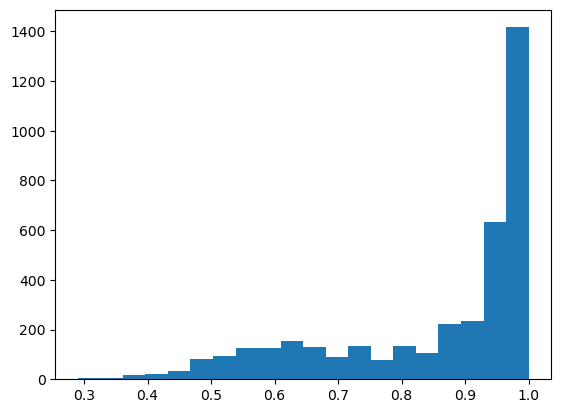

0.8510468750000001


In [31]:
#old method
def rSquared_old(real, preds):
    slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(real, preds)
    return round(r_value**2, 2)

def rSquared(real, preds):
    slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(real, preds)
    
    SS_res = np.sum(np.square(real-preds))
    SS_tot = np.sum(np.square(real - np.mean(real)))
    r2_value = 1-(SS_res/SS_tot)
    
    return round(r2_value, 2)

r2_arr = []

for i in range(x_new_times_y_new):
    print("Index: ", i)
    r2_val = rSquared(y_test_real[:, i], predictions_real[:, i])
    print("R^2: ", r2_val)
    r2_arr.append(r2_val)
    #plt.plot(y_train[:, i], predictions_train[:, i] , color = 'blue', linewidth = 5, label = "Train", alpha = 0.2)
    #plt.plot(y_train[:, i], predictions_train[:, i]  ,'.', color = 'blue', linewidth = 0, label = "Train", alpha = 0.2)
    #plt.plot(y_test[:, i], predictions[:, i] , '.', markersize = 10, color = 'orange', label = "Test", alpha = 1)
    #plt.plot(y_test[:, i], y_test[:, i], color = "lightgreen", linewidth = 5, alpha = 0.5)


    #plt.xlabel('Ground Truth', fontname = 'Helvetica',fontsize = 30 )
    #plt.ylabel('Prediction', fontname = 'Helvetica',fontsize = 30  )

    #plt.xticks(fontsize = 17, fontname = 'Helvetica' )
    #plt.yticks(fontsize = 17, fontname = 'Helvetica' )
    #plt.ylim(4, 13)
    #plt.legend(loc='upper left', markerscale=40, prop={'size': 25, "family":'Times new roman'})
    #plt.grid()
    #plt.show()

plt.hist(r2_arr, bins = 20)
plt.show()
print(np.mean(r2_arr))

In [32]:
np.mean(r2_arr)

0.8510468750000001

Index:  0
R^2:  0.94
Index:  1
R^2:  0.92
Index:  2
R^2:  0.95
Index:  3
R^2:  0.93
Index:  4
R^2:  0.99
Index:  5
R^2:  0.96
Index:  6
R^2:  0.96
Index:  7
R^2:  0.98
Index:  8
R^2:  0.94
Index:  9
R^2:  0.93
Index:  10
R^2:  0.94
Index:  11
R^2:  0.93
Index:  12
R^2:  0.94
Index:  13
R^2:  0.96
Index:  14
R^2:  0.94
Index:  15
R^2:  0.95
Index:  16
R^2:  0.95
Index:  17
R^2:  0.92
Index:  18
R^2:  0.96
Index:  19
R^2:  0.79
Index:  20
R^2:  0.95
Index:  21
R^2:  0.94
Index:  22
R^2:  0.88
Index:  23
R^2:  0.96
Index:  24
R^2:  0.88
Index:  25
R^2:  0.97
Index:  26
R^2:  0.94
Index:  27
R^2:  0.96
Index:  28
R^2:  0.96
Index:  29
R^2:  0.97
Index:  30
R^2:  0.97
Index:  31
R^2:  0.98
Index:  32
R^2:  0.99
Index:  33
R^2:  0.98
Index:  34
R^2:  0.99
Index:  35
R^2:  0.99
Index:  36
R^2:  0.99
Index:  37
R^2:  1.0
Index:  38
R^2:  0.99
Index:  39
R^2:  1.0
Index:  40
R^2:  0.99
Index:  41
R^2:  0.99
Index:  42
R^2:  0.99
Index:  43
R^2:  0.99
Index:  44
R^2:  0.99
Index:  45
R^2:  0.98


R^2:  0.89
Index:  1510
R^2:  0.92
Index:  1511
R^2:  0.92
Index:  1512
R^2:  0.96
Index:  1513
R^2:  0.91
Index:  1514
R^2:  0.98
Index:  1515
R^2:  0.93
Index:  1516
R^2:  0.97
Index:  1517
R^2:  0.99
Index:  1518
R^2:  0.98
Index:  1519
R^2:  1.0
Index:  1520
R^2:  0.99
Index:  1521
R^2:  1.0
Index:  1522
R^2:  0.98
Index:  1523
R^2:  0.98
Index:  1524
R^2:  0.96
Index:  1525
R^2:  0.98
Index:  1526
R^2:  0.95
Index:  1527
R^2:  0.96
Index:  1528
R^2:  0.95
Index:  1529
R^2:  0.93
Index:  1530
R^2:  0.93
Index:  1531
R^2:  0.88
Index:  1532
R^2:  0.85
Index:  1533
R^2:  0.7
Index:  1534
R^2:  0.64
Index:  1535
R^2:  0.54
Index:  1536
R^2:  0.58
Index:  1537
R^2:  0.64
Index:  1538
R^2:  0.52
Index:  1539
R^2:  0.55
Index:  1540
R^2:  0.6
Index:  1541
R^2:  0.52
Index:  1542
R^2:  0.5
Index:  1543
R^2:  0.53
Index:  1544
R^2:  0.58
Index:  1545
R^2:  0.66
Index:  1546
R^2:  0.78
Index:  1547
R^2:  0.85
Index:  1548
R^2:  0.88
Index:  1549
R^2:  0.89
Index:  1550
R^2:  0.91
Index:  15

R^2:  0.63
Index:  2138
R^2:  0.55
Index:  2139
R^2:  0.48
Index:  2140
R^2:  0.52
Index:  2141
R^2:  0.53
Index:  2142
R^2:  0.44
Index:  2143
R^2:  0.51
Index:  2144
R^2:  0.57
Index:  2145
R^2:  0.58
Index:  2146
R^2:  0.61
Index:  2147
R^2:  0.62
Index:  2148
R^2:  0.66
Index:  2149
R^2:  0.68
Index:  2150
R^2:  0.61
Index:  2151
R^2:  0.69
Index:  2152
R^2:  0.74
Index:  2153
R^2:  0.75
Index:  2154
R^2:  0.74
Index:  2155
R^2:  0.88
Index:  2156
R^2:  0.91
Index:  2157
R^2:  0.82
Index:  2158
R^2:  0.93
Index:  2159
R^2:  0.99
Index:  2160
R^2:  0.99
Index:  2161
R^2:  0.97
Index:  2162
R^2:  0.99
Index:  2163
R^2:  0.97
Index:  2164
R^2:  1.0
Index:  2165
R^2:  0.98
Index:  2166
R^2:  0.99
Index:  2167
R^2:  0.99
Index:  2168
R^2:  0.98
Index:  2169
R^2:  0.99
Index:  2170
R^2:  0.97
Index:  2171
R^2:  0.99
Index:  2172
R^2:  0.98
Index:  2173
R^2:  0.99
Index:  2174
R^2:  0.97
Index:  2175
R^2:  0.99
Index:  2176
R^2:  0.97
Index:  2177
R^2:  0.98
Index:  2178
R^2:  0.98
Index:

R^2:  0.91
Index:  3690
R^2:  0.93
Index:  3691
R^2:  0.87
Index:  3692
R^2:  0.89
Index:  3693
R^2:  0.8
Index:  3694
R^2:  0.82
Index:  3695
R^2:  0.79
Index:  3696
R^2:  0.73
Index:  3697
R^2:  0.78
Index:  3698
R^2:  0.6
Index:  3699
R^2:  0.58
Index:  3700
R^2:  0.68
Index:  3701
R^2:  0.51
Index:  3702
R^2:  0.6
Index:  3703
R^2:  0.63
Index:  3704
R^2:  0.62
Index:  3705
R^2:  0.66
Index:  3706
R^2:  0.71
Index:  3707
R^2:  0.77
Index:  3708
R^2:  0.86
Index:  3709
R^2:  0.9
Index:  3710
R^2:  0.9
Index:  3711
R^2:  0.95
Index:  3712
R^2:  0.94
Index:  3713
R^2:  0.93
Index:  3714
R^2:  0.97
Index:  3715
R^2:  0.96
Index:  3716
R^2:  0.97
Index:  3717
R^2:  1.0
Index:  3718
R^2:  0.92
Index:  3719
R^2:  1.0
Index:  3720
R^2:  0.96
Index:  3721
R^2:  0.98
Index:  3722
R^2:  0.98
Index:  3723
R^2:  0.96
Index:  3724
R^2:  0.95
Index:  3725
R^2:  0.97
Index:  3726
R^2:  0.9
Index:  3727
R^2:  0.95
Index:  3728
R^2:  0.88
Index:  3729
R^2:  0.92
Index:  3730
R^2:  0.87
Index:  3731


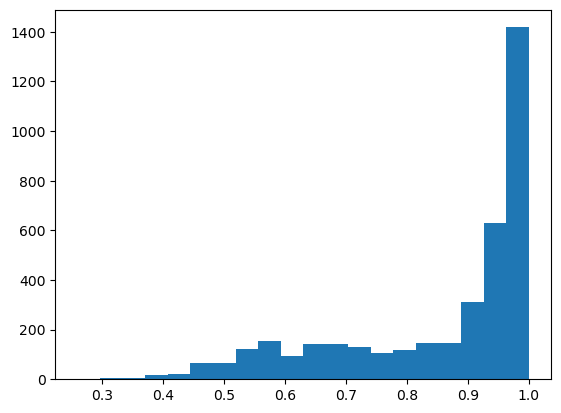

0.8526015625000001


In [33]:
r2_arr = []

for i in range(x_new_times_y_new):
    print("Index: ", i)
    r2_val = rSquared(y_test_imag[:, i], predictions_imag[:, i])
    print("R^2: ", r2_val)
    r2_arr.append(r2_val)
    #plt.plot(y_train[:, i], predictions_train[:, i] , color = 'blue', linewidth = 5, label = "Train", alpha = 0.2)
    #plt.plot(y_train[:, i], predictions_train[:, i]  ,'.', color = 'blue', linewidth = 0, label = "Train", alpha = 0.2)
    #plt.plot(y_test[:, i], predictions[:, i] , '.', markersize = 10, color = 'orange', label = "Test", alpha = 1)
    #plt.plot(y_test[:, i], y_test[:, i], color = "lightgreen", linewidth = 5, alpha = 0.5)


    #plt.xlabel('Ground Truth', fontname = 'Helvetica',fontsize = 30 )
    #plt.ylabel('Prediction', fontname = 'Helvetica',fontsize = 30  )

    #plt.xticks(fontsize = 17, fontname = 'Helvetica' )
    #plt.yticks(fontsize = 17, fontname = 'Helvetica' )
    #plt.ylim(4, 13)
    #plt.legend(loc='upper left', markerscale=40, prop={'size': 25, "family":'Times new roman'})
    #plt.grid()
    #plt.show()

plt.hist(r2_arr, bins = 20)
plt.show()
print(np.mean(r2_arr))

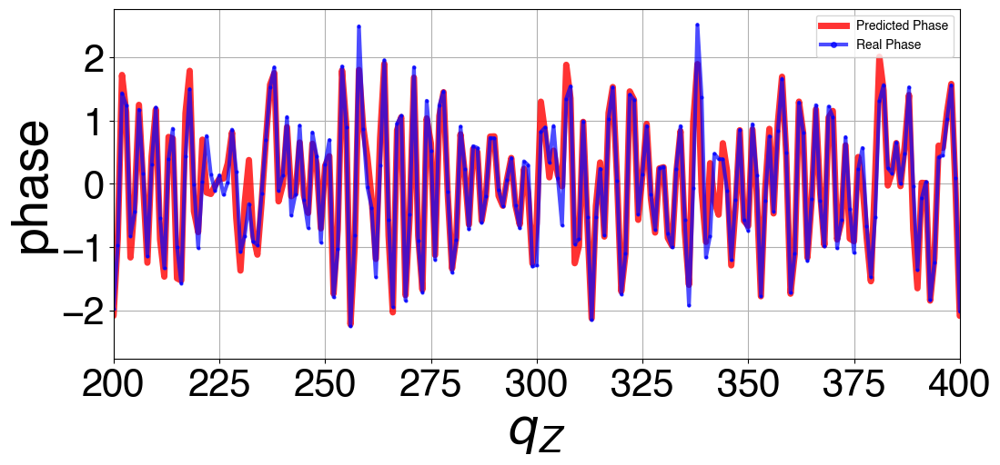

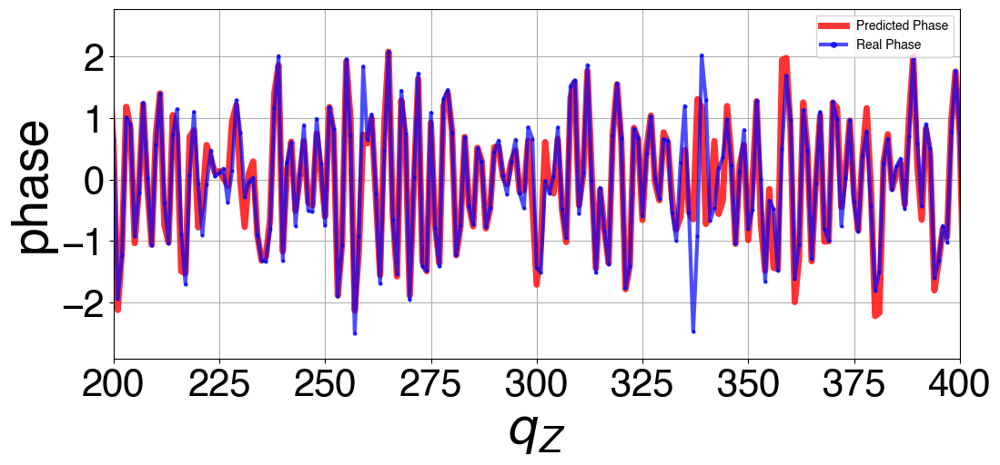

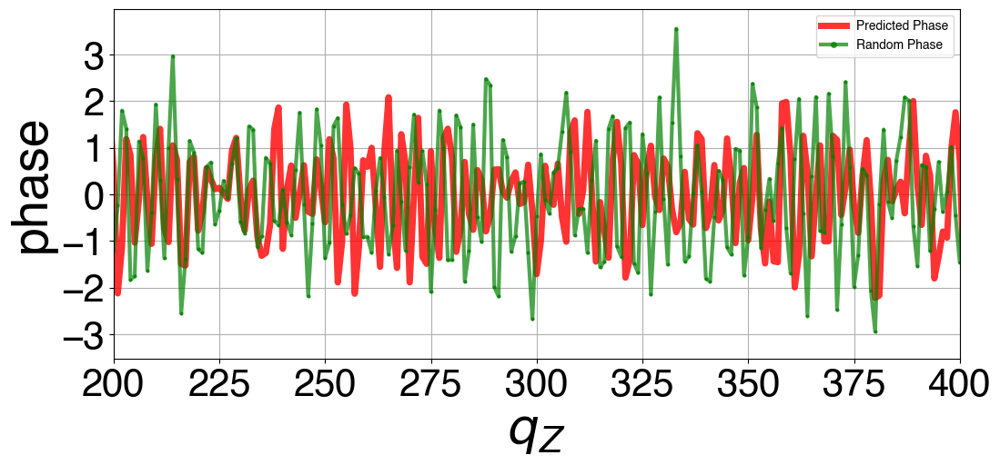

In [34]:
%matplotlib inline
i_rand = np.random.randint(0, 100)
index = 112

plt.figure(figsize=(12, 5))
linwW = 3
markSize = 0
plt.plot(predictions_real[index], color = 'red', label = "Predicted Phase", linewidth = linwW+2, alpha = 0.8, marker = 'o', markersize = markSize)

plt.plot(y_test_real[index], color = 'blue', label = "Real Phase", marker = 'o', markersize = 2, linewidth = 3, alpha = 0.7)

plt.xlabel('$q_{Z}$', fontname = 'Helvetica',fontsize = 40 )
plt.ylabel('phase', fontname = 'Helvetica',fontsize = 40  )
plt.xticks(fontsize = 30, fontname = 'Helvetica' )
plt.yticks(fontsize = 30, fontname = 'Helvetica' )
#plt.ylim(-2, 8)
plt.xlim(200, 400)
plt.legend(loc='upper right', markerscale=2, prop={'size': 10, "family":'Helvetica'})
plt.grid()
plt.show()


                
plt.figure(figsize=(12, 5))
linwW = 3
markSize = 0
plt.plot(predictions_imag[index], color = 'red', label = "Predicted Phase", linewidth = linwW+2, alpha = 0.8, marker = 'o', markersize = markSize)
plt.plot(y_test_imag[index], color = 'blue', label = "Real Phase", marker = 'o', markersize = 2, linewidth = 3, alpha = 0.7)
plt.xlabel('$q_{Z}$', fontname = 'Helvetica',fontsize = 40 )
plt.ylabel('phase', fontname = 'Helvetica',fontsize = 40  )
plt.xticks(fontsize = 30, fontname = 'Helvetica' )
plt.yticks(fontsize = 30, fontname = 'Helvetica' )
#plt.ylim(-2, 8)
plt.xlim(200, 400)
plt.legend(loc='upper right', markerscale=2, prop={'size': 10, "family":'Helvetica'})
plt.grid()
plt.show()


plt.figure(figsize=(12, 5))
linwW = 3
markSize = 0
plt.plot(predictions_imag[index], color = 'red', label = "Predicted Phase", linewidth = linwW+2, alpha = 0.8, marker = 'o', markersize = markSize)
plt.plot(y_test_imag[index+2], color = 'green', label = "Random Phase", marker = 'o', markersize = 2, linewidth = 3, alpha = 0.7)
plt.xlabel('$q_{Z}$', fontname = 'Helvetica',fontsize = 40 )
plt.ylabel('phase', fontname = 'Helvetica',fontsize = 40  )
plt.xticks(fontsize = 30, fontname = 'Helvetica' )
plt.yticks(fontsize = 30, fontname = 'Helvetica' )
#plt.ylim(-2, 8)
plt.xlim(200, 400)
plt.legend(loc='upper right', markerscale=2, prop={'size': 10, "family":'Helvetica'})
plt.grid()
plt.show()



# Getting all U(q) predictions

In [35]:
pred_U_q = []
real_U_q = []
rand_U_q = []

for i in range(len(predictions_real)):
    for j in range(len(predictions_real[0])):        
        predictions_real[i][j] = (predictions_real[i][j]*std_real[j]) + means_real[j]
        predictions_imag[i][j] = (predictions_imag[i][j]*std_imag[j]) + means_imag[j]
        
        y_test_real[i][j] = (y_test_real[i][j]*std_real[j]) + means_real[j]
        y_test_imag[i][j] = (y_test_imag[i][j]*std_imag[j]) + means_imag[j]
        
        
        
pred_U_q = predictions_real + 1j*predictions_imag
real_U_q = y_test_real + 1j*y_test_imag


qx_dim = xy_dim
qz_dim = z_dim
qx_dim = int(np.sqrt(qx_dim))

pred_U_q = np.array(pred_U_q).reshape(len(pred_U_q), qx_dim, qx_dim, qz_dim)
real_U_q = np.array(real_U_q).reshape(len(pred_U_q), qx_dim, qx_dim, qz_dim)


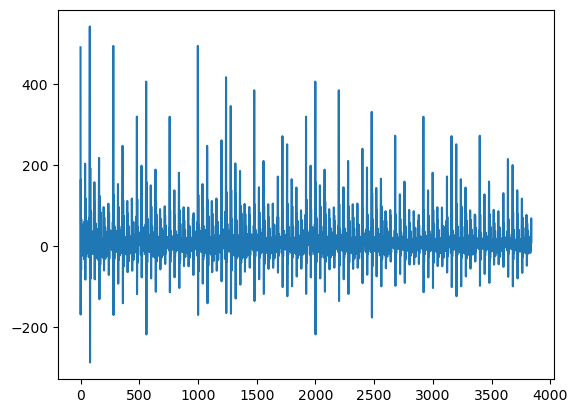

In [36]:
plt.plot(predictions_real[1])

# Plotting Scattering (in house)

In [37]:
#creating q mesh
pi = math.pi

#creating q mesh
dqz = 0.025 * (2*pi/a_bulk)
z_size = 6 * (2*pi/a_bulk)

rod_dimension = 4
dqxy = (2*pi)/a_SrTiO3
xy_size = (rod_dimension-1)*dqxy

#x = np.linspace(0, xy_size, round(xy_size/dqz))
#y = np.linspace(0, xy_size, round(xy_size/dqz))
x = np.linspace(0, xy_size, rod_dimension)
y = x
z = np.linspace(dqz, z_size, round(z_size/dqz))

[qx_pr, qy_pr, qz_pr] = np.meshgrid(x, y, z)

print("Dimension: ", qx_pr.shape[0], qx_pr.shape[1], qx_pr.shape[2] )
print("Total Points: ", qx_pr.shape[0]* qx_pr.shape[1]* qx_pr.shape[2])
print(z/(2*pi/a_bulk))

Dimension:  4 4 240
Total Points:  3840
[0.025 0.05  0.075 ... 5.95  5.975 6.   ]


In [38]:
#dx = 0.4
dx = 0.2
x_size = 15

dy = a_bulk/2
y_size = a_bulk

dz = 0.2
z_start = -10
z_end = 70

z_size = z_end - z_start #we want to see more in the z direction

xr = np.linspace(-x_size/2, x_size/2, int(x_size/dx))-dx
yr = np.linspace(dy, y_size, int(y_size/dy))-dy
#zr = np.linspace(-z_size/2, z_size/2, int(z_size/dz))-dz
zr = np.linspace(z_start, z_end, int(z_size/dz))-dz

[rx, ry, rz] = np.meshgrid(xr, yr, zr)
print("Dimension: ", rx.shape[0], ry.shape[1], rz.shape[2] )
print("Total Points: ", rx.shape[0]* ry.shape[1]* rz.shape[2])

Dimension:  2 75 400
Total Points:  60000


In [39]:
yr

array([0.    , 1.9525])

In [40]:
#below should be vectorized
qx_x_arr = []
qy_y_arr = []
qz_z_arr = []

for i in range(len(xr)):
    qx_x_arr.append(xr[i]*qx_pr)

for i in range(len(yr)):
    qy_y_arr.append(yr[i]*qy_pr)
    
for i in range(len(zr)):
    qz_z_arr.append(zr[i]*qz_pr)

In [41]:
def Eq_to_pr(Eq):
    pr = np.empty(rx.shape,dtype=np.complex_)
    for i in range(len(rx)):
        for j in range(len(rx[0])):
            for k in range(len(rx[0][0])):
              
                #make these beforehand
                Mr = np.exp(-1j * (qx_x_arr[j] + qy_y_arr[i] + qz_z_arr[k]))
                pr[i][j][k] = np.sum(Eq * Mr)
    return pr

# Gaussian Window

In [42]:
def create_3d_symmetric_gaussian(std_dev, array_size):
    #if len(array_size) != 3 or array_size[0] != array_size[1] or array_size[1] != array_size[2]:
        #raise ValueError("Array size should be a tuple with three equal dimensions.")

    x, y, z = np.meshgrid(
        np.linspace(-1, 1, array_size[0]),
        np.linspace(-1, 1, array_size[1]),
        np.linspace(-1, 1, array_size[2])
    )

    r_squared = x**2 + y**2 + z**2
    gaussian = np.exp(-0.5 * (r_squared / std_dev**2))
    
    max_value = 1.0
    gaussian /= gaussian.max()  # Normalize to have max value of 1
    
    return gaussian

array_size = real_U_q[0].shape

In [43]:
def create_3d_symmetric_gaussian_diff_z(std_dev_xy, std_dev_z, array_size):
    x, y, z = np.meshgrid(
        np.linspace(-1, 1, array_size[0]),
        np.linspace(-1, 1, array_size[1]),
        np.linspace(-1, 1, array_size[2])
    )

    r_squared_xy = x**2 + y**2
    r_squared_z = z**2
    gaussian_xy = np.exp(-0.5 * (r_squared_xy / std_dev_xy**2))
    gaussian_z = np.exp(-0.5 * (r_squared_z / std_dev_z**2))
    
    gaussian = gaussian_xy * gaussian_z

    max_value = 1.0
    gaussian /= gaussian.max()  # Normalize to have max value of 1
    
    return gaussian


# STD = 0.75

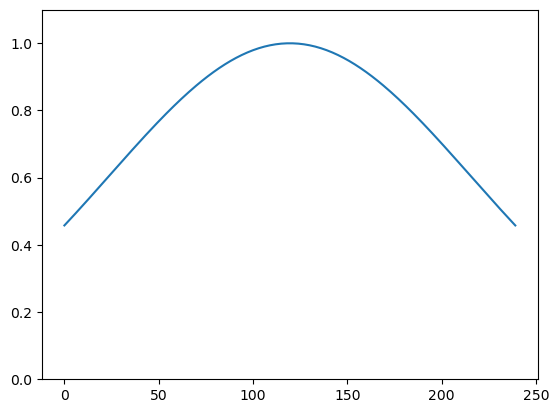

In [44]:
std_dev = 0.75  # Adjust this value to control the spread of the Gaussian
gaussian_window_filter = create_3d_symmetric_gaussian_diff_z(0.7, 0.8, array_size)
plt.plot(gaussian_window_filter[1][1])
plt.ylim(0, 1.1)
plt.show()

In [45]:
create_3d_symmetric_gaussian(0.7, array_size).shape

(4, 4, 240)

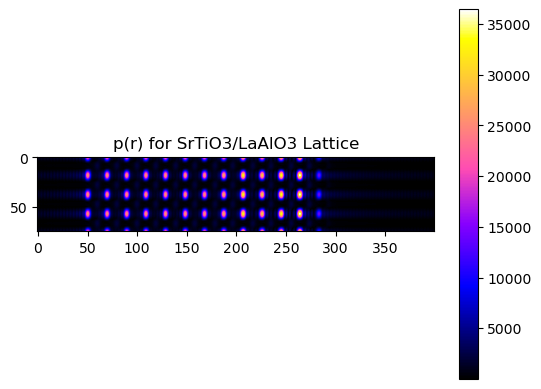

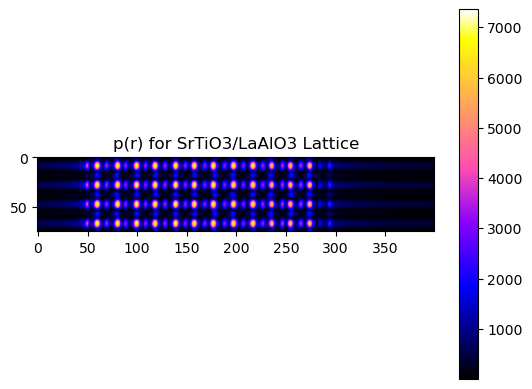

In [46]:
index = 10

pr_test = Eq_to_pr(gaussian_window_filter*real_U_q[index])


plt.imshow((np.abs(pr_test[0])), cmap = 'gnuplot2')
plt.title("p(r) for SrTiO3/LaAlO3 Lattice")
plt.colorbar()
#plt.clim(0, 5000)
plt.show()

plt.imshow((np.abs(pr_test[1])), cmap = 'gnuplot2')
plt.title("p(r) for SrTiO3/LaAlO3 Lattice")
plt.colorbar()
#plt.clim(0, 5000)


# Atomic Position Extraction

In [47]:
def gaussian(x, amplitude, mean, std_dev):
    return amplitude * np.exp(-(x - mean) ** 2 / (2 * std_dev ** 2))

# Applying ifft and obtaining predictions

In [48]:
qx_pr.shape

(4, 4, 240)

In [49]:
#goal = method that returns p(r) once given the 4x4x240 U(q)

#1. internal zero padding
dqz = 0.025 * (2*pi/a_bulk)

dqx = 0.2 * (2*pi/a_bulk)

z_size = 6 * (2*pi/a_bulk)

rod_dimension = 4
dqxy = (2*pi)/a_SrTiO3
xy_size = (rod_dimension-1)*(2*pi/a_bulk)

x = np.linspace(0, xy_size, round(xy_size/dqx)+1)
y = np.linspace(0, xy_size, round(xy_size/dqx)+1)
z = np.linspace(dqz, z_size, round(z_size/dqz))

[qx_pr, qy_pr, qz_pr] = np.meshgrid(x, y, z)


def internal_zero_pad(U_q):

    E_q_real_FULL = np.zeros(qx_pr.shape,dtype=np.complex_ )

    for i in range(len(E_q_real_FULL)):
        for j in range(len(E_q_real_FULL[0])):
            if ((np.isclose((x[i]/((2*pi/a_bulk))) % 1,0.0) or np.isclose((x[i]/((2*pi/a_bulk))) % 1,1.0))
                and (np.isclose((y[j]/((2*pi/a_bulk))) % 1,0.0) or np.isclose((y[j]/((2*pi/a_bulk))) % 1,1.0))):
                
                divisor = (1/dqx)* (2*pi/a_bulk)
                #print(divisor)
                rod_x = int((i+1)/divisor)
                rod_y = int((j+1)/divisor) 
                
                #rod_x = int((i+1)/40)
                #rod_y = int((j+1)/40) 

                E_q_real_FULL[i][j] = U_q[rod_x][rod_y]
                
    return E_q_real_FULL


#2. xyz symmetries
def perovskite_sym_xyz(internally_padded_U_q):
    nx, ny, nz = internally_padded_U_q.shape
    shift_xy = int((2*nx - 1)/2)
    shift_z = int((2*nz + 1)/2)
    divisor = (1/dqx)* (2*pi/a_bulk)
    symmetric_real_U_q = np.zeros(((2*nx - 1,2*ny - 1, 2*nz+1)),dtype=np.complex_)

    for xi in range(len(symmetric_real_U_q)):
        for yi in range(len(symmetric_real_U_q[0])):
            for zi in range(len(symmetric_real_U_q[0][0])):

                #fixing the qx = 0 issue 
                if xi % divisor == 0 and yi %divisor == 0 and zi-shift_z == 0:
                    symmetric_real_U_q[xi][yi][zi] = 600

                elif zi-shift_z > 0:
                    symmetric_real_U_q[xi][yi][zi] = internally_padded_U_q[abs(xi-shift_xy)][abs(yi-shift_xy)][abs(zi-shift_z)-1]
                else:
                    symmetric_real_U_q[xi][yi][zi] = np.conjugate(internally_padded_U_q[abs(xi-shift_xy)][abs(yi-shift_xy)][abs(zi-shift_z)-1])
    
    return symmetric_real_U_q

#Externally zero padding

def pad_3d_array(array, pad_x, pad_y, pad_z):
  
    padded_array = np.pad(array, ((pad_x, pad_x), (pad_y, pad_y), (pad_z, pad_z)), mode='constant')
    return padded_array

def pad_3d_array_uneven(array, pad_x, pad_y, pad_z):
  
    padded_array = np.pad(array, ((pad_x, pad_x+1), (pad_y, pad_y+1), (pad_z, pad_z+1)), mode='constant')
    return padded_array

def np_ifft_full_process(U_q):
    #padx = 135
    #pady = 135
    #padz = 271

    padx = 60
    pady = 60
    padz = 1000
    std_dev = 0.1  # Adjust this value to control the spread of the Gaussian
    std_dev_xy = 0.1
    std_dev_z = 0.05
    E_q_real_FULL = internal_zero_pad(U_q)
    symmetric_real_U_q = perovskite_sym_xyz(E_q_real_FULL)
    #padded_real_U_q = pad_3d_array_uneven(symmetric_real_U_q, padx, pady, padz)
    padded_real_U_q = pad_3d_array(symmetric_real_U_q, padx, pady, padz)
    
    array_size = padded_real_U_q.shape

    #gaussian_window_filter = create_3d_symmetric_gaussian(std_dev, array_size)
    gaussian_window_filter = create_3d_symmetric_gaussian_diff_z(std_dev_xy, std_dev_z, array_size)
    raw_ifft = np.fft.ifftn((padded_real_U_q*gaussian_window_filter))
    return raw_ifft
    

In [50]:
print((512 - 241-1)/2)
print((1024-481-1)/2)

135.0
271.0


In [51]:
z_size

9.654061931645971

In [52]:
pr_test = np_ifft_full_process(real_U_q[0])
pr_test.shape

(151, 151, 2481)

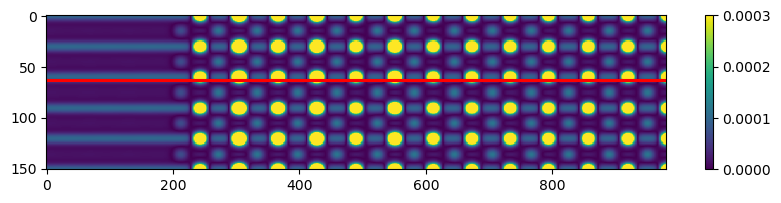

In [53]:
pr_abs = np.abs(pr_test)
plt.figure(figsize=(10, 2))
plt.imshow(pr_abs[0][:, 1500:], interpolation='nearest', aspect='auto')
plt.axhline(63, color = 'red')
plt.axhline(64, color = 'red')

plt.colorbar()
plt.clim(0, 0.0003)
#plt.xlim(0, 424)
#plt.ylim(0,424)
plt.show()


In [54]:
pr_test.shape
from pylab import *
#sys.getsizeof(pr_abs[14][:, 1500:])
pr_abs[14][:, 1500:].nbytes/1e9


0.001185048

In [55]:
"""
Config That works:

padx = 60
pady = 60
padz = 1000
std_dev_xy = 0.1
std_dev_z = 0.05
0 and 14 are good slices

"""

'\nConfig That works:\n\npadx = 60\npady = 60\npadz = 1000\nstd_dev_xy = 0.1\nstd_dev_z = 0.05\n0 and 14 are good slices\n\n'

# Extracting Positions

In [56]:
N_z = pr_test.shape[2]
delta_r = (2*pi*(1/dqz) )/N_z
print("Angstroms per pixel: ", delta_r)

Angstroms per pixel:  0.06295848448206368


In [57]:
def fit_p_r_new(pr_slice, start, a_space):

    gaussian_fits_y = np.zeros(20*len(pr_slice))
    gaussian_fits_x = np.linspace(0, len(pr_slice)-1,  20*len(pr_slice))
    points_around_max = 5
    
    #pixel_ratio = 0.1525390625
    pixel_ratio = 0.06293311845286059
    #pixel_ratio = 0.03485829056014282
    atomic_spacings = []
    N = len(pr_slice)
    means = []
    right = []
    left = []
    for atom in range(N_bulk+N_surface):
        i = start + atom*a_space
        interval = pr_slice[i:i+a_space]
        max_ind = np.argmax(interval)
        
        
        #atomic_section = interval[max_ind - points_around_max: max_ind + points_around_max+1]
        
        atomic_section = pr_slice[i+max_ind - points_around_max:i+max_ind + points_around_max+1]
        
        
        #fitting gaussian
        num_points = len(atomic_section)
        x_d = np.arange(num_points)        
        #print("Interval: ", interval)
        #print("Max ind: ", max_ind)
        params, covariance = curve_fit(gaussian, x_d, atomic_section, p0=[1, 3, 3])
        
        
        amplitude, mean, std_dev = params
        
        
        means.append(mean)
        right.append(a_space - (max_ind + points_around_max))
        left.append(max_ind - points_around_max)
        
        gaussian_fits_y += gaussian(gaussian_fits_x, amplitude, mean+left[atom]+i, std_dev)
        
        #print(amplitude, mean+left[atom]+i, std_dev)
       
        
    for i in range(N_bulk+N_surface-1):
        index_space = right[i] + left[i+1] + (2*points_around_max - means[i]) + means[i+1]
        atomic_spacings.append(pixel_ratio * index_space)
        
        
    return atomic_spacings, gaussian_fits_y


In [58]:
pr_real = []
for i in tqdm(range(50)):
    pr_temp = np.abs(np_ifft_full_process(real_U_q[i]))
    pr_real.append([ pr_temp[0][:, 1500:], pr_temp[14][:, 1500:]])
    #pr_real.append([ pr_temp[13][0:100, 1600:], pr_temp[19][0:100, 1600:]])
    del pr_temp

100%|█████████████████████████████████████████████████████████████████| 50/50 [06:12<00:00,  7.45s/it]


In [59]:
pr_real = np.array(pr_real)

In [60]:
pr_pred = []
for i in tqdm(range(50)):
    pr_temp = np.abs(np_ifft_full_process(pred_U_q[i]))
    pr_pred.append([ pr_temp[0][:, 1500:], pr_temp[14][:, 1500:]])
    #pr_real.append([ pr_temp[13][0:100, 1600:], pr_temp[19][0:100, 1600:]])
    del pr_temp

100%|█████████████████████████████████████████████████████████████████| 50/50 [05:48<00:00,  6.96s/it]


In [61]:
pr_pred = np.array(pr_pred)

# Sr

In [62]:
index = 0

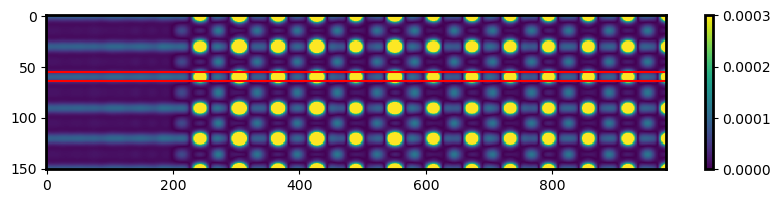

In [129]:
plt.figure(figsize=(10, 2))
plt.imshow(pr_pred[0][0], interpolation='nearest', aspect='auto')
plt.axhline(55, color = 'red')
plt.axhline(64, color = 'red')

plt.colorbar()
plt.clim(0, 0.0003)
#plt.xlim(0, 424)
#plt.ylim(0,424)
plt.show()


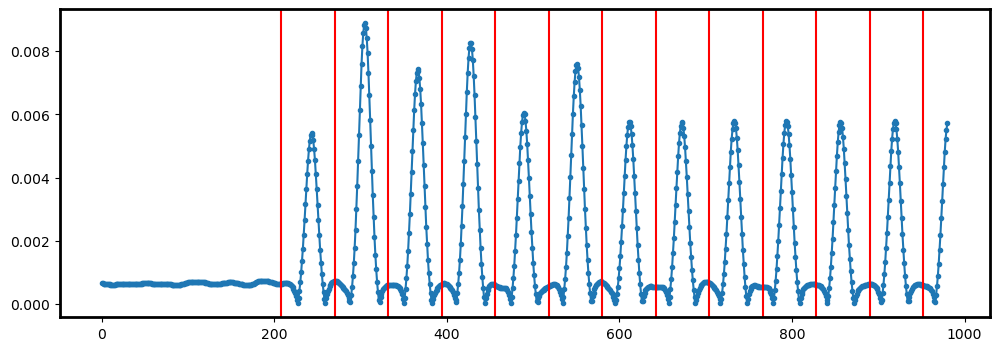

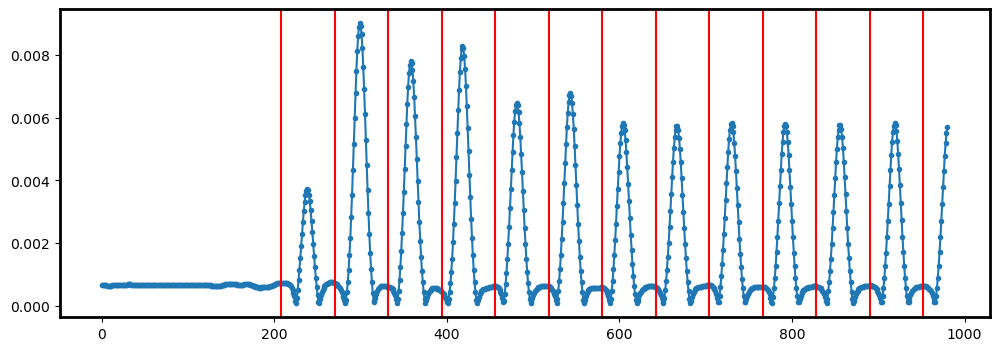

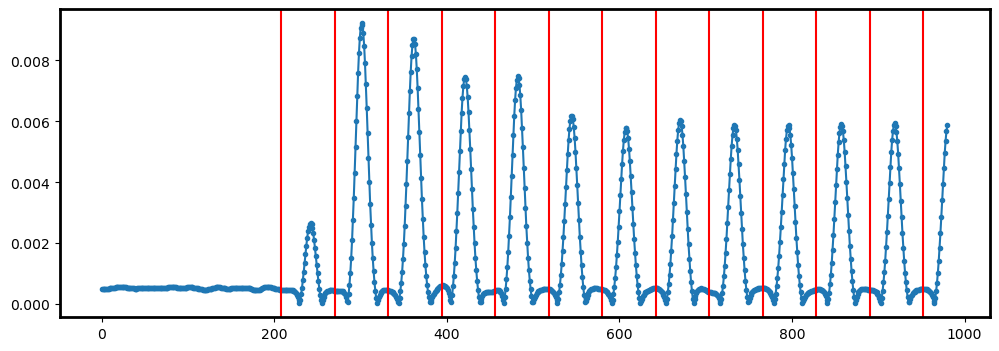

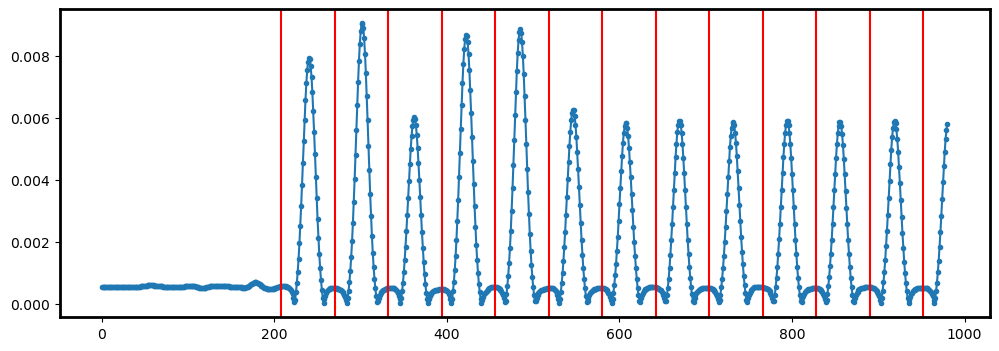

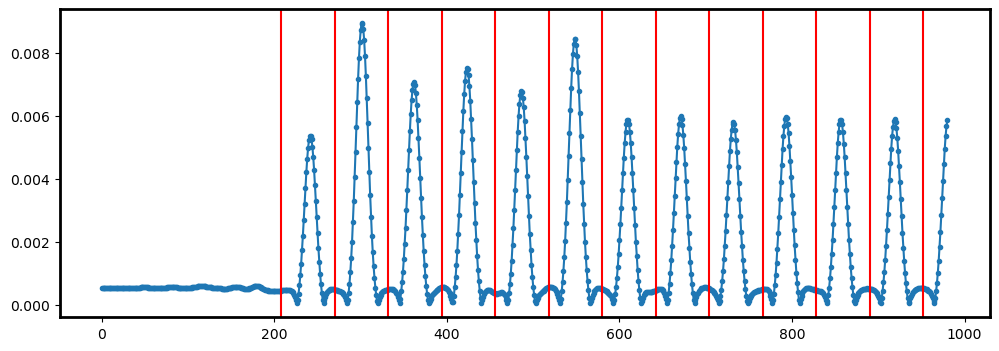

...

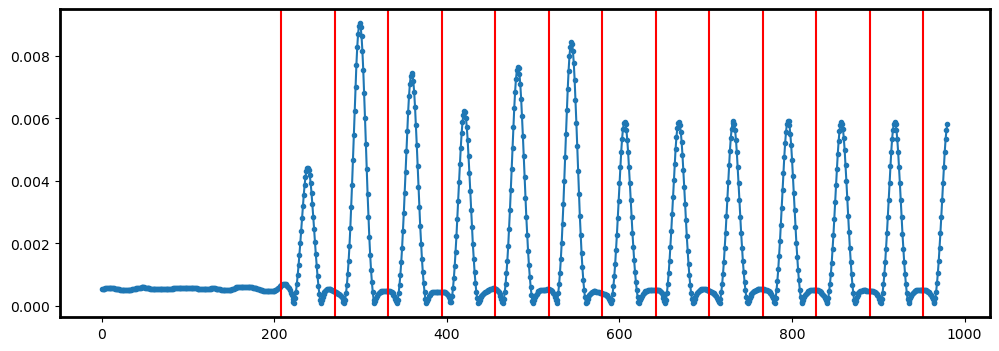

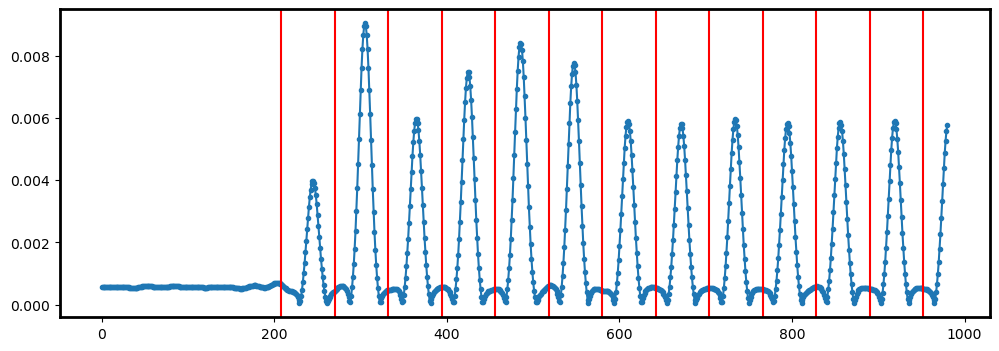

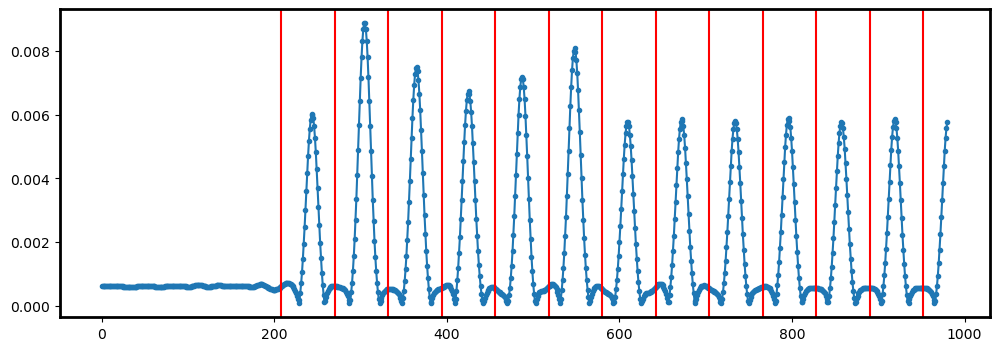

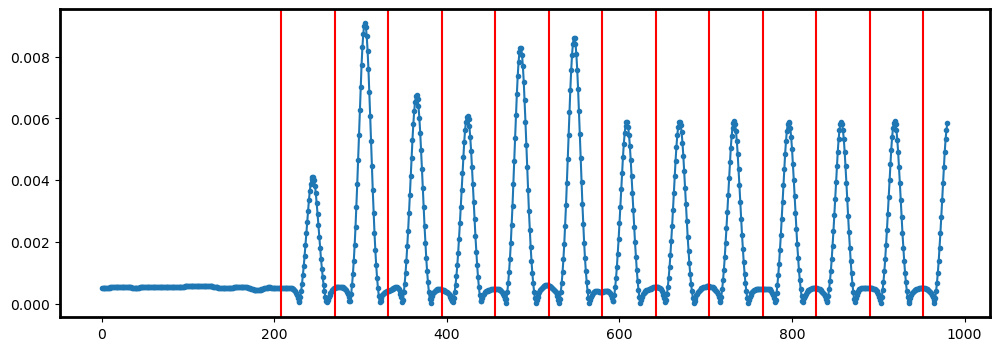

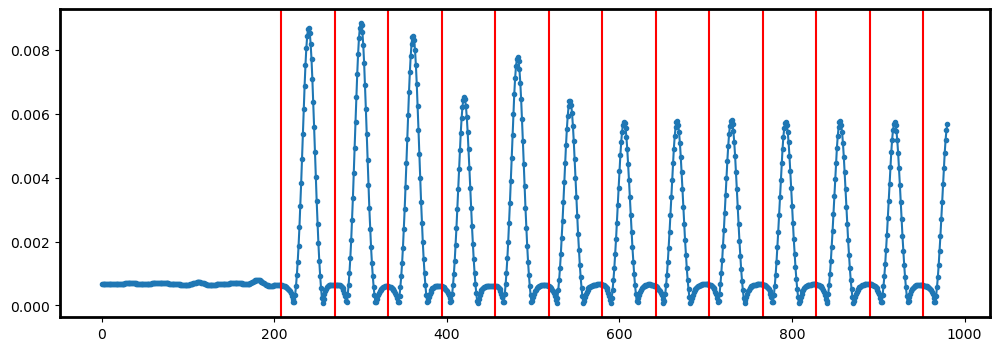

In [132]:
for j in range(50):

    plt.figure(figsize=(12, 4))
    pr_slice_Sr = np.sum(pr_pred[j][0][55:64], axis = 0)
    #pr_slice_Sr = np.sum(pr_real[index][0][59:62], axis = 0)
    plt.plot(pr_slice_Sr, '.-')


    start = 270 -62
    spacing = 62
    #start = 172
    #spacing = 62
    for i in range(N_bulk+N_surface): 
        plt.axvline(start + i*spacing, color = "red")

    plt.show()

In [134]:
start = 270 -62
a_space = 62
real_cns = []
pred_cns = []

for i in range(len(pr_real)):
    pr_slice_Sr = np.sum(pr_real[i][0][55:64], axis = 0)
    spacings, gaus_fit = fit_p_r_new(pr_slice_Sr, start, a_space)
    spacings = np.flip(spacings)
    real_cns.append(spacings)

for i in range(len(pr_pred)):
    print(i)
    pr_slice_Sr = np.sum(pr_pred[i][0][55:64], axis = 0)
    spacings, gaus_fit = fit_p_r_new(pr_slice_Sr, start, a_space)
    spacings = np.flip(spacings)
    pred_cns.append(spacings)
    
real_cns = np.array(real_cns)
pred_cns = np.array(pred_cns)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49


Index:  1
R^2:  1.0


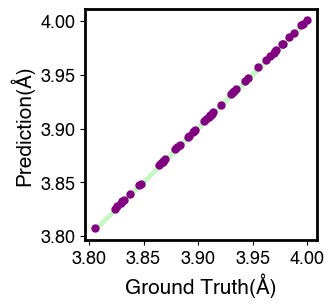

Index:  2
R^2:  1.0


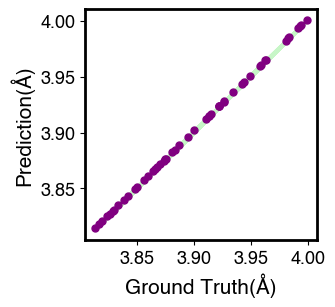

Index:  3
R^2:  1.0


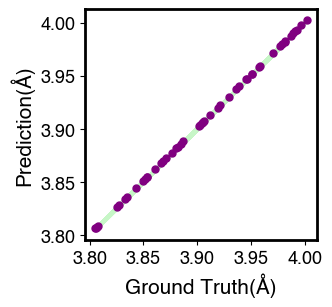

Index:  4
R^2:  1.0


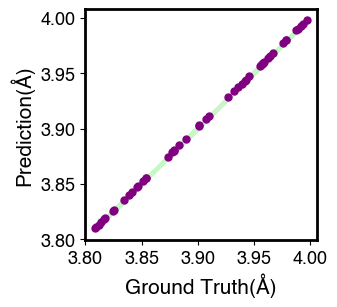

Index:  5
R^2:  1.0


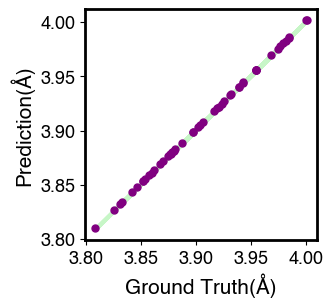

Index:  6
R^2:  1.0


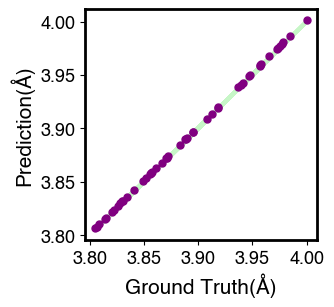

Index:  7
R^2:  1.0


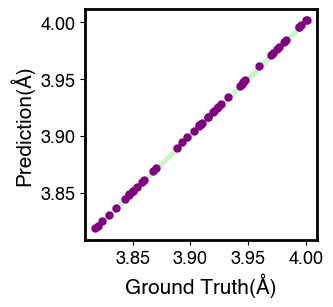

Index:  8
R^2:  1.0


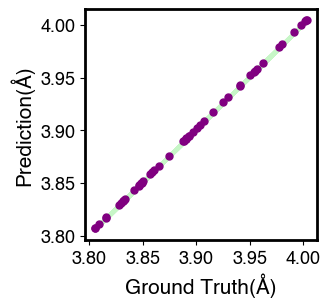

Index:  9
R^2:  1.0


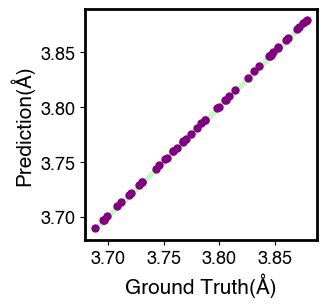

Index:  10
R^2:  1.0


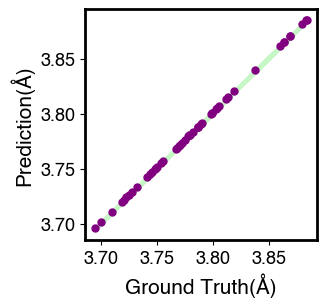

Index:  11
R^2:  1.0


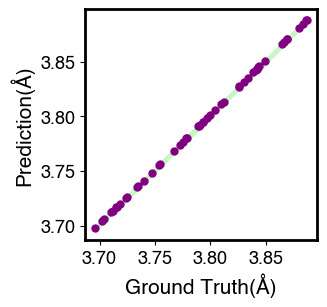

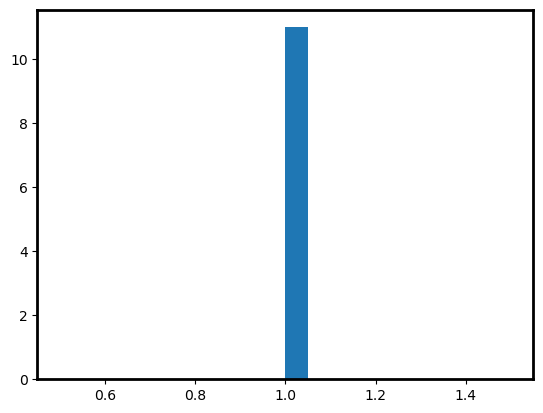

In [135]:
input_cns = np.array(all_cns[train_size:train_size+50])
r2_arr_pr = []

for i in range(N_bulk+N_surface-1):
    #First layer spacing doesn't change since dummy layer
    if i == 0:
        continue
    print("Index: ", i)
    r2_val = rSquared(real_cns[:, i], input_cns[:, i])
    print("R^2: ", r2_val)
    r2_arr_pr.append(r2_val)
    #plt.plot(y_train[:, i], predictions_train[:, i] , color = 'blue', linewidth = 5, label = "Train", alpha = 0.2)
    #plt.plot(y_train[:, i], predictions_train[:, i]  ,'.', color = 'blue', linewidth = 0, label = "Train", alpha = 0.2)
    
    fig = plt.figure(figsize = (3, 3))
    plt.rcParams['axes.linewidth'] = 2
    plt.plot(real_cns[:, i], real_cns[:, i], color = "lightgreen", linewidth = 3, alpha = 0.5)

    plt.plot(real_cns[:, i], input_cns[:, i] , '.', markersize = 10, color = 'purple', label = "Test", alpha = 1)


    plt.xlabel('Ground Truth(Å)', fontname = 'Helvetica',fontsize = 15 )
    plt.ylabel('Prediction(Å)', fontname = 'Helvetica',fontsize = 15  )

    plt.xticks(fontsize = 13, fontname = 'Helvetica' )
    plt.yticks(fontsize = 13, fontname = 'Helvetica' )
    #plt.ylim(4, 13)
    #plt.legend(loc='upper left', markerscale=2, prop={'size': 25, "family":'Times new roman'})
    #plt.grid()
    plt.show()

plt.hist(r2_arr_pr, bins = 20)
plt.show()
    

Index:  1
R^2:  0.98


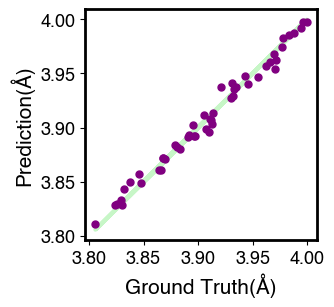

Index:  2
R^2:  0.97


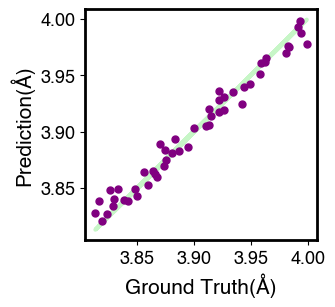

Index:  3
R^2:  0.96


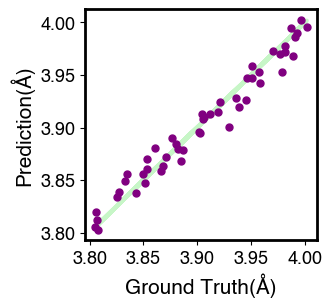

Index:  4
R^2:  0.95


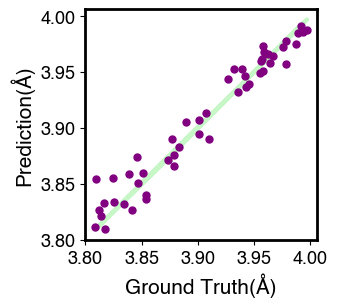

Index:  5
R^2:  0.91


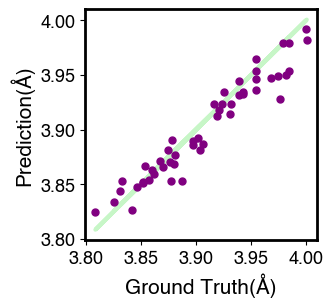

Index:  6
R^2:  0.94


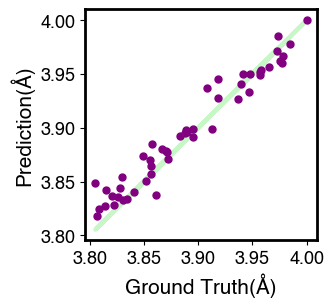

Index:  7
R^2:  0.94


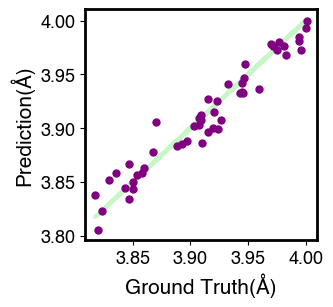

Index:  8
R^2:  0.93


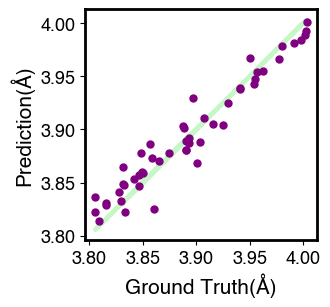

Index:  9
R^2:  0.93


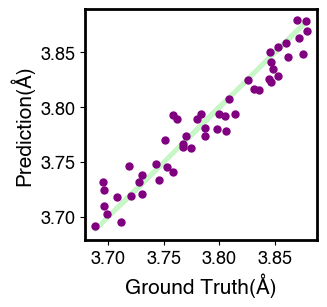

Index:  10
R^2:  0.88


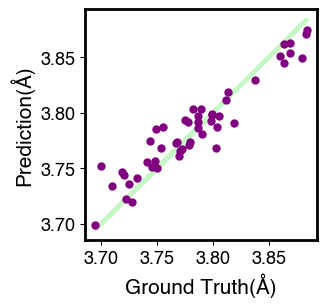

Index:  11
R^2:  0.88


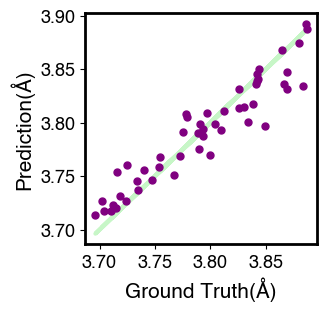

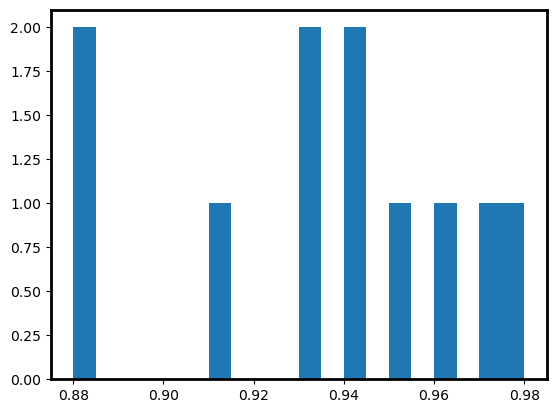

0.9336363636363637


In [136]:
r2_arr_pr_cn = []

for i in range(N_bulk+N_surface-1):
    #First layer spacing doesn't change since dummy layer
    if i == 0:
        continue
    print("Index: ", i)
    r2_val = rSquared(real_cns[:, i], pred_cns[:, i])
    print("R^2: ", r2_val)
    r2_arr_pr_cn.append(r2_val)
    #plt.plot(y_train[:, i], predictions_train[:, i] , color = 'blue', linewidth = 5, label = "Train", alpha = 0.2)
    #plt.plot(y_train[:, i], predictions_train[:, i]  ,'.', color = 'blue', linewidth = 0, label = "Train", alpha = 0.2)
    
    fig = plt.figure(figsize = (3, 3))
    plt.rcParams['axes.linewidth'] = 2
    plt.plot(real_cns[:, i], real_cns[:, i], color = "lightgreen", linewidth = 3, alpha = 0.5)

    plt.plot(real_cns[:, i], pred_cns[:, i] , '.', markersize = 10, color = 'purple', label = "Test", alpha = 1)


    plt.xlabel('Ground Truth(Å)', fontname = 'Helvetica',fontsize = 15 )
    plt.ylabel('Prediction(Å)', fontname = 'Helvetica',fontsize = 15  )

    plt.xticks(fontsize = 13, fontname = 'Helvetica' )
    plt.yticks(fontsize = 13, fontname = 'Helvetica' )
    #plt.ylim(4, 13)
    #plt.legend(loc='upper left', markerscale=2, prop={'size': 25, "family":'Times new roman'})
    #plt.grid()
    plt.show()

plt.hist(r2_arr_pr_cn, bins = 20)
plt.show()
print(np.mean(r2_arr_pr_cn))

# O1

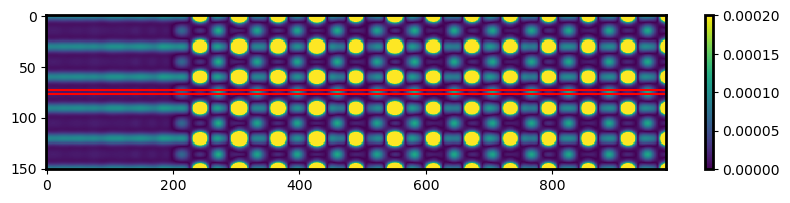

In [137]:
plt.figure(figsize=(10, 2))
plt.imshow(pr_pred[0][0], interpolation='nearest', aspect='auto')
plt.axhline(73, color = 'red')
plt.axhline(77, color = 'red')

plt.colorbar()
plt.clim(0, 0.0002)
#plt.xlim(0, 424)
#plt.ylim(0,424)
plt.show()


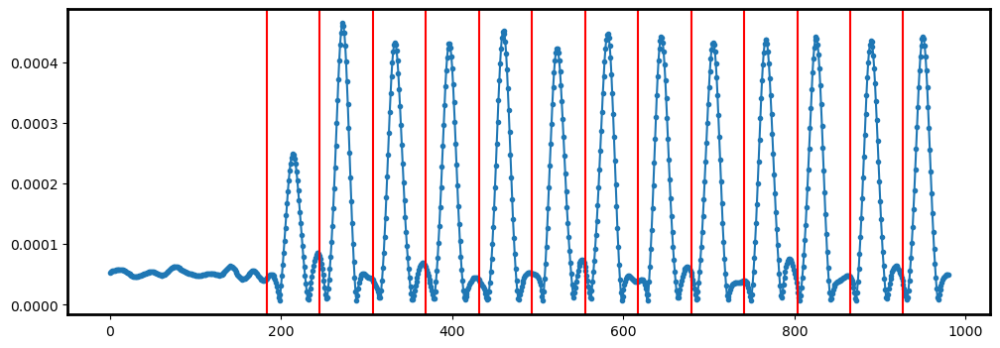

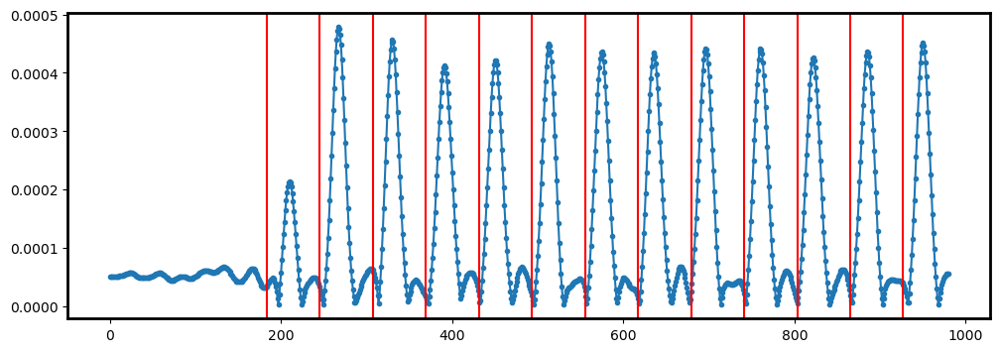

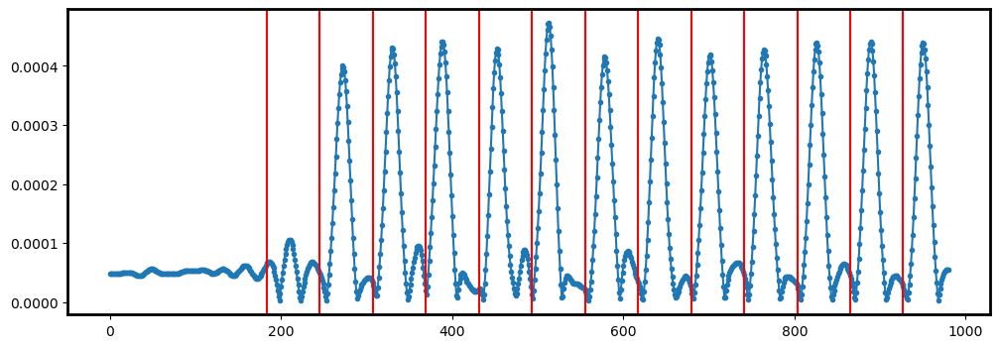

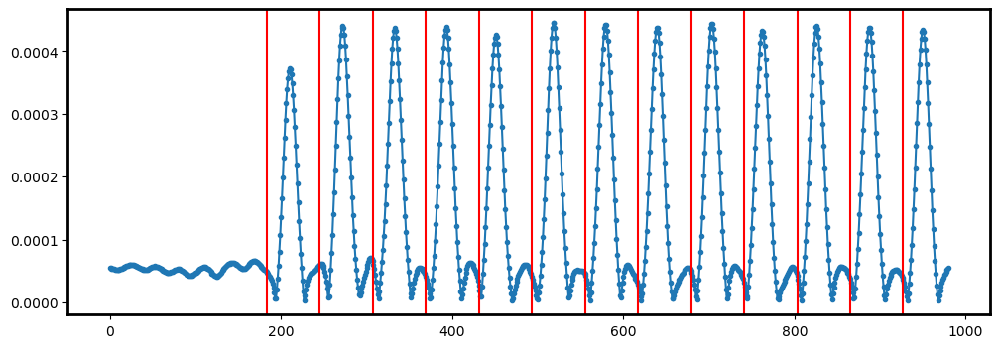

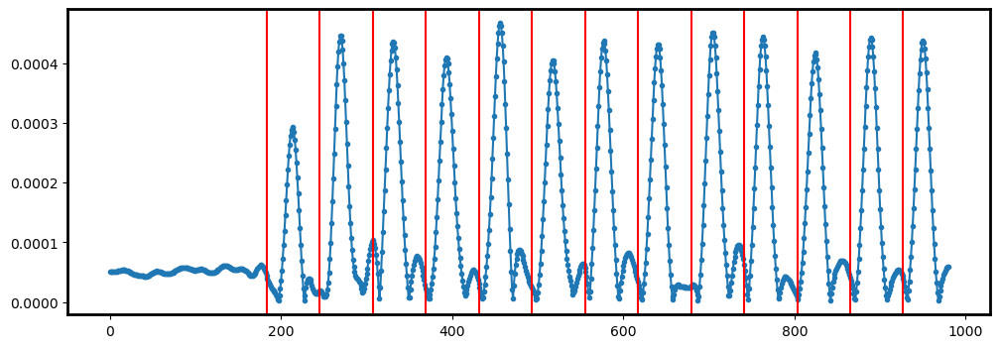

...

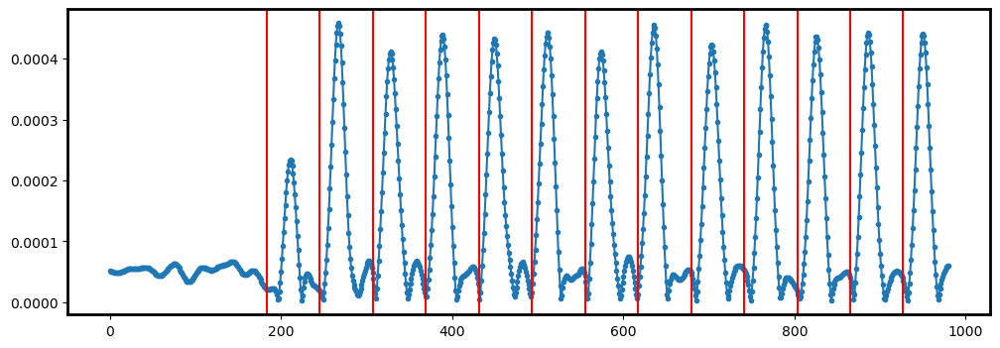

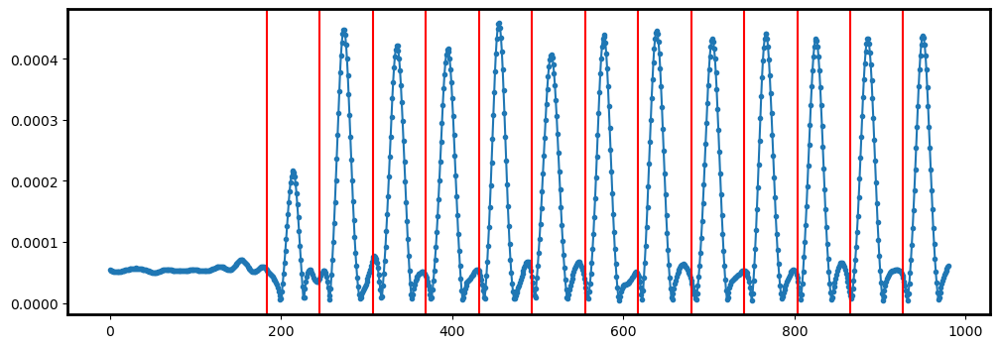

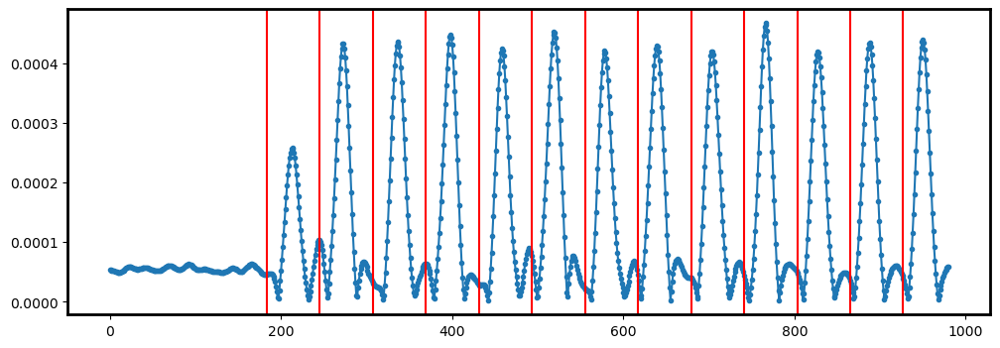

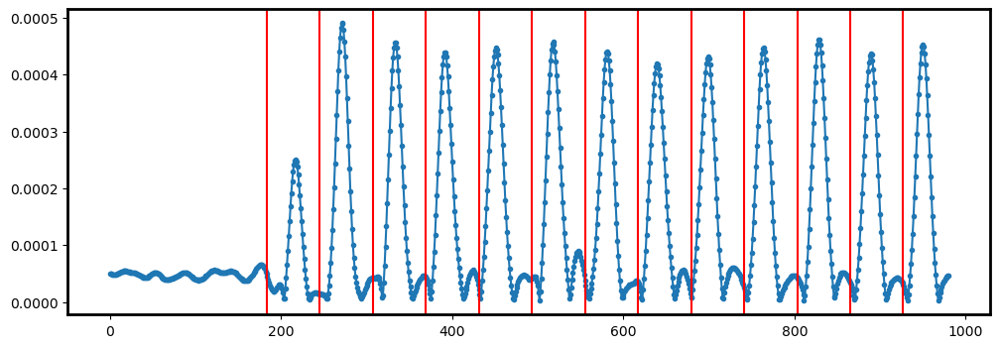

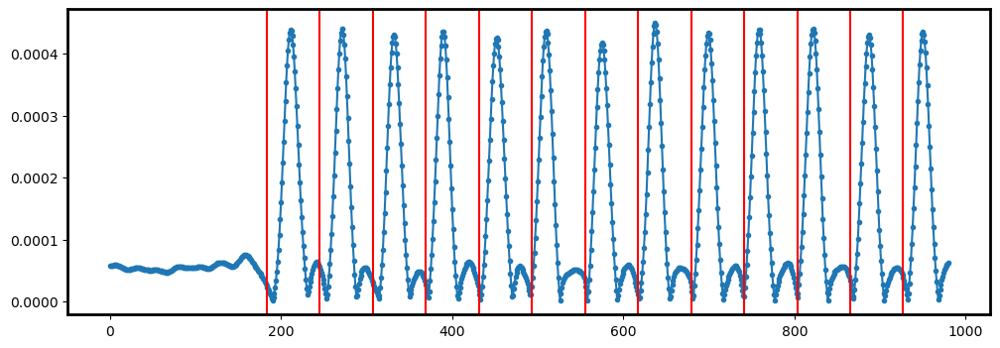

In [138]:
for j in range(50):

    plt.figure(figsize=(12, 4))
    pr_slice_O1 = np.sum(pr_pred[j][0][73:77], axis = 0)
    #pr_slice_O1 = np.sum(pr_real[index][0][63:64], axis = 0)
    plt.plot(pr_slice_O1, '.-')


    start = 245-62
    spacing = 62
    #start = 145
    #spacing = 62
    for i in range(N_bulk+N_surface): 
        plt.axvline(start + i*spacing, color = "red")

    plt.show()

In [140]:
start = 245 -62
a_space = 62
real_o1s = []
pred_o1s = []

for i in range(len(pr_real)):
    pr_slice_o1 = np.sum(pr_real[i][0][73:77], axis = 0)
    spacings, gaus_fit = fit_p_r_new(pr_slice_o1, start, a_space)
    spacings = np.flip(spacings)
    real_o1s.append(spacings)

for i in range(len(pr_pred)):
    print(i)
    pr_slice_o1 = np.sum(pr_pred[i][0][73:77], axis = 0)
    spacings, gaus_fit = fit_p_r_new(pr_slice_o1, start, a_space)
    spacings = np.flip(spacings)
    pred_o1s.append(spacings)
    
real_o1s = np.array(real_o1s)
pred_o1s = np.array(pred_o1s)


0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49


In [141]:
real_o1s.shape

(50, 12)

Index:  0
R^2:  1.0


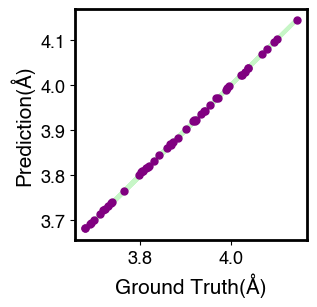

Index:  1
R^2:  1.0


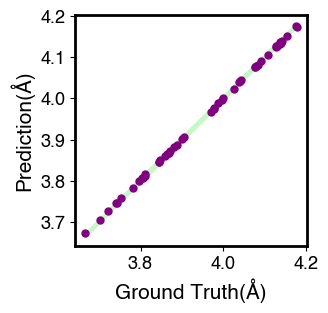

Index:  2
R^2:  1.0


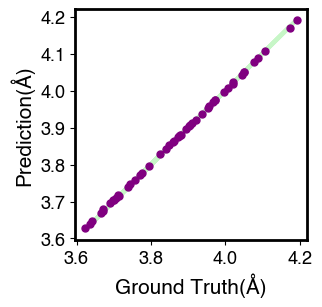

Index:  3
R^2:  1.0


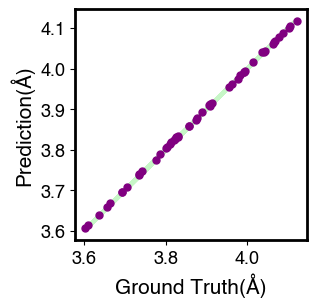

Index:  4
R^2:  1.0


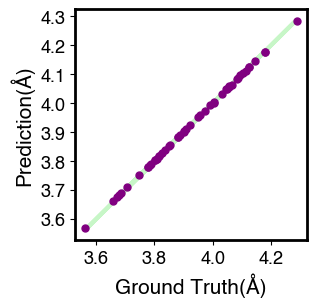

Index:  5
R^2:  1.0


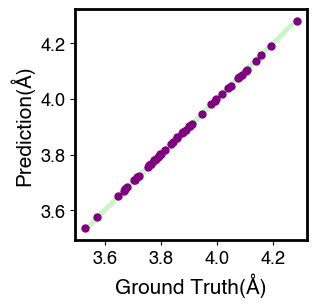

Index:  6
R^2:  1.0


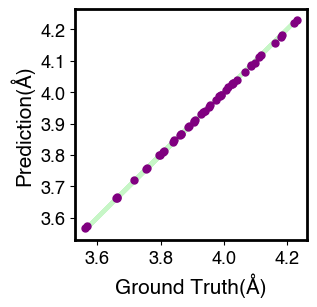

Index:  7
R^2:  1.0


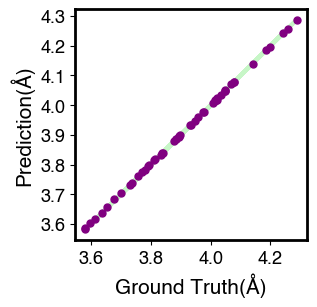

Index:  8
R^2:  1.0


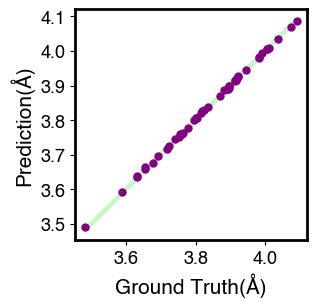

Index:  9
R^2:  1.0


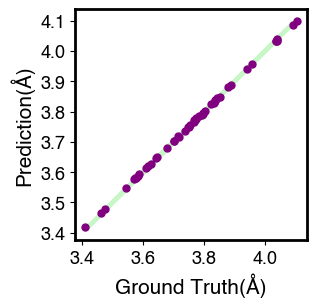

Index:  10
R^2:  1.0


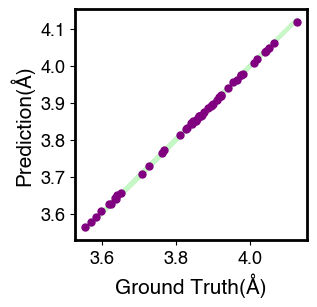

Index:  11
R^2:  1.0


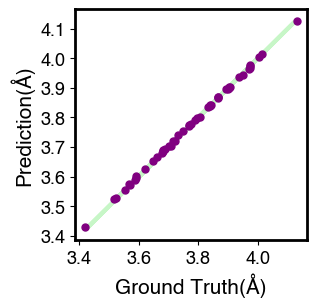

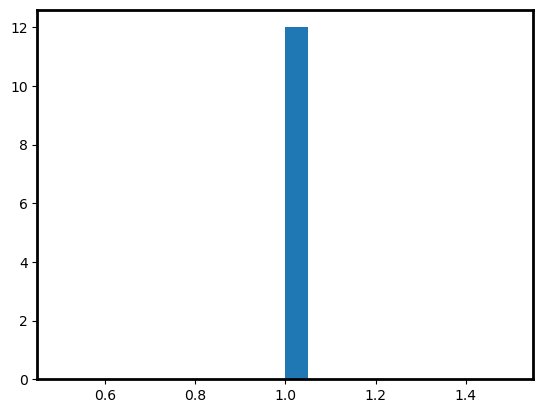

1.0


In [142]:
input_o1s = np.array(all_o1s[train_size:train_size+50])
r2_arr_pr = []

for i in range(N_bulk+N_surface-1):

    print("Index: ", i)
    r2_val = rSquared(real_o1s[:, i], input_o1s[:, i+1])
    print("R^2: ", r2_val)
    r2_arr_pr.append(r2_val)
    #plt.plot(y_train[:, i], predictions_train[:, i] , color = 'blue', linewidth = 5, label = "Train", alpha = 0.2)
    #plt.plot(y_train[:, i], predictions_train[:, i]  ,'.', color = 'blue', linewidth = 0, label = "Train", alpha = 0.2)
    
    fig = plt.figure(figsize = (3, 3))
    plt.rcParams['axes.linewidth'] = 2
    plt.plot(real_o1s[:, i], real_o1s[:, i], color = "lightgreen", linewidth = 3, alpha = 0.5)

    plt.plot(real_o1s[:, i], input_o1s[:, i+1] , '.', markersize = 10, color = 'purple', label = "Test", alpha = 1)


    plt.xlabel('Ground Truth(Å)', fontname = 'Helvetica',fontsize = 15 )
    plt.ylabel('Prediction(Å)', fontname = 'Helvetica',fontsize = 15  )

    plt.xticks(fontsize = 13, fontname = 'Helvetica' )
    plt.yticks(fontsize = 13, fontname = 'Helvetica' )
    #plt.ylim(4, 13)
    #plt.legend(loc='upper left', markerscale=2, prop={'size': 25, "family":'Times new roman'})
    #plt.grid()
    plt.show()

plt.hist(r2_arr_pr, bins = 20)
plt.show()
print(np.mean(r2_arr_pr))

Index:  0
R^2:  0.96


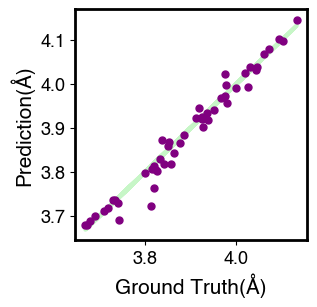

Index:  1
R^2:  0.87


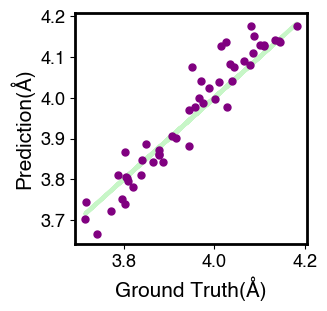

Index:  2
R^2:  0.84


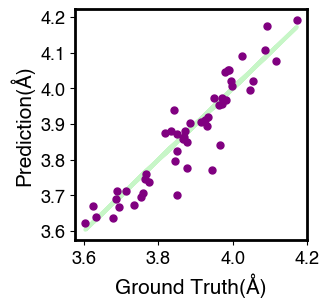

Index:  3
R^2:  0.81


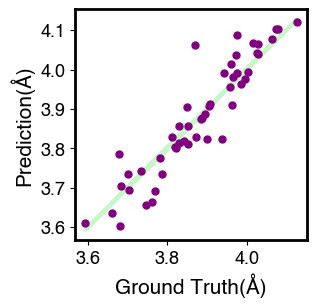

Index:  4
R^2:  0.81


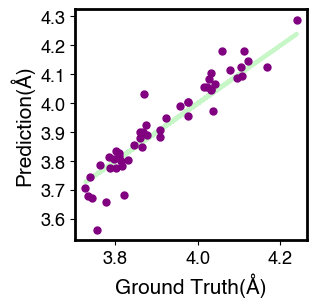

Index:  5
R^2:  0.79


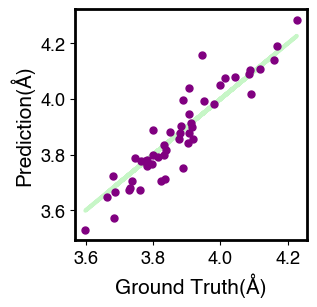

Index:  6
R^2:  0.77


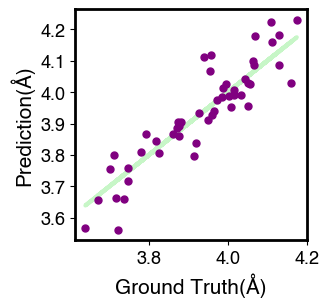

Index:  7
R^2:  0.79


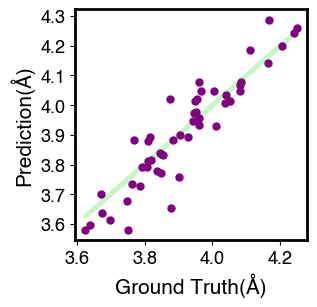

Index:  8
R^2:  0.7


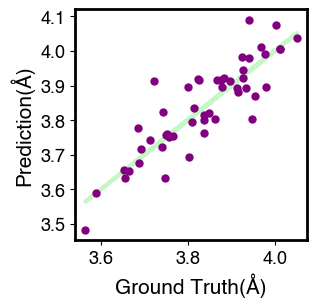

Index:  9
R^2:  0.78


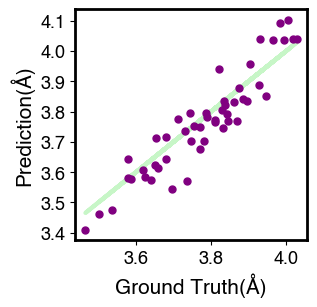

Index:  10
R^2:  0.79


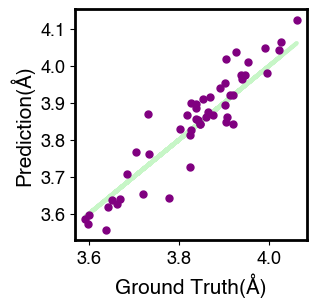

Index:  11
R^2:  0.66


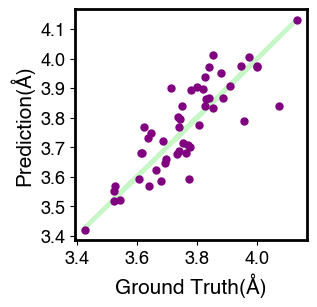

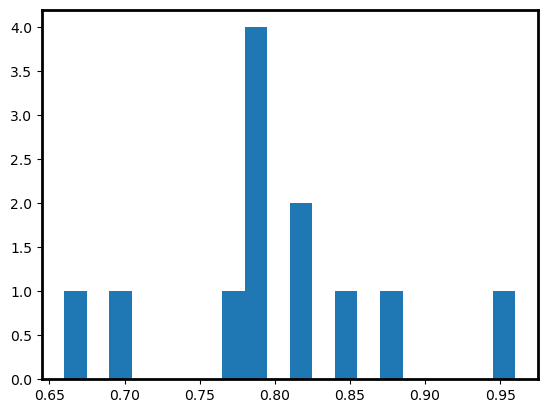

0.7975


In [143]:
r2_arr_pr_o1 = []

for i in range(N_bulk+N_surface-1):

    print("Index: ", i)
    r2_val = rSquared(pred_o1s[:, i], real_o1s[:, i])
    print("R^2: ", r2_val)
    r2_arr_pr_o1.append(r2_val)
    #plt.plot(y_train[:, i], predictions_train[:, i] , color = 'blue', linewidth = 5, label = "Train", alpha = 0.2)
    #plt.plot(y_train[:, i], predictions_train[:, i]  ,'.', color = 'blue', linewidth = 0, label = "Train", alpha = 0.2)
    
    fig = plt.figure(figsize = (3, 3))
    plt.rcParams['axes.linewidth'] = 2
    plt.plot(pred_o1s[:, i], pred_o1s[:, i], color = "lightgreen", linewidth = 3, alpha = 0.5)

    plt.plot(pred_o1s[:, i], real_o1s[:, i] , '.', markersize = 10, color = 'purple', label = "Test", alpha = 1)


    plt.xlabel('Ground Truth(Å)', fontname = 'Helvetica',fontsize = 15 )
    plt.ylabel('Prediction(Å)', fontname = 'Helvetica',fontsize = 15  )

    plt.xticks(fontsize = 13, fontname = 'Helvetica' )
    plt.yticks(fontsize = 13, fontname = 'Helvetica' )
    #plt.ylim(4, 13)
    #plt.legend(loc='upper left', markerscale=2, prop={'size': 25, "family":'Times new roman'})
    #plt.grid()
    plt.show()

plt.hist(r2_arr_pr_o1, bins = 20)
plt.show()
print(np.mean(r2_arr_pr_o1))

# O2

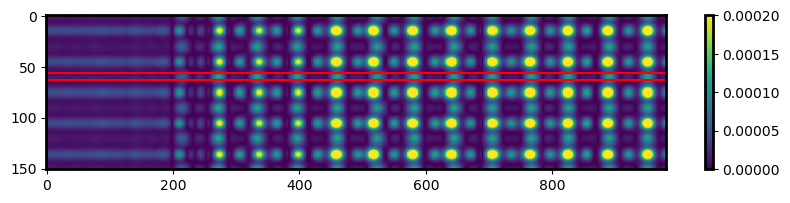

In [74]:
plt.figure(figsize=(10, 2))
plt.imshow(pr_pred[0][1], interpolation='nearest', aspect='auto')
plt.axhline(56, color = 'red')
plt.axhline(63, color = 'red')

plt.colorbar()
plt.clim(0, 0.0002)
#plt.xlim(0, 424)
#plt.ylim(0,424)
plt.show()


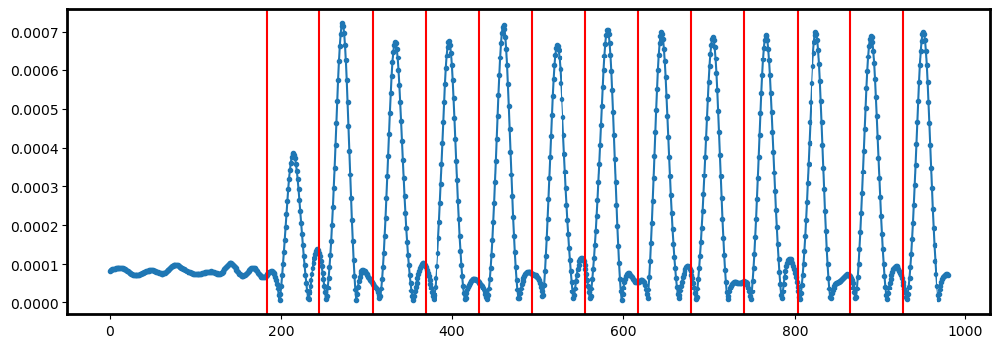

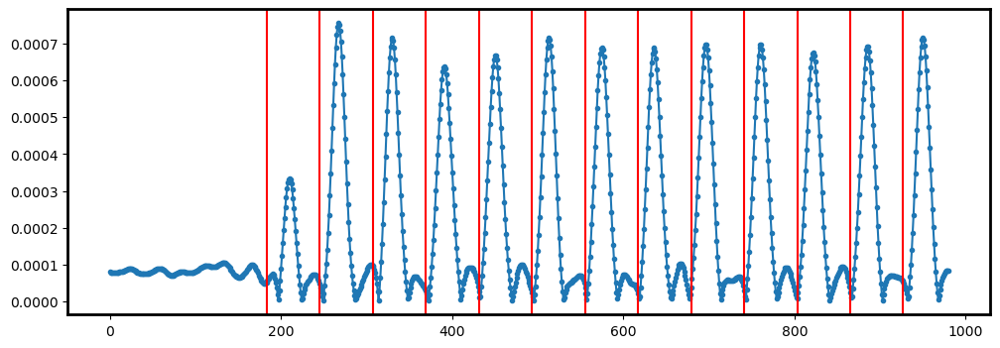

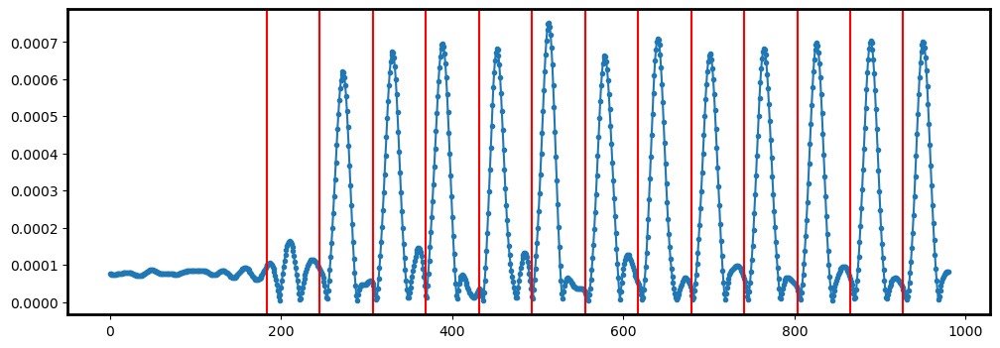

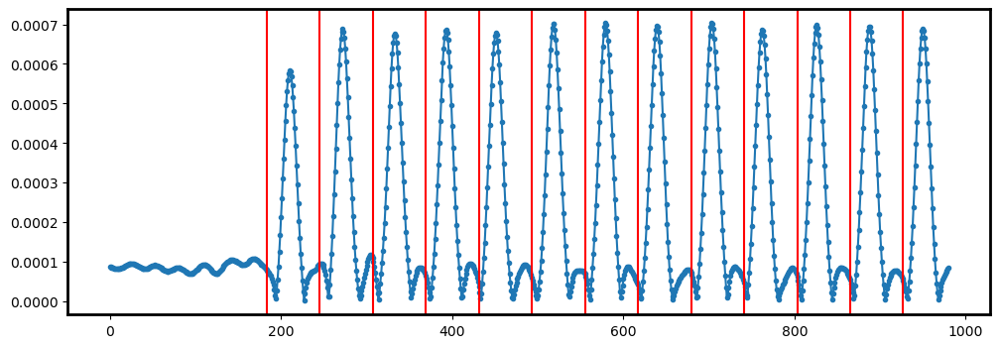

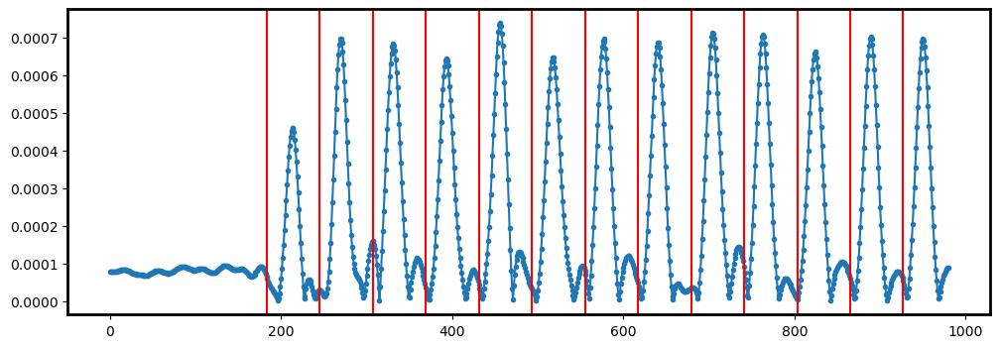

...

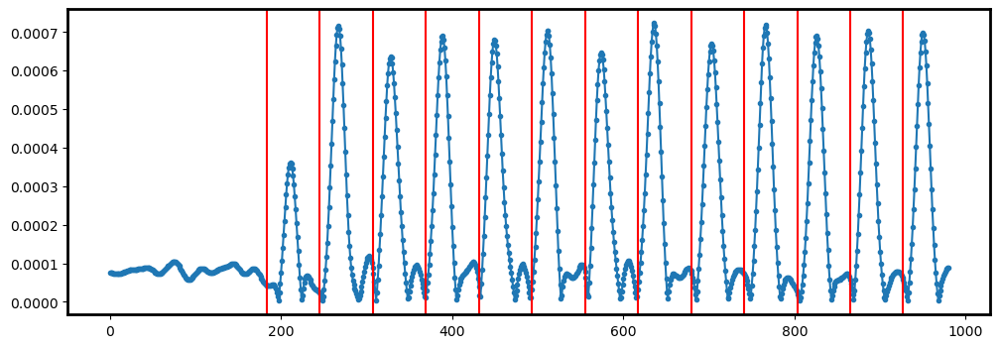

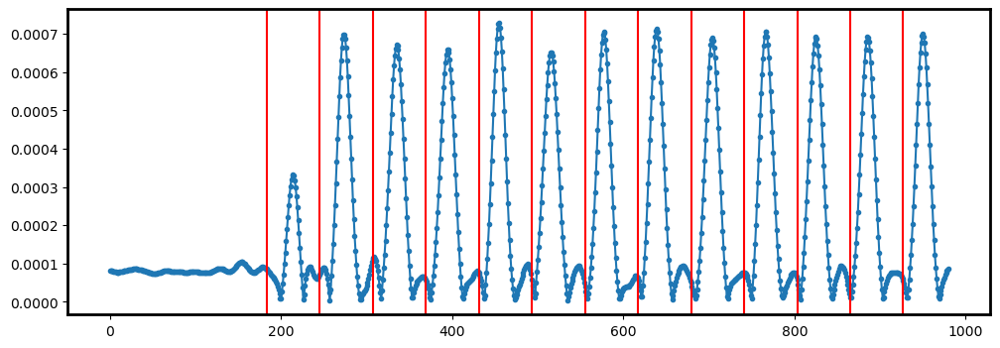

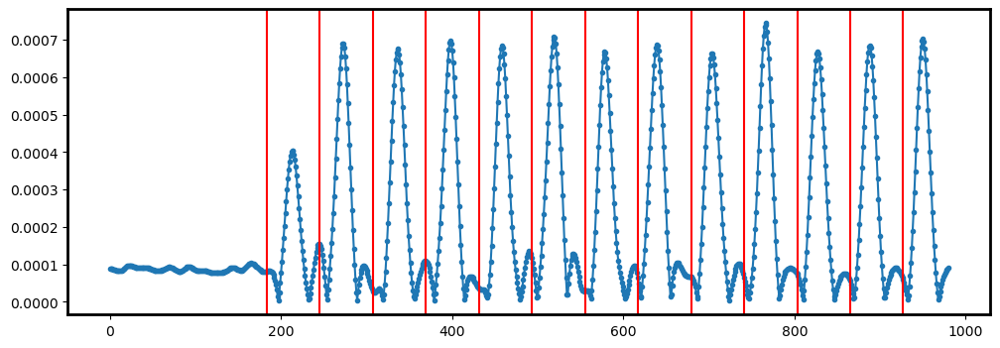

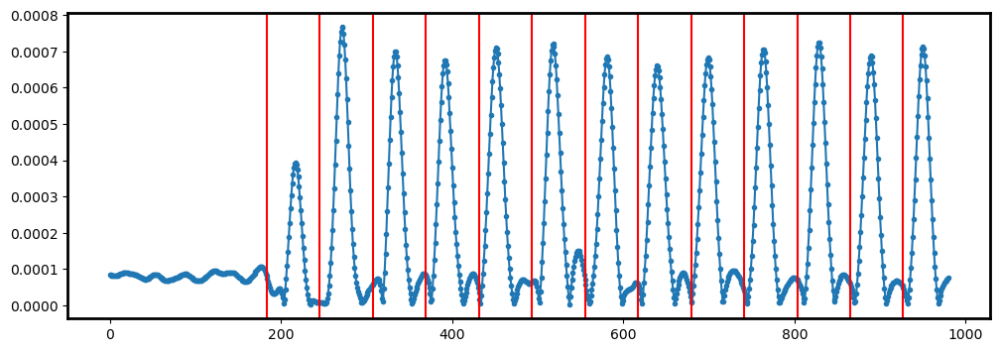

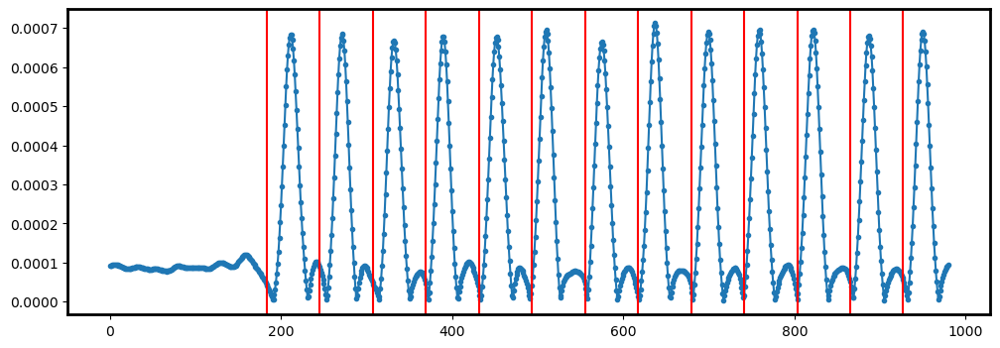

In [144]:
for j in range(50):

    plt.figure(figsize=(12, 4))
    pr_slice_O2 = np.sum(pr_pred[j][1][56:63], axis = 0)
    #pr_slice_O1 = np.sum(pr_real[index][0][63:64], axis = 0)
    plt.plot(pr_slice_O2, '.-')


    start = 245 - 62
    spacing = 62
    #start = 145
    #spacing = 62
    for i in range(N_bulk+N_surface): 
        plt.axvline(start + i*spacing, color = "red")

    plt.show()

In [145]:
start = 245 - 62
a_space = 62
real_o2s = []
pred_o2s = []

for i in range(len(pr_real)):
    pr_slice_o2 = np.sum(pr_real[i][1][56:63], axis = 0)
    spacings, gaus_fit = fit_p_r_new(pr_slice_o2, start, a_space)
    spacings = np.flip(spacings)
    real_o2s.append(spacings)

for i in range(len(pr_pred)):
    print(i)
    pr_slice_o2 = np.sum(pr_pred[i][1][56:63], axis = 0)
    spacings, gaus_fit = fit_p_r_new(pr_slice_o2, start, a_space)
    spacings = np.flip(spacings)
    pred_o2s.append(spacings)
    
real_o2s = np.array(real_o2s)
pred_o2s = np.array(pred_o2s)


0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49


Index:  0
R^2:  1.0


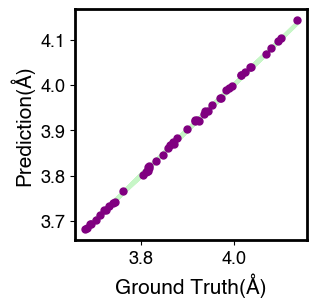

Index:  1
R^2:  1.0


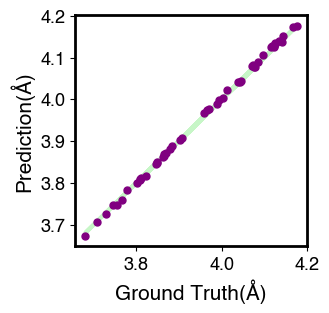

Index:  2
R^2:  1.0


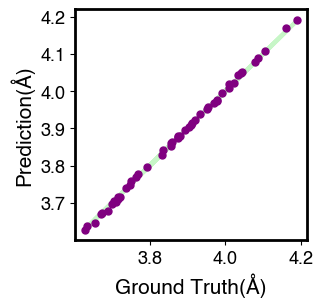

Index:  3
R^2:  1.0


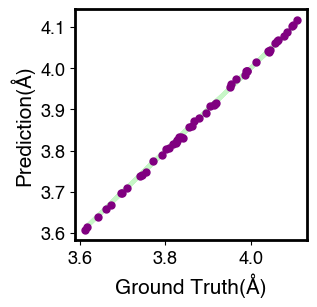

Index:  4
R^2:  1.0


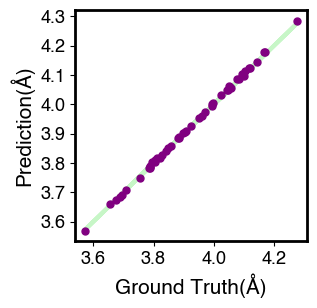

Index:  5
R^2:  1.0


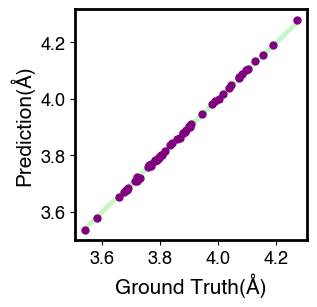

Index:  6
R^2:  1.0


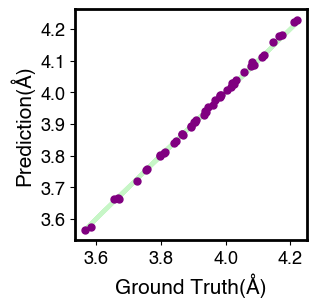

Index:  7
R^2:  1.0


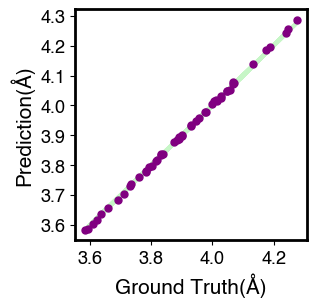

Index:  8
R^2:  1.0


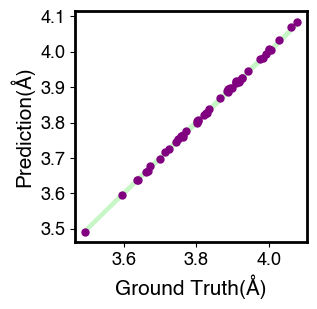

Index:  9
R^2:  1.0


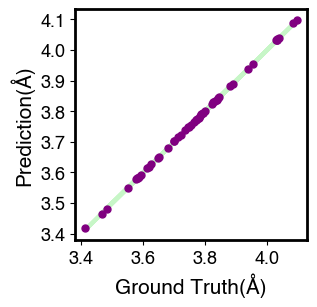

Index:  10
R^2:  1.0


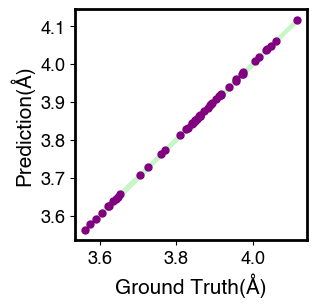

Index:  11
R^2:  1.0


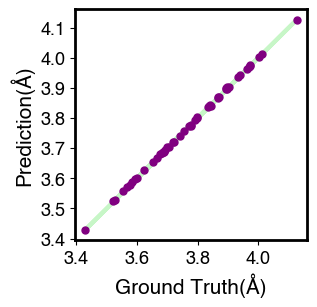

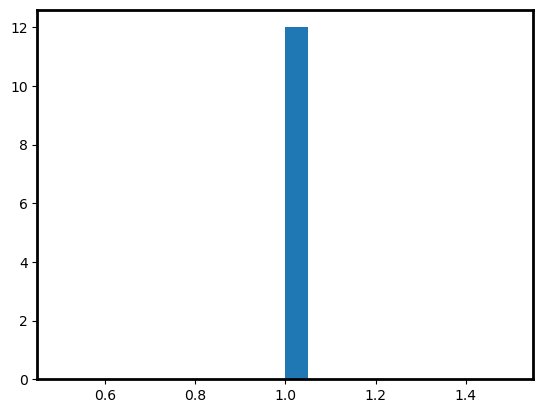

1.0


In [146]:
input_o2s = np.array(all_o2s[train_size:train_size+50])
r2_arr_pr = []

for i in range(N_bulk+N_surface-1):

    print("Index: ", i)
    r2_val = rSquared(real_o2s[:, i], input_o2s[:, i+1])
    print("R^2: ", r2_val)
    r2_arr_pr.append(r2_val)
    #plt.plot(y_train[:, i], predictions_train[:, i] , color = 'blue', linewidth = 5, label = "Train", alpha = 0.2)
    #plt.plot(y_train[:, i], predictions_train[:, i]  ,'.', color = 'blue', linewidth = 0, label = "Train", alpha = 0.2)
    
    fig = plt.figure(figsize = (3, 3))
    plt.rcParams['axes.linewidth'] = 2
    plt.plot(real_o2s[:, i], real_o2s[:, i], color = "lightgreen", linewidth = 3, alpha = 0.5)

    plt.plot(real_o2s[:, i], input_o2s[:, i+1] , '.', markersize = 10, color = 'purple', label = "Test", alpha = 1)


    plt.xlabel('Ground Truth(Å)', fontname = 'Helvetica',fontsize = 15 )
    plt.ylabel('Prediction(Å)', fontname = 'Helvetica',fontsize = 15  )

    plt.xticks(fontsize = 13, fontname = 'Helvetica' )
    plt.yticks(fontsize = 13, fontname = 'Helvetica' )
    #plt.ylim(4, 13)
    #plt.legend(loc='upper left', markerscale=2, prop={'size': 25, "family":'Times new roman'})
    #plt.grid()
    plt.show()

plt.hist(r2_arr_pr, bins = 20)
plt.show()
print(np.mean(r2_arr_pr))

Index:  0
R^2:  0.96


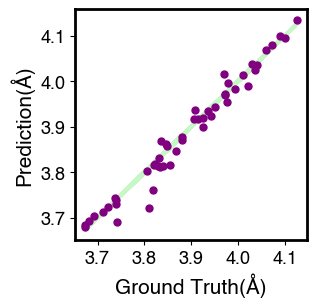

Index:  1
R^2:  0.86


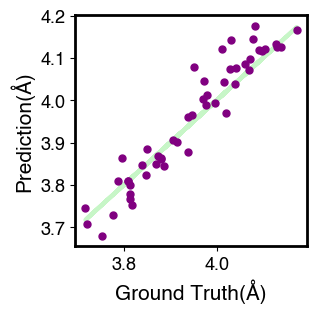

Index:  2
R^2:  0.83


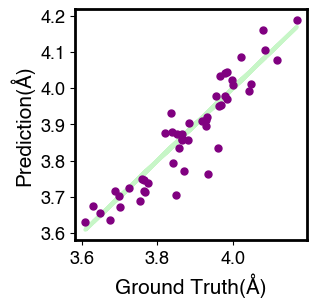

Index:  3
R^2:  0.81


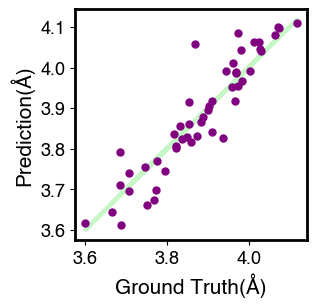

Index:  4
R^2:  0.81


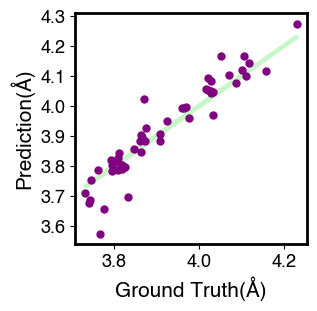

Index:  5
R^2:  0.8


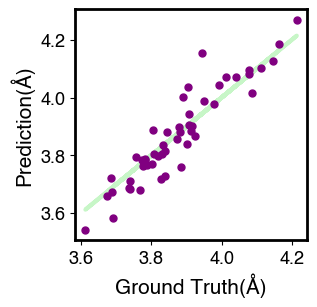

Index:  6
R^2:  0.76


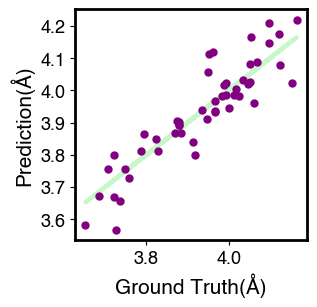

Index:  7
R^2:  0.79


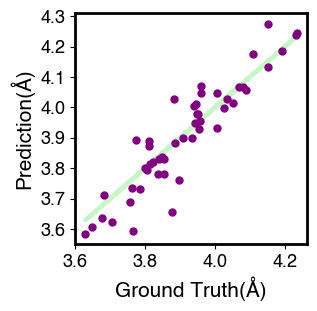

Index:  8
R^2:  0.7


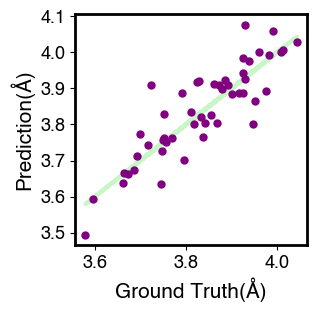

Index:  9
R^2:  0.79


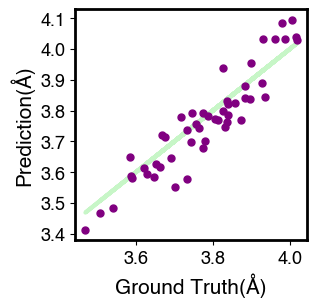

Index:  10
R^2:  0.8


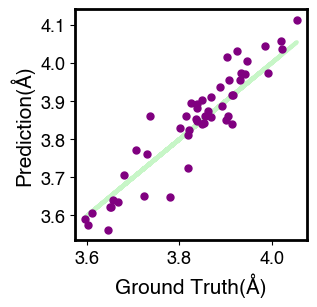

Index:  11
R^2:  0.67


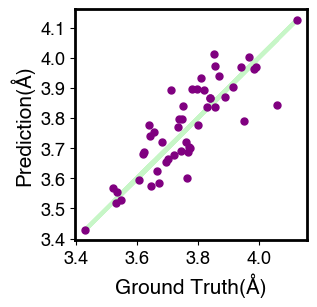

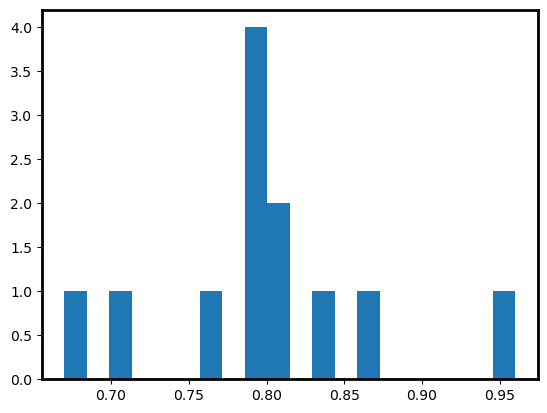

0.7983333333333333


In [147]:
r2_arr_pr_o2 = []

for i in range(N_bulk+N_surface-1):

    print("Index: ", i)
    r2_val = rSquared(pred_o2s[:, i], real_o2s[:, i])
    print("R^2: ", r2_val)
    r2_arr_pr_o2.append(r2_val)
    #plt.plot(y_train[:, i], predictions_train[:, i] , color = 'blue', linewidth = 5, label = "Train", alpha = 0.2)
    #plt.plot(y_train[:, i], predictions_train[:, i]  ,'.', color = 'blue', linewidth = 0, label = "Train", alpha = 0.2)
    
    fig = plt.figure(figsize = (3, 3))
    plt.rcParams['axes.linewidth'] = 2
    plt.plot(pred_o2s[:, i], pred_o2s[:, i], color = "lightgreen", linewidth = 3, alpha = 0.5)

    plt.plot(pred_o2s[:, i], real_o2s[:, i] , '.', markersize = 10, color = 'purple', label = "Test", alpha = 1)


    plt.xlabel('Ground Truth(Å)', fontname = 'Helvetica',fontsize = 15 )
    plt.ylabel('Prediction(Å)', fontname = 'Helvetica',fontsize = 15  )

    plt.xticks(fontsize = 13, fontname = 'Helvetica' )
    plt.yticks(fontsize = 13, fontname = 'Helvetica' )
    #plt.ylim(4, 13)
    #plt.legend(loc='upper left', markerscale=2, prop={'size': 25, "family":'Times new roman'})
    #plt.grid()
    plt.show()

plt.hist(r2_arr_pr_o2, bins = 20)
plt.show()
print(np.mean(r2_arr_pr_o2))

# Ti

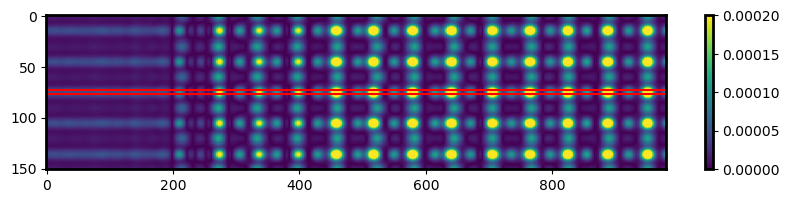

In [148]:
plt.figure(figsize=(10, 2))
plt.imshow(pr_pred[0][1], interpolation='nearest', aspect='auto')
plt.axhline(73, color = 'red')
plt.axhline(77, color = 'red')

plt.colorbar()
plt.clim(0, 0.0002)
#plt.xlim(0, 424)
#plt.ylim(0,424)
plt.show()


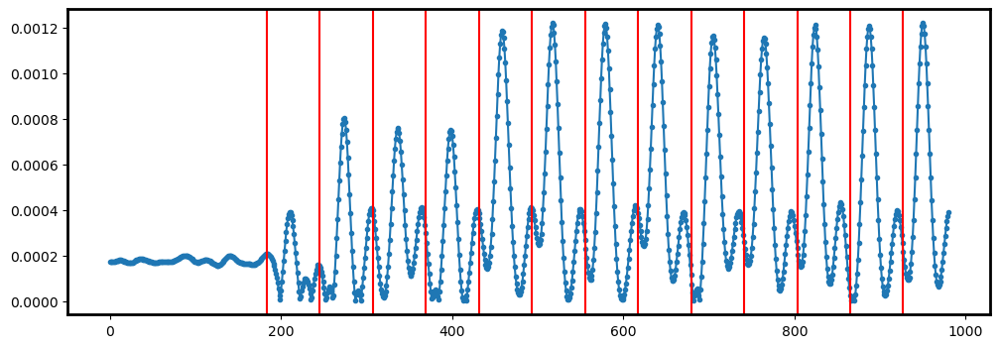

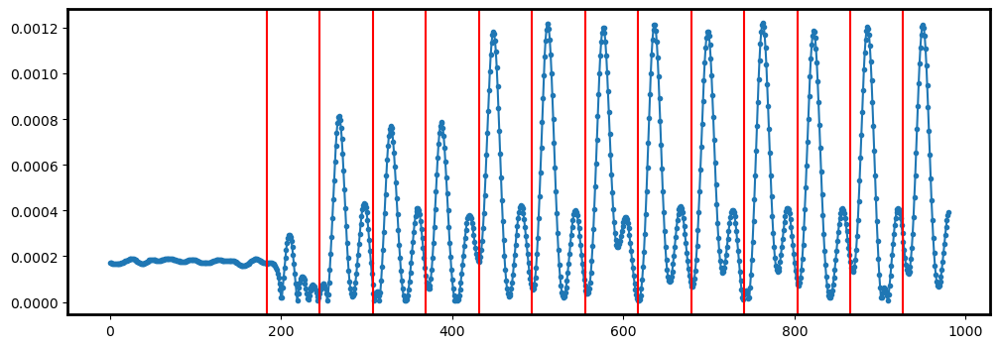

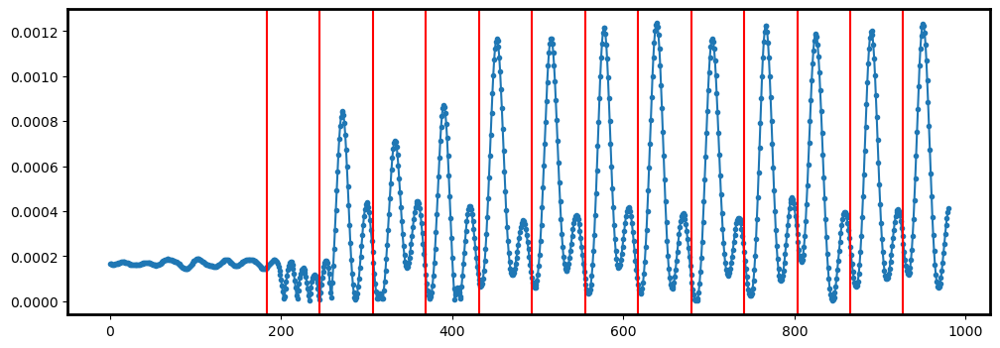

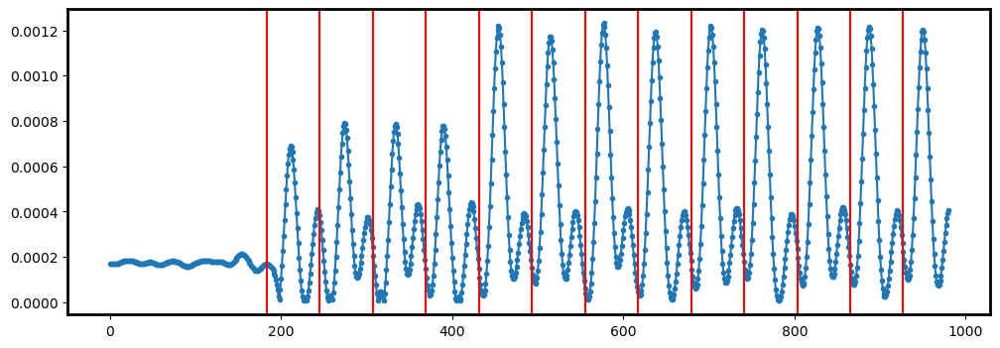

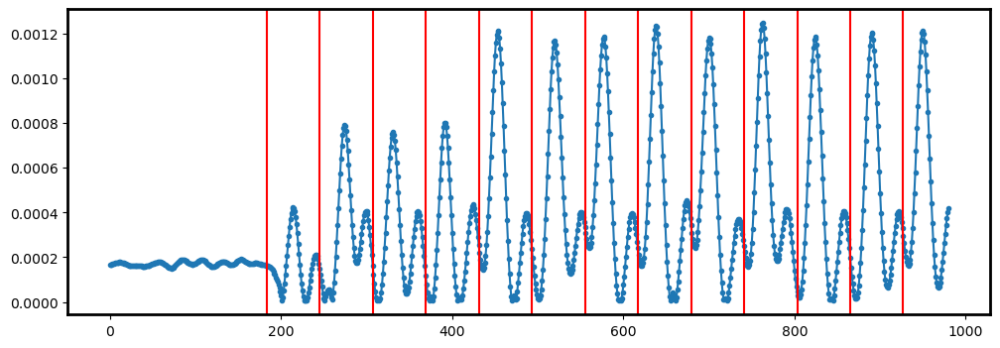

...

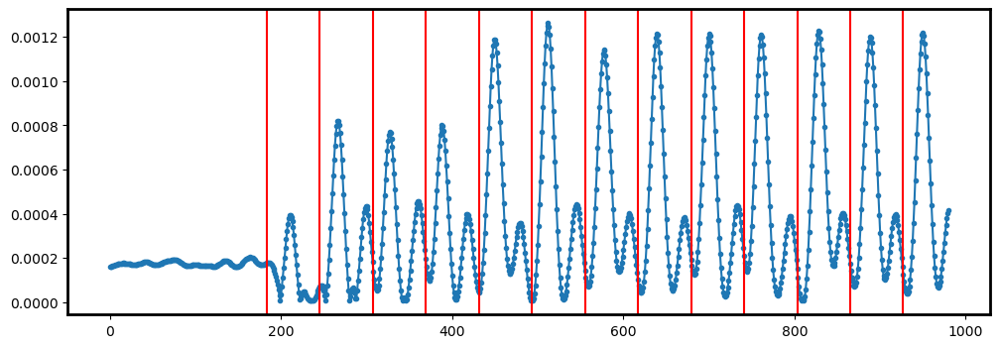

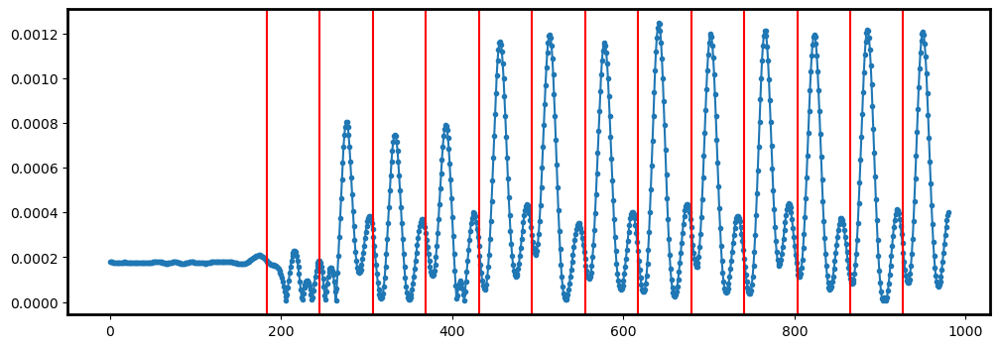

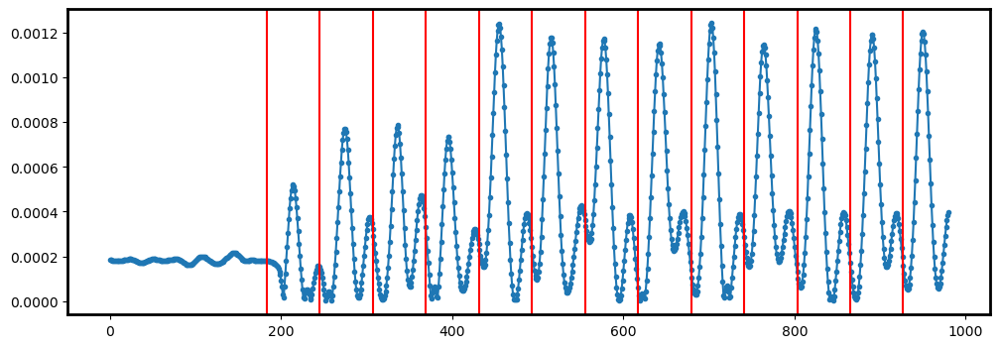

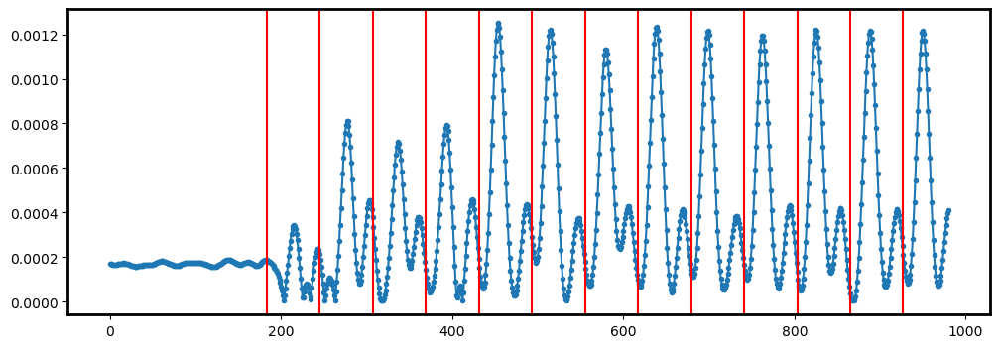

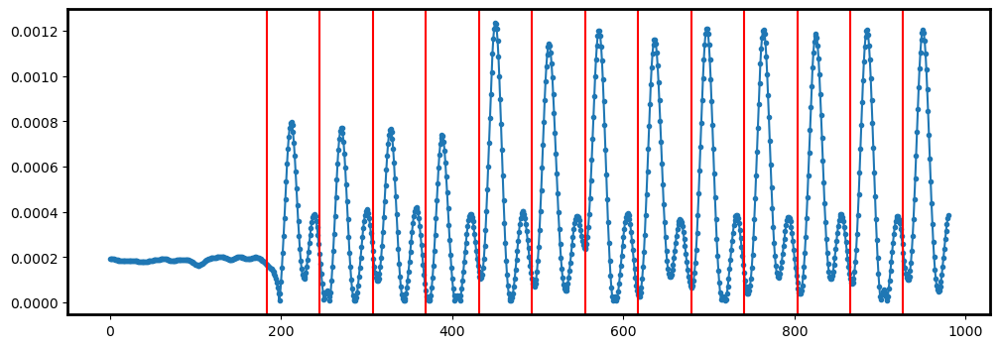

In [153]:
for j in range(50):

    plt.figure(figsize=(12, 4))
    pr_slice_O1 = np.sum(pr_pred[j][1][73:77], axis = 0)
    #pr_slice_O1 = np.sum(pr_real[index][0][63:64], axis = 0)
    plt.plot(pr_slice_O1, '.-')


    start = 245 - 62
    spacing = 62
    #start = 145
    #spacing = 62
    for i in range(N_bulk+N_surface): 
        plt.axvline(start + i*spacing, color = "red")

    plt.show()

In [152]:
start = 245 - 62
a_space = 62
real_Tis = []
pred_Tis = []

for i in range(len(pr_real)):
    print(i)
    pr_slice_Ti = np.sum(pr_real[i][1][73:77], axis = 0)
    spacings, gaus_fit = fit_p_r_new(pr_slice_Ti, start, a_space)
    spacings = np.flip(spacings)
    real_Tis.append(spacings)

for i in range(len(pr_pred)):
    print(i)
    pr_slice_Ti = np.sum(pr_pred[i][1][73:77], axis = 0)
    spacings, gaus_fit = fit_p_r_new(pr_slice_Ti, start, a_space)
    spacings = np.flip(spacings)
    pred_Tis.append(spacings)
    
real_Tis = np.array(real_Tis)
pred_Tis = np.array(pred_Tis)


0
1
2


RuntimeError: Optimal parameters not found: Number of calls to function has reached maxfev = 800.

Index:  0
R^2:  1.0


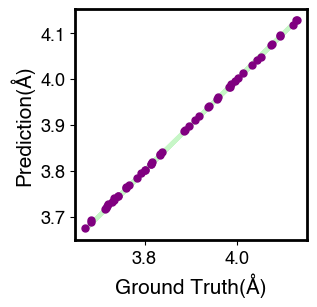

Index:  1
R^2:  1.0


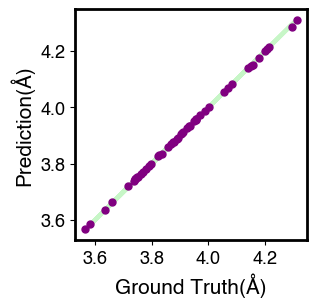

Index:  2
R^2:  1.0


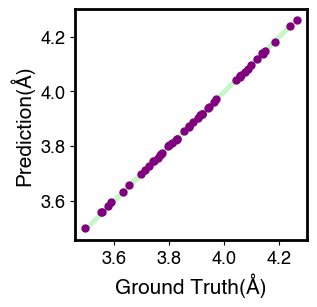

Index:  3
R^2:  1.0


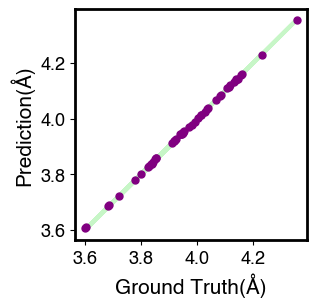

Index:  4
R^2:  1.0


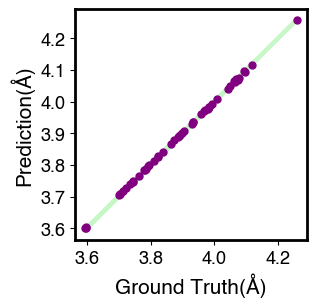

Index:  5
R^2:  1.0


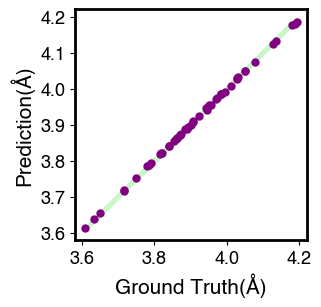

Index:  6
R^2:  1.0


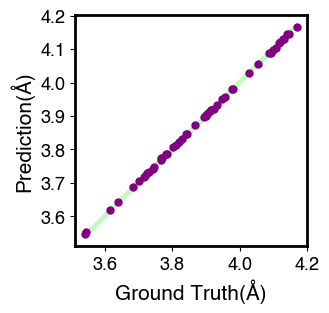

Index:  7
R^2:  1.0


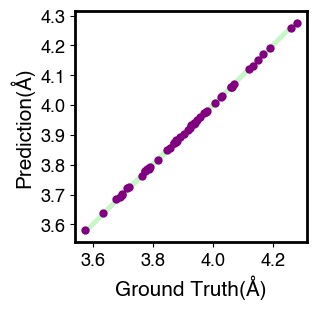

Index:  8
R^2:  1.0


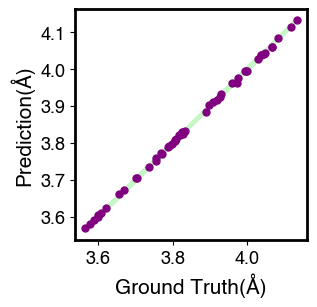

Index:  9
R^2:  1.0


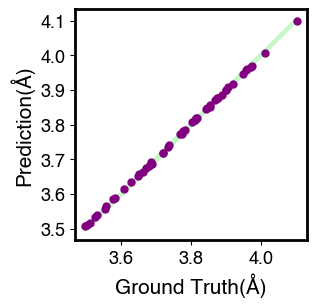

Index:  10
R^2:  1.0


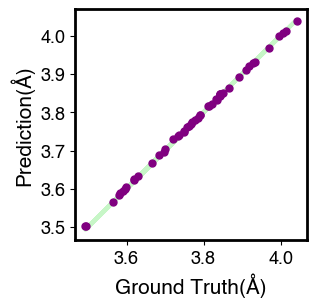

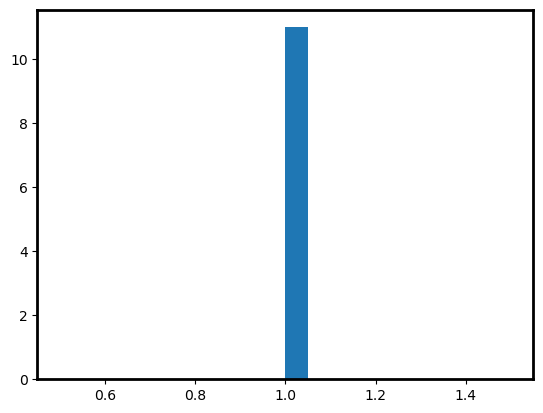

1.0


In [82]:
input_Tis = np.array(all_Tis[train_size:train_size+50])
r2_arr_pr = []

for i in range(N_bulk+N_surface-1):

    print("Index: ", i)
    r2_val = rSquared(real_Tis[:, i], input_Tis[:, i+1])
    print("R^2: ", r2_val)
    r2_arr_pr.append(r2_val)
    #plt.plot(y_train[:, i], predictions_train[:, i] , color = 'blue', linewidth = 5, label = "Train", alpha = 0.2)
    #plt.plot(y_train[:, i], predictions_train[:, i]  ,'.', color = 'blue', linewidth = 0, label = "Train", alpha = 0.2)
    
    fig = plt.figure(figsize = (3, 3))
    plt.rcParams['axes.linewidth'] = 2
    plt.plot(real_Tis[:, i], real_Tis[:, i], color = "lightgreen", linewidth = 3, alpha = 0.5)

    plt.plot(real_Tis[:, i], input_Tis[:, i+1] , '.', markersize = 10, color = 'purple', label = "Test", alpha = 1)


    plt.xlabel('Ground Truth(Å)', fontname = 'Helvetica',fontsize = 15 )
    plt.ylabel('Prediction(Å)', fontname = 'Helvetica',fontsize = 15  )

    plt.xticks(fontsize = 13, fontname = 'Helvetica' )
    plt.yticks(fontsize = 13, fontname = 'Helvetica' )
    #plt.ylim(4, 13)
    #plt.legend(loc='upper left', markerscale=2, prop={'size': 25, "family":'Times new roman'})
    #plt.grid()
    plt.show()

plt.hist(r2_arr_pr, bins = 20)
plt.show()
print(np.mean(r2_arr_pr))

Index:  0
R^2:  0.98


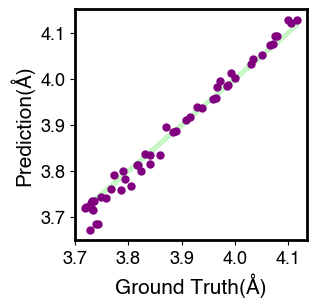

Index:  1
R^2:  0.94


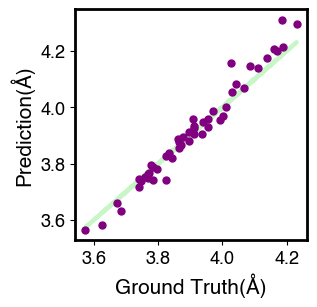

Index:  2
R^2:  0.9


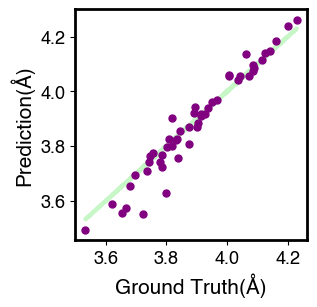

Index:  3
R^2:  0.89


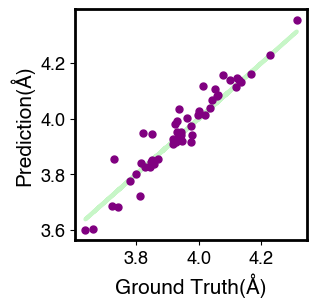

Index:  4
R^2:  0.89


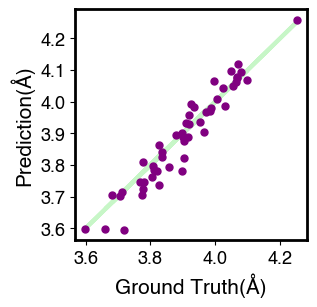

Index:  5
R^2:  0.83


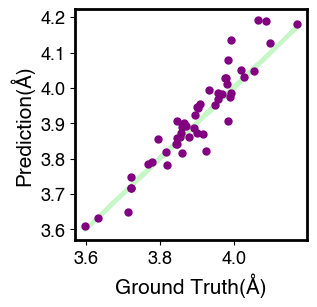

Index:  6
R^2:  0.91


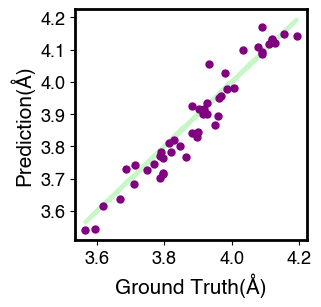

Index:  7
R^2:  0.9


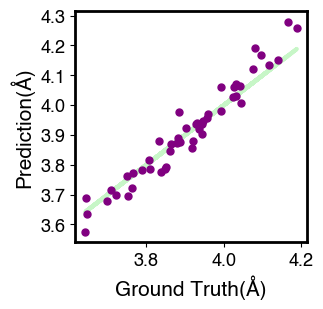

Index:  8
R^2:  0.82


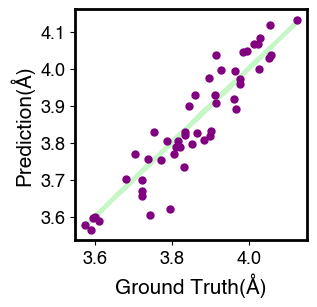

Index:  9
R^2:  0.78


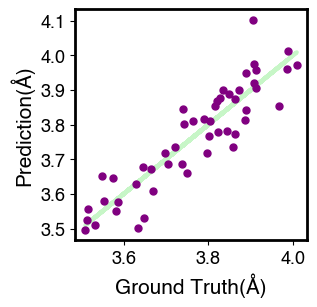

Index:  10
R^2:  0.76


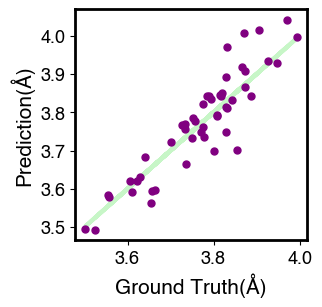

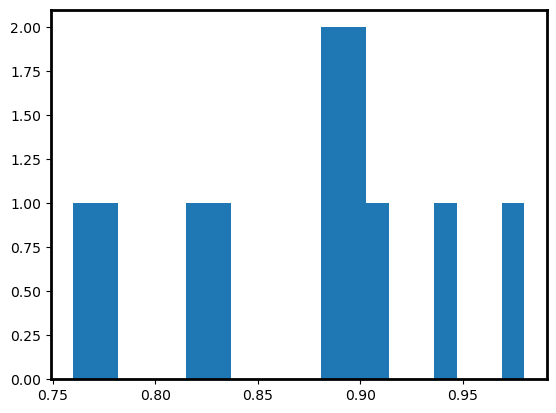

0.8727272727272727


In [83]:
r2_arr_pr_Ti = []

for i in range(N_bulk+N_surface-1):

    print("Index: ", i)
    r2_val = rSquared(pred_Tis[:, i], real_Tis[:, i])
    print("R^2: ", r2_val)
    r2_arr_pr_Ti.append(r2_val)
    #plt.plot(y_train[:, i], predictions_train[:, i] , color = 'blue', linewidth = 5, label = "Train", alpha = 0.2)
    #plt.plot(y_train[:, i], predictions_train[:, i]  ,'.', color = 'blue', linewidth = 0, label = "Train", alpha = 0.2)
    
    fig = plt.figure(figsize = (3, 3))
    plt.rcParams['axes.linewidth'] = 2
    plt.plot(pred_Tis[:, i], pred_Tis[:, i], color = "lightgreen", linewidth = 3, alpha = 0.5)

    plt.plot(pred_Tis[:, i], real_Tis[:, i] , '.', markersize = 10, color = 'purple', label = "Test", alpha = 1)


    plt.xlabel('Ground Truth(Å)', fontname = 'Helvetica',fontsize = 15 )
    plt.ylabel('Prediction(Å)', fontname = 'Helvetica',fontsize = 15  )

    plt.xticks(fontsize = 13, fontname = 'Helvetica' )
    plt.yticks(fontsize = 13, fontname = 'Helvetica' )
    #plt.ylim(4, 13)
    #plt.legend(loc='upper left', markerscale=2, prop={'size': 25, "family":'Times new roman'})
    #plt.grid()
    plt.show()

plt.hist(r2_arr_pr_Ti, bins = 20)
plt.show()
print(np.mean(r2_arr_pr_Ti))

# O3

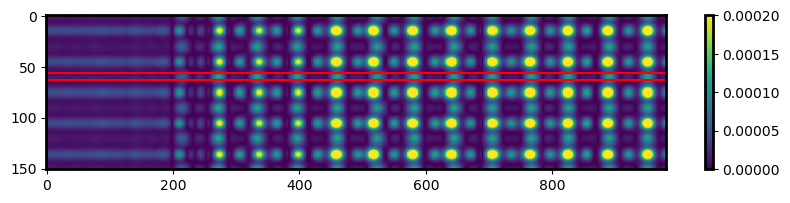

In [84]:
plt.figure(figsize=(10, 2))
plt.imshow(pr_pred[0][1], interpolation='nearest', aspect='auto')
plt.axhline(56, color = 'red')
plt.axhline(63, color = 'red')

plt.colorbar()
plt.clim(0, 0.0002)
#plt.xlim(0, 424)
#plt.ylim(0,424)
plt.show()


In [85]:
def fit_p_r_new_Ti(pr_slice, start, a_space):
    
    Ti_gaussians = np.zeros(len(pr_slice))
    points_around_max = 3
    pixel_ratio = 0.06293311845286059
    atomic_spacings = []
    N = len(pr_slice)
    means = []
    right = []
    left = []
    for atom in range(N_bulk+N_surface):
        i = start + atom*a_space
        interval = pr_slice[i:i+a_space]
        max_ind = np.argmax(interval)
        
        
        #atomic_section = interval[max_ind - points_around_max: max_ind + points_around_max+1]
        
        atomic_section = pr_slice[i+max_ind - points_around_max:i+max_ind + points_around_max+1]
        
        
        #fitting gaussian
        num_points = len(atomic_section)
        x_d = np.arange(num_points)        
        #print("Interval: ", interval)
        #print("Max ind: ", max_ind)
        params, covariance = curve_fit(gaussian, x_d, atomic_section, p0=[1000, 1, 1])
        amplitude, mean, std_dev = params
        means.append(mean)
        right.append(a_space - (max_ind + points_around_max))
        left.append(max_ind - points_around_max)
        
        x_plot = np.linspace(0, len(pr_slice)-1, len(pr_slice))
        
        #adding mean + i + left
        y_plot = gaussian(x_plot, amplitude, mean + i + (max_ind - points_around_max), std_dev)
        Ti_gaussians += np.array(y_plot)

    for i in range(N_bulk+N_surface-1):
        index_space = right[i] + left[i+1] + (2*points_around_max - means[i]) + means[i+1]
        atomic_spacings.append(pixel_ratio * index_space)
        
    return atomic_spacings, Ti_gaussians


0


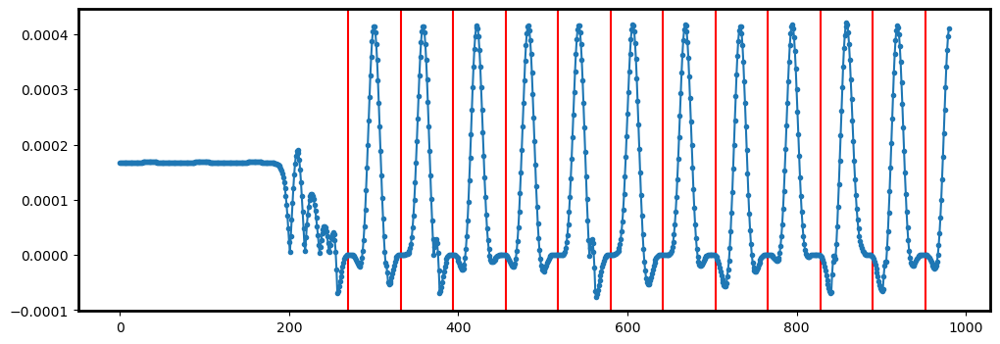

1


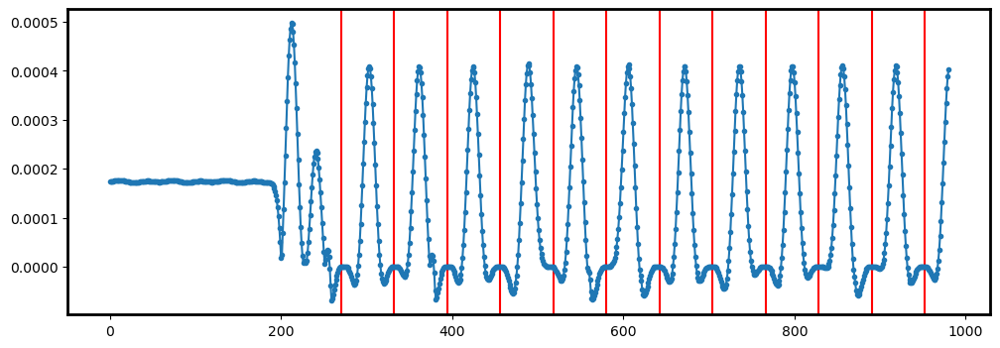

2


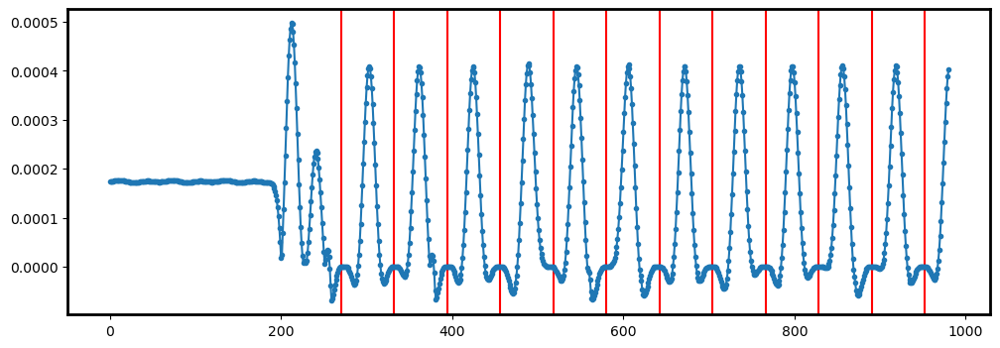

3


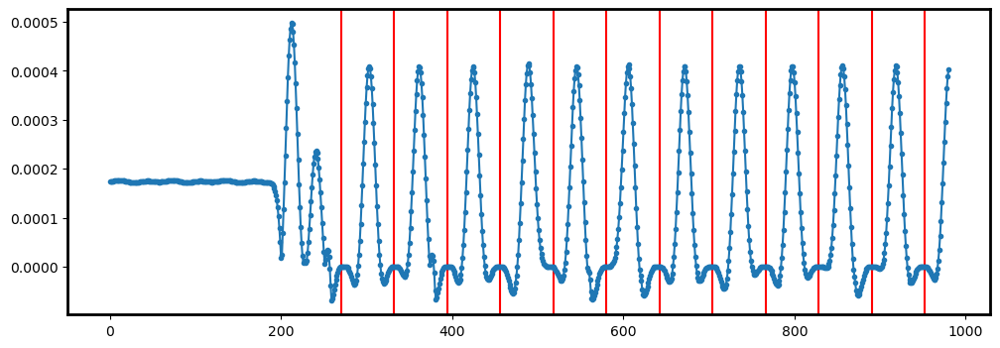

4


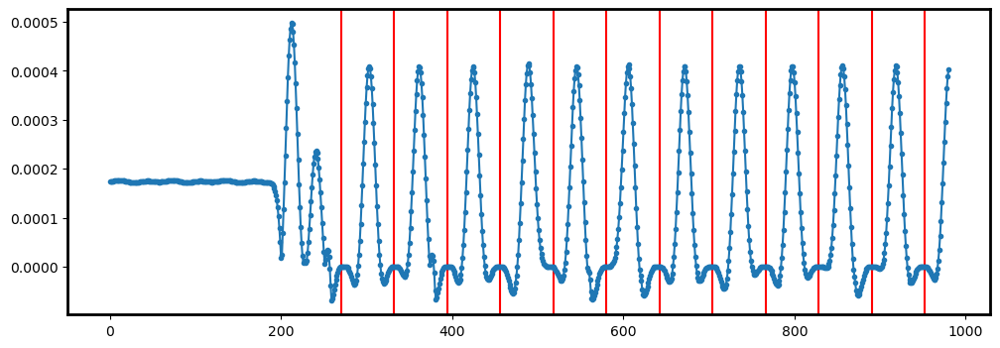

5


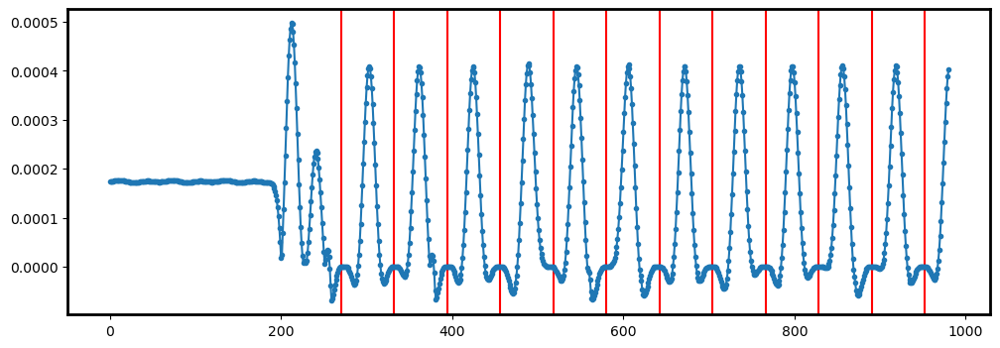

6


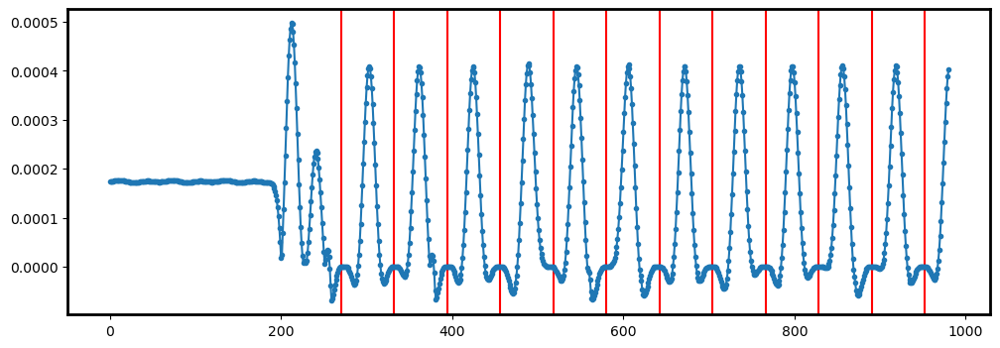

7


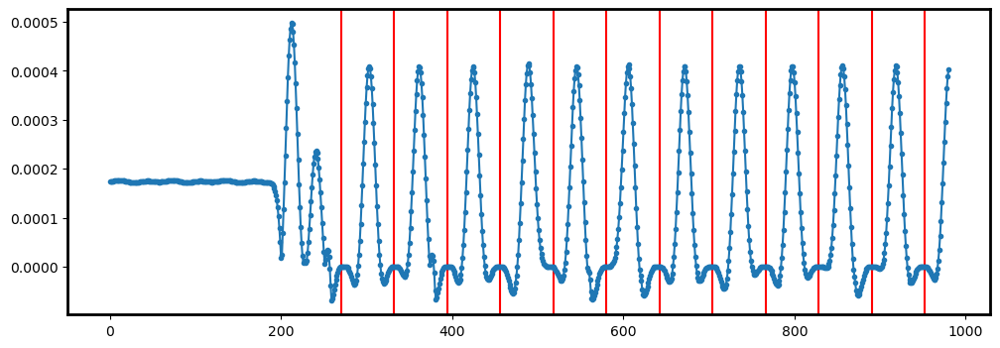

8


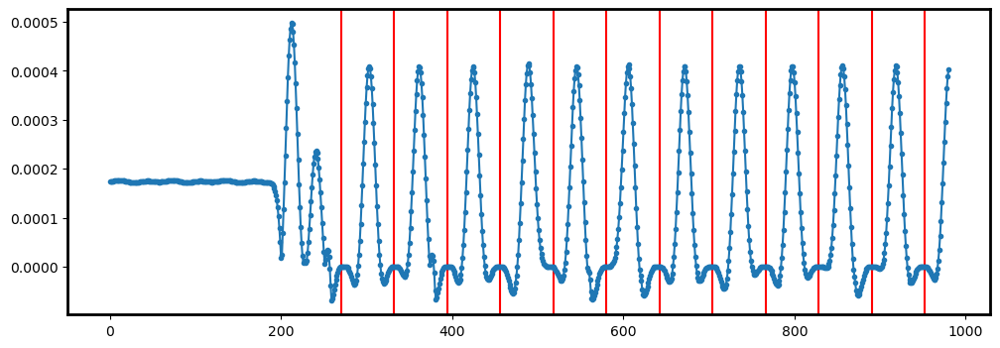

9


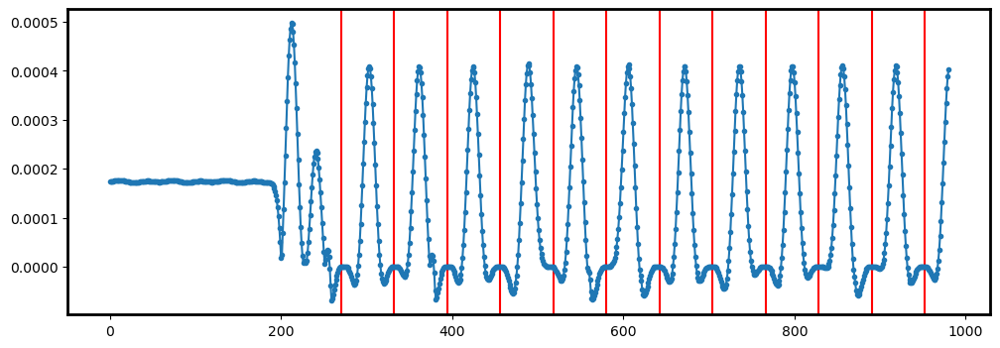

10


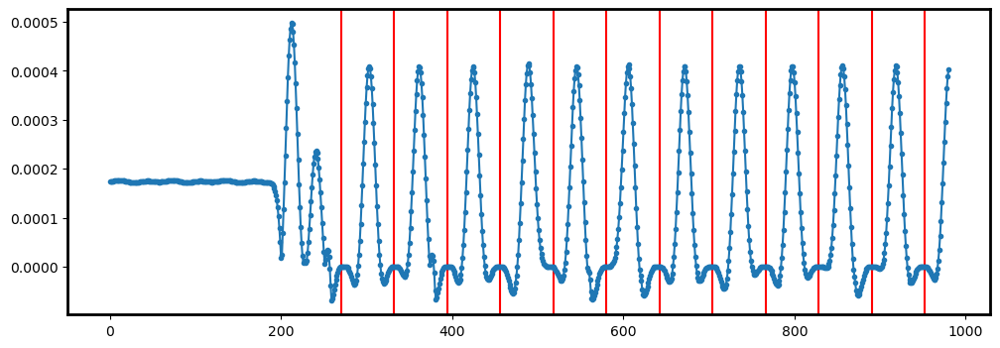

11


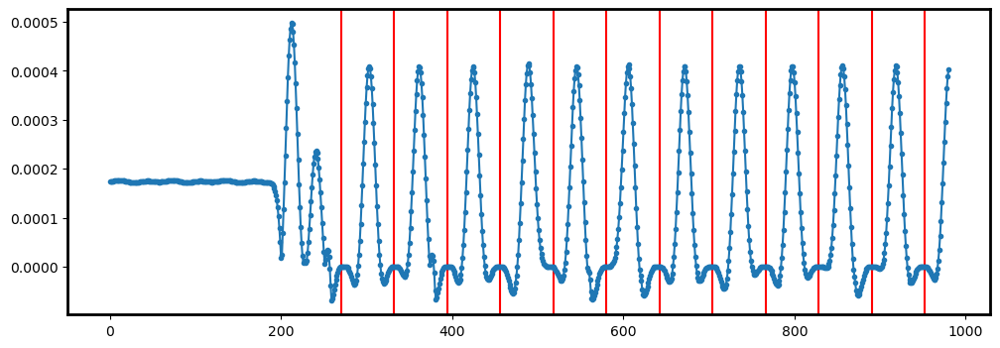

12


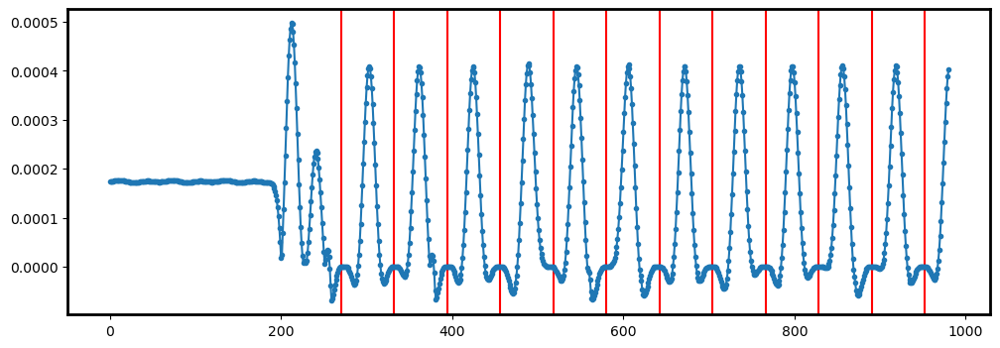

13


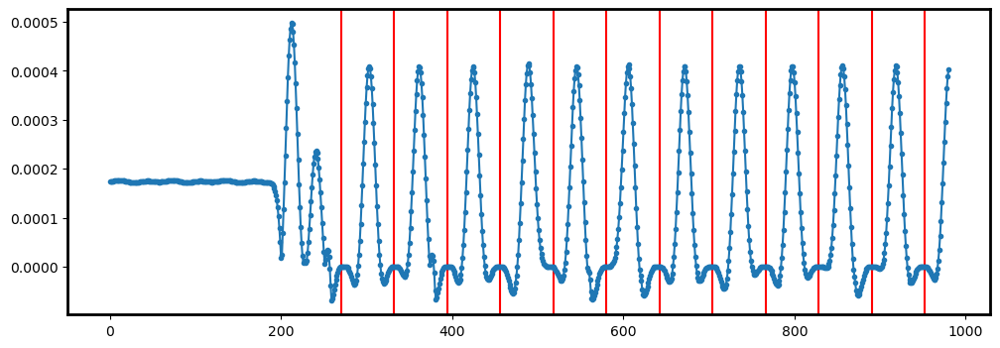

14


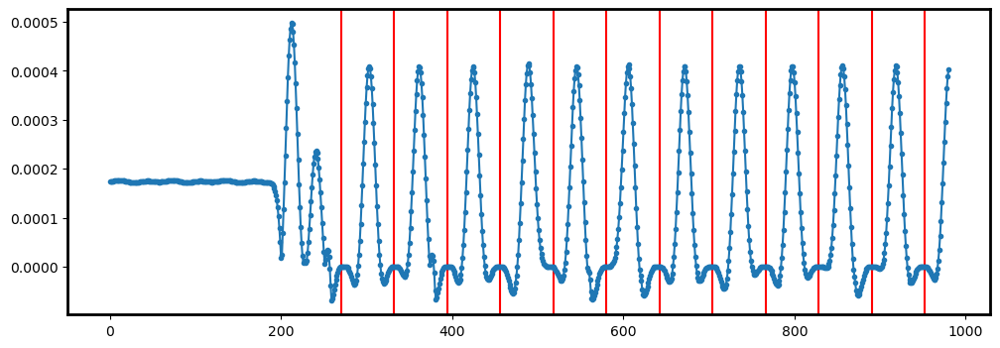

15


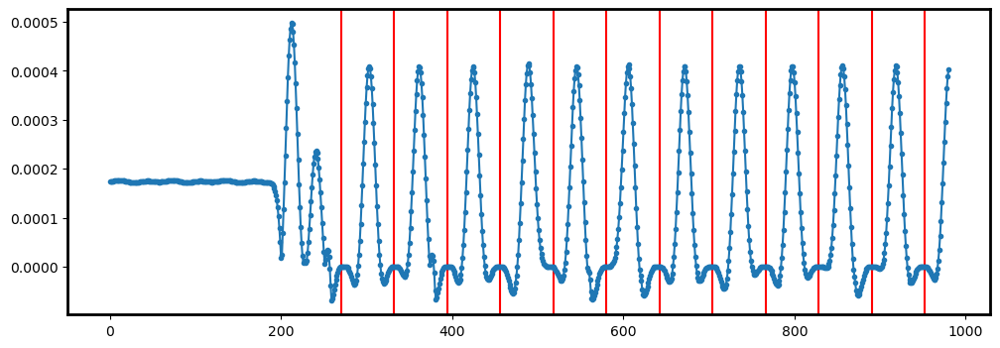

16


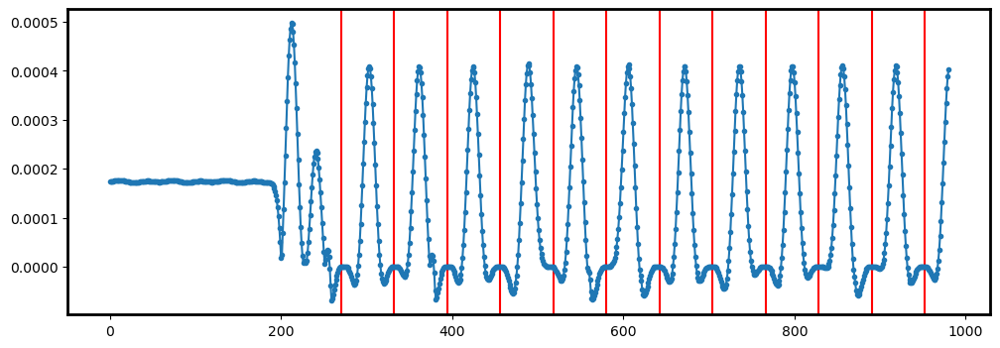

17


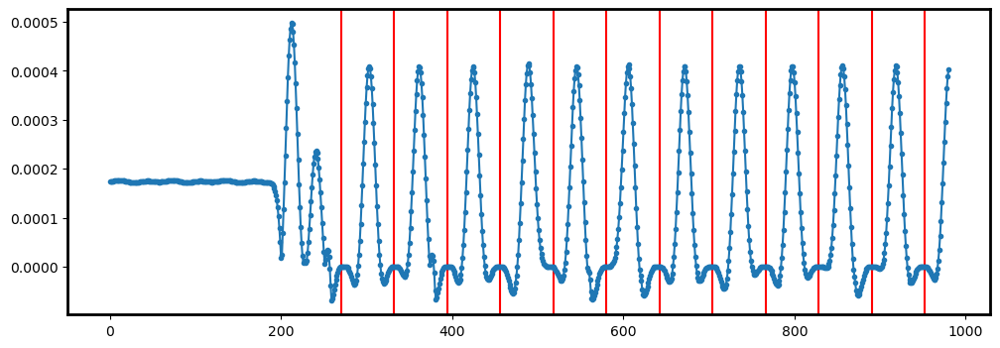

18


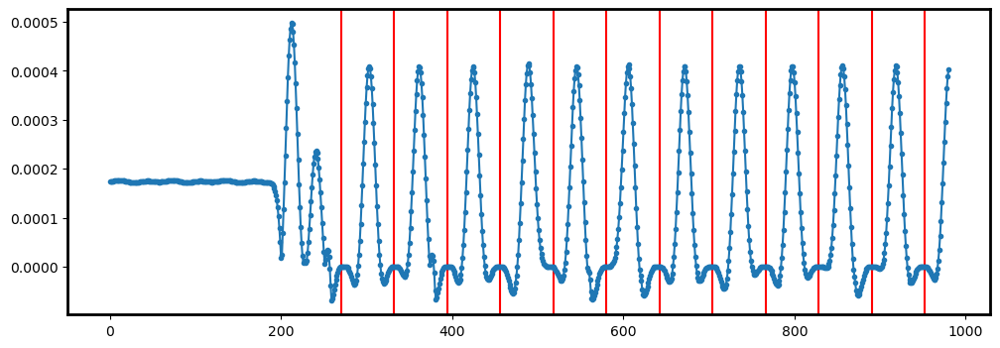

19


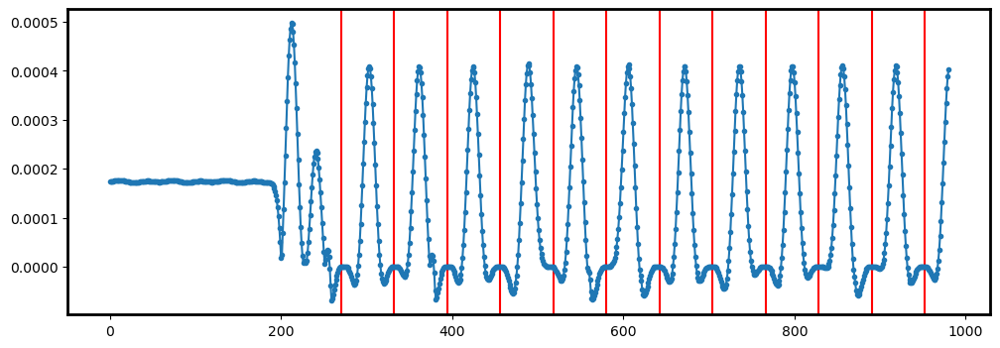

20


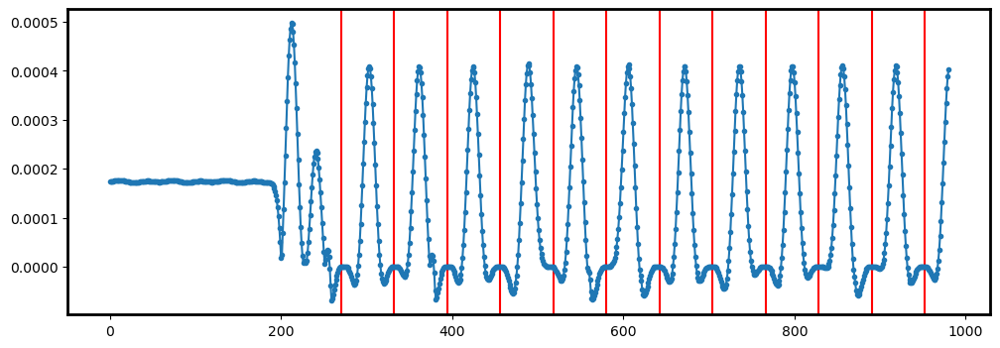

21


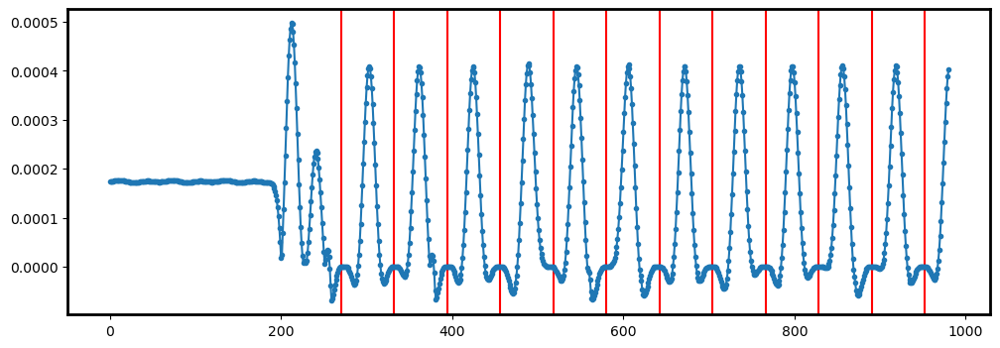

22


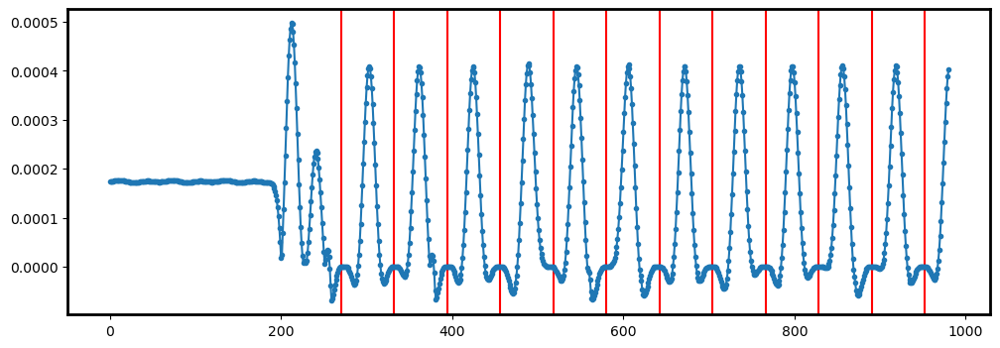

23


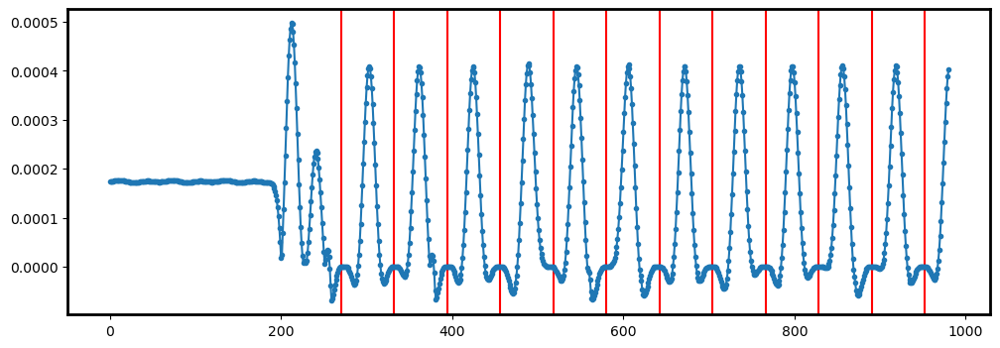

24


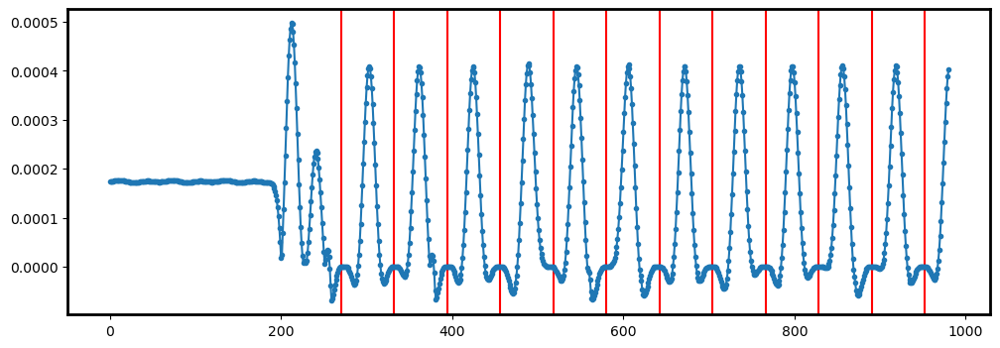

25


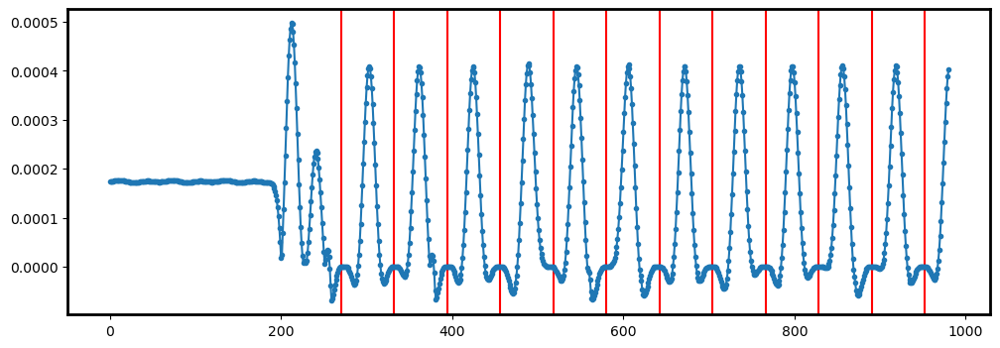

26


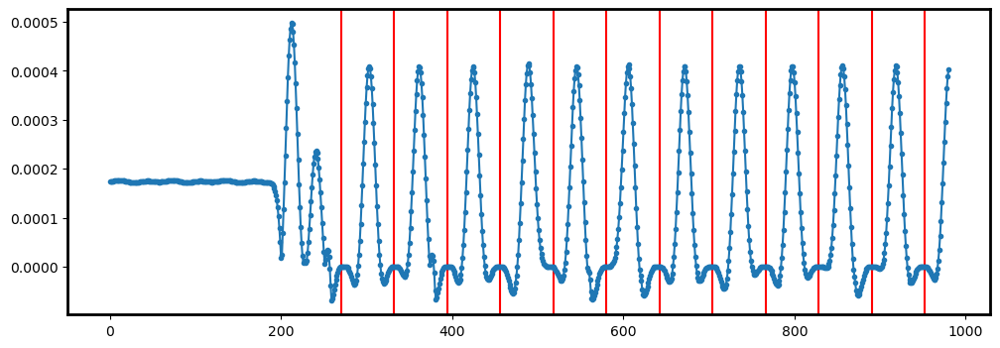

27


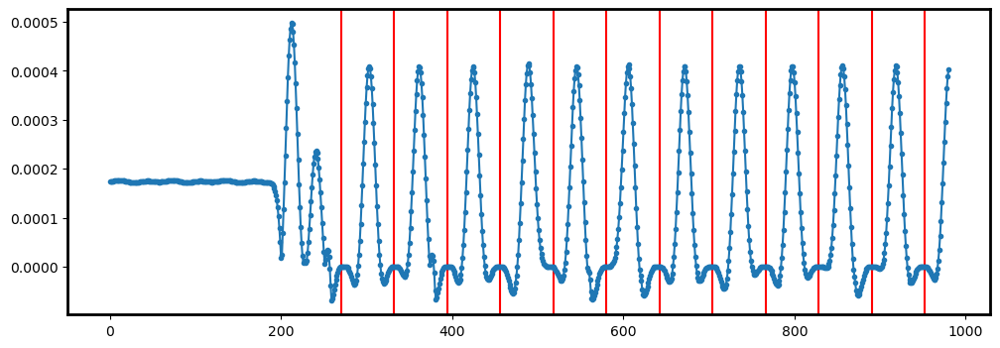

28


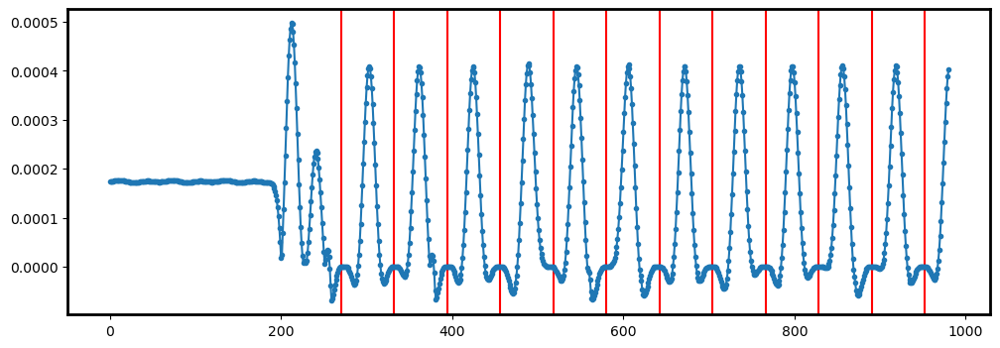

29


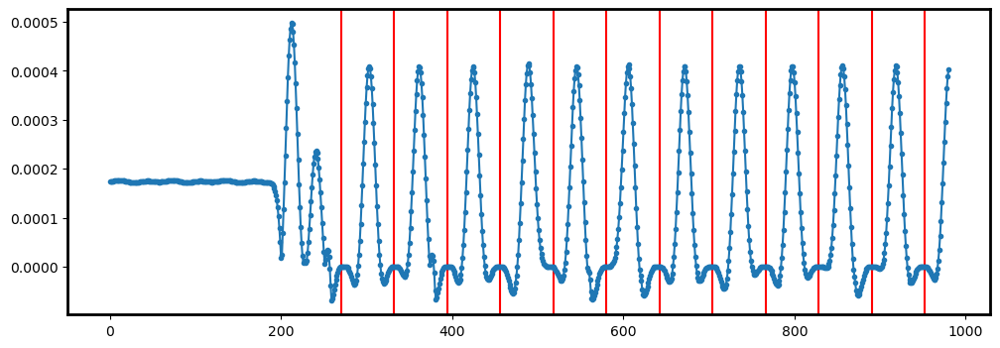

30


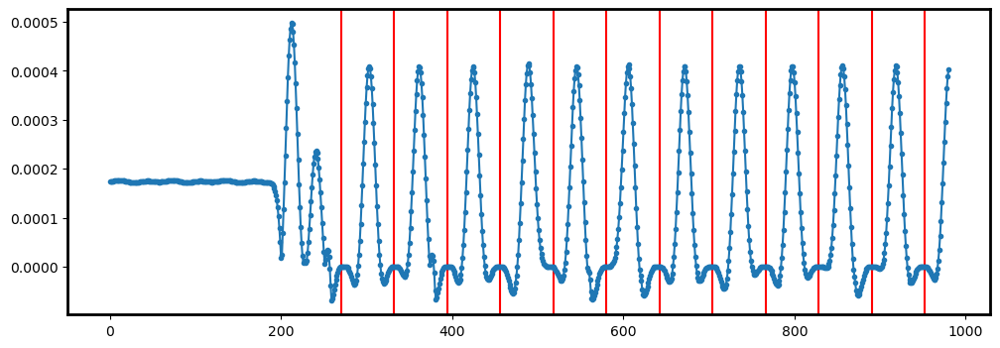

31


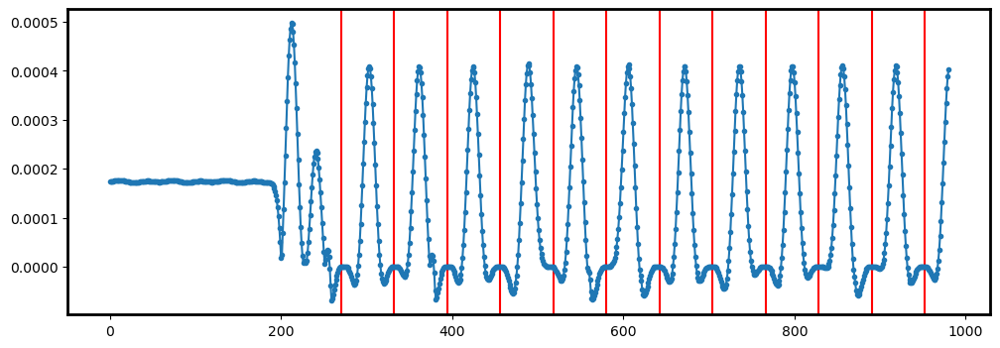

32


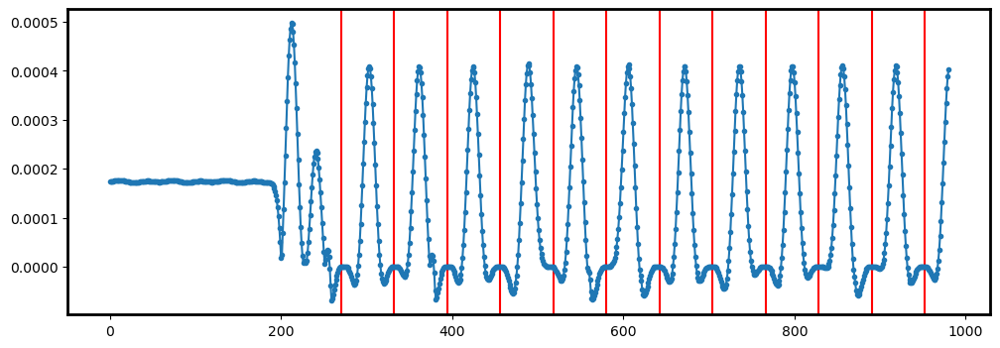

33


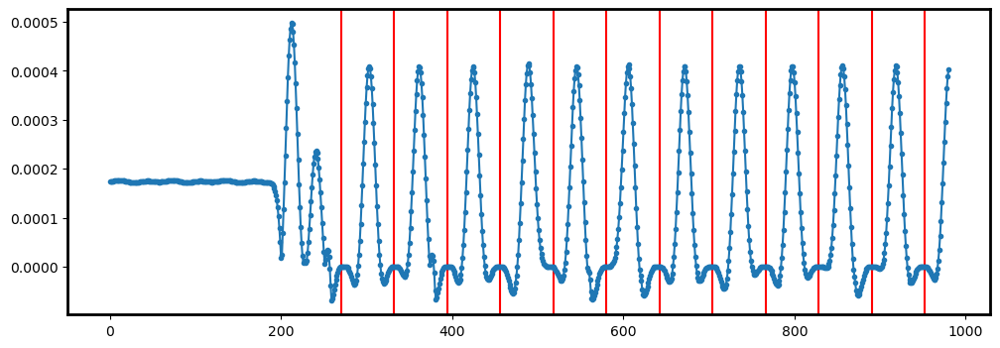

34


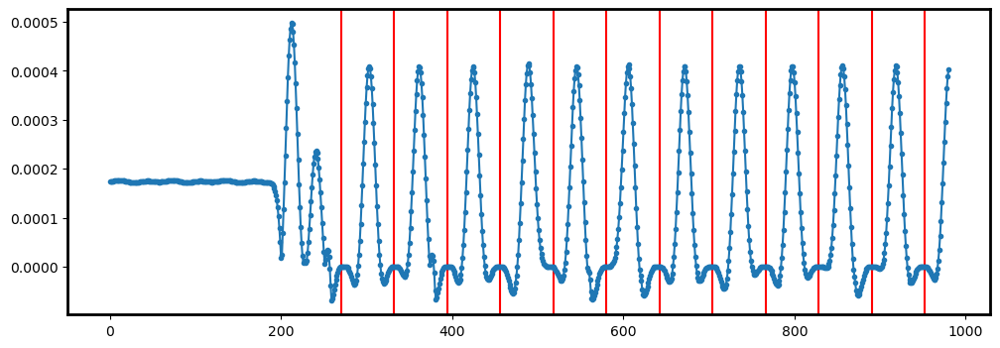

35


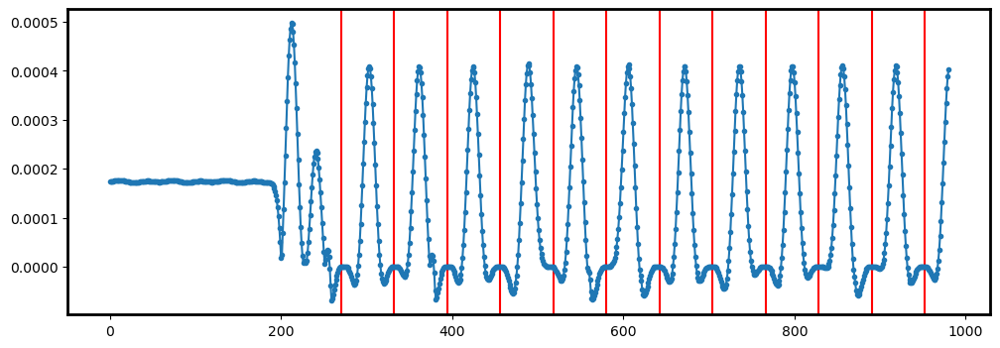

36


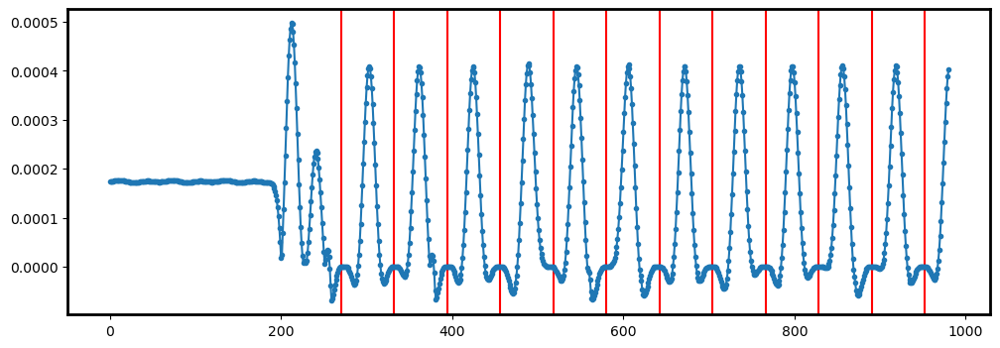

37


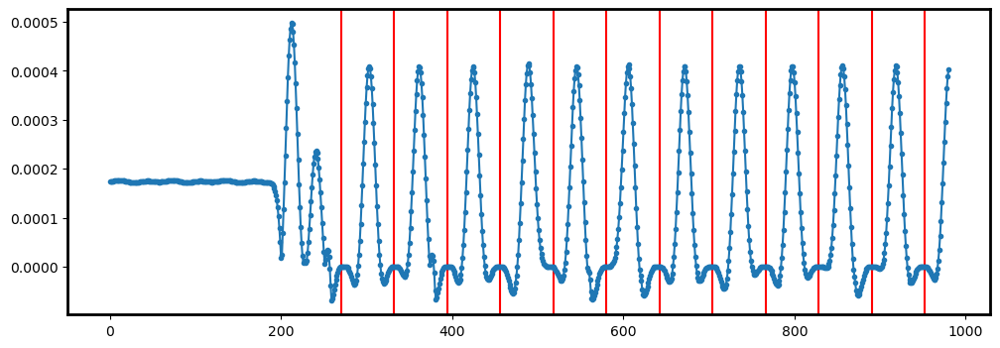

38


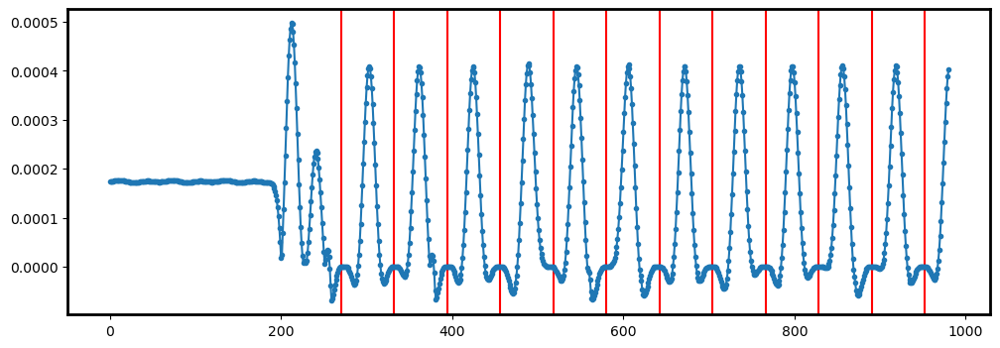

39


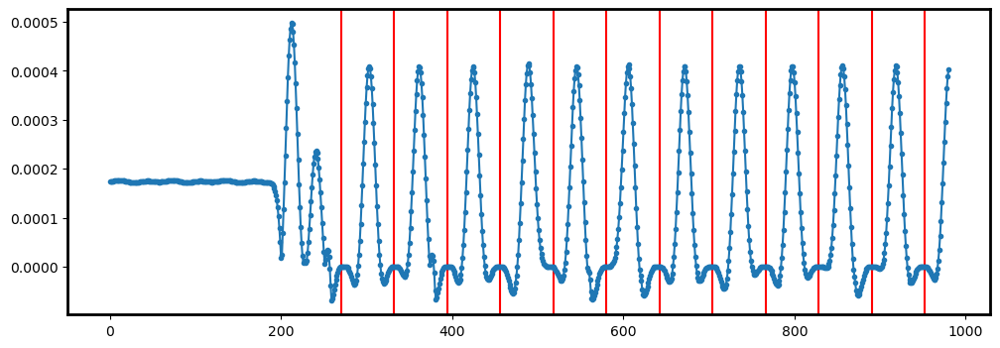

40


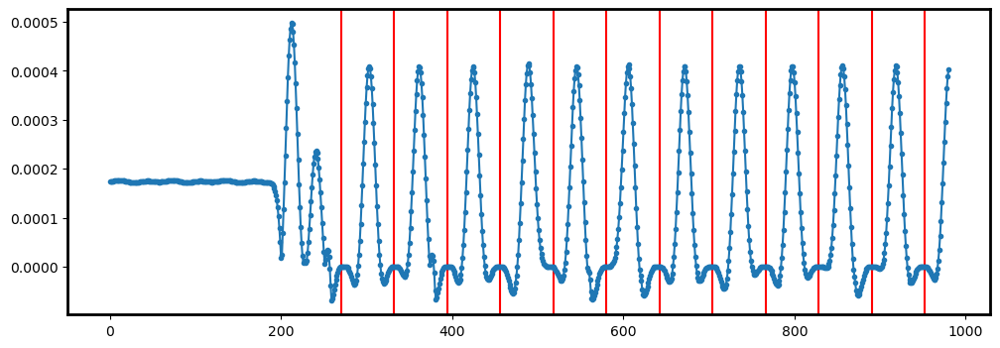

41


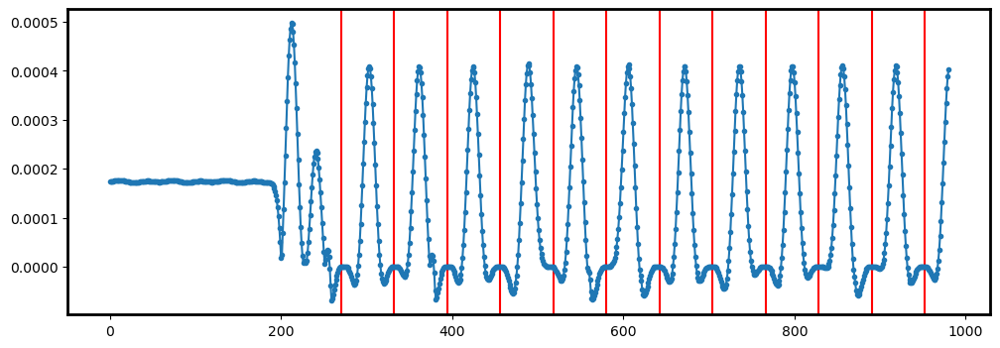

42


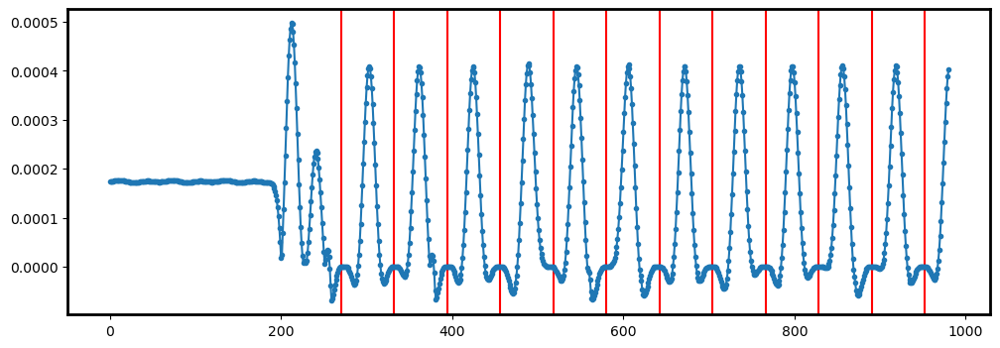

43


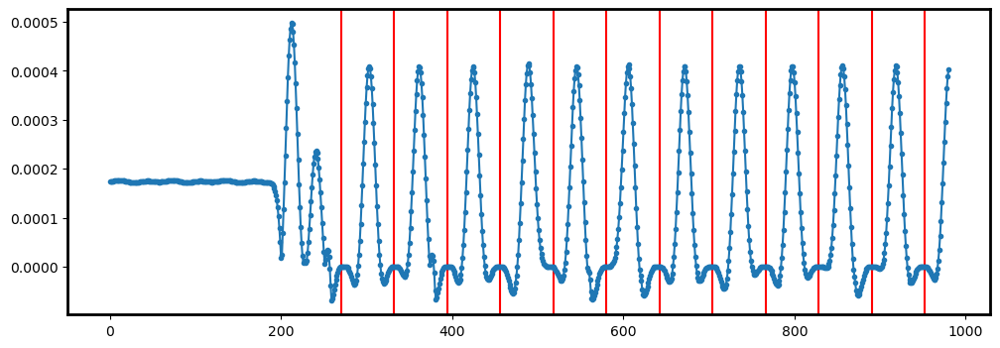

44


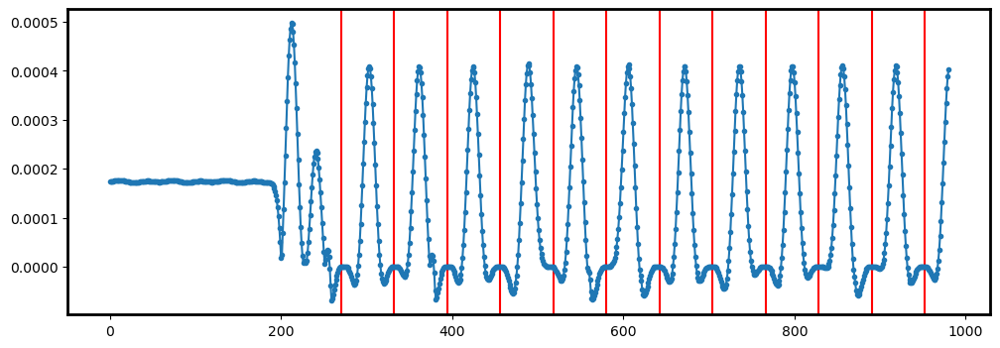

45


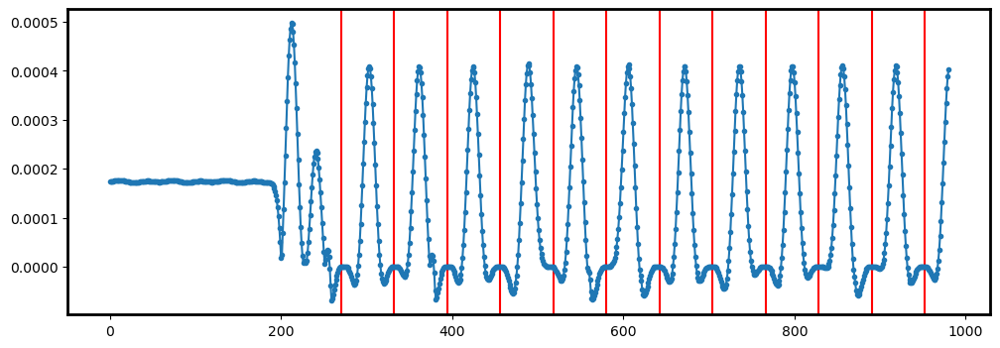

46


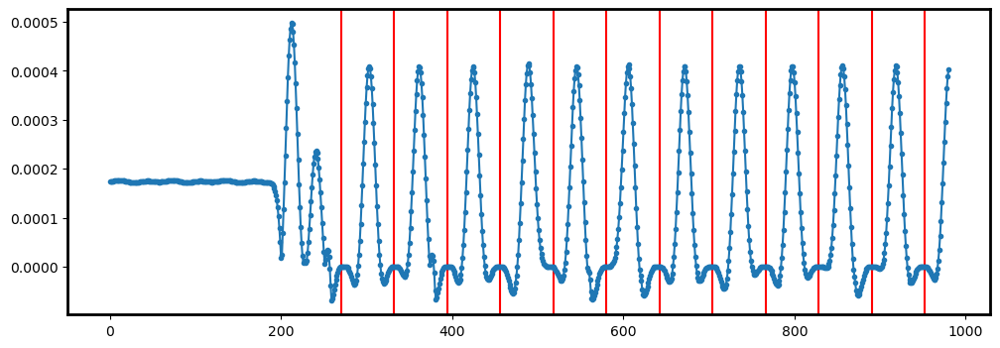

47


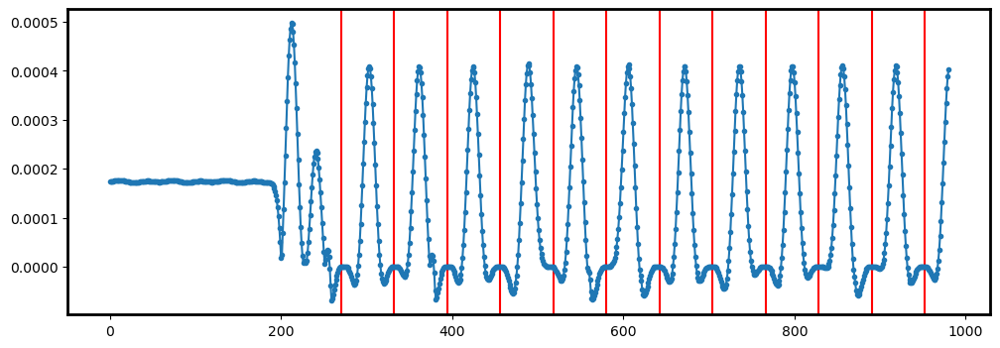

48


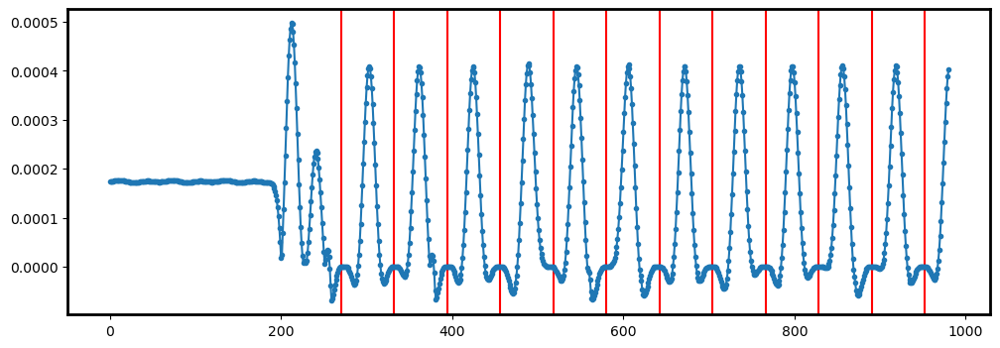

49


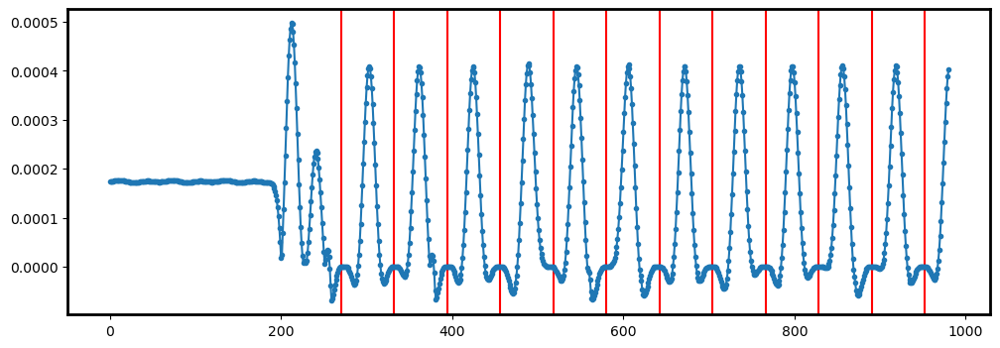

50


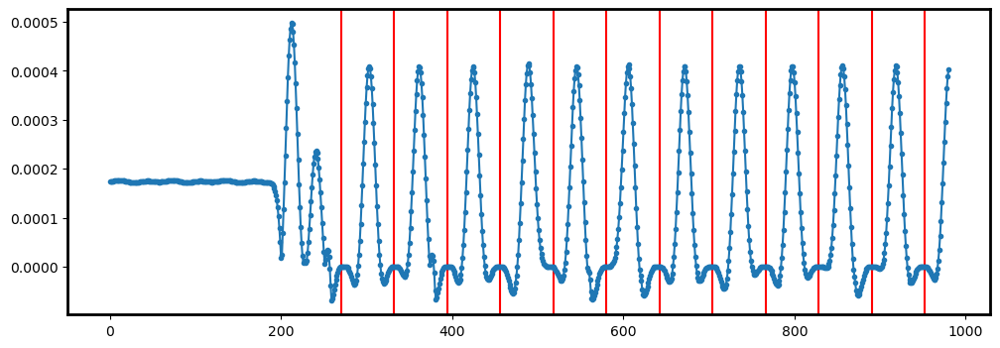

51


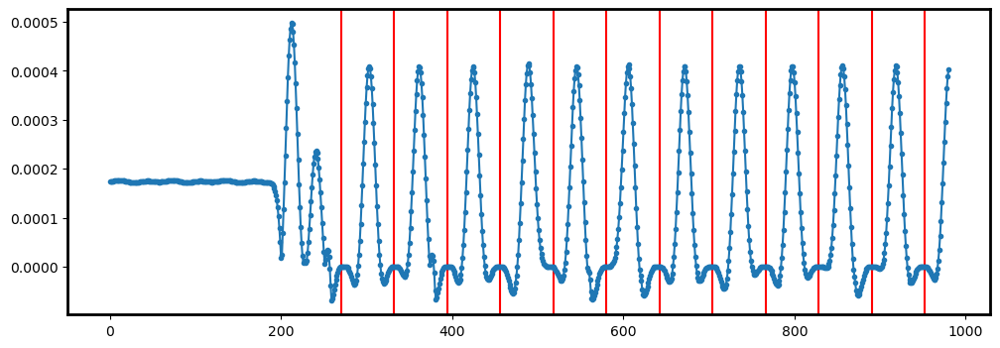

52


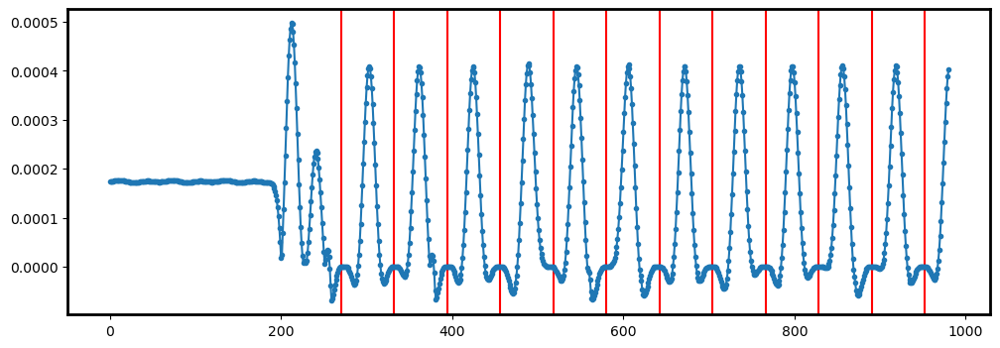

53


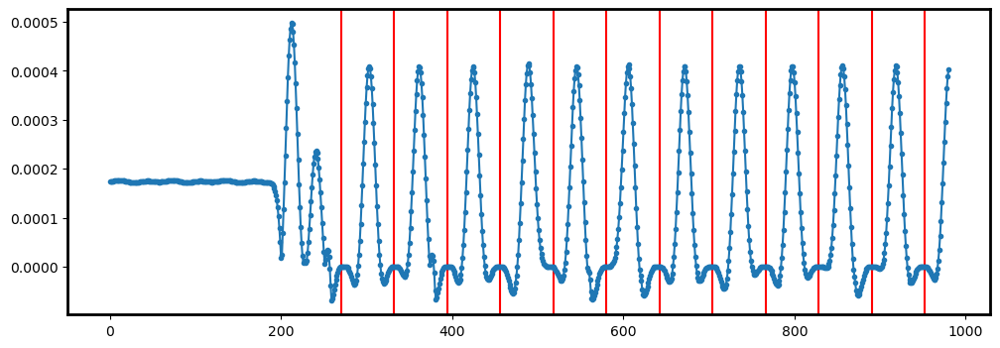

54


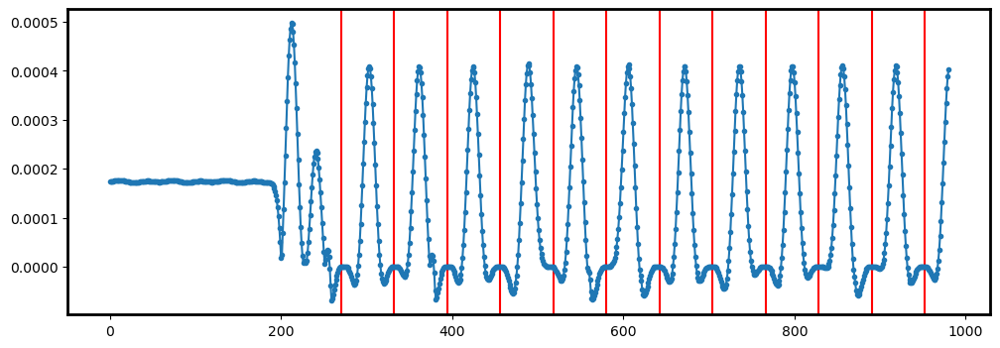

55


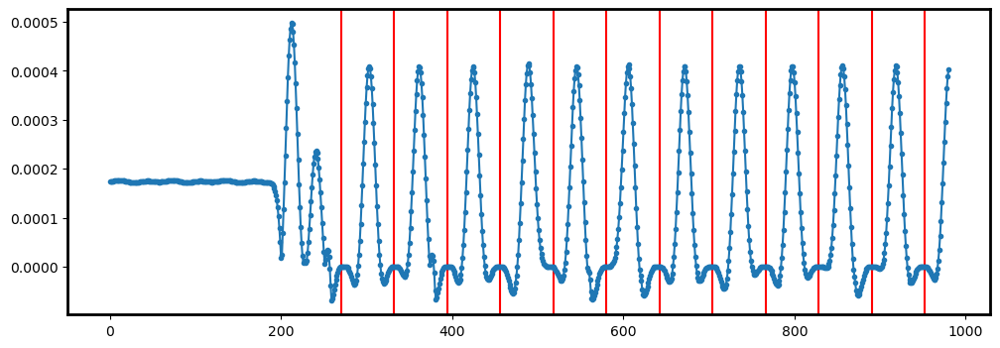

56


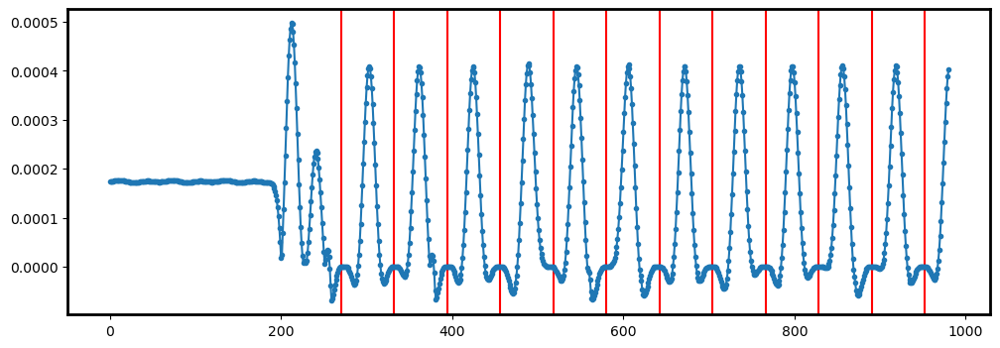

57


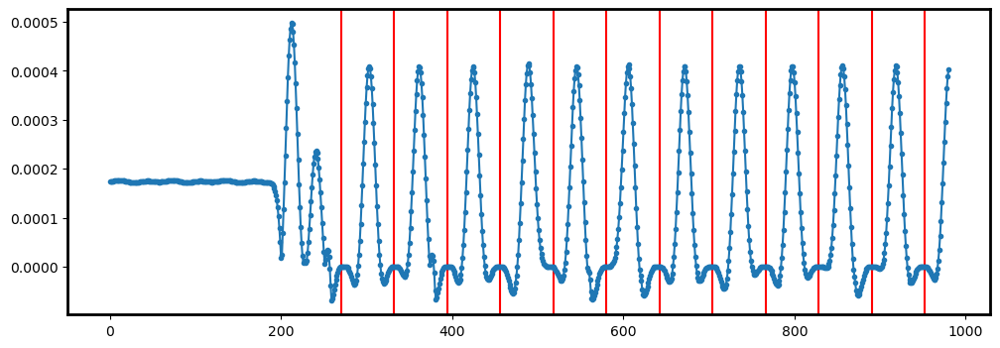

58


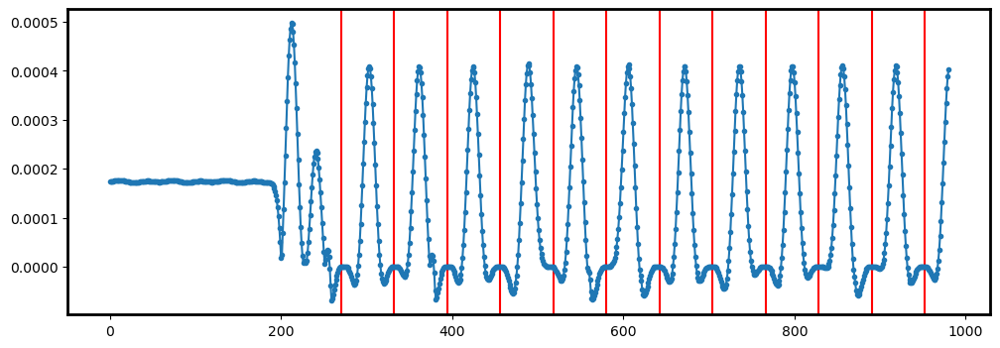

59


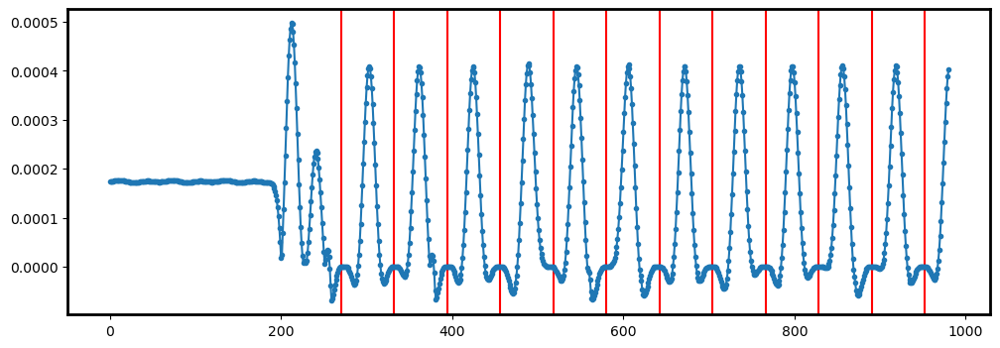

60


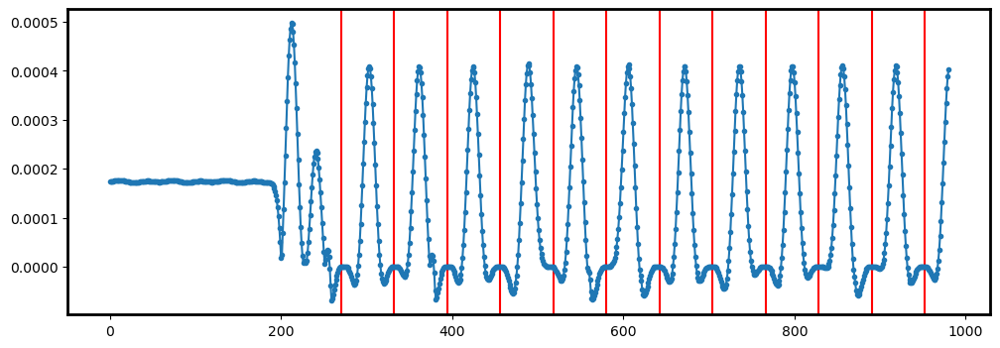

61


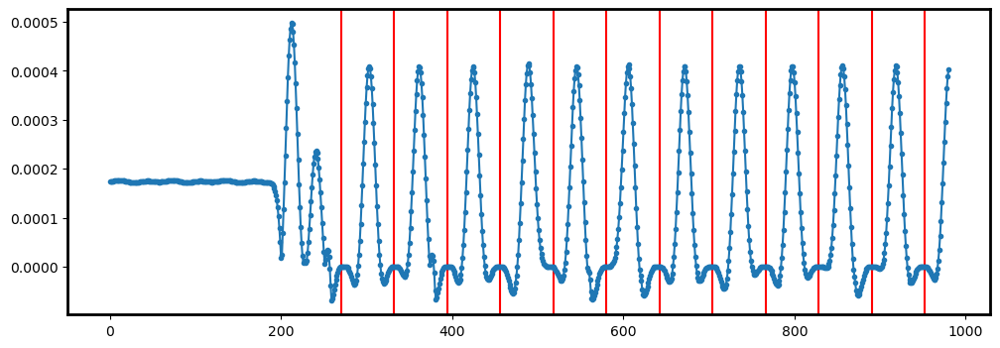

62


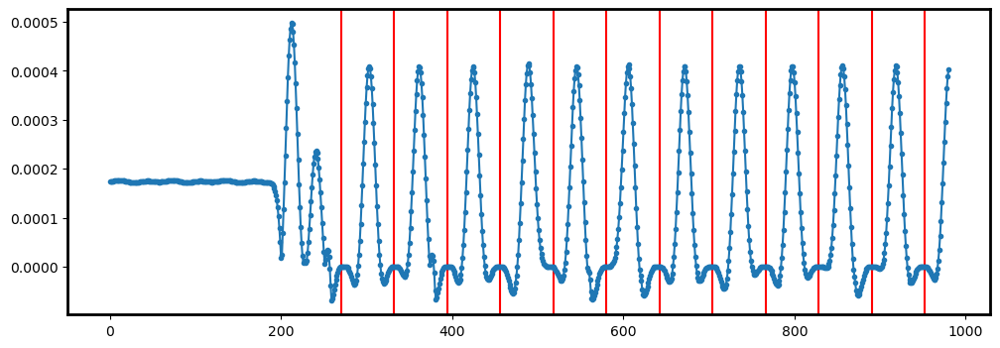

63


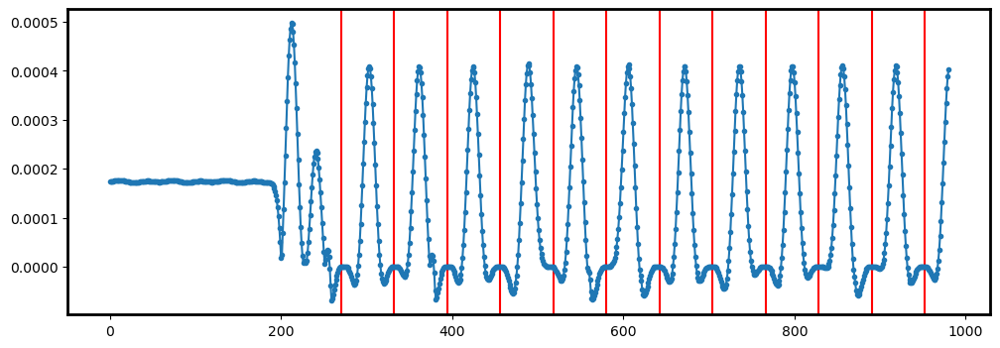

64


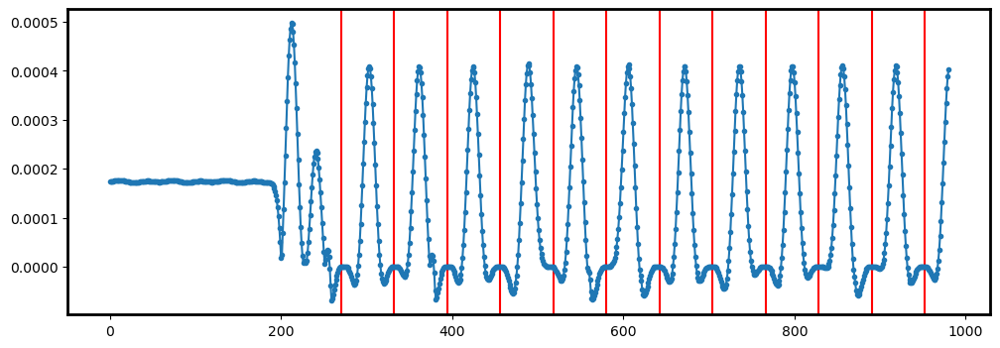

65


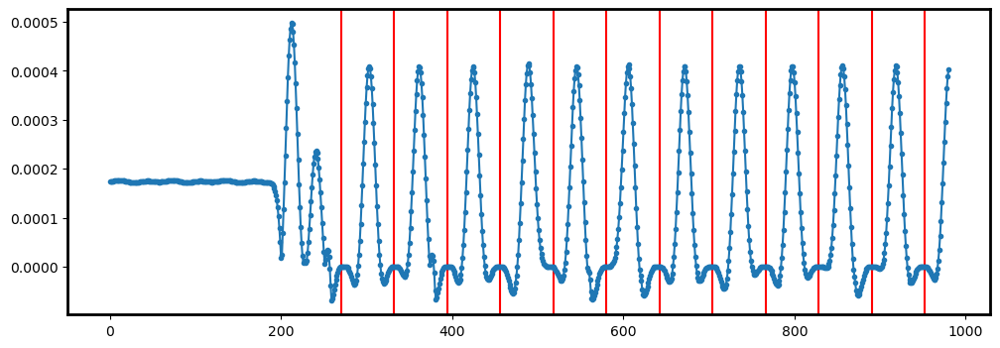

66


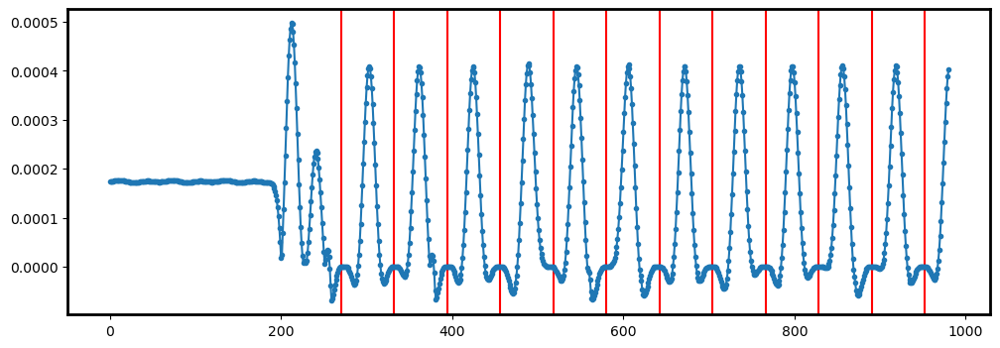

67


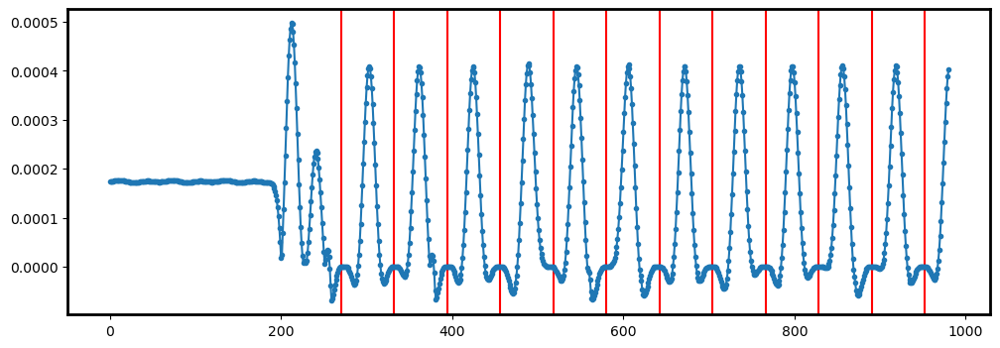

68


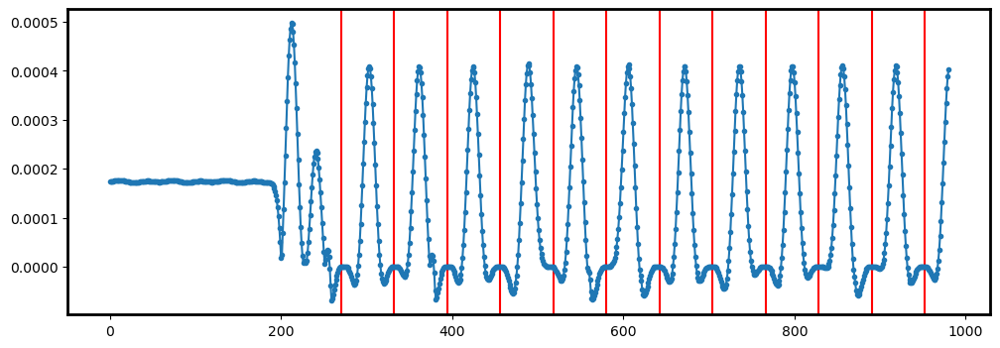

69


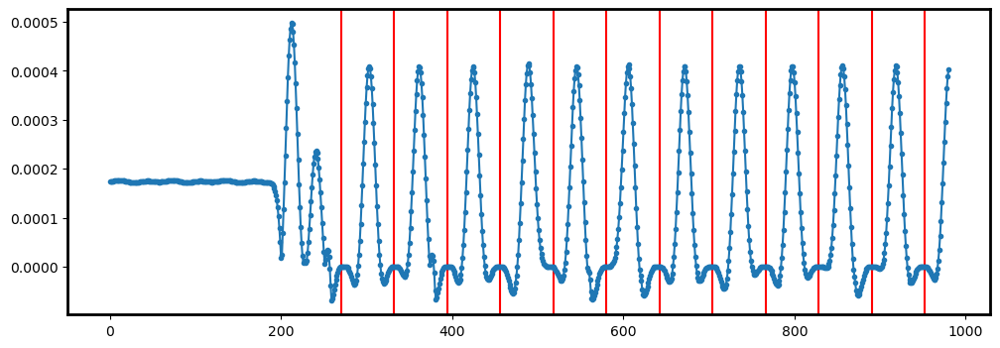

70


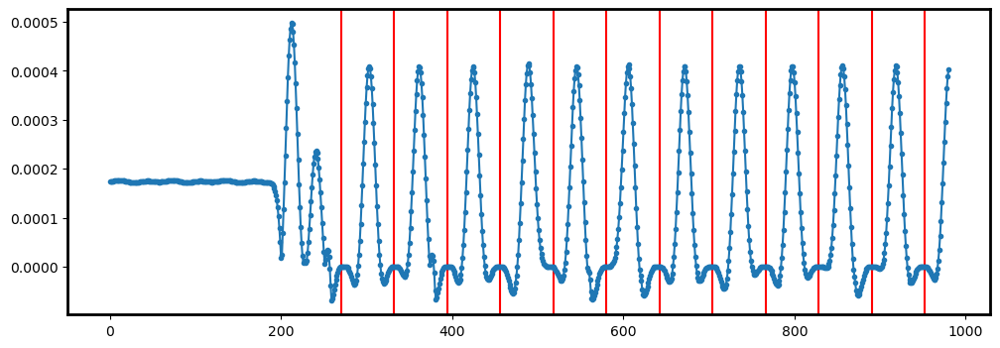

71


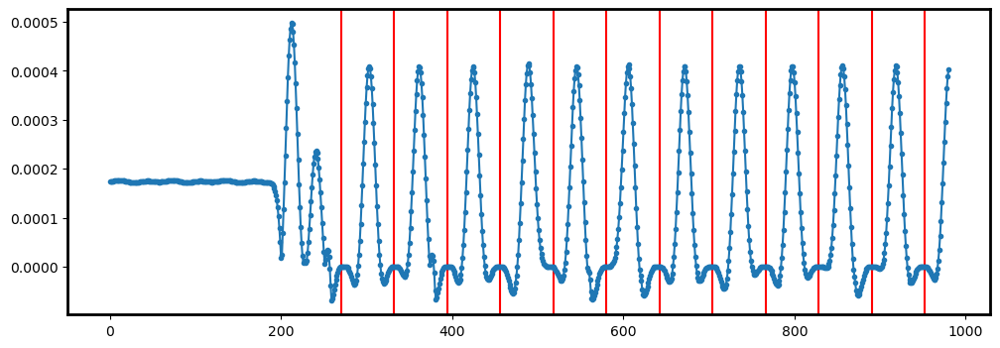

72


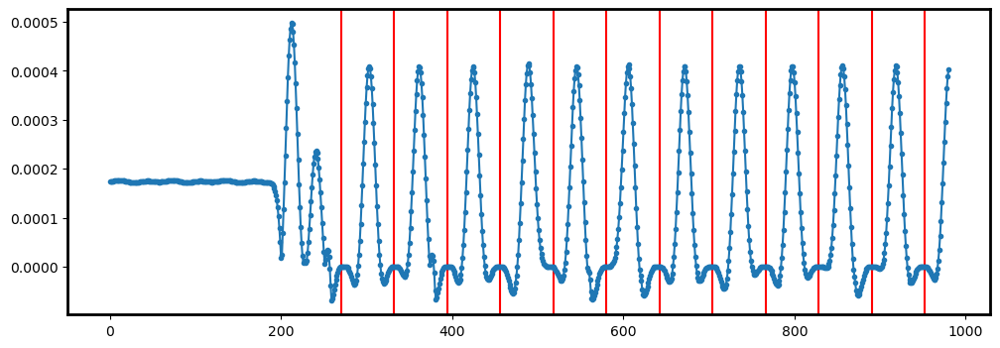

73


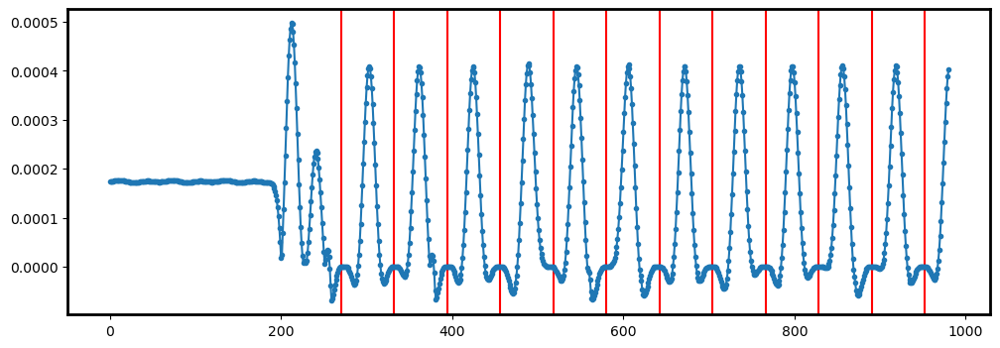

74


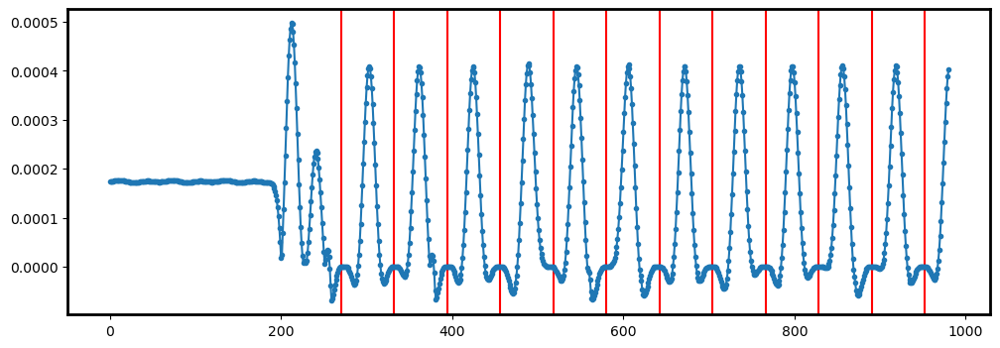

75


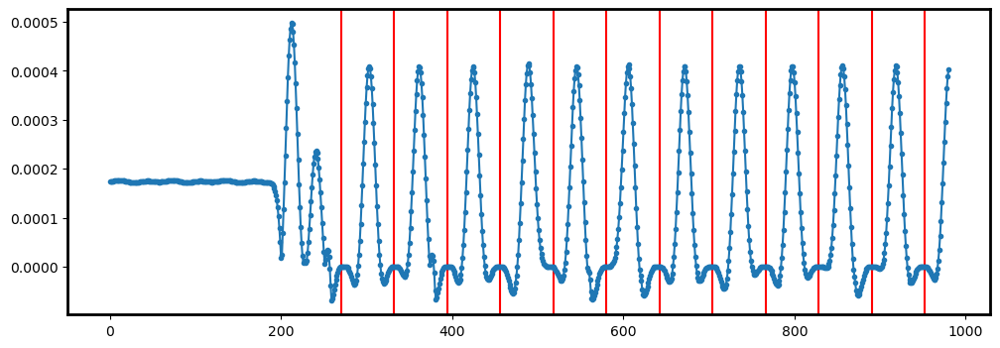

76


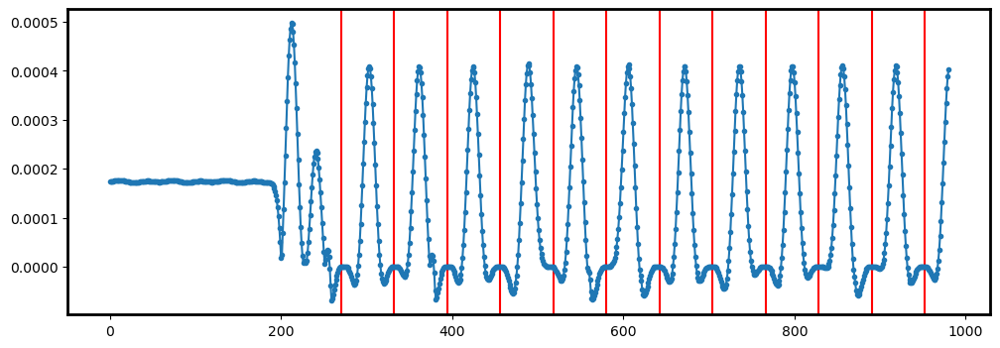

77


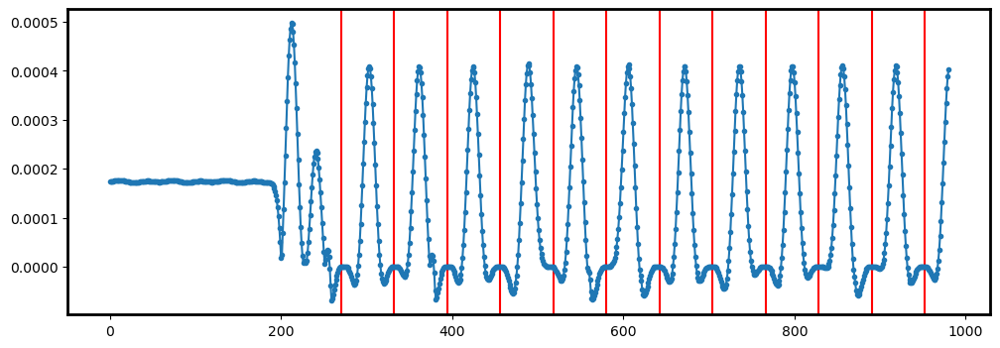

78


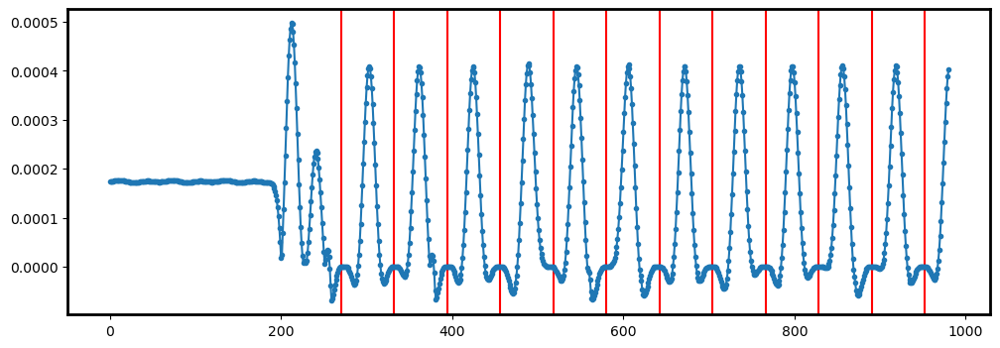

79


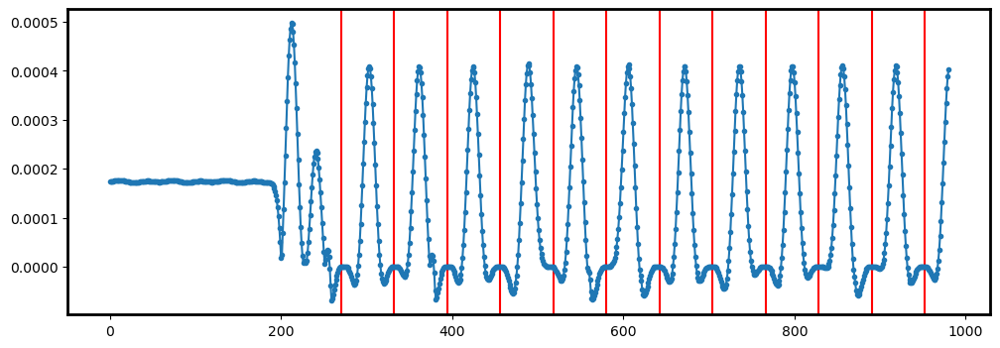

80


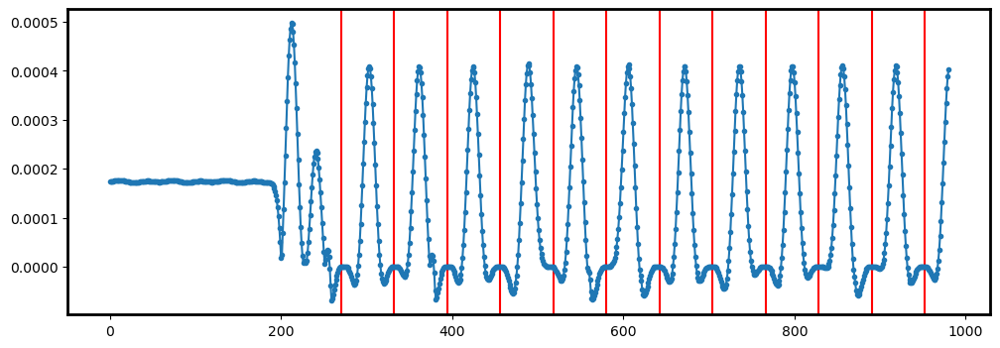

81


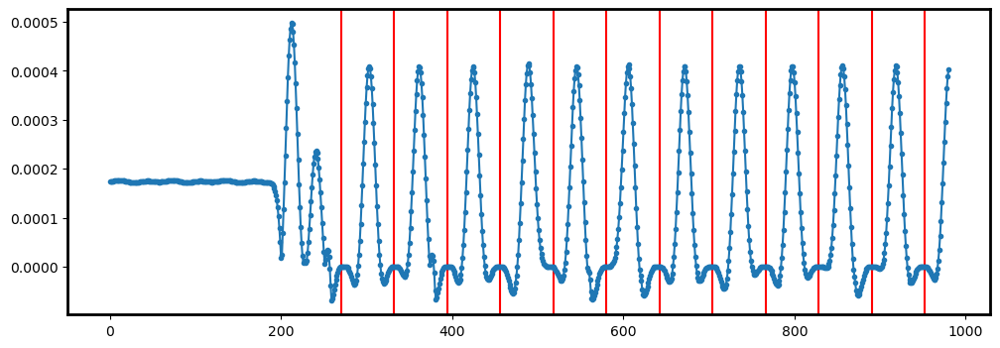

82


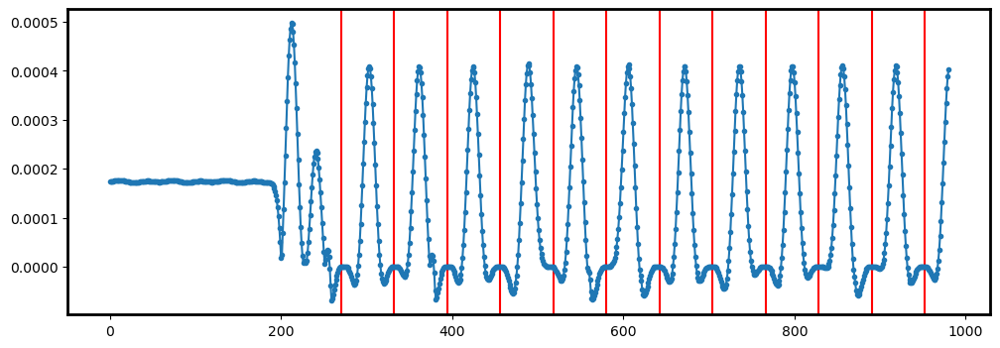

83


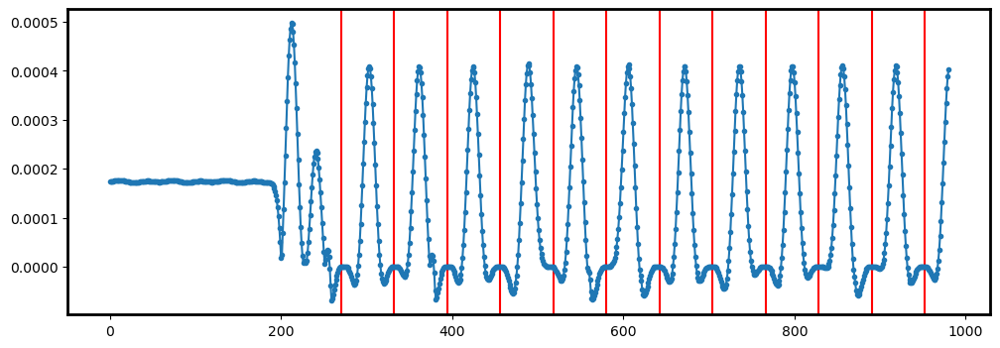

84


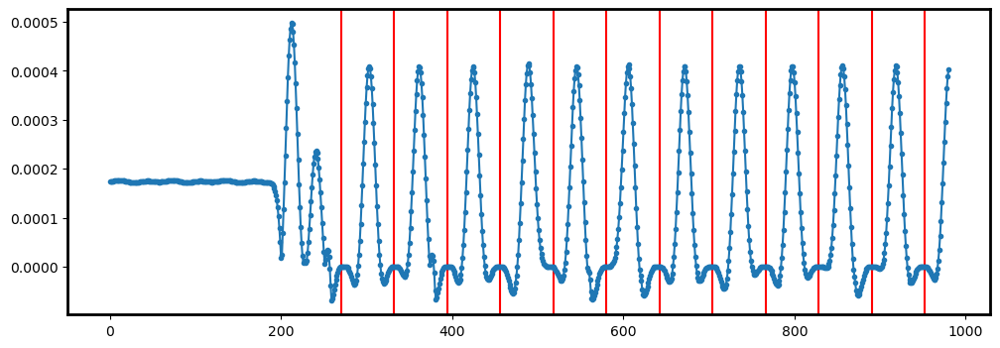

85


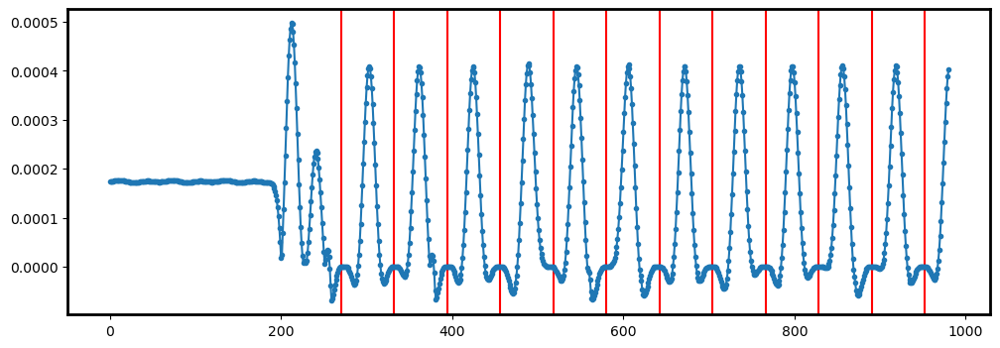

86


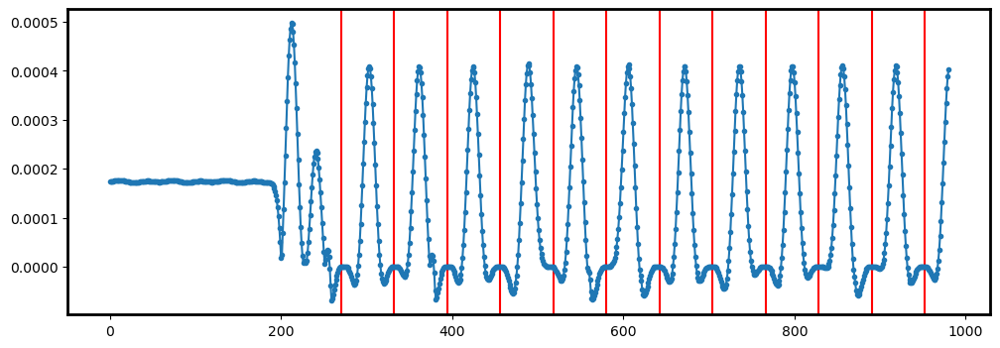

87


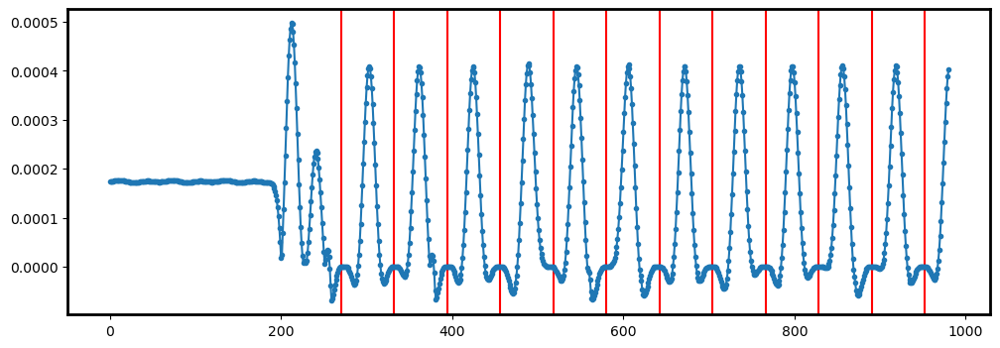

88


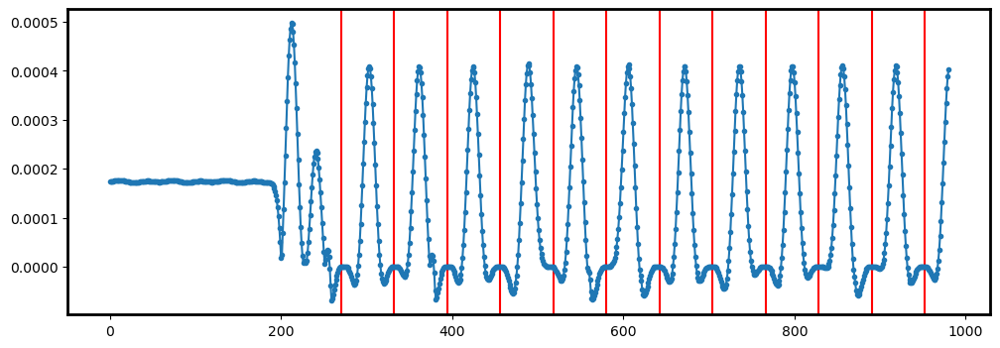

89


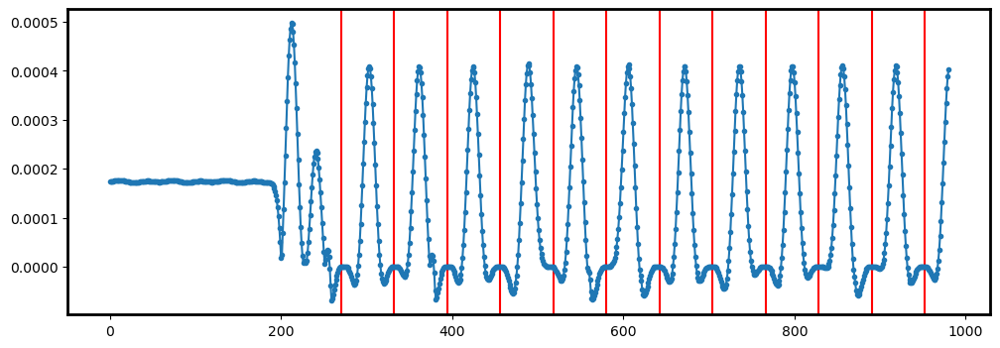

90


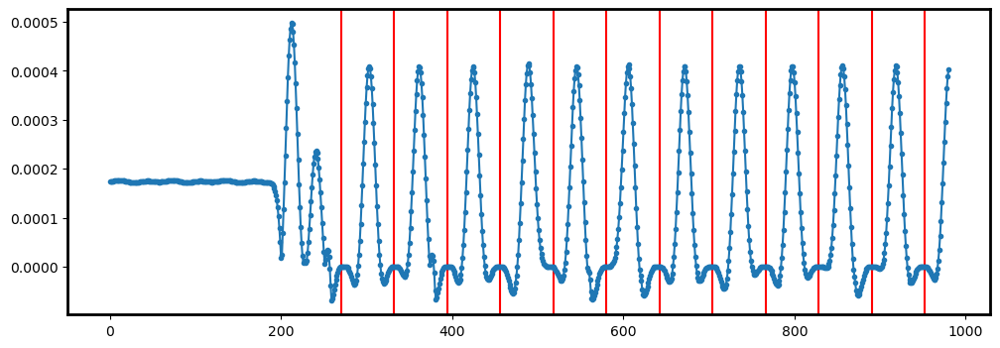

91


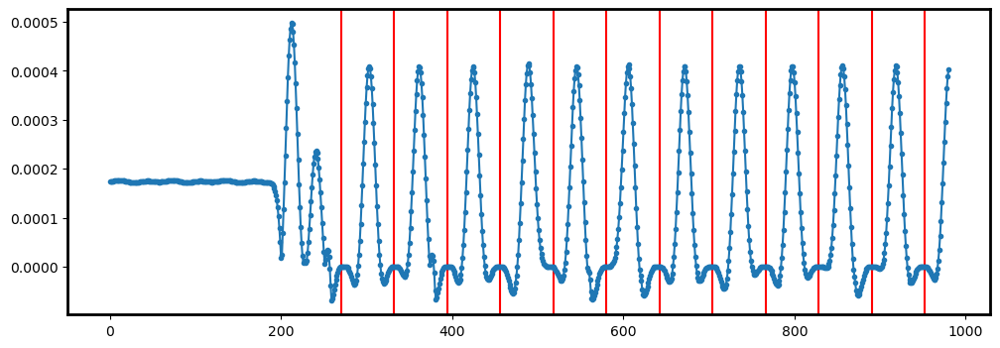

92


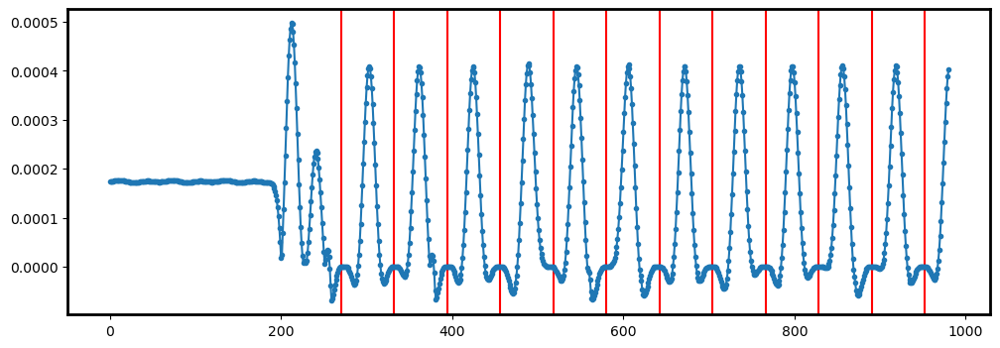

93


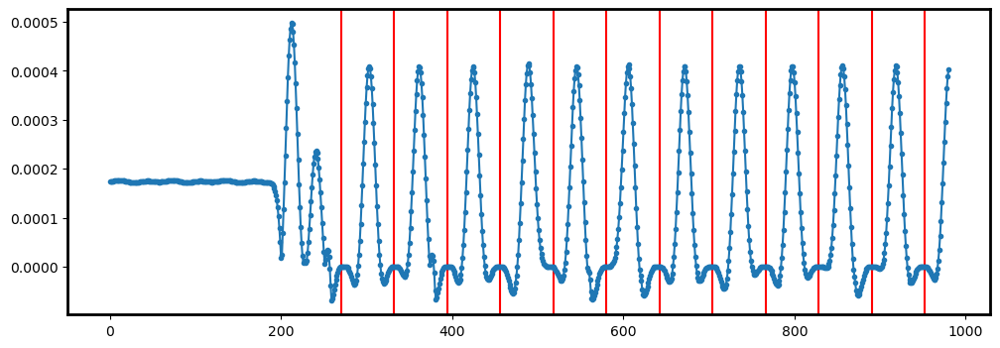

94


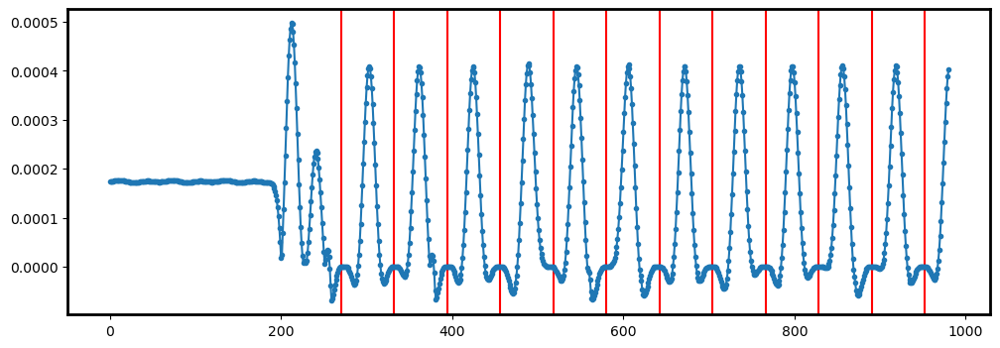

95


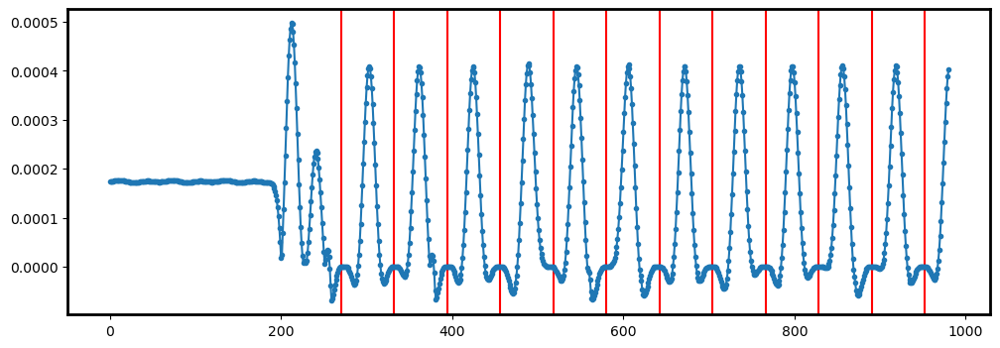

96


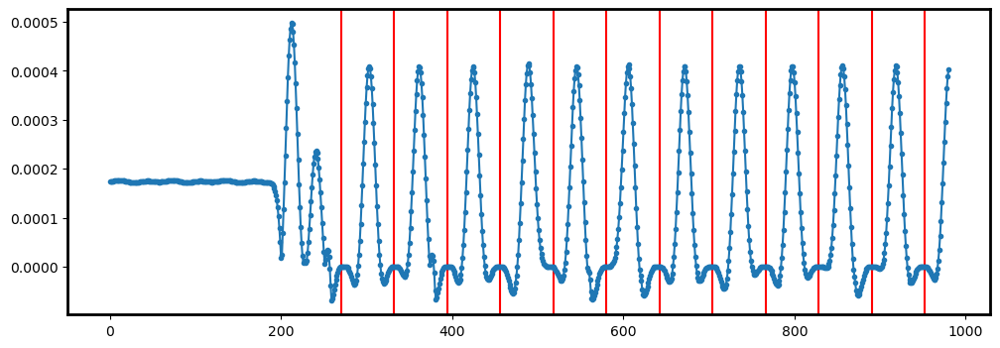

97


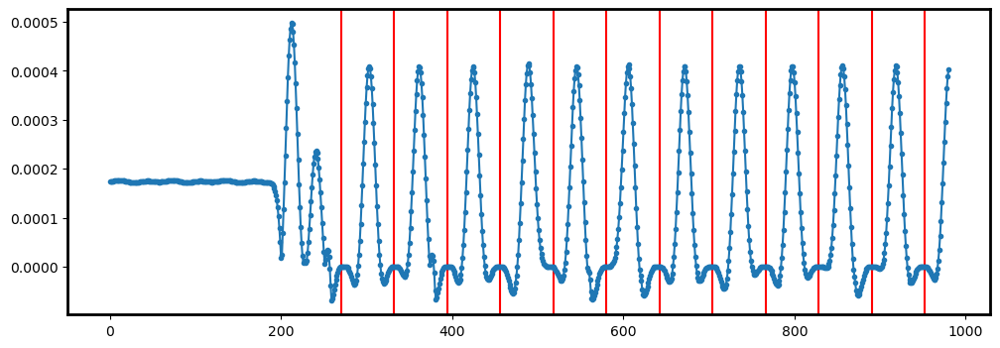

98


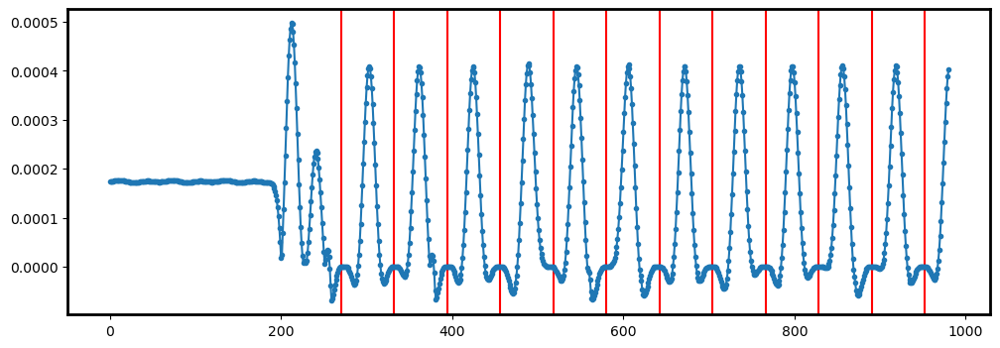

99


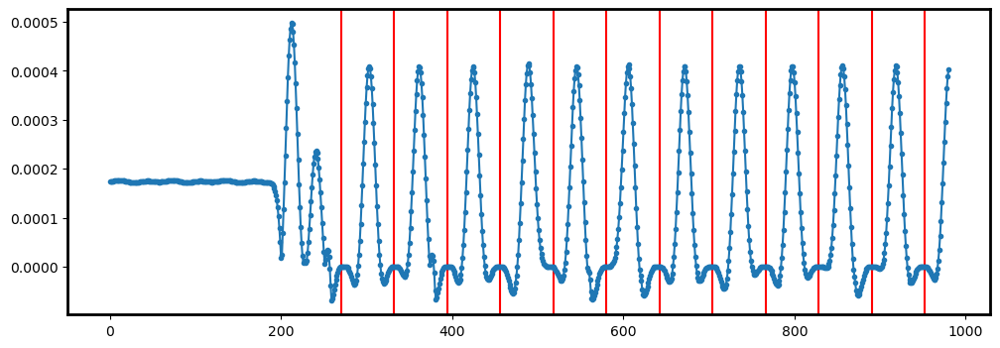

In [86]:
for j in range(100):
    index = j
    print(j)
    plt.figure(figsize=(12, 4))
    pr_slice_Ti = np.sum(pr_real[i][1][73:77], axis = 0)
   
    
    start = 245
    a_space = 62
    _, Ti_gaussian = fit_p_r_new_Ti(pr_slice_Ti, start, a_space)

    start = 270
    spacing = 62
    for i in range(N_bulk+N_surface): 
        plt.axvline(start + i*spacing, color = "red")
        
    plt.plot(pr_slice_Ti - Ti_gaussian, '.-')

    plt.show()

In [87]:
start = 270
a_space = 62

start_Ti = 245
a_space_Ti = 62

real_o3s = []
pred_o3s = []

for i in range(len(pr_real)):
    pr_slice_Ti = np.sum(pr_real[i][1][73:77], axis = 0)
   
    _, Ti_gaussian = fit_p_r_new_Ti(pr_slice_Ti, start_Ti, a_space_Ti)
    pr_slice_o3 = pr_slice_Ti - Ti_gaussian
    
    spacings, gaus_fit = fit_p_r_new(pr_slice_o3, start, a_space)
    spacings = np.flip(spacings)
    real_o3s.append(spacings)

for i in range(len(pr_pred)):
    print(i)
    pr_slice_Ti = np.sum(pr_pred[i][1][73:77], axis = 0)
   
    _, Ti_gaussian = fit_p_r_new_Ti(pr_slice_Ti, start_Ti, a_space_Ti)
    pr_slice_o3 = pr_slice_Ti - Ti_gaussian
    
    spacings, gaus_fit = fit_p_r_new(pr_slice_o3, start, a_space)
    spacings = np.flip(spacings)
    pred_o3s.append(spacings)
    
real_o3s = np.array(real_o3s)
pred_o3s = np.array(pred_o3s)


0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49


Index:  0
R^2:  0.99


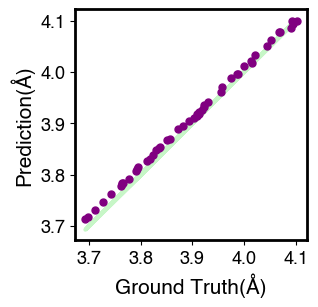

Index:  1
R^2:  1.0


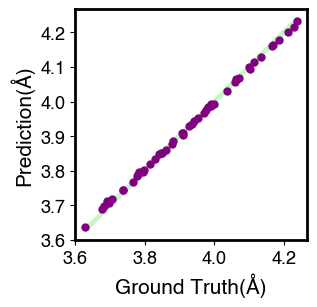

Index:  2
R^2:  1.0


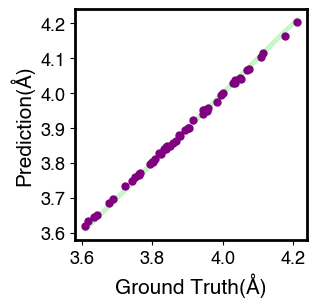

Index:  3
R^2:  1.0


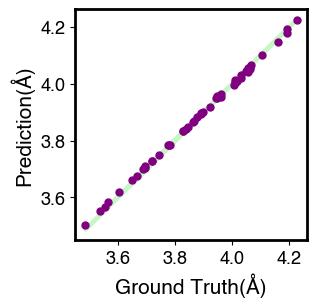

Index:  4
R^2:  1.0


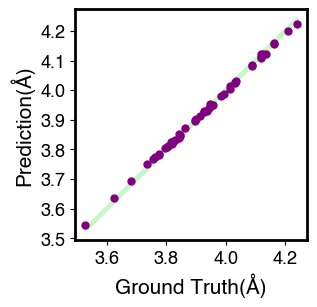

Index:  5
R^2:  1.0


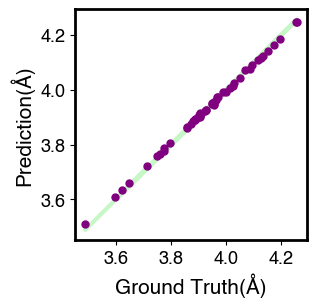

Index:  6
R^2:  1.0


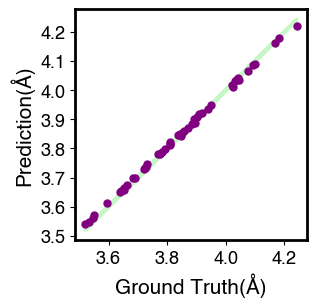

Index:  7
R^2:  1.0


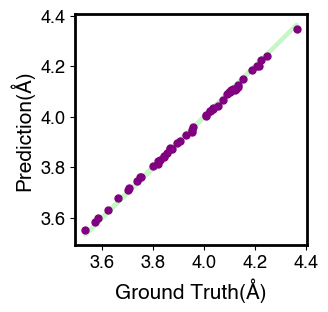

Index:  8
R^2:  1.0


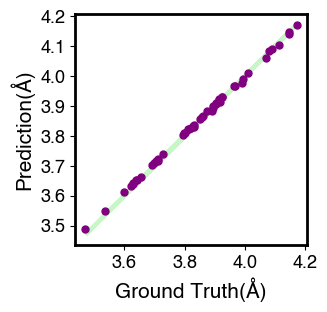

Index:  9
R^2:  1.0


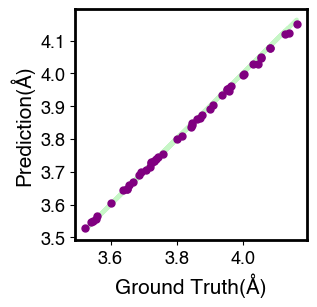

Index:  10
R^2:  1.0


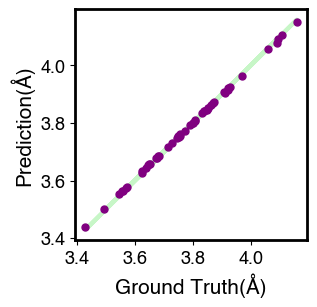

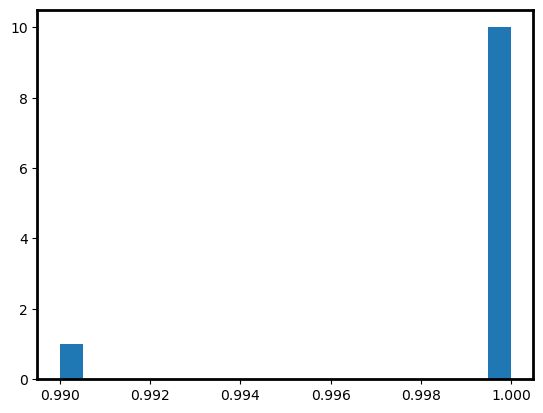

0.9990909090909091


In [88]:
input_o3s = np.array(all_o3s[train_size:train_size+50])
r2_arr_pr = []

for i in range(N_bulk+N_surface-1):

    print("Index: ", i)
    r2_val = rSquared(real_o3s[:, i], input_o3s[:, i+1])
    print("R^2: ", r2_val)
    r2_arr_pr.append(r2_val)
    #plt.plot(y_train[:, i], predictions_train[:, i] , color = 'blue', linewidth = 5, label = "Train", alpha = 0.2)
    #plt.plot(y_train[:, i], predictions_train[:, i]  ,'.', color = 'blue', linewidth = 0, label = "Train", alpha = 0.2)
    
    fig = plt.figure(figsize = (3, 3))
    plt.rcParams['axes.linewidth'] = 2
    plt.plot(real_o3s[:, i], real_o3s[:, i], color = "lightgreen", linewidth = 3, alpha = 0.5)

    plt.plot(real_o3s[:, i], input_o3s[:, i+1] , '.', markersize = 10, color = 'purple', label = "Test", alpha = 1)


    plt.xlabel('Ground Truth(Å)', fontname = 'Helvetica',fontsize = 15 )
    plt.ylabel('Prediction(Å)', fontname = 'Helvetica',fontsize = 15  )

    plt.xticks(fontsize = 13, fontname = 'Helvetica' )
    plt.yticks(fontsize = 13, fontname = 'Helvetica' )
    #plt.ylim(4, 13)
    #plt.legend(loc='upper left', markerscale=2, prop={'size': 25, "family":'Times new roman'})
    #plt.grid()
    plt.show()

plt.hist(r2_arr_pr, bins = 20)
plt.show()
print(np.mean(r2_arr_pr))

Index:  0
R^2:  0.95


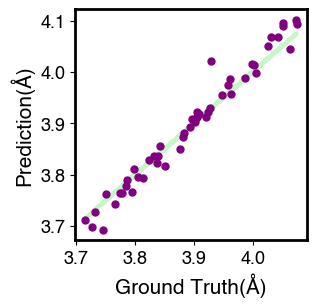

Index:  1
R^2:  0.92


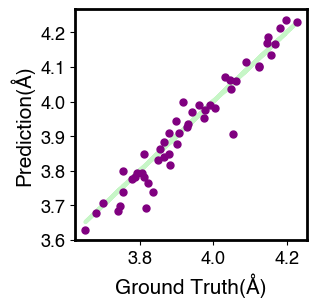

Index:  2
R^2:  0.88


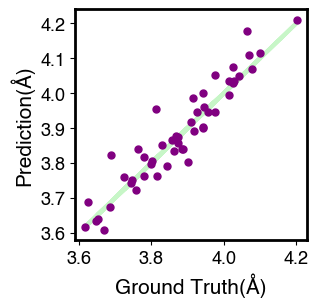

Index:  3
R^2:  0.88


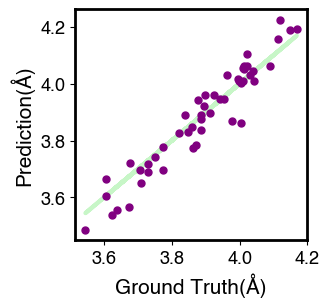

Index:  4
R^2:  0.85


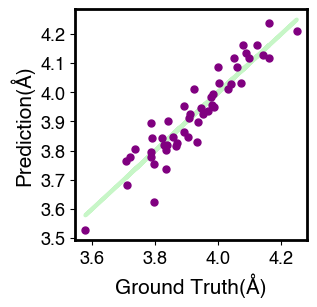

Index:  5
R^2:  0.81


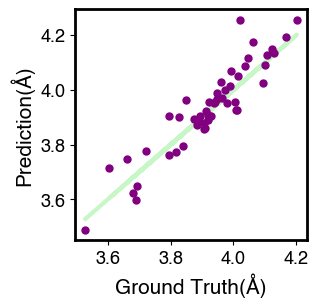

Index:  6
R^2:  0.75


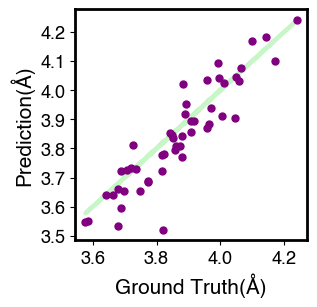

Index:  7
R^2:  0.66


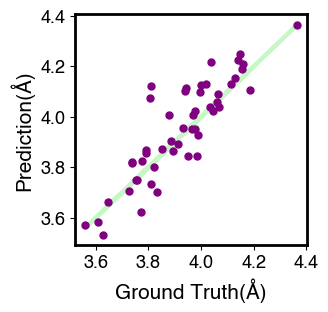

Index:  8
R^2:  0.45


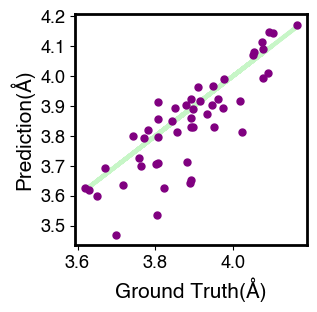

Index:  9
R^2:  0.68


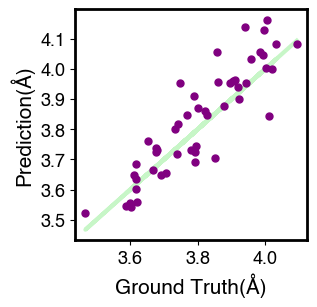

Index:  10
R^2:  0.61


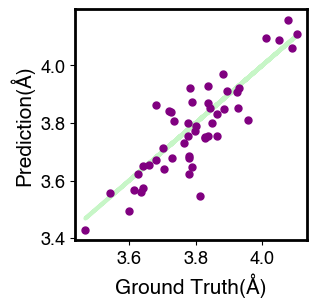

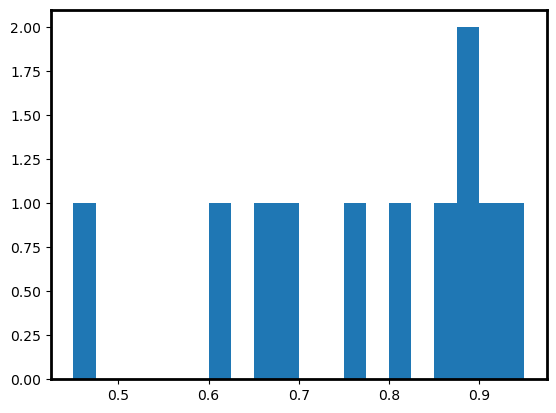

0.7672727272727272


In [89]:
r2_arr_pr_o3 = []

for i in range(N_bulk+N_surface-1):

    print("Index: ", i)
    r2_val = rSquared(pred_o3s[:, i], real_o3s[:, i])
    print("R^2: ", r2_val)
    r2_arr_pr_o3.append(r2_val)
    #plt.plot(y_train[:, i], predictions_train[:, i] , color = 'blue', linewidth = 5, label = "Train", alpha = 0.2)
    #plt.plot(y_train[:, i], predictions_train[:, i]  ,'.', color = 'blue', linewidth = 0, label = "Train", alpha = 0.2)
    
    fig = plt.figure(figsize = (3, 3))
    plt.rcParams['axes.linewidth'] = 2
    plt.plot(pred_o3s[:, i], pred_o3s[:, i], color = "lightgreen", linewidth = 3, alpha = 0.5)

    plt.plot(pred_o3s[:, i], real_o3s[:, i] , '.', markersize = 10, color = 'purple', label = "Test", alpha = 1)


    plt.xlabel('Ground Truth(Å)', fontname = 'Helvetica',fontsize = 15 )
    plt.ylabel('Prediction(Å)', fontname = 'Helvetica',fontsize = 15  )

    plt.xticks(fontsize = 13, fontname = 'Helvetica' )
    plt.yticks(fontsize = 13, fontname = 'Helvetica' )
    #plt.ylim(4, 13)
    #plt.legend(loc='upper left', markerscale=2, prop={'size': 25, "family":'Times new roman'})
    #plt.grid()
    plt.show()

plt.hist(r2_arr_pr_o3, bins = 20)
plt.show()
print(np.mean(r2_arr_pr_o3))

# P value extraction

In [90]:
len(all_ps)

101000

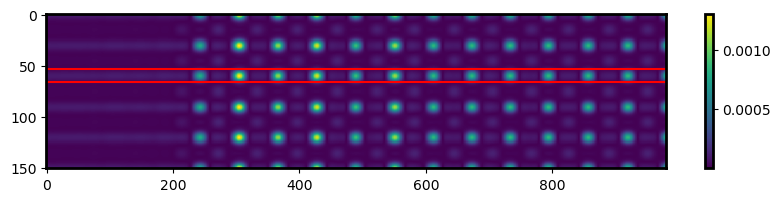

In [91]:
plt.figure(figsize=(10, 2))
plt.imshow(pr_pred[0][0], interpolation='nearest', aspect='auto')
plt.axhline(53, color = 'red')
plt.axhline(66, color = 'red')

plt.colorbar()
#plt.clim(0, 0.0002)
#plt.xlim(0, 424)
#plt.ylim(0,424)
plt.show()


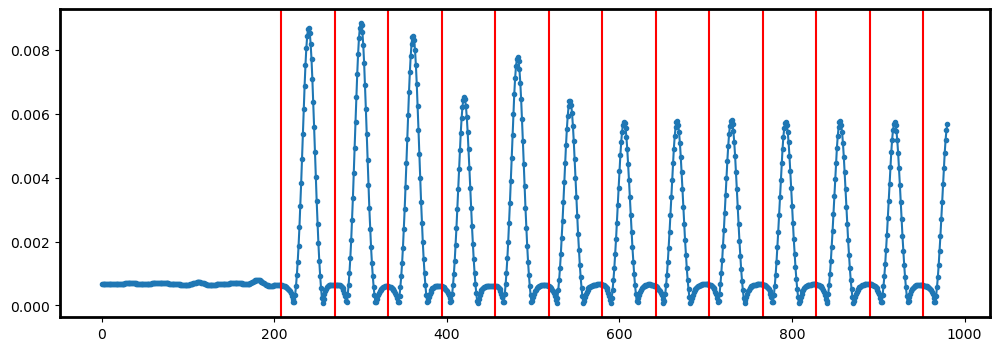

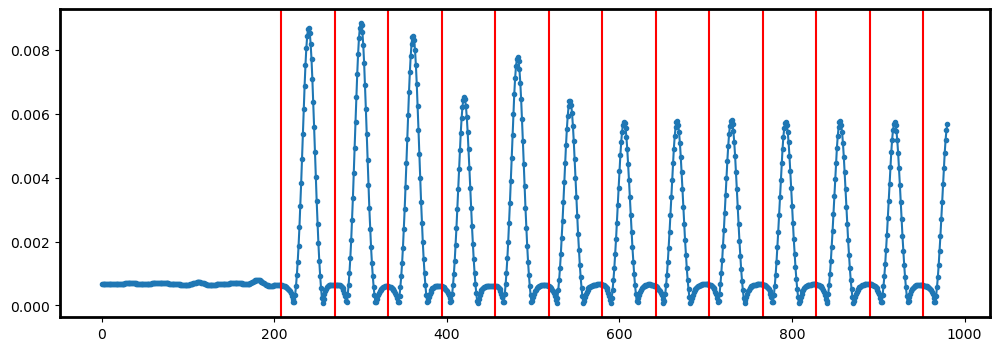

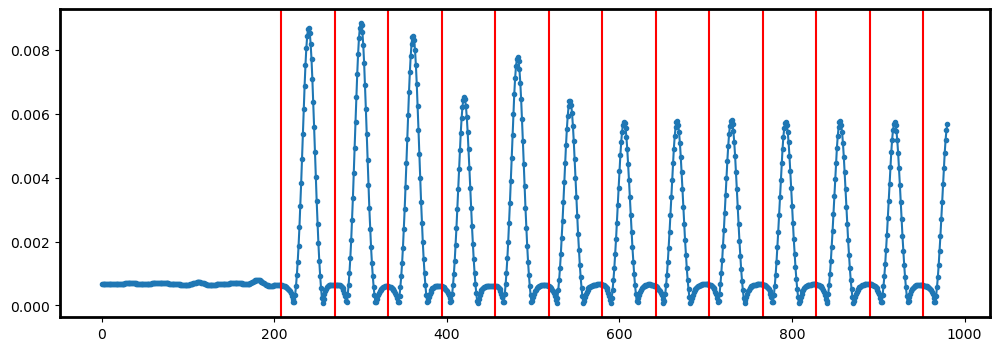

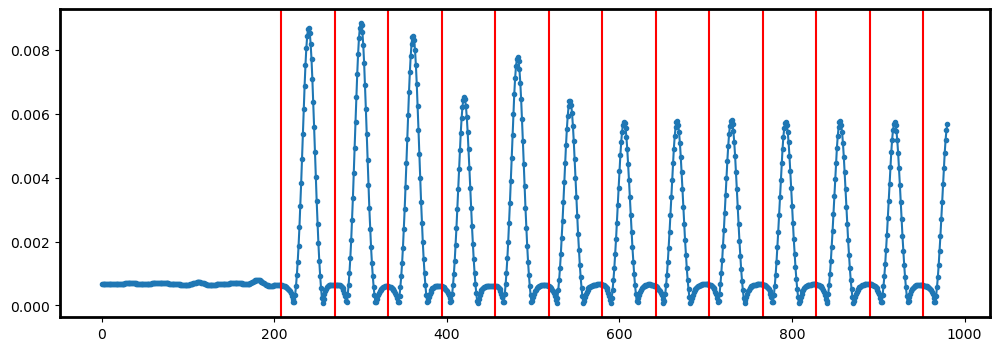

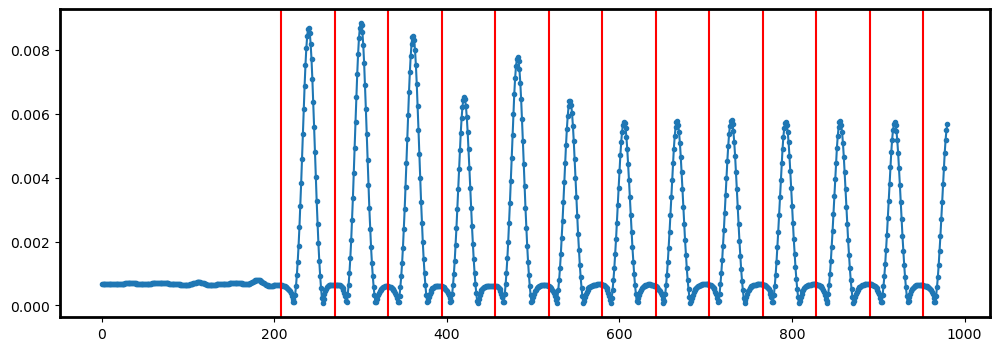

...

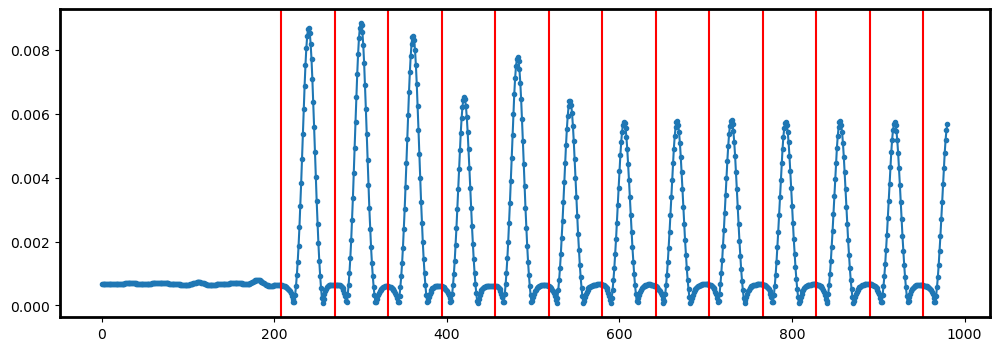

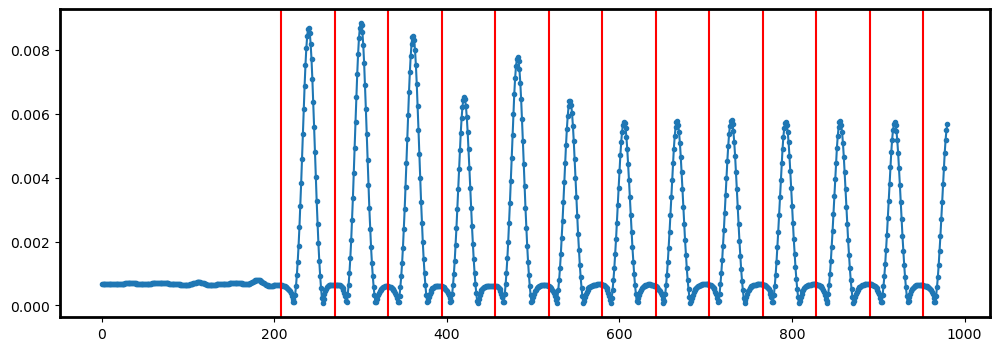

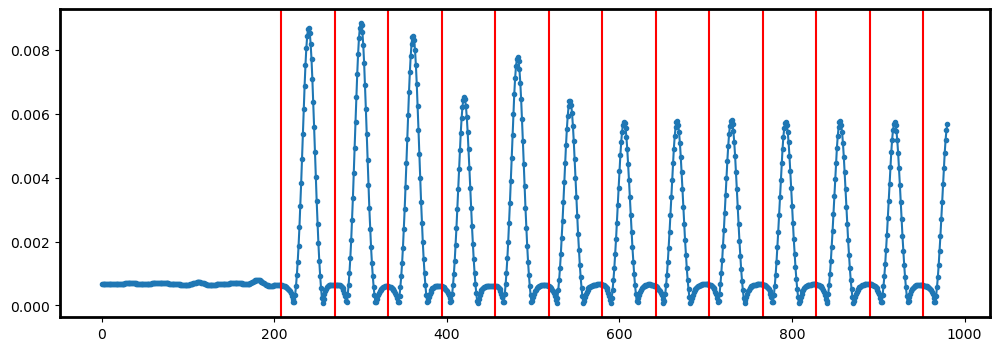

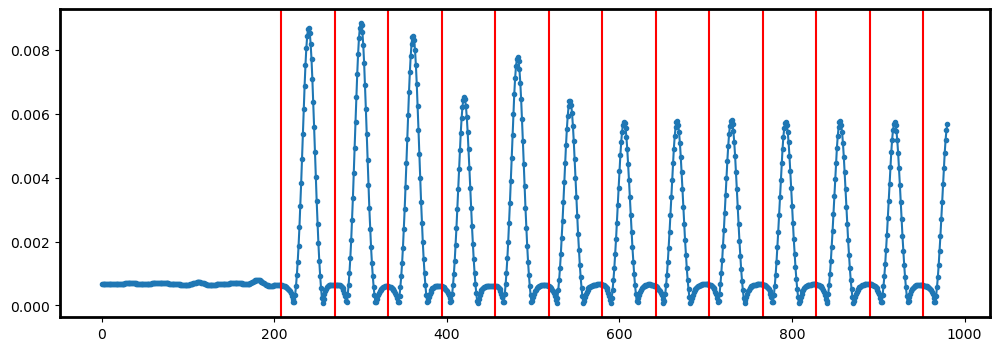

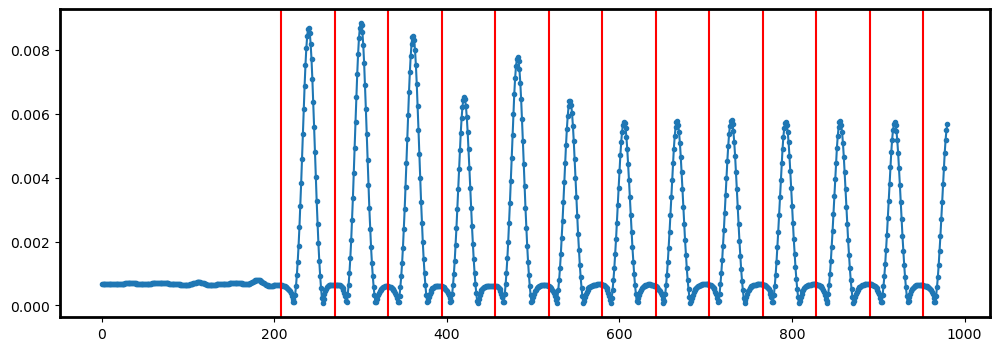

In [92]:
charges_pred = []
charges_real = []
for j in range(50):

    plt.figure(figsize=(12, 4))
    pr_slice_Sr_pred = np.sum(pr_pred[j][0][53:66], axis = 0)
    pr_slice_Sr_real = np.sum(pr_real[j][0][53:66], axis = 0)

    plt.plot(pr_slice_Sr, '.-')

    pred_temp_q = []
    real_temp_q = []
    start = 270-62
    spacing = 62
    #start = 172
    #spacing = 62
    for i in range(N_bulk+N_surface+1): #+1 for roughness
        plt.axvline(start + i*spacing, color = "red")
        pred_temp_q.append(np.sum(pr_slice_Sr_pred[start + i*spacing: start + (i+1)*spacing]))
        real_temp_q.append(np.sum(pr_slice_Sr_real[start + i*spacing: start + (i+1)*spacing]))

        
        
    charges_pred.append(np.flip(pred_temp_q))
    charges_real.append(np.flip(real_temp_q))

    plt.show()

0.9834799115256976 0.550446439236236
0.5283565936167904 0.6813886746002619
0.7253752303895422 0.6301408646548935
0.5995449530008403 0.13802402150860846


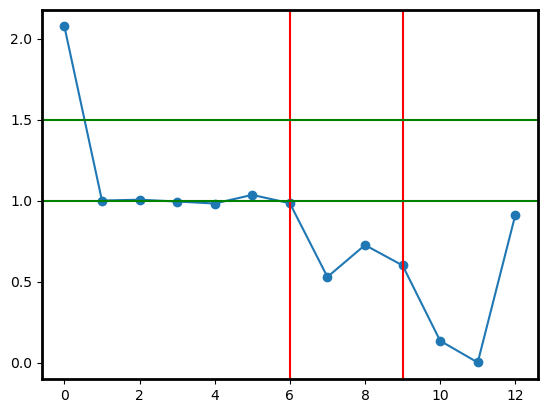

In [93]:
charges_pred = np.array(charges_pred)
charges_real = np.array(charges_real)


input_ps = np.array(all_ps[train_size:train_size+50])
index = 6
q_Sr = charges_pred[index][1]

plt.plot(3 - 2*(charges_pred[index]/q_Sr), 'o-')
plt.axvline(6, color = "red")
plt.axvline(9, color = "red")
plt.axhline(1.5, color = 'green')
plt.axhline(1.0, color = 'green')

print(3 - 2*(charges_pred[index][6]/q_Sr), input_ps[index][0])
print(3 - 2*(charges_pred[index][7]/q_Sr), input_ps[index][1])
print(3 - 2*(charges_pred[index][8]/q_Sr), input_ps[index][2])
print(3 - 2*(charges_pred[index][9]/q_Sr), input_ps[index][3])

0.5443135260328655 0.550446439236236
0.6777780432068949 0.6813886746002619
0.6266389693402963 0.6301408646548935
0.12244881089131443 0.13802402150860846


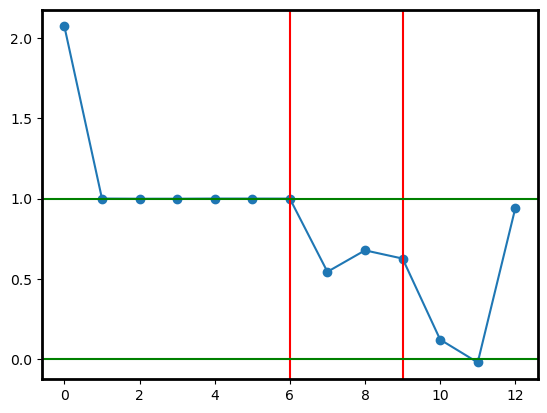

In [94]:
charges_pred = np.array(charges_pred)
charges_real = np.array(charges_real)


input_charges = np.array(all_ps[train_size:train_size+50])
index = 6
q_Sr = charges_real[index][1]

plt.plot(3 - 2*(charges_real[index]/q_Sr), 'o-')
plt.axvline(6, color = "red")
plt.axvline(9, color = "red")
plt.axhline(0, color = 'green')
plt.axhline(1.0, color = 'green')

print(3 - 2*(charges_real[index][7]/q_Sr), input_charges[index][0])
print(3 - 2*(charges_real[index][8]/q_Sr), input_charges[index][1])
print(3 - 2*(charges_real[index][9]/q_Sr), input_charges[index][2])
print(3 - 2*(charges_real[index][10]/q_Sr), input_charges[index][3])

In [95]:
test_arr = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]
test_arr[6:9]

[6, 7, 8]

In [96]:
p_pred = []
p_real = []

rough_pred = []
rough_real = []

for i in range(len(charges_pred)):
    q_pred = charges_pred[i][1]
    p_pred.append(3 - 2*(charges_pred[i]/q_pred)[7:11])
    rough_pred.append((2/3)*(charges_pred[i]/q_pred)[12])
    
    q_real = charges_real[i][1]
    p_real.append(3 - 2*(charges_real[i]/q_real)[7:11])
    rough_real.append((2/3)*(charges_real[i]/q_real)[12])

    
p_pred = np.array(p_pred)
p_real = np.array(p_real)

rough_pred = np.array(rough_pred)
rough_real = np.array(rough_real)

Index:  0
R^2:  1.0


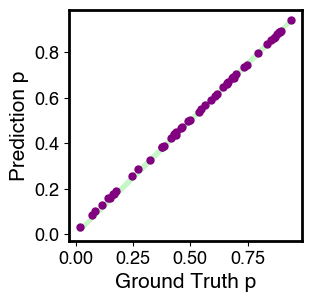

Index:  1
R^2:  1.0


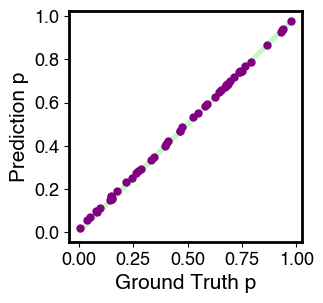

Index:  2
R^2:  1.0


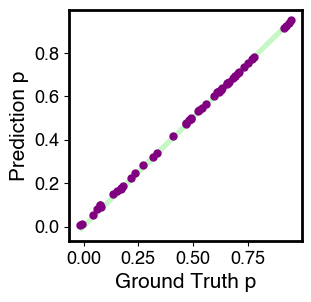

Index:  3
R^2:  1.0


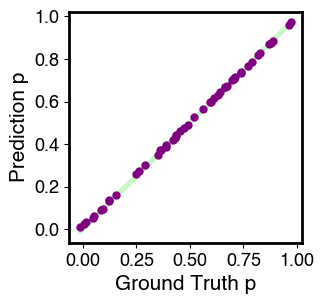

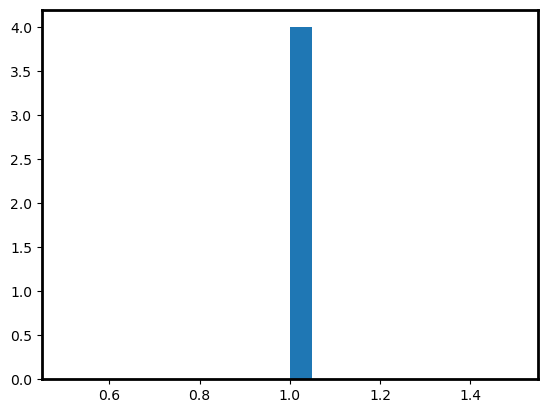

1.0


In [97]:
r2_arr_pr = []
input_ps = np.array(all_ps[train_size:train_size+50])

for i in range(4):

    print("Index: ", i)
    r2_val = rSquared(p_real[:, i], input_ps[:, i])
    print("R^2: ", r2_val)
    r2_arr_pr.append(r2_val)
    #plt.plot(y_train[:, i], predictions_train[:, i] , color = 'blue', linewidth = 5, label = "Train", alpha = 0.2)
    #plt.plot(y_train[:, i], predictions_train[:, i]  ,'.', color = 'blue', linewidth = 0, label = "Train", alpha = 0.2)
    
    fig = plt.figure(figsize = (3, 3))
    plt.rcParams['axes.linewidth'] = 2
    plt.plot(p_real[:, i], p_real[:, i], color = "lightgreen", linewidth = 3, alpha = 0.5)

    plt.plot(p_real[:, i], input_ps[:, i] , '.', markersize = 10, color = 'purple', label = "Test", alpha = 1)


    plt.xlabel('Ground Truth p', fontname = 'Helvetica',fontsize = 15 )
    plt.ylabel('Prediction p', fontname = 'Helvetica',fontsize = 15  )

    plt.xticks(fontsize = 13, fontname = 'Helvetica' )
    plt.yticks(fontsize = 13, fontname = 'Helvetica' )
    #plt.ylim(4, 13)
    #plt.legend(loc='upper left', markerscale=2, prop={'size': 25, "family":'Times new roman'})
    #plt.grid()
    plt.show()

plt.hist(r2_arr_pr, bins = 20)
plt.show()
print(np.mean(r2_arr_pr))

Index:  0
R^2:  0.99


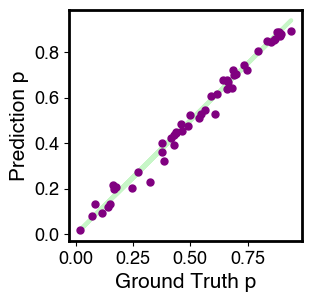

Index:  1
R^2:  0.99


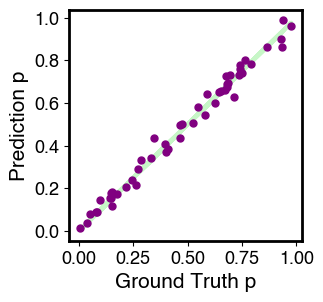

Index:  2
R^2:  0.99


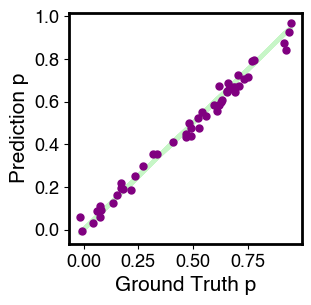

Index:  3
R^2:  0.99


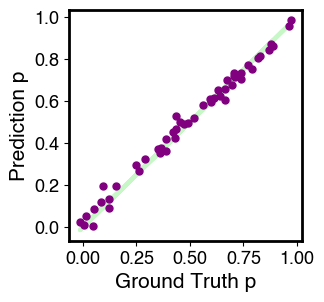

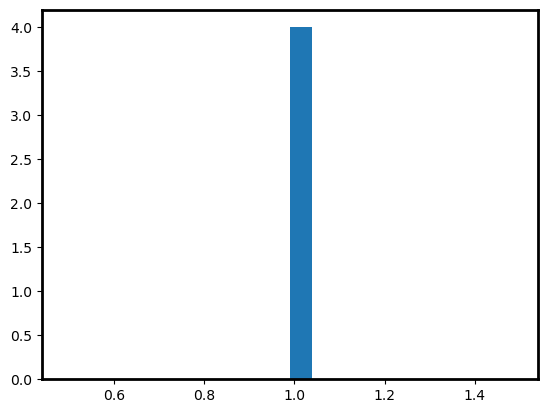

0.99


In [98]:
r2_arr_charge_mix = []
input_ps = np.array(all_ps[train_size:train_size+50])

for i in range(4):

    print("Index: ", i)
    r2_val = rSquared(p_pred[:, i], input_ps[:, i])
    print("R^2: ", r2_val)
    r2_arr_charge_mix.append(r2_val)
    #plt.plot(y_train[:, i], predictions_train[:, i] , color = 'blue', linewidth = 5, label = "Train", alpha = 0.2)
    #plt.plot(y_train[:, i], predictions_train[:, i]  ,'.', color = 'blue', linewidth = 0, label = "Train", alpha = 0.2)
    
    fig = plt.figure(figsize = (3, 3))
    plt.rcParams['axes.linewidth'] = 2
    plt.plot(p_real[:, i], p_real[:, i], color = "lightgreen", linewidth = 3, alpha = 0.5)

    plt.plot(p_real[:, i], p_pred[:, i] , '.', markersize = 10, color = 'purple', label = "Test", alpha = 1)


    plt.xlabel('Ground Truth p', fontname = 'Helvetica',fontsize = 15 )
    plt.ylabel('Prediction p', fontname = 'Helvetica',fontsize = 15  )

    plt.xticks(fontsize = 13, fontname = 'Helvetica' )
    plt.yticks(fontsize = 13, fontname = 'Helvetica' )
    #plt.ylim(4, 13)
    #plt.legend(loc='upper left', markerscale=2, prop={'size': 25, "family":'Times new roman'})
    #plt.grid()
    plt.show()

plt.hist(r2_arr_charge_mix, bins = 20)
plt.show()
print(np.mean(r2_arr_charge_mix))

Index:  0
R^2:  1.0


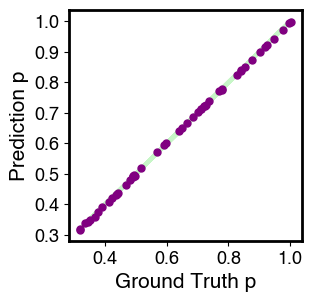

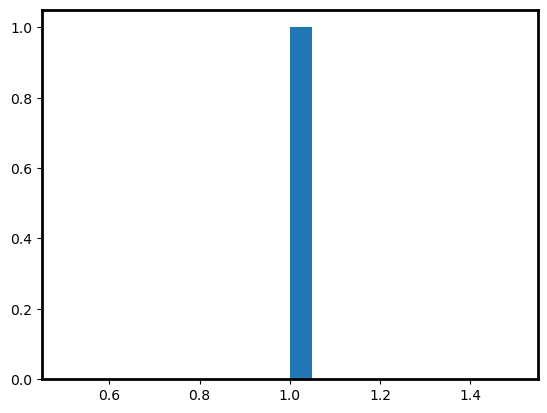

1.0


In [100]:
r2_arr_roughness = []
input_roughness = np.array(all_roughness[train_size:train_size+50])

for i in range(1):

    print("Index: ", i)
    r2_val = rSquared(rough_real, input_roughness)
    print("R^2: ", r2_val)
    r2_arr_roughness.append(r2_val)
    #plt.plot(y_train[:, i], predictions_train[:, i] , color = 'blue', linewidth = 5, label = "Train", alpha = 0.2)
    #plt.plot(y_train[:, i], predictions_train[:, i]  ,'.', color = 'blue', linewidth = 0, label = "Train", alpha = 0.2)
    
    fig = plt.figure(figsize = (3, 3))
    plt.rcParams['axes.linewidth'] = 2
    plt.plot(rough_real, rough_real, color = "lightgreen", linewidth = 3, alpha = 0.5)

    plt.plot(rough_real, input_roughness , '.', markersize = 10, color = 'purple', label = "Test", alpha = 1)


    plt.xlabel('Ground Truth p', fontname = 'Helvetica',fontsize = 15 )
    plt.ylabel('Prediction p', fontname = 'Helvetica',fontsize = 15  )

    plt.xticks(fontsize = 13, fontname = 'Helvetica' )
    plt.yticks(fontsize = 13, fontname = 'Helvetica' )
    #plt.ylim(4, 13)
    #plt.legend(loc='upper left', markerscale=2, prop={'size': 25, "family":'Times new roman'})
    #plt.grid()
    plt.show()

plt.hist(r2_arr_roughness, bins = 20)
plt.show()
print(np.mean(r2_arr_roughness))

Index:  0
R^2:  0.99


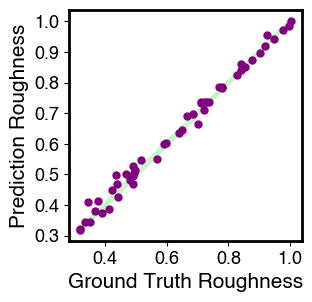

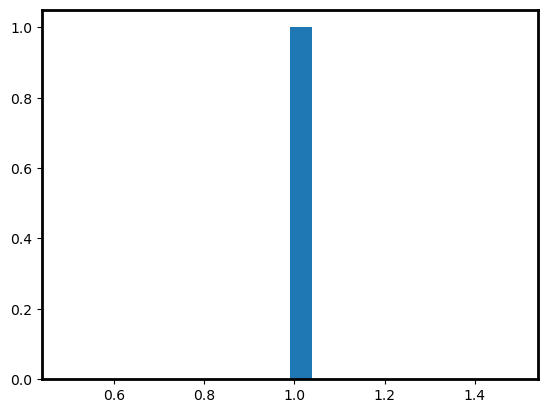

0.99


In [126]:
r2_arr_roughness = []
input_roughness = np.array(all_roughness[train_size:train_size+50])

for i in range(1):

    print("Index: ", i)
    r2_val = rSquared(rough_real, rough_pred)
    print("R^2: ", r2_val)
    r2_arr_roughness.append(r2_val)
    #plt.plot(y_train[:, i], predictions_train[:, i] , color = 'blue', linewidth = 5, label = "Train", alpha = 0.2)
    #plt.plot(y_train[:, i], predictions_train[:, i]  ,'.', color = 'blue', linewidth = 0, label = "Train", alpha = 0.2)
    
    fig = plt.figure(figsize = (3, 3))
    plt.rcParams['axes.linewidth'] = 2
    plt.plot(rough_real, rough_real, color = "lightgreen", linewidth = 3, alpha = 0.5)

    plt.plot(rough_real, rough_pred , '.', markersize = 10, color = 'purple', label = "Test", alpha = 1)


    plt.xlabel('Ground Truth Roughness', fontname = 'Helvetica',fontsize = 15 )
    plt.ylabel('Prediction Roughness', fontname = 'Helvetica',fontsize = 15  )

    plt.xticks(fontsize = 13, fontname = 'Helvetica' )
    plt.yticks(fontsize = 13, fontname = 'Helvetica' )
    #plt.ylim(4, 13)
    #plt.legend(loc='upper left', markerscale=2, prop={'size': 25, "family":'Times new roman'})
    #plt.grid()
    plt.show()

plt.hist(r2_arr_roughness, bins = 20)
plt.show()
print(np.mean(r2_arr_roughness))

# Analyzing r instead

In [102]:
#Reverse engineer this method
#cA_pr is the spacings of whatever atom we're considering
#zpos is the normal z position of the atom
def get_r_positions(cn_pr, cA_pr, zpos):
    
    r_arr = [0] * (N_bulk + N_surface-1)
    
    
    for i in range(len(r_arr)):
        if i == 0:
            r_arr[i] = (1/cn_pr[i])*(cA_pr[i] - c_bulk*(1-zpos))
            
        elif i == N_bulk + N_surface-2:
            #arbitrarily choosing c_surf for the final top layer
            r_arr[i] = (1/c_surf)*(cA_pr[i] - cn_pr[i-1]*(1-r_arr[i-1]))
            
        else:
            r_arr[i] = (1/cn_pr[i])*(cA_pr[i] - cn_pr[i-1]*(1-r_arr[i-1]))
            
    return r_arr

In [103]:
#retrieving all r positions
input_r_o1s = []
pred_r_o1s = []
real_r_o1s = []

input_r_o2s = []
pred_r_o2s = []
real_r_o2s = []

input_r_o3s = []
pred_r_o3s = []
real_r_o3s = []

input_r_Tis = []
pred_r_Tis = []
real_r_Tis = []

for i in range(50):
    input_r_o1s.append(get_r_positions(input_cns[i][1:], input_o1s[i][1:], r5[2]))
    pred_r_o1s.append(get_r_positions(pred_cns[i][1:], pred_o1s[i], r5[2]))
    real_r_o1s.append(get_r_positions(real_cns[i][1:], real_o1s[i], r5[2]))
    
    input_r_o2s.append(get_r_positions(input_cns[i][1:], input_o2s[i][1:], r4[2]))
    pred_r_o2s.append(get_r_positions(pred_cns[i][1:], pred_o2s[i], r4[2]))
    real_r_o2s.append(get_r_positions(real_cns[i][1:], real_o2s[i], r4[2]))
    
    input_r_o3s.append(get_r_positions(input_cns[i][1:], input_o3s[i][1:], r3[2]))
    pred_r_o3s.append(get_r_positions(pred_cns[i][1:], pred_o3s[i], r3[2]))
    real_r_o3s.append(get_r_positions(real_cns[i][1:], real_o3s[i], r3[2]))
    
    input_r_Tis.append(get_r_positions(input_cns[i][1:], input_Tis[i][1:], r2[2]))
    pred_r_Tis.append(get_r_positions(pred_cns[i][1:], pred_Tis[i], r2[2]))
    real_r_Tis.append(get_r_positions(real_cns[i][1:], real_Tis[i], r2[2]))
    
input_r_o1s = np.array(input_r_o1s)
pred_r_o1s = np.array(pred_r_o1s)
real_r_o1s = np.array(real_r_o1s)

input_r_o2s = np.array(input_r_o2s)
pred_r_o2s = np.array(pred_r_o2s)
real_r_o2s = np.array(real_r_o2s)

input_r_o3s = np.array(input_r_o3s)
pred_r_o3s = np.array(pred_r_o3s)
real_r_o3s = np.array(real_r_o3s)

input_r_Tis = np.array(input_r_Tis)
pred_r_Tis = np.array(pred_r_Tis)
real_r_Tis = np.array(real_r_Tis)

### O1

Index:  0
R^2:  1.0


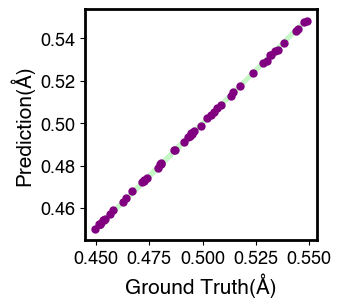

Index:  1
R^2:  1.0


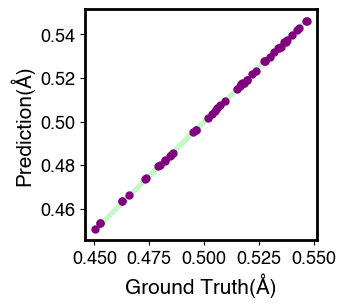

Index:  2
R^2:  1.0


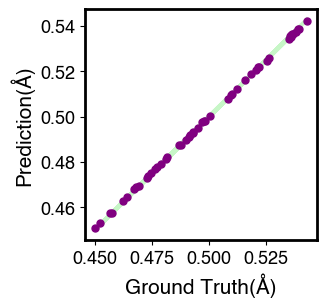

Index:  3
R^2:  1.0


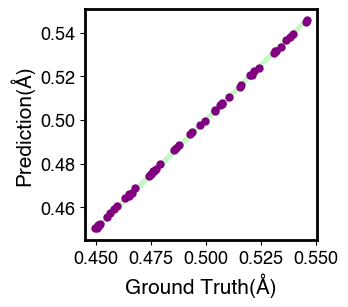

Index:  4
R^2:  1.0


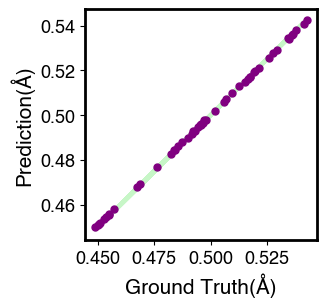

Index:  5
R^2:  1.0


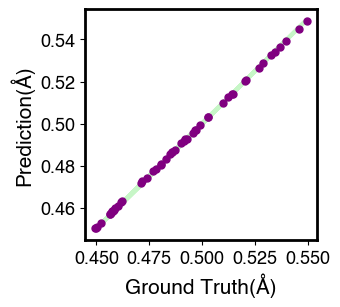

Index:  6
R^2:  1.0


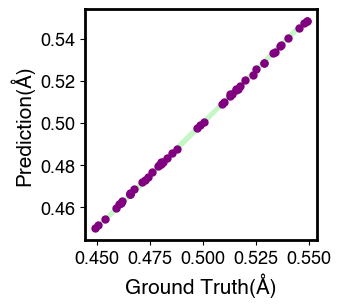

Index:  7
R^2:  1.0


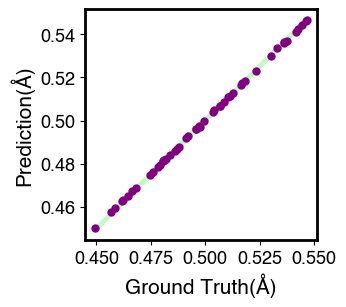

Index:  8
R^2:  1.0


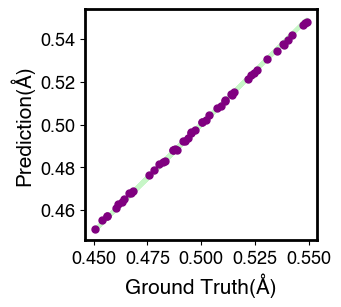

Index:  9
R^2:  1.0


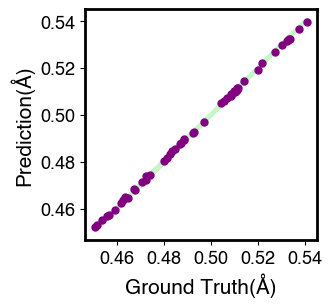

Index:  10
R^2:  1.0


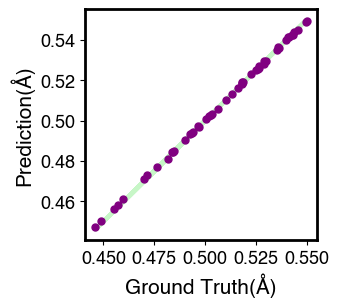

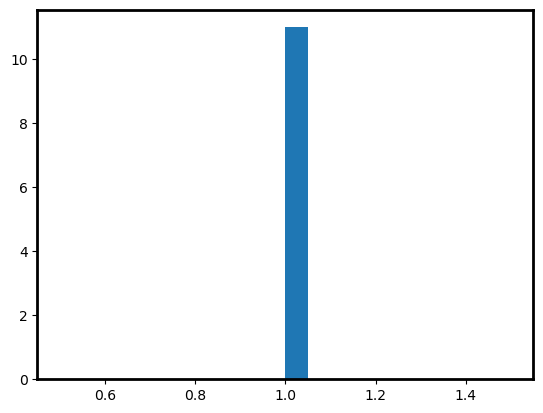

1.0


In [104]:
r2_arr_pr = []

for i in range(N_bulk+N_surface-1):

    print("Index: ", i)
    r2_val = rSquared(real_r_o1s[:, i], input_r_o1s[:, i])
    print("R^2: ", r2_val)
    r2_arr_pr.append(r2_val)
    #plt.plot(y_train[:, i], predictions_train[:, i] , color = 'blue', linewidth = 5, label = "Train", alpha = 0.2)
    #plt.plot(y_train[:, i], predictions_train[:, i]  ,'.', color = 'blue', linewidth = 0, label = "Train", alpha = 0.2)
    
    fig = plt.figure(figsize = (3, 3))
    plt.rcParams['axes.linewidth'] = 2
    plt.plot(real_r_o1s[:, i], real_r_o1s[:, i], color = "lightgreen", linewidth = 3, alpha = 0.5)

    plt.plot(real_r_o1s[:, i], input_r_o1s[:, i] , '.', markersize = 10, color = 'purple', label = "Test", alpha = 1)


    plt.xlabel('Ground Truth(Å)', fontname = 'Helvetica',fontsize = 15 )
    plt.ylabel('Prediction(Å)', fontname = 'Helvetica',fontsize = 15  )

    plt.xticks(fontsize = 13, fontname = 'Helvetica' )
    plt.yticks(fontsize = 13, fontname = 'Helvetica' )
    #plt.ylim(4, 13)
    #plt.legend(loc='upper left', markerscale=2, prop={'size': 25, "family":'Times new roman'})
    #plt.grid()
    plt.show()

plt.hist(r2_arr_pr, bins = 20)
plt.show()
print(np.mean(r2_arr_pr))

Index:  0
R^2:  0.96


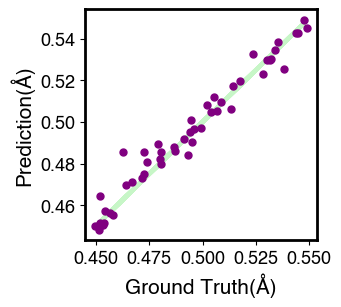

Index:  1
R^2:  0.93


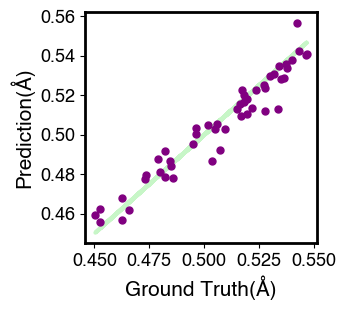

Index:  2
R^2:  0.9


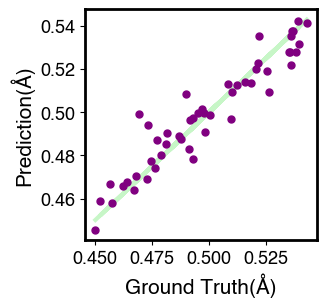

Index:  3
R^2:  0.94


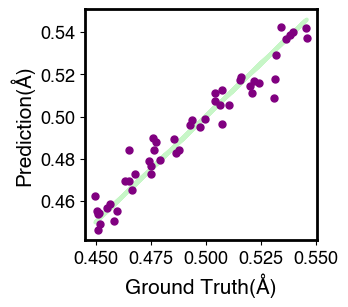

Index:  4
R^2:  0.89


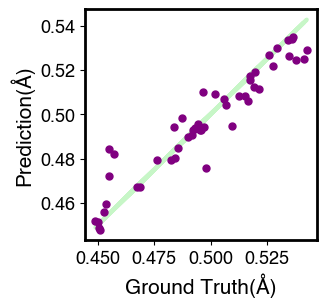

Index:  5
R^2:  0.89


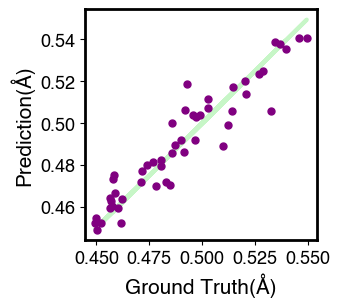

Index:  6
R^2:  0.9


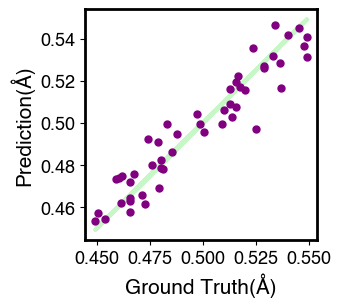

Index:  7
R^2:  0.85


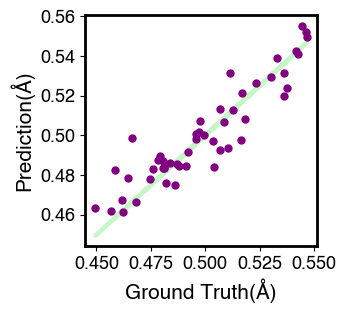

Index:  8
R^2:  0.91


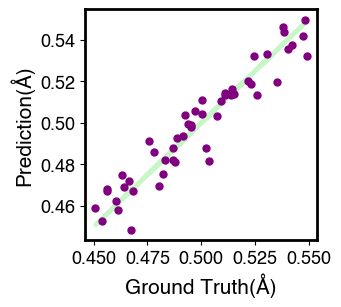

Index:  9
R^2:  0.75


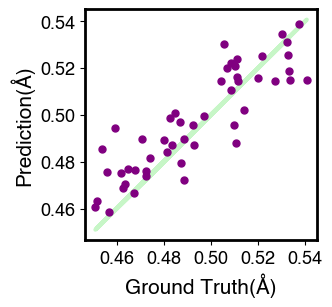

Index:  10
R^2:  0.85


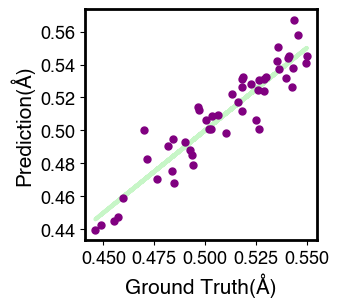

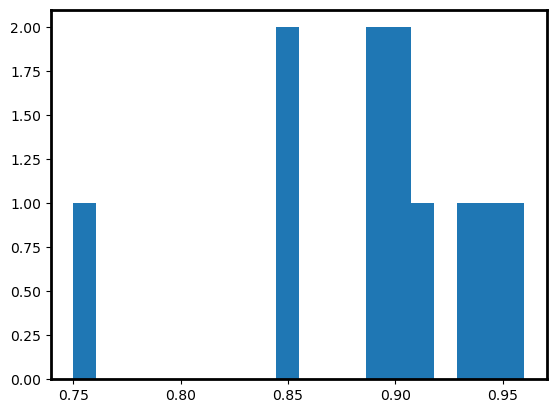

0.8881818181818182


In [105]:
r2_arr_pr_o1_Rpos = []

for i in range(N_bulk+N_surface-1):

    print("Index: ", i)
    r2_val = rSquared(real_r_o1s[:, i], pred_r_o1s[:, i])
    print("R^2: ", r2_val)
    r2_arr_pr_o1_Rpos.append(r2_val)
    #plt.plot(y_train[:, i], predictions_train[:, i] , color = 'blue', linewidth = 5, label = "Train", alpha = 0.2)
    #plt.plot(y_train[:, i], predictions_train[:, i]  ,'.', color = 'blue', linewidth = 0, label = "Train", alpha = 0.2)
    
    fig = plt.figure(figsize = (3, 3))
    plt.rcParams['axes.linewidth'] = 2
    plt.plot(real_r_o1s[:, i], real_r_o1s[:, i], color = "lightgreen", linewidth = 3, alpha = 0.5)

    plt.plot(real_r_o1s[:, i], pred_r_o1s[:, i] , '.', markersize = 10, color = 'purple', label = "Test", alpha = 1)


    plt.xlabel('Ground Truth(Å)', fontname = 'Helvetica',fontsize = 15 )
    plt.ylabel('Prediction(Å)', fontname = 'Helvetica',fontsize = 15  )

    plt.xticks(fontsize = 13, fontname = 'Helvetica' )
    plt.yticks(fontsize = 13, fontname = 'Helvetica' )
    #plt.ylim(4, 13)
    #plt.legend(loc='upper left', markerscale=2, prop={'size': 25, "family":'Times new roman'})
    #plt.grid()
    plt.show()

plt.hist(r2_arr_pr_o1_Rpos, bins = 20)
plt.show()
print(np.mean(r2_arr_pr_o1_Rpos))

### O2

Index:  0
R^2:  1.0


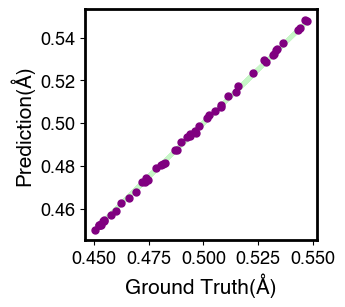

Index:  1
R^2:  1.0


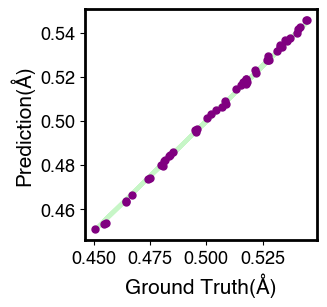

Index:  2
R^2:  1.0


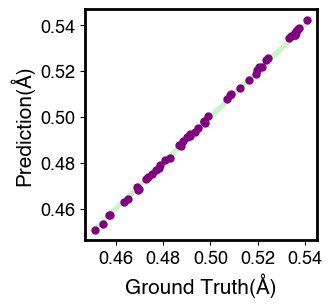

Index:  3
R^2:  1.0


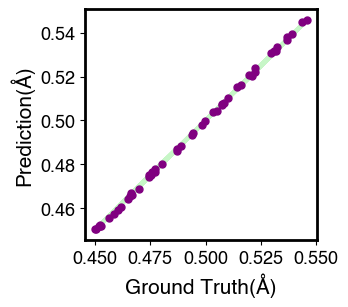

Index:  4
R^2:  1.0


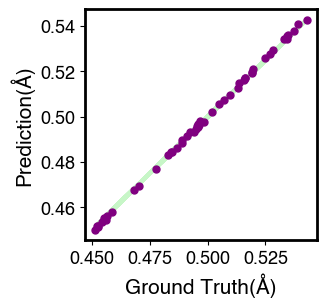

Index:  5
R^2:  1.0


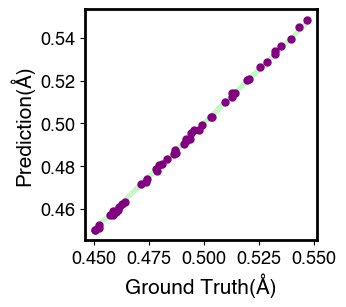

Index:  6
R^2:  1.0


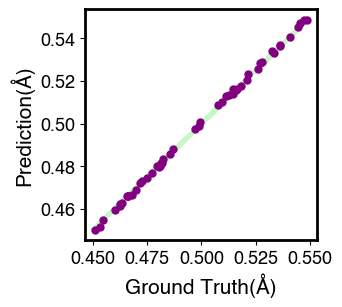

Index:  7
R^2:  1.0


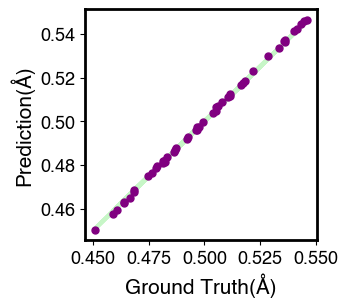

Index:  8
R^2:  1.0


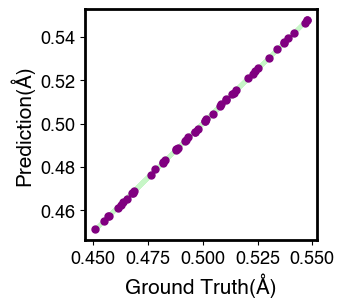

Index:  9
R^2:  1.0


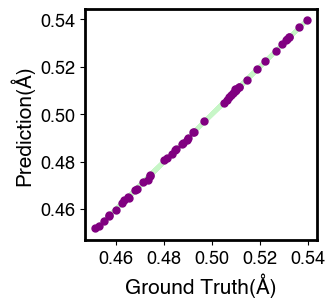

Index:  10
R^2:  1.0


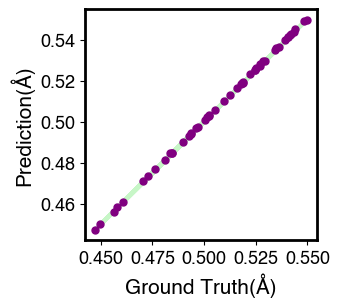

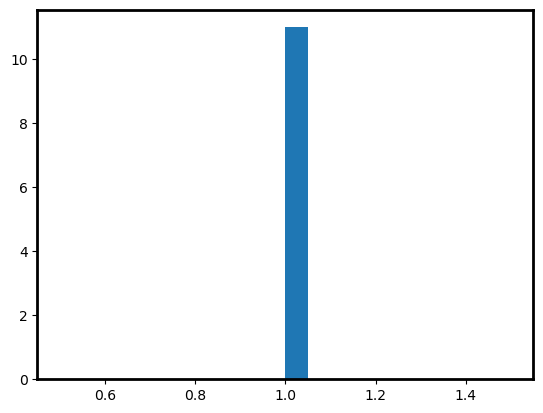

1.0


In [106]:
r2_arr_pr = []

for i in range(N_bulk+N_surface-1):

    print("Index: ", i)
    r2_val = rSquared(real_r_o2s[:, i], input_r_o2s[:, i])
    print("R^2: ", r2_val)
    r2_arr_pr.append(r2_val)
    #plt.plot(y_train[:, i], predictions_train[:, i] , color = 'blue', linewidth = 5, label = "Train", alpha = 0.2)
    #plt.plot(y_train[:, i], predictions_train[:, i]  ,'.', color = 'blue', linewidth = 0, label = "Train", alpha = 0.2)
    
    fig = plt.figure(figsize = (3, 3))
    plt.rcParams['axes.linewidth'] = 2
    plt.plot(real_r_o2s[:, i], real_r_o2s[:, i], color = "lightgreen", linewidth = 3, alpha = 0.5)

    plt.plot(real_r_o2s[:, i], input_r_o2s[:, i] , '.', markersize = 10, color = 'purple', label = "Test", alpha = 1)


    plt.xlabel('Ground Truth(Å)', fontname = 'Helvetica',fontsize = 15 )
    plt.ylabel('Prediction(Å)', fontname = 'Helvetica',fontsize = 15  )

    plt.xticks(fontsize = 13, fontname = 'Helvetica' )
    plt.yticks(fontsize = 13, fontname = 'Helvetica' )
    #plt.ylim(4, 13)
    #plt.legend(loc='upper left', markerscale=2, prop={'size': 25, "family":'Times new roman'})
    #plt.grid()
    plt.show()

plt.hist(r2_arr_pr, bins = 20)
plt.show()
print(np.mean(r2_arr_pr))

Index:  0
R^2:  0.96


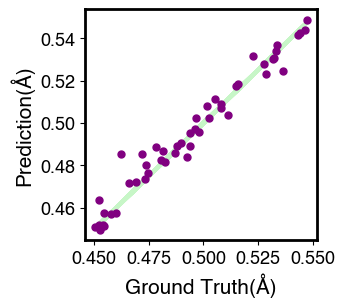

Index:  1
R^2:  0.93


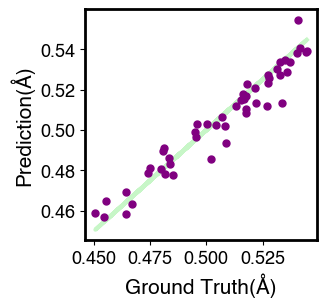

Index:  2
R^2:  0.9


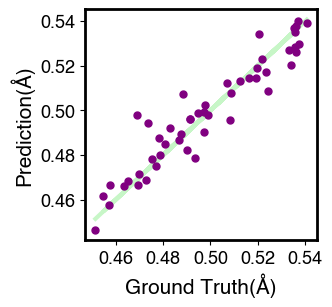

Index:  3
R^2:  0.94


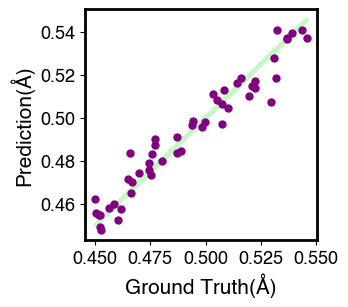

Index:  4
R^2:  0.89


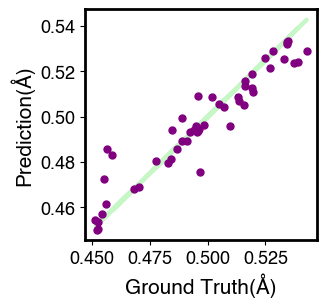

Index:  5
R^2:  0.89


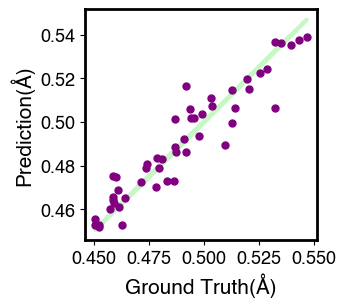

Index:  6
R^2:  0.9


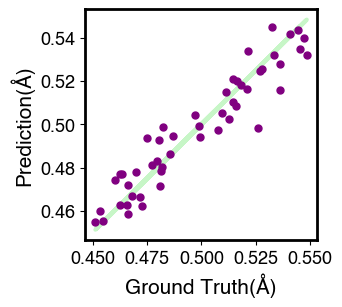

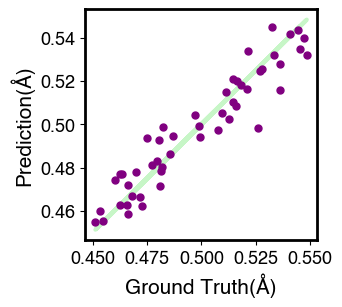

Index:  7
R^2:  0.85


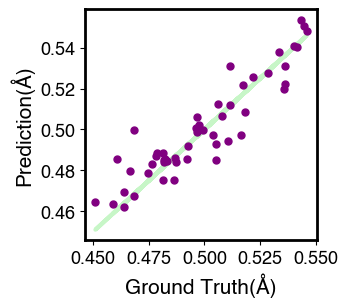

Index:  8
R^2:  0.91


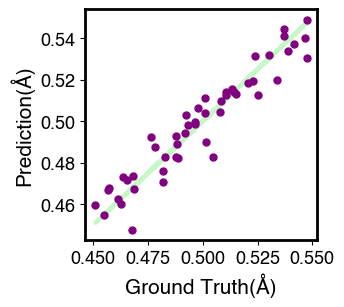

Index:  9
R^2:  0.75


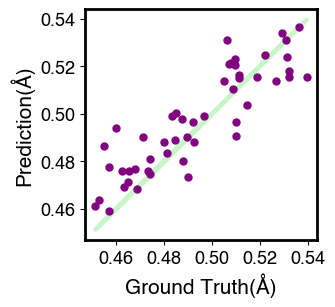

Index:  10
R^2:  0.85


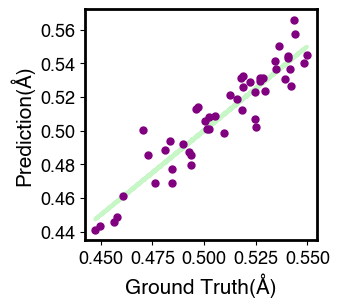

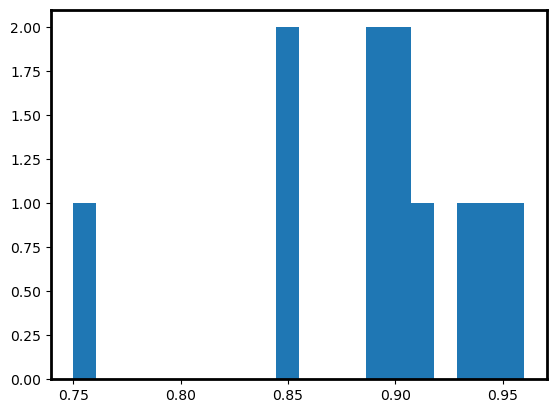

0.8881818181818182


In [107]:
r2_arr_pr_o2_Rpos = []

for i in range(N_bulk+N_surface-1):

    print("Index: ", i)
    r2_val = rSquared(real_r_o2s[:, i], pred_r_o2s[:, i])
    print("R^2: ", r2_val)
    r2_arr_pr_o2_Rpos.append(r2_val)
    #plt.plot(y_train[:, i], predictions_train[:, i] , color = 'blue', linewidth = 5, label = "Train", alpha = 0.2)
    #plt.plot(y_train[:, i], predictions_train[:, i]  ,'.', color = 'blue', linewidth = 0, label = "Train", alpha = 0.2)
    
    fig = plt.figure(figsize = (3, 3))
    plt.rcParams['axes.linewidth'] = 2
    plt.plot(real_r_o2s[:, i], real_r_o2s[:, i], color = "lightgreen", linewidth = 3, alpha = 0.5)

    plt.plot(real_r_o2s[:, i], pred_r_o2s[:, i] , '.', markersize = 10, color = 'purple', label = "Test", alpha = 1)


    plt.xlabel('Ground Truth(Å)', fontname = 'Helvetica',fontsize = 15 )
    plt.ylabel('Prediction(Å)', fontname = 'Helvetica',fontsize = 15  )

    plt.xticks(fontsize = 13, fontname = 'Helvetica' )
    plt.yticks(fontsize = 13, fontname = 'Helvetica' )
    #plt.ylim(4, 13)
    #plt.legend(loc='upper left', markerscale=2, prop={'size': 25, "family":'Times new roman'})
    #plt.grid()
    plt.show()

plt.hist(r2_arr_pr_o2_Rpos, bins = 20)
plt.show()
print(np.mean(r2_arr_pr_o2_Rpos))

### O3

Index:  0
R^2:  0.99


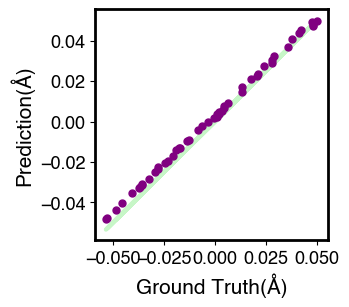

Index:  1
R^2:  0.98


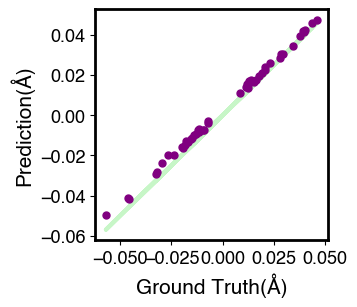

Index:  2
R^2:  0.98


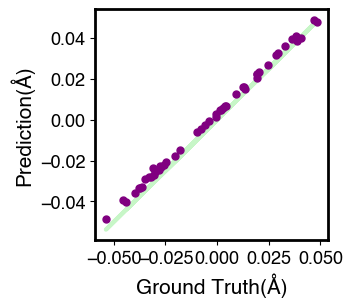

Index:  3
R^2:  0.98


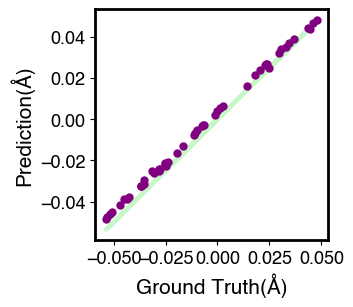

Index:  4
R^2:  0.98


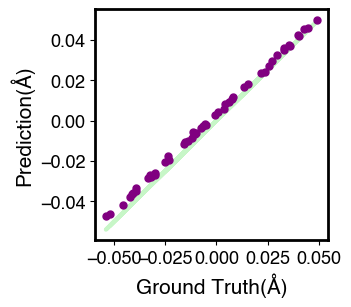

Index:  5
R^2:  0.99


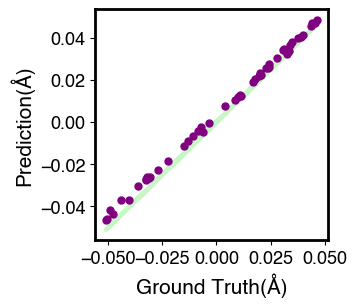

Index:  6
R^2:  0.98


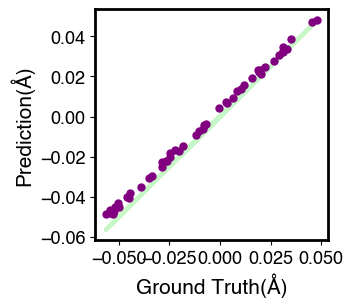

Index:  7
R^2:  0.98


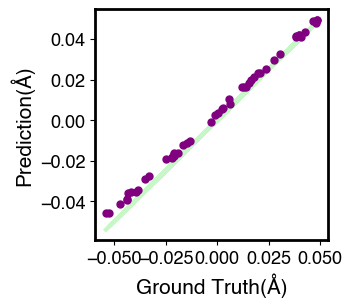

Index:  8
R^2:  0.97


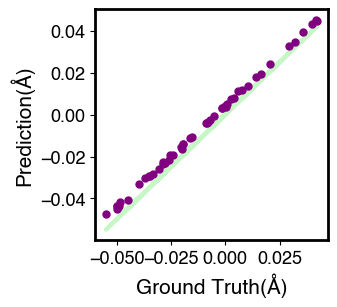

Index:  9
R^2:  0.99


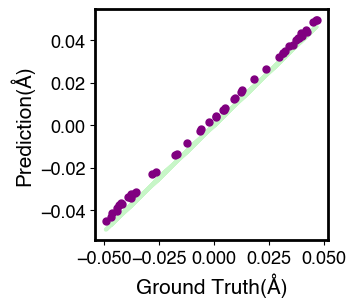

Index:  10
R^2:  0.98


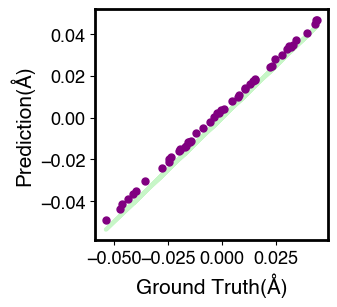

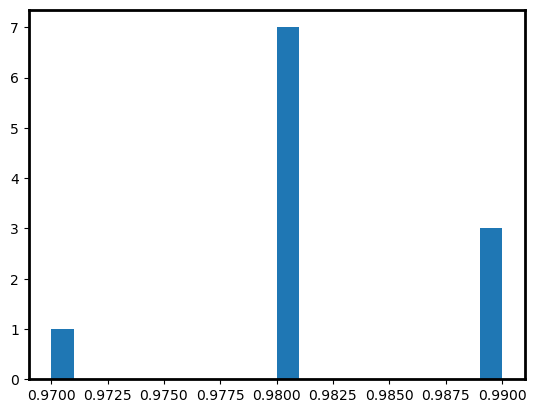

0.9818181818181819


In [108]:
r2_arr_pr = []

for i in range(N_bulk+N_surface-1):

    print("Index: ", i)
    r2_val = rSquared(real_r_o3s[:, i], input_r_o3s[:, i])
    print("R^2: ", r2_val)
    r2_arr_pr.append(r2_val)
    #plt.plot(y_train[:, i], predictions_train[:, i] , color = 'blue', linewidth = 5, label = "Train", alpha = 0.2)
    #plt.plot(y_train[:, i], predictions_train[:, i]  ,'.', color = 'blue', linewidth = 0, label = "Train", alpha = 0.2)
    
    fig = plt.figure(figsize = (3, 3))
    plt.rcParams['axes.linewidth'] = 2
    plt.plot(real_r_o3s[:, i], real_r_o3s[:, i], color = "lightgreen", linewidth = 3, alpha = 0.5)

    plt.plot(real_r_o3s[:, i], input_r_o3s[:, i] , '.', markersize = 10, color = 'purple', label = "Test", alpha = 1)


    plt.xlabel('Ground Truth(Å)', fontname = 'Helvetica',fontsize = 15 )
    plt.ylabel('Prediction(Å)', fontname = 'Helvetica',fontsize = 15  )

    plt.xticks(fontsize = 13, fontname = 'Helvetica' )
    plt.yticks(fontsize = 13, fontname = 'Helvetica' )
    #plt.ylim(4, 13)
    #plt.legend(loc='upper left', markerscale=2, prop={'size': 25, "family":'Times new roman'})
    #plt.grid()
    plt.show()

plt.hist(r2_arr_pr, bins = 20)
plt.show()
print(np.mean(r2_arr_pr))

Index:  0
R^2:  0.96


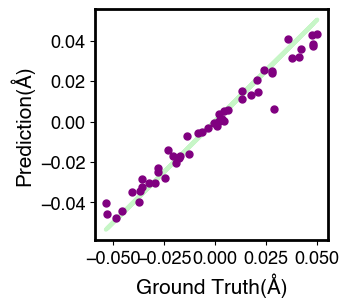

Index:  1
R^2:  0.93


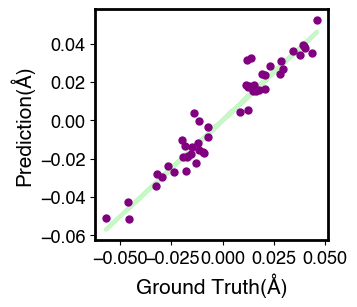

Index:  2
R^2:  0.92


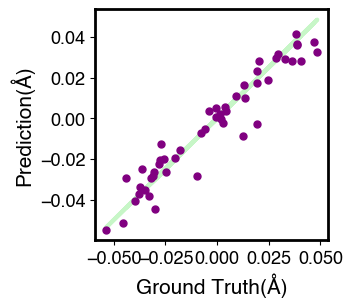

Index:  3
R^2:  0.92


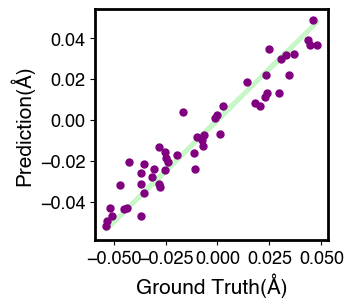

Index:  4
R^2:  0.91


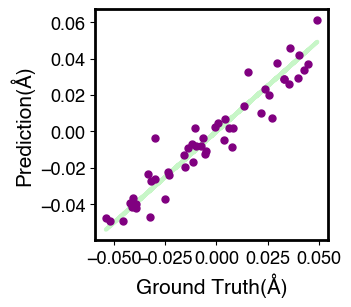

Index:  5
R^2:  0.9


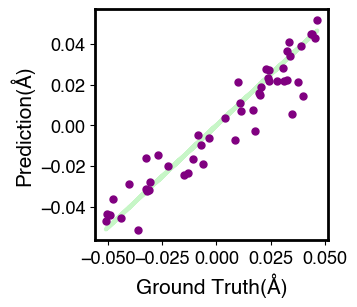

Index:  6
R^2:  0.83


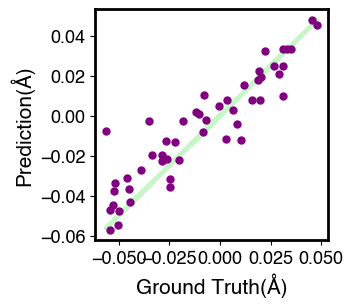

Index:  7
R^2:  0.78


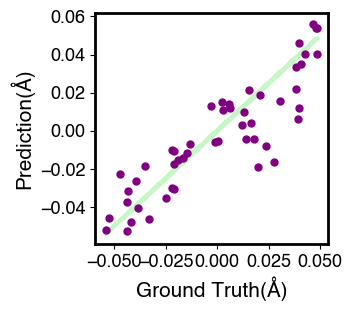

Index:  8
R^2:  0.7


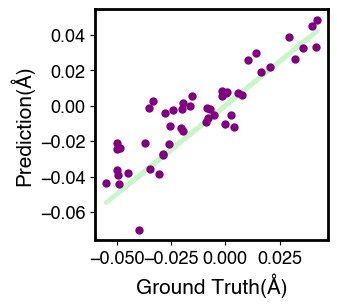

Index:  9
R^2:  0.81


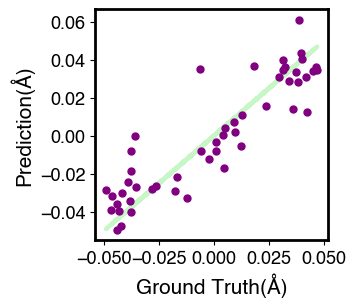

Index:  10
R^2:  0.68


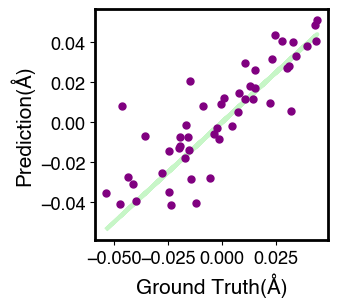

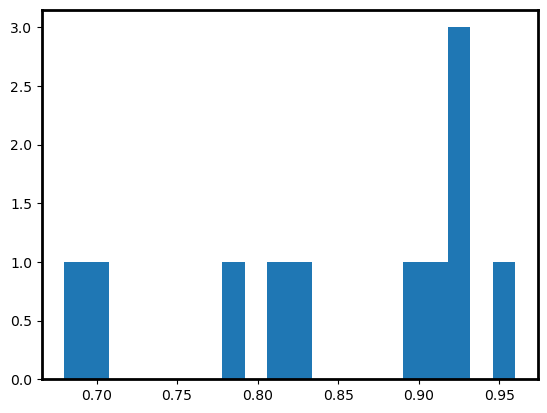

0.8490909090909091


In [109]:
r2_arr_pr_o3_Rpos = []

for i in range(N_bulk+N_surface-1):

    print("Index: ", i)
    r2_val = rSquared(real_r_o3s[:, i], pred_r_o3s[:, i])
    print("R^2: ", r2_val)
    r2_arr_pr_o3_Rpos.append(r2_val)
    #plt.plot(y_train[:, i], predictions_train[:, i] , color = 'blue', linewidth = 5, label = "Train", alpha = 0.2)
    #plt.plot(y_train[:, i], predictions_train[:, i]  ,'.', color = 'blue', linewidth = 0, label = "Train", alpha = 0.2)
    
    fig = plt.figure(figsize = (3, 3))
    plt.rcParams['axes.linewidth'] = 2
    plt.plot(real_r_o3s[:, i], real_r_o3s[:, i], color = "lightgreen", linewidth = 3, alpha = 0.5)

    plt.plot(real_r_o3s[:, i], pred_r_o3s[:, i] , '.', markersize = 10, color = 'purple', label = "Test", alpha = 1)


    plt.xlabel('Ground Truth(Å)', fontname = 'Helvetica',fontsize = 15 )
    plt.ylabel('Prediction(Å)', fontname = 'Helvetica',fontsize = 15  )

    plt.xticks(fontsize = 13, fontname = 'Helvetica' )
    plt.yticks(fontsize = 13, fontname = 'Helvetica' )
    #plt.ylim(4, 13)
    #plt.legend(loc='upper left', markerscale=2, prop={'size': 25, "family":'Times new roman'})
    #plt.grid()
    plt.show()

plt.hist(r2_arr_pr_o3_Rpos, bins = 20)
plt.show()
print(np.mean(r2_arr_pr_o3_Rpos))

### Ti

Index:  0
R^2:  1.0


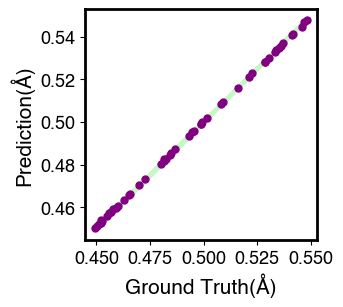

Index:  1
R^2:  1.0


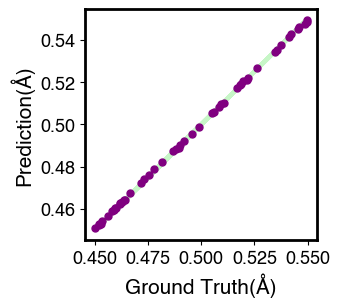

Index:  2
R^2:  1.0


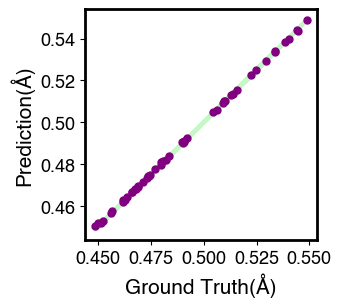

Index:  3
R^2:  1.0


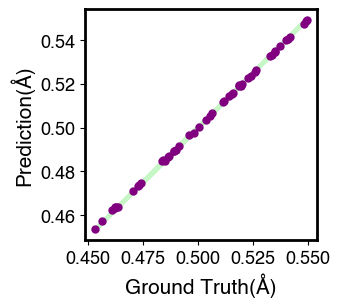

Index:  4
R^2:  1.0


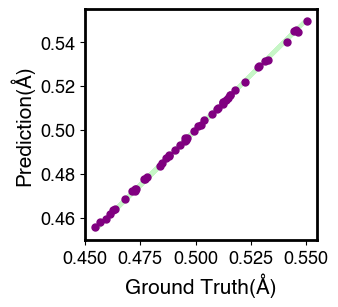

Index:  5
R^2:  1.0


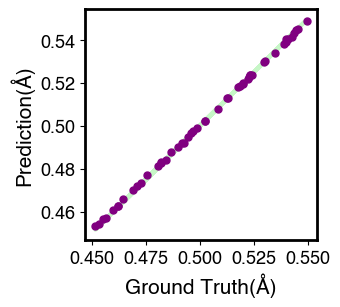

Index:  6
R^2:  1.0


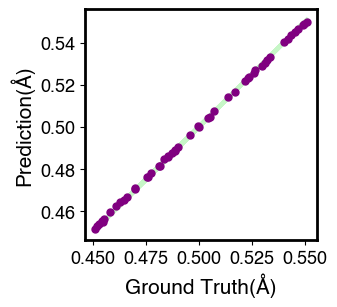

Index:  7
R^2:  1.0


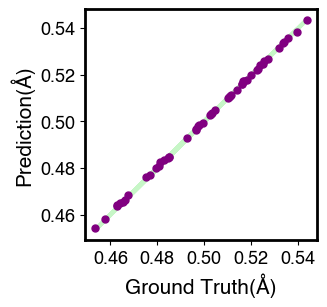

Index:  8
R^2:  1.0


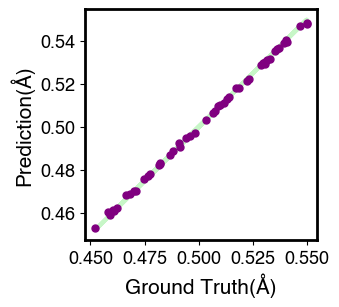

Index:  9
R^2:  1.0


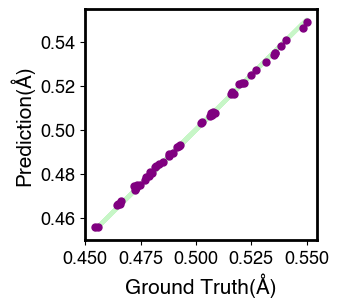

Index:  10
R^2:  1.0


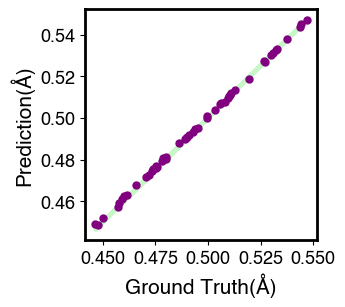

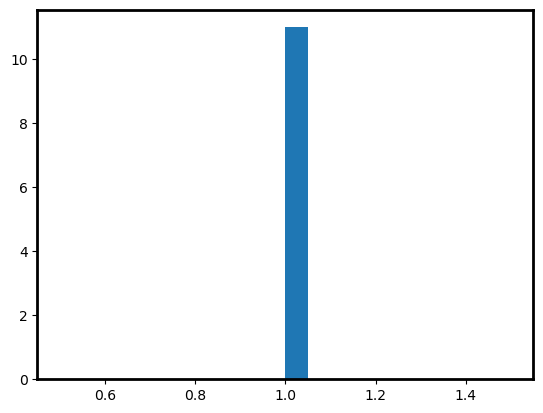

1.0


In [110]:
r2_arr_pr = []

for i in range(N_bulk+N_surface-1):

    print("Index: ", i)
    r2_val = rSquared(real_r_Tis[:, i], input_r_Tis[:, i])
    print("R^2: ", r2_val)
    r2_arr_pr.append(r2_val)
    #plt.plot(y_train[:, i], predictions_train[:, i] , color = 'blue', linewidth = 5, label = "Train", alpha = 0.2)
    #plt.plot(y_train[:, i], predictions_train[:, i]  ,'.', color = 'blue', linewidth = 0, label = "Train", alpha = 0.2)
    
    fig = plt.figure(figsize = (3, 3))
    plt.rcParams['axes.linewidth'] = 2
    plt.plot(real_r_Tis[:, i], real_r_Tis[:, i], color = "lightgreen", linewidth = 3, alpha = 0.5)

    plt.plot(real_r_Tis[:, i], input_r_Tis[:, i] , '.', markersize = 10, color = 'purple', label = "Test", alpha = 1)


    plt.xlabel('Ground Truth(Å)', fontname = 'Helvetica',fontsize = 15 )
    plt.ylabel('Prediction(Å)', fontname = 'Helvetica',fontsize = 15  )

    plt.xticks(fontsize = 13, fontname = 'Helvetica' )
    plt.yticks(fontsize = 13, fontname = 'Helvetica' )
    #plt.ylim(4, 13)
    #plt.legend(loc='upper left', markerscale=2, prop={'size': 25, "family":'Times new roman'})
    #plt.grid()
    plt.show()

plt.hist(r2_arr_pr, bins = 20)
plt.show()
print(np.mean(r2_arr_pr))

Index:  0
R^2:  0.98


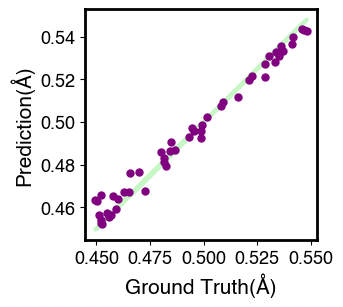

Index:  1
R^2:  0.96


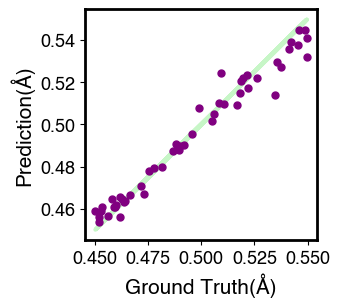

Index:  2
R^2:  0.93


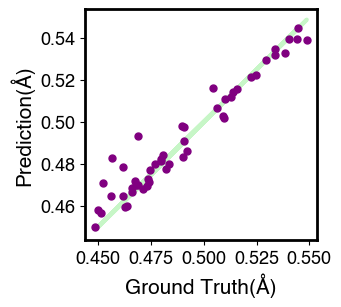

Index:  3
R^2:  0.95


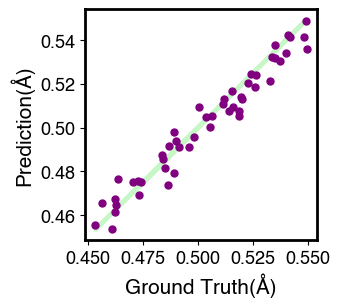

Index:  4
R^2:  0.94


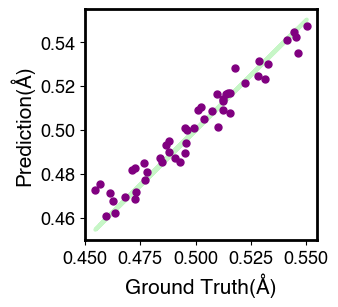

Index:  5
R^2:  0.94


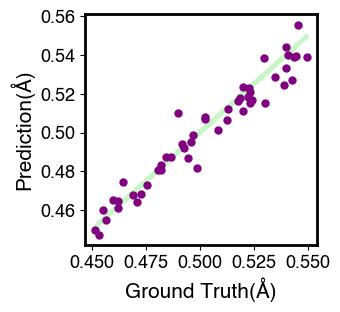

Index:  6
R^2:  0.95


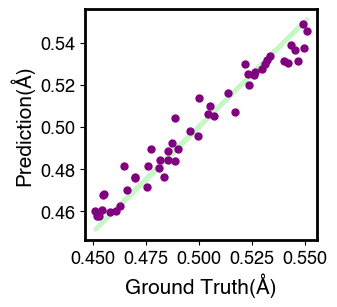

Index:  7
R^2:  0.92


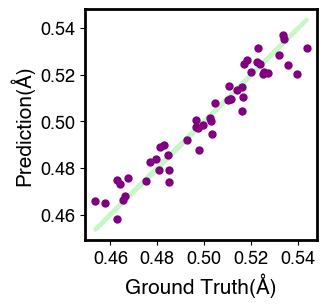

Index:  8
R^2:  0.86


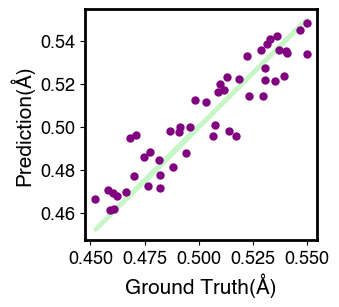

Index:  9
R^2:  0.79


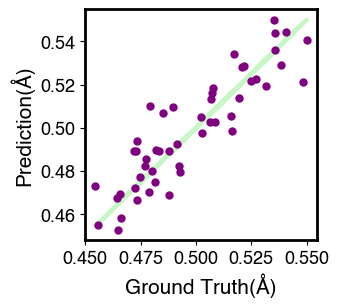

Index:  10
R^2:  0.86


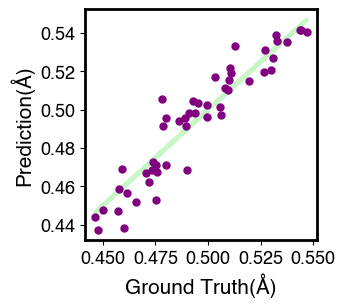

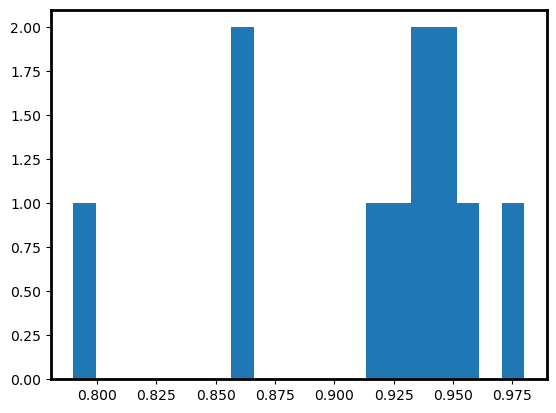

0.9163636363636362


In [111]:
r2_arr_pr_Ti_Rpos = []

for i in range(N_bulk+N_surface-1):

    print("Index: ", i)
    r2_val = rSquared(real_r_Tis[:, i], pred_r_Tis[:, i])
    print("R^2: ", r2_val)
    r2_arr_pr_Ti_Rpos.append(r2_val)
    #plt.plot(y_train[:, i], predictions_train[:, i] , color = 'blue', linewidth = 5, label = "Train", alpha = 0.2)
    #plt.plot(y_train[:, i], predictions_train[:, i]  ,'.', color = 'blue', linewidth = 0, label = "Train", alpha = 0.2)
    
    fig = plt.figure(figsize = (3, 3))
    plt.rcParams['axes.linewidth'] = 2
    plt.plot(real_r_Tis[:, i], real_r_Tis[:, i], color = "lightgreen", linewidth = 3, alpha = 0.5)

    plt.plot(real_r_Tis[:, i], pred_r_Tis[:, i] , '.', markersize = 10, color = 'purple', label = "Test", alpha = 1)


    plt.xlabel('Ground Truth(Å)', fontname = 'Helvetica',fontsize = 15 )
    plt.ylabel('Prediction(Å)', fontname = 'Helvetica',fontsize = 15  )

    plt.xticks(fontsize = 13, fontname = 'Helvetica' )
    plt.yticks(fontsize = 13, fontname = 'Helvetica' )
    #plt.ylim(4, 13)
    #plt.legend(loc='upper left', markerscale=2, prop={'size': 25, "family":'Times new roman'})
    #plt.grid()
    plt.show()

plt.hist(r2_arr_pr_Ti_Rpos, bins = 20)
plt.show()
print(np.mean(r2_arr_pr_Ti_Rpos))


# Cleaner Analysis and Plots

## Relative Spacing R^2s

In [112]:
print("cn: ", r2_arr_pr_cn, "Average: ", np.mean(r2_arr_pr_cn))
print("Ti: ", r2_arr_pr_Ti, "Average: ", np.mean(r2_arr_pr_Ti))
print("O1: ", r2_arr_pr_o1, "Average: ", np.mean(r2_arr_pr_o1))
print("O2: ", r2_arr_pr_o2, "Average: ", np.mean(r2_arr_pr_o2))
print("O3: ", r2_arr_pr_o3, "Average: ", np.mean(r2_arr_pr_o3))
print("P Values: ", r2_arr_charge_mix, "Average: ", np.mean(r2_arr_charge_mix))
print("Rouhgness: ", r2_arr_roughness, "Average: ", np.mean(r2_arr_roughness))

cn:  [0.98, 0.97, 0.96, 0.95, 0.91, 0.94, 0.94, 0.93, 0.93, 0.88] Average:  0.9390000000000001
Ti:  [0.98, 0.94, 0.9, 0.89, 0.89, 0.83, 0.91, 0.9, 0.82, 0.78, 0.76] Average:  0.8727272727272727
O1:  [0.96, 0.87, 0.84, 0.81, 0.81, 0.79, 0.77, 0.79, 0.7, 0.78, 0.79] Average:  0.81
O2:  [0.96, 0.86, 0.83, 0.81, 0.81, 0.8, 0.76, 0.79, 0.7, 0.79, 0.8] Average:  0.81
O3:  [0.95, 0.92, 0.88, 0.88, 0.85, 0.81, 0.75, 0.66, 0.45, 0.68, 0.61] Average:  0.7672727272727272
P Values:  [0.99, 0.99, 0.99, 0.99] Average:  0.99
Rouhgness:  [0.99] Average:  0.99


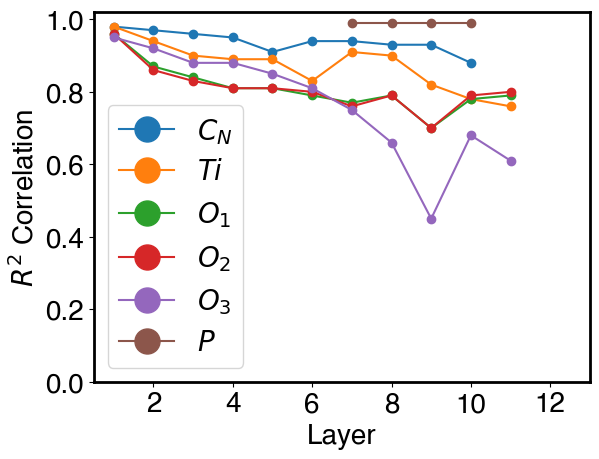

array([ 1,  2,  3, ...,  9, 10, 11])

In [113]:
layer = np.arange(1, 12)
layer_cn = np.arange(1, 11)
plt.plot(layer_cn, r2_arr_pr_cn, 'o-', label = "$C_N$")
plt.plot(layer, r2_arr_pr_Ti, 'o-', label = "$Ti$")
plt.plot(layer, r2_arr_pr_o1, 'o-', label = "$O_1$")
plt.plot(layer, r2_arr_pr_o2, 'o-', label = "$O_2$")
plt.plot(layer, r2_arr_pr_o3, 'o-', label = "$O_3$")
plt.plot([7, 8, 9, 10], r2_arr_charge_mix, 'o-', label = "$P$")

plt.xlabel('Layer', fontname = 'Helvetica',fontsize = 20 )
plt.ylabel('$R^2$ Correlation', fontname = 'Helvetica',fontsize = 20  )

plt.xticks(fontsize = 20, fontname = 'Helvetica' ) 
plt.yticks(fontsize = 20, fontname = 'Helvetica' )
plt.legend(markerscale = 3, prop={'size': 20, "family":'Times new roman'})

plt.ylim(0, 1.02)
plt.xlim(0.5, 13)
plt.show()
layer

## Positional Spacing R^2s

In [114]:
print("cn: ", r2_arr_pr_cn, "Average: ", np.mean(r2_arr_pr_cn))
print("Ti: ", r2_arr_pr_Ti_Rpos, "Average: ", np.mean(r2_arr_pr_Ti_Rpos))
print("O1: ", r2_arr_pr_o1_Rpos, "Average: ", np.mean(r2_arr_pr_o1_Rpos))
print("O2: ", r2_arr_pr_o2_Rpos, "Average: ", np.mean(r2_arr_pr_o2_Rpos))
print("O3: ", r2_arr_pr_o3_Rpos, "Average: ", np.mean(r2_arr_pr_o3_Rpos))
print("P Values: ", r2_arr_charge_mix, "Average: ", np.mean(r2_arr_charge_mix))
print("Rouhgness: ", r2_arr_roughness, "Average: ", np.mean(r2_arr_roughness))

cn:  [0.98, 0.97, 0.96, 0.95, 0.91, 0.94, 0.94, 0.93, 0.93, 0.88] Average:  0.9390000000000001
Ti:  [0.98, 0.96, 0.93, 0.95, 0.94, 0.94, 0.95, 0.92, 0.86, 0.79, 0.86] Average:  0.9163636363636362
O1:  [0.96, 0.93, 0.9, 0.94, 0.89, 0.89, 0.9, 0.85, 0.91, 0.75, 0.85] Average:  0.8881818181818182
O2:  [0.96, 0.93, 0.9, 0.94, 0.89, 0.89, 0.9, 0.85, 0.91, 0.75, 0.85] Average:  0.8881818181818182
O3:  [0.96, 0.93, 0.92, 0.92, 0.91, 0.9, 0.83, 0.78, 0.7, 0.81, 0.68] Average:  0.8490909090909091
P Values:  [0.99, 0.99, 0.99, 0.99] Average:  0.99
Rouhgness:  [0.99] Average:  0.99


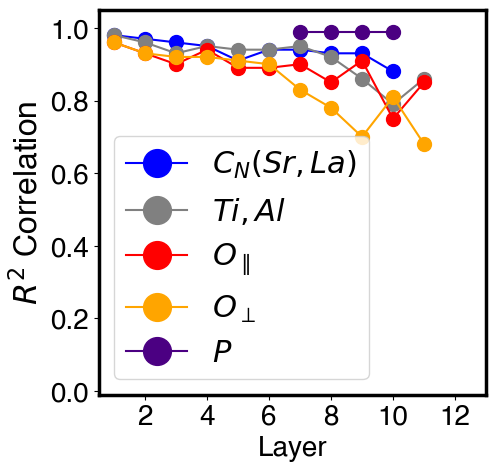

array([ 1,  2,  3, ...,  9, 10, 11])

In [125]:
fig = plt.figure(figsize = (5, 5))
layer = np.arange(1, 12)
layer_cn = np.arange(1, 11)
plt.rcParams['axes.linewidth'] = 2.5
marksize = 10
plt.plot(layer_cn, r2_arr_pr_cn, 'o-', label = "$C_N(Sr, La)$", markersize = marksize, color = 'blue')
plt.plot(layer, r2_arr_pr_Ti_Rpos, 'o-', label = "$Ti, Al$", markersize = marksize, color = 'gray')
plt.plot(layer, r2_arr_pr_o1_Rpos, 'o-', label = "$O_{\parallel}$", markersize = marksize, color = 'red')
#plt.plot(layer, r2_arr_pr_o2_Rpos, 'o-', label = "$O_2$", markersize = marksize)
plt.plot(layer, r2_arr_pr_o3_Rpos, 'o-', label = "$O_{\perp}$", markersize = marksize, color = 'orange')
plt.plot([7, 8, 9, 10], r2_arr_charge_mix, 'o-', label = "$P$", markersize = marksize, color = 'indigo')

plt.xlabel('Layer', fontname = 'Helvetica',fontsize = 20 )
plt.ylabel('$R^2$ Correlation', fontname = 'Helvetica',fontsize = 23  )

plt.xticks(fontsize = 20, fontname = 'Helvetica' )
plt.yticks(fontsize = 20, fontname = 'Helvetica' )
plt.legend(markerscale = 2, prop={'size': 22, "family":'Times new roman'})

plt.ylim(-0.01, 1.05)
plt.xlim(0.5, 13)
plt.show()
layer

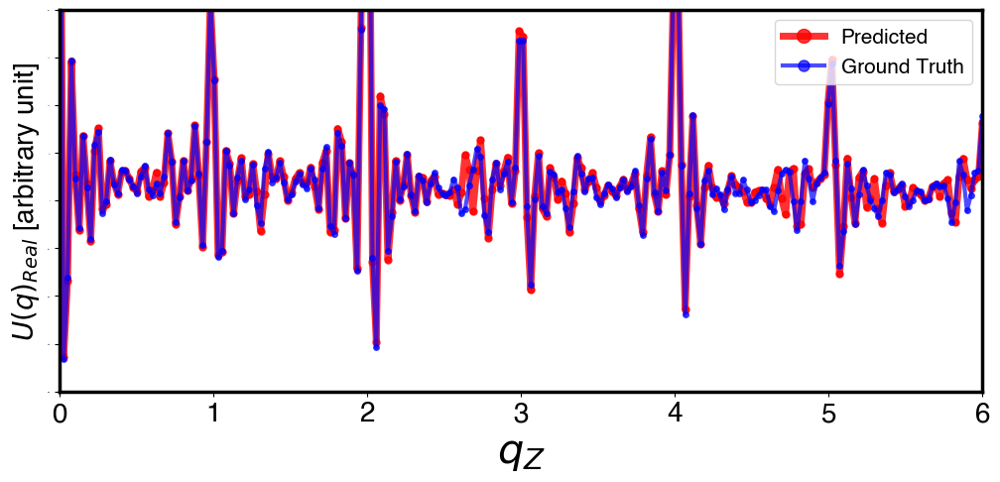

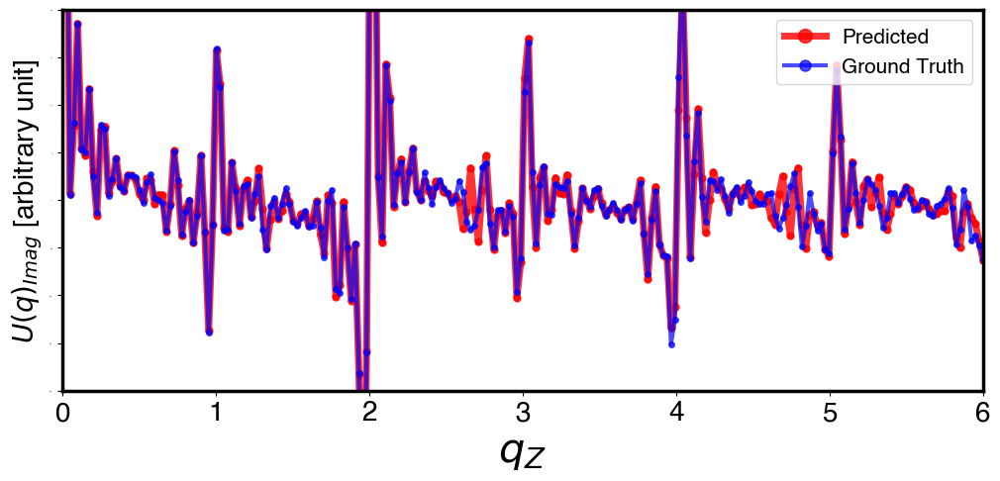

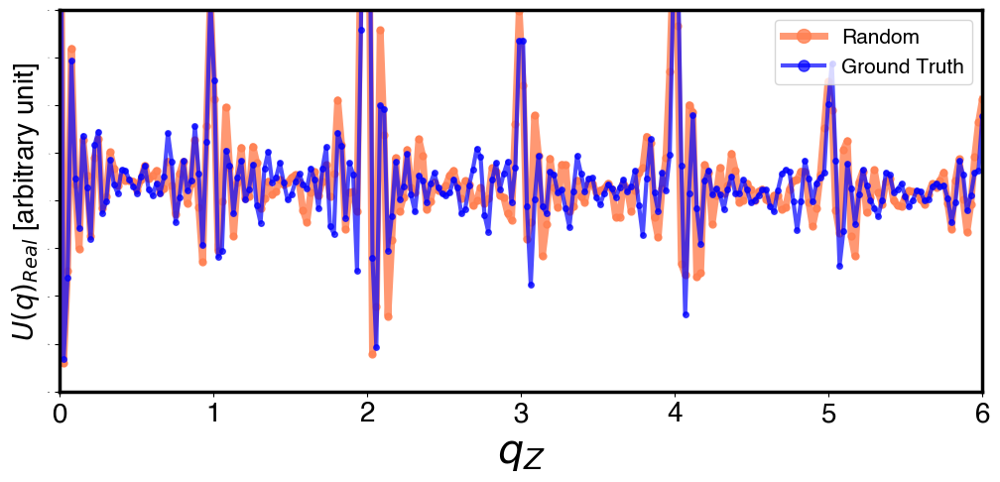

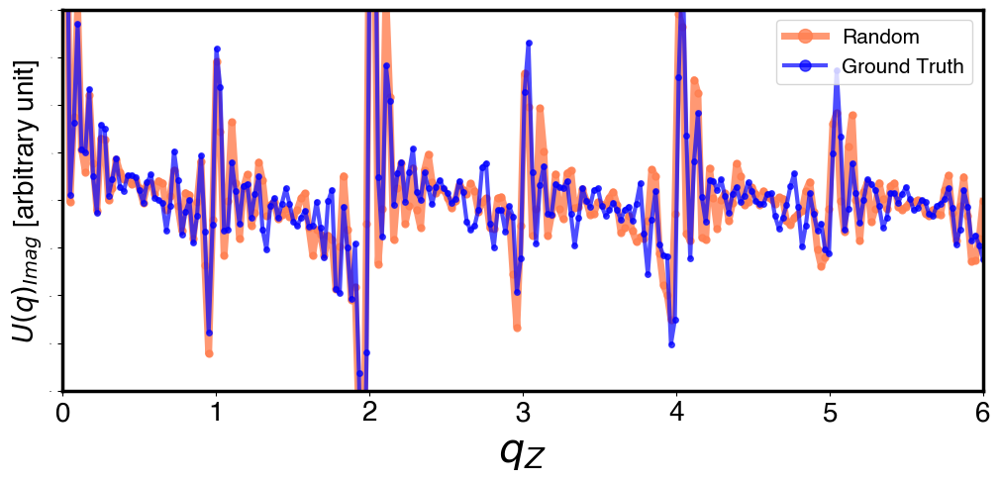

In [116]:
%matplotlib inline
i_rand = np.random.randint(0, 100)
index = 21

fontSize = 20
fontSizeY = 0

legendSize = 15
ymin = -200
ymax = 200
markSize = 5
linwW = 3
qz_array = np.linspace(0, 6, 240)

#00 rod
rodmin = 0
rodmax = 240

plt.figure(figsize=(12, 5))

plt.plot(qz_array, predictions_real[index][rodmin:rodmax], color = 'red', label = "Predicted", linewidth = linwW+2, alpha = 0.8, marker = 'o', markersize = markSize)
plt.plot(qz_array, y_test_real[index][rodmin:rodmax], color = 'blue', label = "Ground Truth", marker = 'o', markersize = 4, linewidth = 3, alpha = 0.7)
plt.xlabel('$q_{Z}$', fontname = 'Helvetica',fontsize = 30 )
plt.ylabel('$U(q)_{Real}$ [arbitrary unit]', fontname = 'Helvetica',fontsize = 20  )
plt.xticks(fontsize = fontSize, fontname = 'Helvetica' )
plt.yticks(fontsize = fontSizeY, fontname = 'Helvetica' )
plt.ylim(ymin, ymax)
plt.xlim(0, 6)
plt.legend(loc='upper right', markerscale=2, prop={'size': legendSize, "family":'Helvetica'})
#plt.grid()
plt.show()


                
plt.figure(figsize=(12, 5))
plt.plot(qz_array,predictions_imag[index][rodmin:rodmax], color = 'red', label = "Predicted", linewidth = linwW+2, alpha = 0.8, marker = 'o', markersize = markSize)
plt.plot(qz_array,y_test_imag[index][rodmin:rodmax], color = 'blue', label = "Ground Truth", marker = 'o', markersize = 4, linewidth = 3, alpha = 0.7)
plt.xlabel('$q_{Z}$', fontname = 'Helvetica',fontsize = 30 )
plt.ylabel('$U(q)_{Imag}$ [arbitrary unit]', fontname = 'Helvetica',fontsize = 20  )
plt.xticks(fontsize = fontSize, fontname = 'Helvetica' )
plt.yticks(fontsize = fontSizeY, fontname = 'Helvetica' )
plt.ylim(ymin, ymax)
plt.xlim(0, 6)
plt.legend(loc='upper right', markerscale=2, prop={'size': legendSize, "family":'Helvetica'})
#plt.grid()
plt.show()

plt.figure(figsize=(12, 5))
plt.plot(qz_array,predictions_real[index+2][rodmin:rodmax], color = 'coral', label = "Random", linewidth = linwW+2, alpha = 0.8, marker = 'o', markersize = markSize)
plt.plot(qz_array,y_test_real[index][rodmin:rodmax], color = 'blue', label = "Ground Truth", marker = 'o', markersize = 4, linewidth = 3, alpha = 0.7)
plt.xlabel('$q_{Z}$', fontname = 'Helvetica',fontsize = 30 )
plt.ylabel('$U(q)_{Real}$ [arbitrary unit]', fontname = 'Helvetica',fontsize = 20  )
plt.xticks(fontsize = fontSize, fontname = 'Helvetica' )
plt.yticks(fontsize = fontSizeY, fontname = 'Helvetica' )
plt.ylim(ymin, ymax)
plt.xlim(0, 6)
plt.legend(loc='upper right', markerscale=2, prop={'size': legendSize, "family":'Helvetica'})
#plt.grid()
plt.show()


plt.figure(figsize=(12, 5))
plt.plot(qz_array,predictions_imag[index+2][rodmin:rodmax], color = 'coral', label = "Random", linewidth = linwW+2, alpha = 0.8, marker = 'o', markersize = markSize)
plt.plot(qz_array,y_test_imag[index][rodmin:rodmax], color = 'blue', label = "Ground Truth", marker = 'o', markersize = 4, linewidth = 3, alpha = 0.7)
plt.xlabel('$q_{Z}$', fontname = 'Helvetica',fontsize = 30 )
plt.ylabel('$U(q)_{Imag}$ [arbitrary unit]', fontname = 'Helvetica',fontsize = 20  )
plt.xticks(fontsize = fontSize, fontname = 'Helvetica' )
plt.yticks(fontsize = fontSizeY, fontname = 'Helvetica' )
plt.ylim(ymin, ymax)
plt.xlim(0, 6)
plt.legend(loc='upper right', markerscale=2, prop={'size': legendSize, "family":'Helvetica'})
#plt.grid()
plt.show()



Predicted:


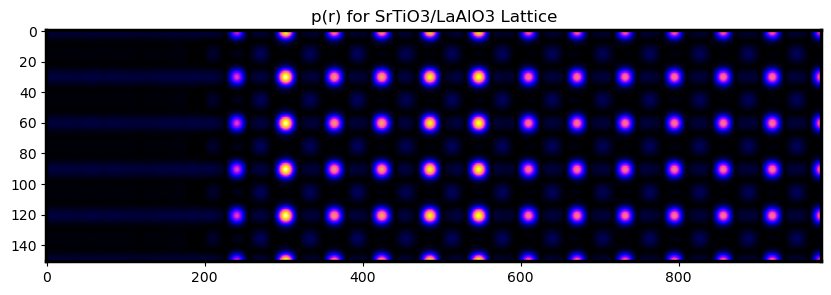

Real:


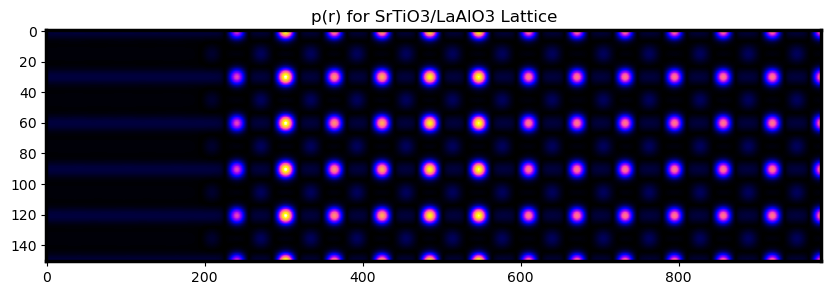

Predicted:


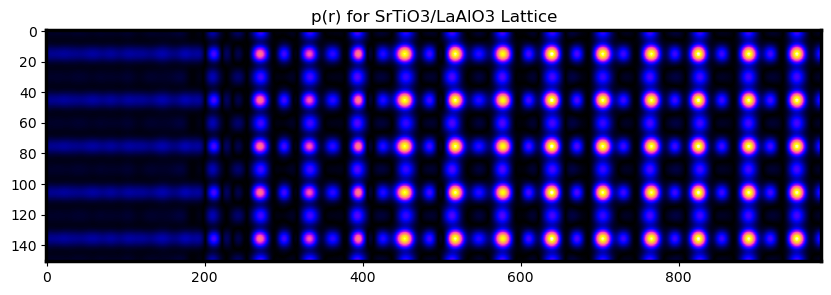

Real:


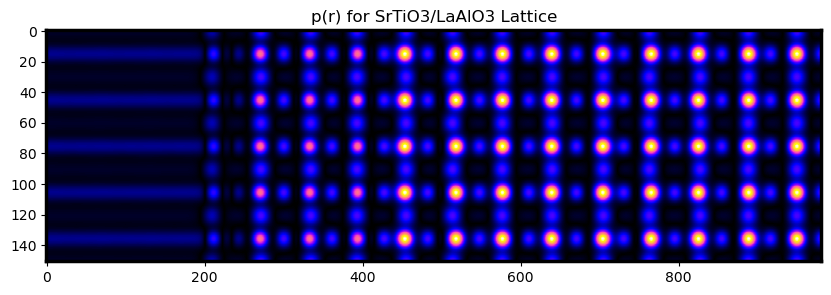

In [117]:

plt.figure(figsize=(10, 3))

print("Predicted:")
plt.imshow((np.abs(pr_pred[index][0])), cmap = 'gnuplot2', aspect='auto')
plt.title("p(r) for SrTiO3/LaAlO3 Lattice")
#plt.colorbar()
#plt.clim(0, 5000)

plt.show()

plt.figure(figsize=(10, 3))
print("Real:")
plt.imshow((np.abs(pr_real[index][0])), cmap = 'gnuplot2', aspect='auto')
plt.title("p(r) for SrTiO3/LaAlO3 Lattice")
#plt.colorbar()
#plt.clim(0, 0.0006)
plt.show()

plt.figure(figsize=(10, 3))
print("Predicted:")
plt.imshow((np.abs(pr_pred[index][1])), cmap = 'gnuplot2', aspect='auto')
plt.title("p(r) for SrTiO3/LaAlO3 Lattice")
#plt.colorbar()
#plt.clim(0, 5000)
plt.show()

plt.figure(figsize=(10, 3))
print("Real:")
plt.imshow((np.abs(pr_real[index][1])), cmap = 'gnuplot2', aspect='auto')
plt.title("p(r) for SrTiO3/LaAlO3 Lattice")
#plt.colorbar()
#plt.clim(0, 0.0006)
plt.show()


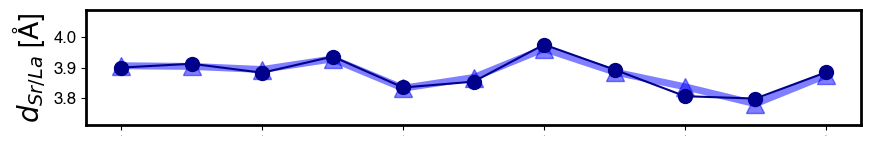

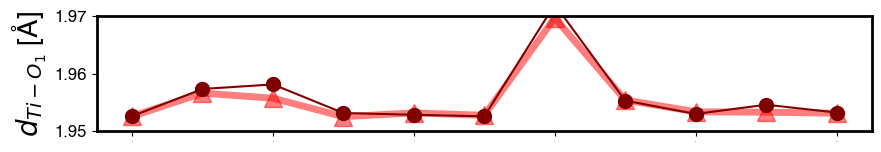

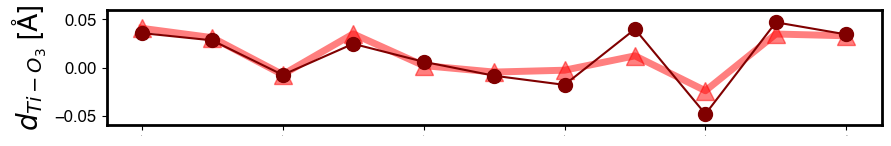

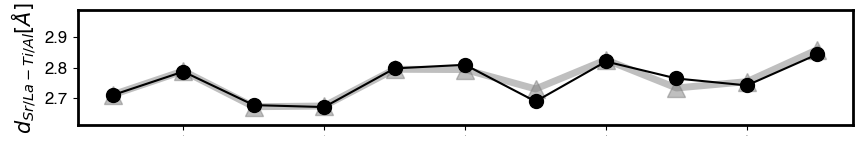

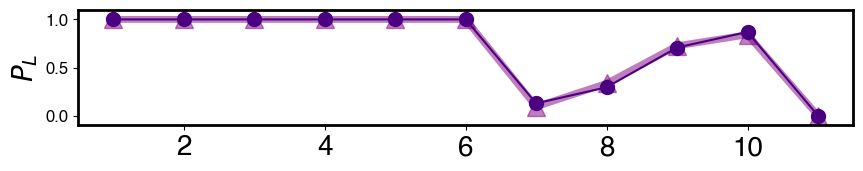

In [118]:
plt.rcParams['axes.linewidth'] = 2
plt.figure(figsize=(10, 1.5))
fontSize =12
marksize = 10

plt.plot(pred_cns[index],'^-',  markersize = marksize+3, linewidth = 5, alpha = 0.5, color = "blue")
plt.plot(real_cns[index], 'o-', markersize = marksize, color = "darkblue")
plt.ylabel('$d_{Sr/La}$ [Å]', fontname = 'Helvetica',fontsize = 20 )

plt.xticks(fontsize = 0, fontname = 'Helvetica' )
plt.yticks(fontsize = fontSize, fontname = 'Helvetica' )
plt.ylim(3.71, 4.09)
plt.show()

#------

O1_prediction_plot = np.sqrt( (pred_r_o1s[index]*pred_cns[index] - pred_r_Tis[index]*pred_cns[index])**2 + (0.5*a_bulk)**2 )
O1_real_plot = np.sqrt( (real_r_o1s[index]*real_cns[index] - real_r_Tis[index]*real_cns[index])**2 + (0.5*a_bulk)**2 )

plt.figure(figsize=(10, 1.5))
plt.plot(O1_prediction_plot,'^-',  markersize = marksize+3, linewidth = 5, alpha = 0.5, color = "red")
plt.plot(O1_real_plot, 'o-', markersize = marksize, color = "maroon")
plt.ylabel('$d_{Ti-O_1}$ [Å]', fontname = 'Helvetica',fontsize = 20 )

plt.xticks(fontsize = 0, fontname = 'Helvetica' )
plt.yticks(fontsize = fontSize, fontname = 'Helvetica' )
plt.ylim(1.95, 1.97)
plt.show()

"""
plt.figure(figsize=(10, 1.5))

plt.plot(pred_r_o2s[index],'^-',  markersize = marksize+3, linewidth = 5, alpha = 0.5, color = "red")
plt.plot(real_r_o2s[index], 'o-', markersize = marksize, color = "maroon")
plt.ylabel('$d_{O2}$', fontname = 'Helvetica',fontsize = 20 )

plt.xticks(fontsize = 0, fontname = 'Helvetica' )
plt.yticks(fontsize = fontSize, fontname = 'Helvetica' )
plt.ylim(0.44, 0.56)
plt.show()
"""

#------
O3_prediction_plot = np.abs(pred_r_o3s[index]*pred_cns[index] - pred_r_Tis[index]*pred_cns[index])
O3_real_plot = np.abs(real_r_o3s[index]*real_cns[index] - real_r_Tis[index]*real_cns[index])

plt.figure(figsize=(10, 1.5))

plt.plot(pred_r_o3s[index],'^-',  markersize = marksize+3, linewidth = 5, alpha = 0.5, color = "red")
plt.plot(real_r_o3s[index], 'o-', markersize = marksize, color = "maroon")
plt.ylabel('$d_{Ti-O_3}$ [Å]', fontname = 'Helvetica',fontsize = 20 )

plt.xticks(fontsize = 0, fontname = 'Helvetica' )
plt.yticks(fontsize = fontSize, fontname = 'Helvetica' )
plt.ylim(-0.06, 0.06)
plt.show()

#cn_arr = np.array([c_bulk]*(N_bulk-1) + [c_surf]*N_surface)
Ti_prediction_plot = np.sqrt( (pred_r_Tis[index]*pred_cns[index])**2 + (0.5*a_bulk)**2 )
Ti_real_plot = np.sqrt( (real_r_Tis[index]*real_cns[index])**2 + (0.5*a_bulk)**2 )

plt.figure(figsize=(10, 1.5))
plt.plot(layer, Ti_prediction_plot,'^-',  markersize = marksize+3, linewidth = 5, alpha = 0.5, color = "gray")
plt.plot(layer, Ti_real_plot, 'o-', markersize = marksize, color = "black")
plt.ylabel('$d_{Sr/La-Ti/Al} [Å]$', fontname = 'Times new roman',fontsize = 15 )

plt.xticks(fontsize = 0, fontname = 'Helvetica' )
plt.yticks(fontsize = fontSize, fontname = 'Helvetica' )
plt.ylim(2.61, 2.99)
plt.show()


predicted_charge_plot = [1, 1, 1, 1, 1, 1] + list(p_pred[index]) + [0]
real_charge_plot = [1, 1, 1, 1, 1, 1] + list(input_ps[index]) + [0]


plt.figure(figsize=(10, 1.5))
plt.plot(layer, predicted_charge_plot,'^-',  markersize = marksize+3, linewidth = 5, alpha = 0.5, color = "purple")
plt.plot(layer, real_charge_plot, 'o-', markersize = marksize, color = "indigo")
plt.ylabel('$P_{L}$', fontname = 'Helvetica',fontsize = 20 )

plt.xticks(fontsize = 20, fontname = 'Helvetica' )
plt.yticks(fontsize = fontSize, fontname = 'Helvetica' )
plt.ylim(-0.1, 1.1)
plt.show()

In [119]:
type(input_ps[0])

numpy.ndarray

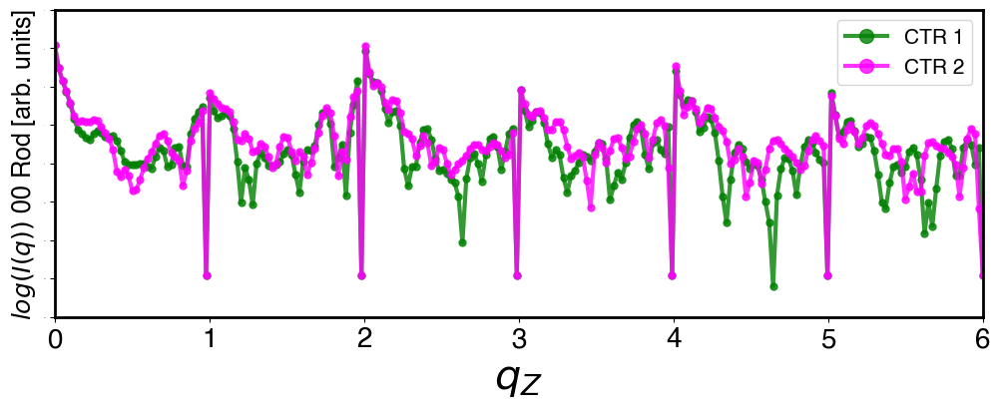

In [120]:
%matplotlib inline
i_rand = np.random.randint(0, 100)
index = 26
plt.rcParams['axes.linewidth'] = 2
fontSize = 20
fontSizeY = 0

legendSize = 15
ymin = -4
ymax = 4
markSize = 5
linwW = 3
qz_array = np.linspace(0, 6, 240)

#00 rod
rodmin = 0
rodmax = 240

plt.figure(figsize=(12,4))

plt.plot(qz_array, x_test[index][rodmin:rodmax], color = 'green', label = "CTR 1", linewidth = linwW, alpha = 0.8, marker = 'o', markersize = markSize)
plt.plot(qz_array, x_test[index+1][rodmin:rodmax], color = 'magenta', label = "CTR 2", linewidth = linwW, alpha = 0.8, marker = 'o', markersize = markSize)
plt.xlabel('$q_{Z}$', fontname = 'Helvetica',fontsize = 30 )
plt.ylabel('$log(I(q))$ 00 Rod [arb. units]', fontname = 'Helvetica',fontsize = 18  )
plt.xticks(fontsize = fontSize, fontname = 'Helvetica' )
plt.yticks(fontsize = fontSizeY, fontname = 'Helvetica' )
plt.ylim(ymin, ymax)
plt.xlim(0, 6)
plt.legend(loc='upper right', markerscale=2, prop={'size': legendSize, "family":'Helvetica'})
#plt.grid()
plt.show()

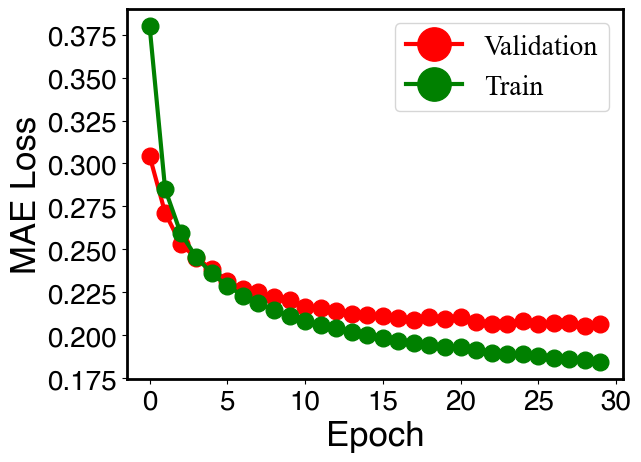

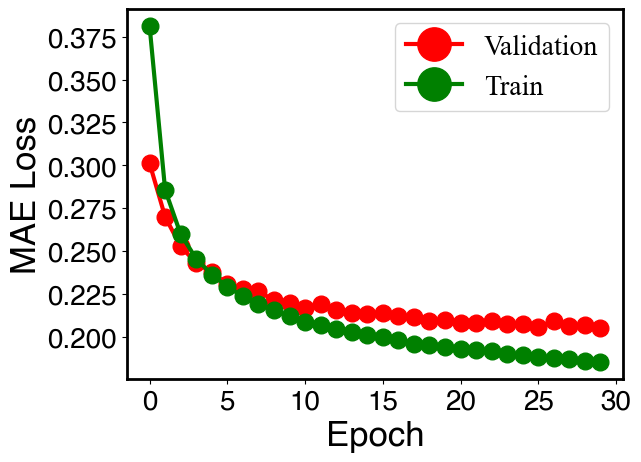

In [121]:
train_loss_real = np.load("trainLoss_12L_100k_real.npy")
val_loss_real = np.load("valLoss_12L_100k_real.npy")

train_loss_imag = np.load("trainLoss_12L_100k_imag.npy")
val_loss_imag = np.load("valLoss_12L_100k_imag.npy")


markSize = 12
lineW = 3

plt.plot(val_loss_real, 'o-', color = 'red', label = "Validation", markersize = markSize, linewidth = lineW)
plt.plot(train_loss_real, 'o-', color = 'green', label = "Train", markersize = markSize, linewidth = lineW)
plt.yticks(fontsize = 20, fontname = 'Helvetica' )
plt.xticks(fontsize = 20, fontname = 'Helvetica' )
plt.xlabel('Epoch', fontname = 'Helvetica',fontsize = 25 )
plt.ylabel('MAE Loss', fontname = 'Helvetica',fontsize = 25 )
plt.legend(markerscale = 2, prop={'size': 20, "family":'Times new roman'})
plt.show()


plt.plot(val_loss_imag, 'o-', color = 'red', label = "Validation", markersize = markSize, linewidth = lineW)
plt.plot(train_loss_imag, 'o-', color = 'green', label = "Train", markersize = markSize, linewidth = lineW)
plt.yticks(fontsize = 20, fontname = 'Helvetica' )
plt.xticks(fontsize = 20, fontname = 'Helvetica' )
plt.xlabel('Epoch', fontname = 'Helvetica',fontsize = 25 )
plt.ylabel('MAE Loss', fontname = 'Helvetica',fontsize = 25 )
plt.legend(markerscale = 2, prop={'size': 20, "family":'Times new roman'})
plt.show()

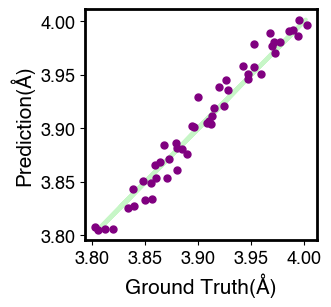

In [122]:
fig = plt.figure(figsize = (3, 3))
plt.rcParams['axes.linewidth'] = 2
plt.plot(real_cns[:, 3], real_cns[:, 3], color = "lightgreen", linewidth = 3, alpha = 0.5)

plt.plot(pred_cns[:, 3], real_cns[:, 3] , '.', markersize = 10, color = 'purple', label = "Test", alpha = 1)


plt.xlabel('Ground Truth(Å)', fontname = 'Helvetica',fontsize = 15 )
plt.ylabel('Prediction(Å)', fontname = 'Helvetica',fontsize = 15  )

plt.xticks(fontsize = 13, fontname = 'Helvetica' )
plt.yticks(fontsize = 13, fontname = 'Helvetica' )
#plt.ylim(4, 13)
#plt.legend(loc='upper left', markerscale=2, prop={'size': 25, "family":'Times new roman'})
#plt.grid()
plt.show()

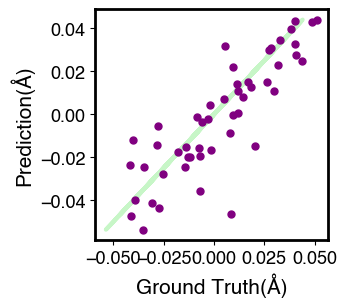

In [123]:
fig = plt.figure(figsize = (3, 3))
plt.rcParams['axes.linewidth'] = 2
plt.plot(real_r_o3s[:, 10], real_r_o3s[:, 10], color = "lightgreen", linewidth = 3, alpha = 0.5)

plt.plot(pred_r_o3s[:, 10], real_r_o3s[:, 10] , '.', markersize = 10, color = 'purple', label = "Test", alpha = 1)


plt.xlabel('Ground Truth(Å)', fontname = 'Helvetica',fontsize = 15 )
plt.ylabel('Prediction(Å)', fontname = 'Helvetica',fontsize = 15  )

plt.xticks(fontsize = 13, fontname = 'Helvetica' )
plt.yticks(fontsize = 13, fontname = 'Helvetica' )
#plt.ylim(4, 13)
#plt.legend(loc='upper left', markerscale=2, prop={'size': 25, "family":'Times new roman'})
#plt.grid()
plt.show()

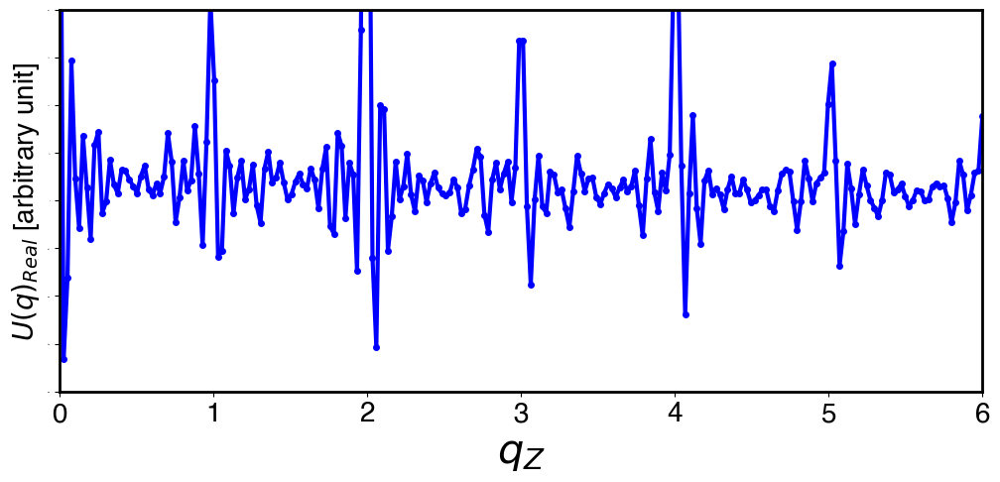

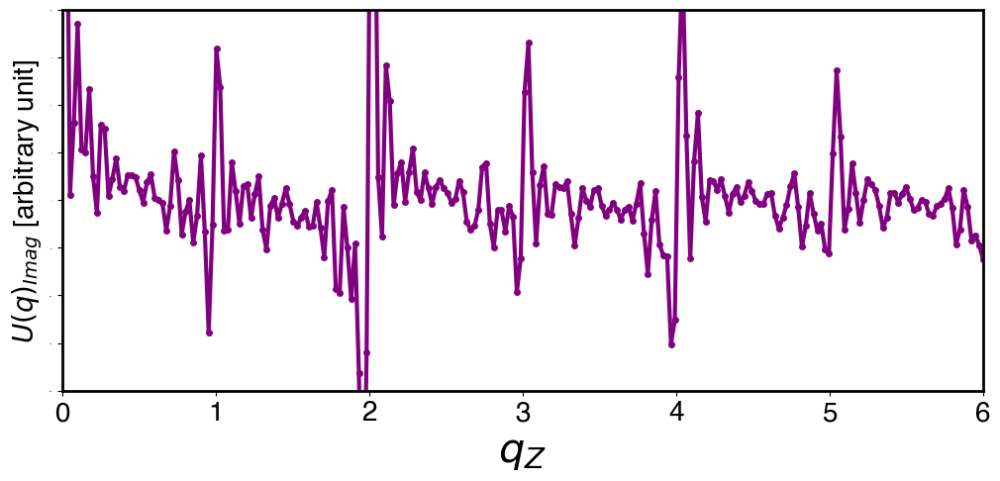

In [124]:
%matplotlib inline
i_rand = np.random.randint(0, 100)
index = 21

fontSize = 20
fontSizeY = 0

legendSize = 15
ymin = -200
ymax = 200
markSize = 5
linwW = 3
qz_array = np.linspace(0, 6, 240)

#00 rod
rodmin = 0
rodmax = 240

plt.figure(figsize=(12, 5))

plt.plot(qz_array, y_test_real[index][rodmin:rodmax], color = 'blue', label = "Ground Truth", marker = 'o', markersize = 4, linewidth = 3, alpha = 1)
plt.xlabel('$q_{Z}$', fontname = 'Helvetica',fontsize = 30 )
plt.ylabel('$U(q)_{Real}$ [arbitrary unit]', fontname = 'Helvetica',fontsize = 20  )
plt.xticks(fontsize = fontSize, fontname = 'Helvetica' )
plt.yticks(fontsize = fontSizeY, fontname = 'Helvetica' )
plt.ylim(ymin, ymax)
plt.xlim(0, 6)
#plt.legend(loc='upper right', markerscale=2, prop={'size': legendSize, "family":'Helvetica'})
#plt.grid()
plt.show()


                
plt.figure(figsize=(12, 5))
plt.plot(qz_array,y_test_imag[index][rodmin:rodmax], color = 'purple', label = "Ground Truth", marker = 'o', markersize = 4, linewidth = 3, alpha = 1)
plt.xlabel('$q_{Z}$', fontname = 'Helvetica',fontsize = 30 )
plt.ylabel('$U(q)_{Imag}$ [arbitrary unit]', fontname = 'Helvetica',fontsize = 20  )
plt.xticks(fontsize = fontSize, fontname = 'Helvetica' )
plt.yticks(fontsize = fontSizeY, fontname = 'Helvetica' )
plt.ylim(ymin, ymax)
plt.xlim(0, 6)
#plt.legend(loc='upper right', markerscale=2, prop={'size': legendSize, "family":'Helvetica'})
#plt.grid()
plt.show()